In [2]:
# sphinx_gallery_thumbnail_number = 2

# Authors: Robert Luke <mail@robertluke.net>
#
# License: BSD (3-clause)

# Import common libraries
from collections import defaultdict
from copy import deepcopy
from itertools import compress
from pprint import pprint

# Import Plotting Library
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np
import os
import pywt


# Import StatsModels
import statsmodels.formula.api as smf
from mne import Epochs, events_from_annotations, set_log_level
from mne.preprocessing.nirs import (
    beer_lambert_law,
    optical_density,
    scalp_coupling_index,
    temporal_derivative_distribution_repair,
    
)

# Import MNE processing
from mne.viz import plot_compare_evokeds

# Import MNE-BIDS processing
from mne_bids import BIDSPath, read_raw_bids


# Import MNE-NIRS processing
from mne_nirs.channels import get_long_channels, picks_pair_to_idx
from mne_nirs.datasets import fnirs_motor_group
from mne_nirs.signal_enhancement import (enhance_negative_correlation, short_channel_regression)
from mne_nirs.channels import (get_long_channels,
                               get_short_channels,
                               picks_pair_to_idx)

from collections import defaultdict
import numpy as np
from itertools import compress
from sklearn.decomposition import PCA

# Set general parameters
set_log_level("WARNING")  # Don't show info, as it is repetitive for many subjects

# Preprocessing

In [3]:

import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    num_good_short_channels = tot_number_of_short_channels - len_bad_short_chs
    # Print diagnostics
    print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of bad short channels: {len_bad_short_chs}")
    print(f"✅ Number of good short channels: {num_good_short_channels}")
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if num_good_short_channels < 4:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        #raw_od_corrected=raw_od.copy()
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.05, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01) """
    
    #raw_haemo.plot_psd(average=True, show=True)

    raw_haemo = raw_haemo.filter(l_freq = None, h_freq = 0.2,  
                                 method="iir", iir_params =dict(order=5, ftype='butter'))
     #high-pass
    raw_haemo= raw_haemo.filter(l_freq =  0.05, h_freq = None, method="iir", iir_params =dict(order=5, ftype='butter')) #t0.05 was cutoff in andreas analysis
      
    """ # drop the bad channels
    raw_heamo_good = raw_haemo.copy()
    
    raw_heamo_good.drop_channels(raw_haemo.info['bads']) """
    
    
    #raw_haemo.plot(n_channels=len(raw_haemo.ch_names), duration=5000,show_scrollbars=True )

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-5,
        tmax=15,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=None,
    )
    """ epochs['Control'].plot()
    epochs['Noise'].plot()
    epochs['Speech'].plot()
     """


    return raw_haemo, epochs, event_dict, raw_od, events

# Test individual subject

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 59 epochs left
Participant 01, Session 01


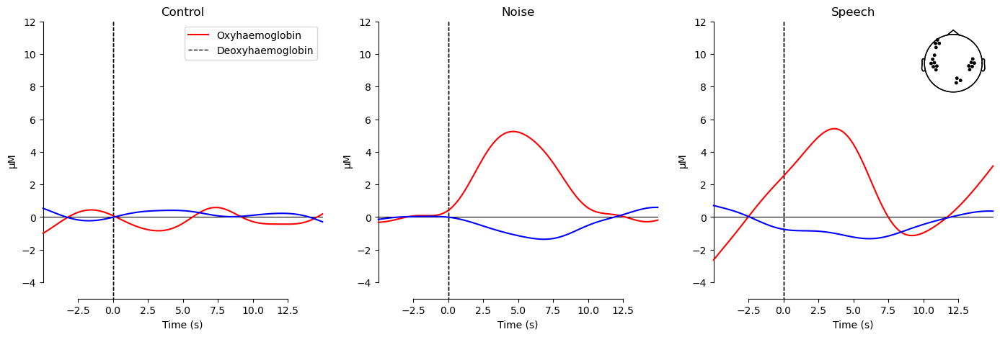

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 02, Session 01: 60 epochs left
Participant 02, Session 01


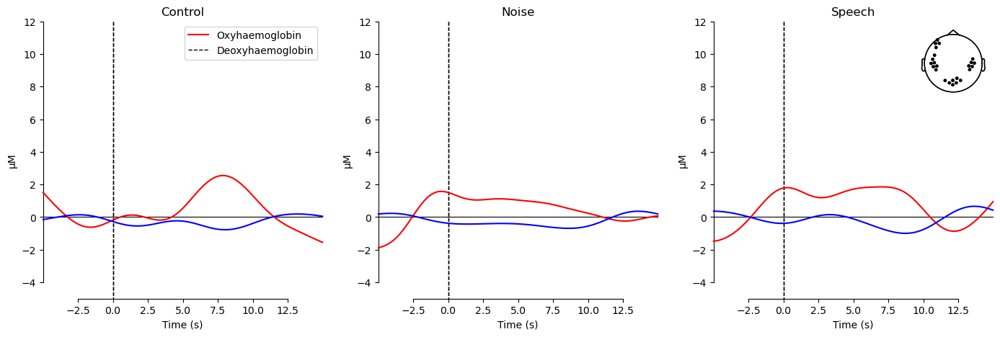

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 03, Session 01: 60 epochs left
Participant 03, Session 01


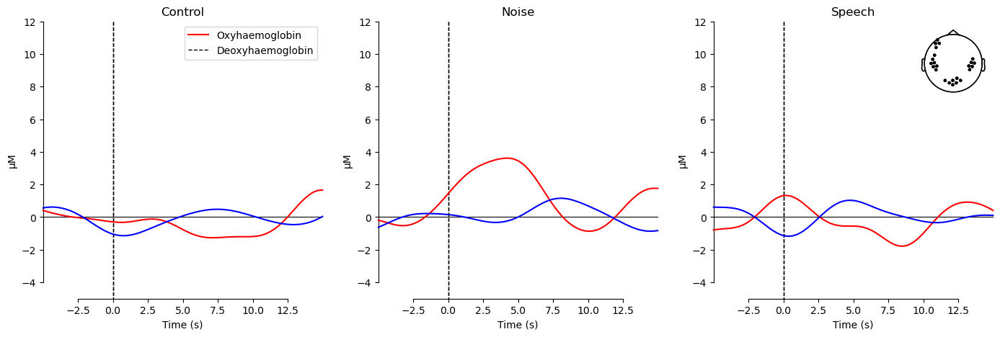

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 04, Session 01: 60 epochs left
Participant 04, Session 01


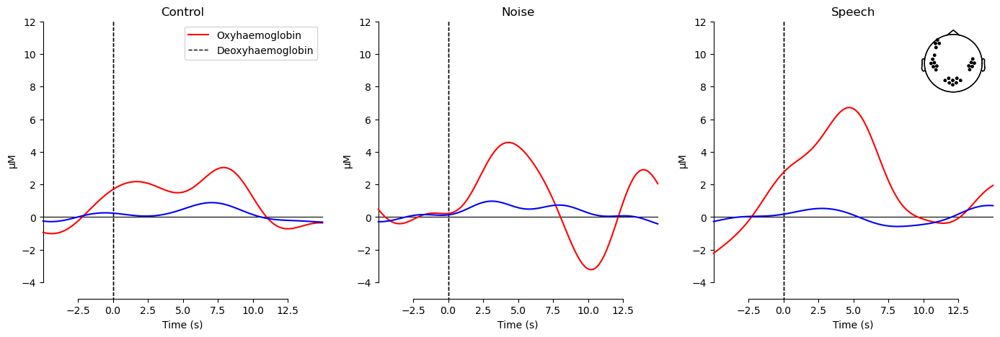

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 05, Session 01: 60 epochs left
Participant 05, Session 01


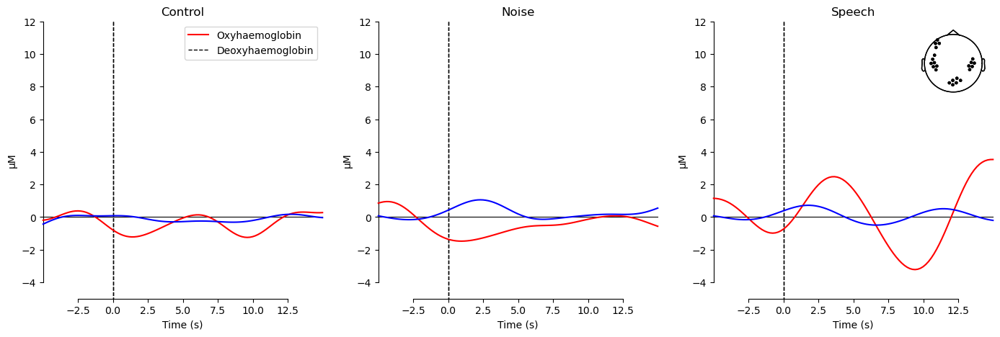

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 24
Number of all (good and bad) short channels: 16
Number of bad long channels: 12
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 06, Session 01: 60 epochs left
Participant 06, Session 01


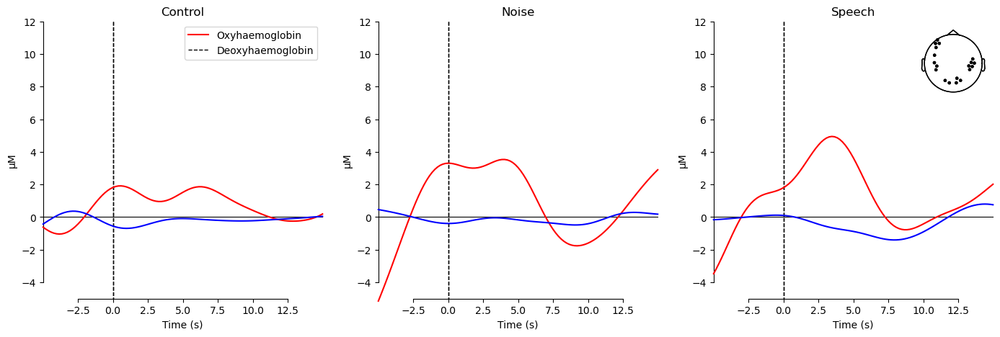

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 01: 60 epochs left
Participant 07, Session 01


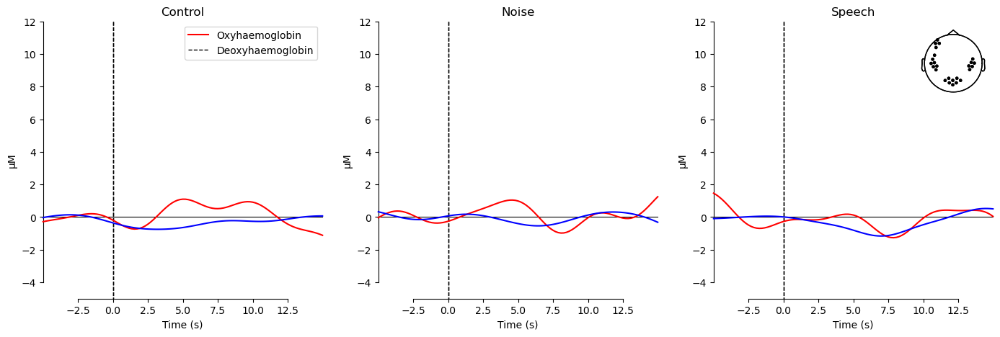

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 01: 59 epochs left
Participant 08, Session 01


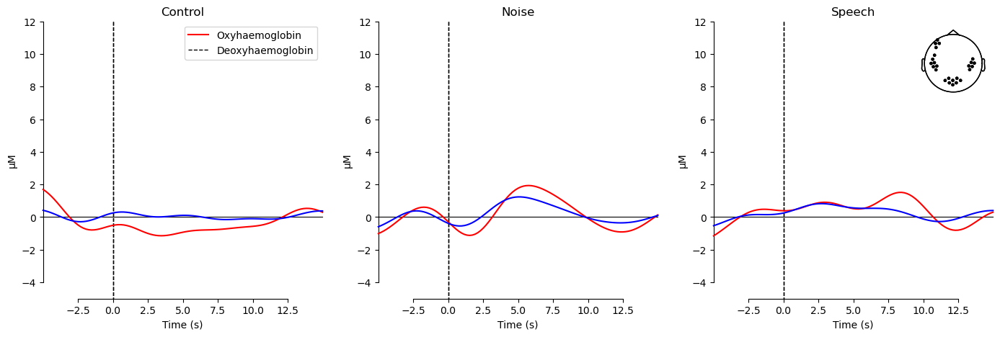

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (60). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 10, Session 01: 60 epochs left
Participant 10, Session 01


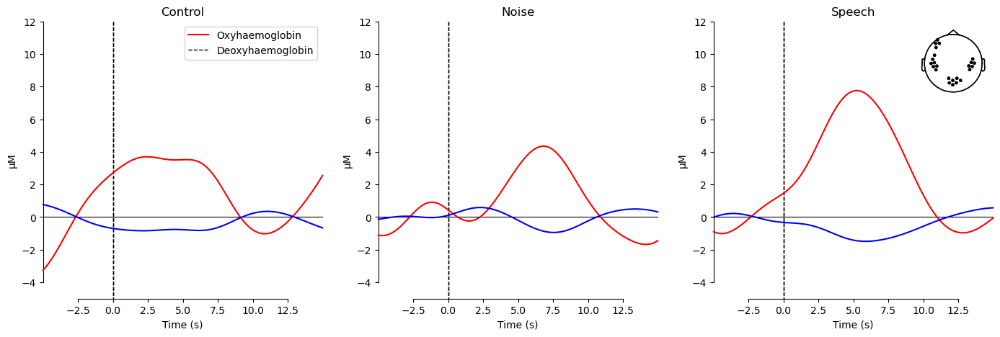

In [183]:
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers
subject_list = subject_list[:10]
print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1,2):  
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        
                
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition])
# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


In [30]:
bad_ch= epochs.info['bads']

epochs.drop_channels(bad_ch)




<Epochs | 59 events (all good), -4.992 – 14.976 s (baseline -4.992 – 0 s), ~2.2 MiB, data loaded,
 np.str_('Control'): 20
 np.str_('Noise'): 20
 np.str_('Speech'): 19>

In [31]:
# get only hbo channels data

hbo_data = epochs.copy().pick("hbo")
hbo_data.plot()

In [32]:
data= hbo_data.get_data()
info= hbo_data.info.copy()
data # shape=(60, 50, 90)) 20 cont, 20 noise, 20 speech, 50 channels, 90 time points

array([[[ 9.39945745e-06,  8.36284284e-06,  7.25314776e-06, ...,
          1.80090521e-05,  1.90963010e-05,  2.01821445e-05],
        [ 2.36702324e-07, -5.74729634e-07, -1.36673263e-06, ...,
          3.99117611e-06,  4.04121683e-06,  4.06870326e-06],
        [-3.86868207e-06, -4.81198717e-06, -5.71212447e-06, ...,
         -8.97082585e-07, -1.73014372e-06, -2.59340510e-06],
        ...,
        [ 2.76198453e-06,  2.69008095e-06,  2.52639318e-06, ...,
         -1.36405904e-06, -1.26424201e-06, -1.09548004e-06],
        [ 4.14762196e-06,  3.71684625e-06,  3.23432270e-06, ...,
          5.80665543e-06,  6.63813605e-06,  7.50485100e-06],
        [-3.53451478e-06, -3.10193403e-06, -2.66737820e-06, ...,
         -4.83839516e-06, -4.91580604e-06, -4.90225292e-06]],

       [[-7.85898625e-06, -7.23743371e-06, -6.55913203e-06, ...,
          6.70265190e-06,  6.75358939e-06,  6.78736053e-06],
        [ 9.55392572e-07,  1.00303832e-06,  1.09609090e-06, ...,
         -1.61099105e-06, -2.17265520e

In [550]:
epochs.plot()
#41, 47

In [33]:
# Extract the timepoints between 34 and 45 (inclusive)
time_slice = data[:, :, 44:55]

# Get the max value along the time axis for each condition and channel
max_values = np.max(time_slice, axis=2)
max_values


array([[ 4.27095051e-05,  1.48632680e-05,  5.51815582e-06, ...,
         6.80849560e-06,  9.25057847e-06, -1.14494855e-06],
       [ 9.70261965e-06,  1.44449655e-05,  1.02579834e-05, ...,
         6.08451306e-06,  4.93138152e-06,  4.40189181e-06],
       [ 4.68519347e-06,  2.44800686e-06,  7.37056863e-07, ...,
        -1.06299749e-06,  5.81051914e-06,  3.81718925e-06],
       ...,
       [ 8.15828523e-06,  1.47725708e-06,  5.24353604e-06, ...,
        -1.02707249e-05, -6.52801173e-06, -4.57066380e-06],
       [ 3.86247236e-06,  6.56385926e-06,  7.30183614e-06, ...,
         5.37430443e-06,  1.11247192e-05, -1.62990470e-05],
       [ 3.46306613e-06,  3.79134285e-08,  5.67853022e-06, ...,
        -7.35391510e-07, -6.66309120e-06, -4.23749541e-07]],
      shape=(59, 23))

In [34]:
ev= epochs.events[:, 2]

index_column = np.arange(0, len(ev)).reshape(-1, 1)

updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))
updated_matrix
# For values where the second column is 1
control_mat = updated_matrix[updated_matrix[:, 1] == 1]
control_idx = control_mat[:, 0]


# For values where the second column is 2
noise_mat = updated_matrix[updated_matrix[:, 1] == 2]
noise_idx = noise_mat[:, 0]

# For values where the second column is 3
speech_mat = updated_matrix[updated_matrix[:, 1] == 3]
speech_idx = speech_mat[:, 0]

print((control_idx))
print((noise_idx))
print((speech_idx))


[ 2  3  9 10 11 13 14 16 17 19 24 26 28 29 32 34 51 52 54 56]
[ 4  5  7  8 12 18 20 23 25 33 35 37 38 39 44 47 48 53 55 57]
[ 0  1  6 15 21 22 27 30 31 36 40 41 42 43 45 46 49 50 58]


In [35]:
control_max = max_values[control_idx, :]
noise_max = max_values[noise_idx, :]
speech_max = max_values[speech_idx, :]
speech_max.shape

(19, 23)

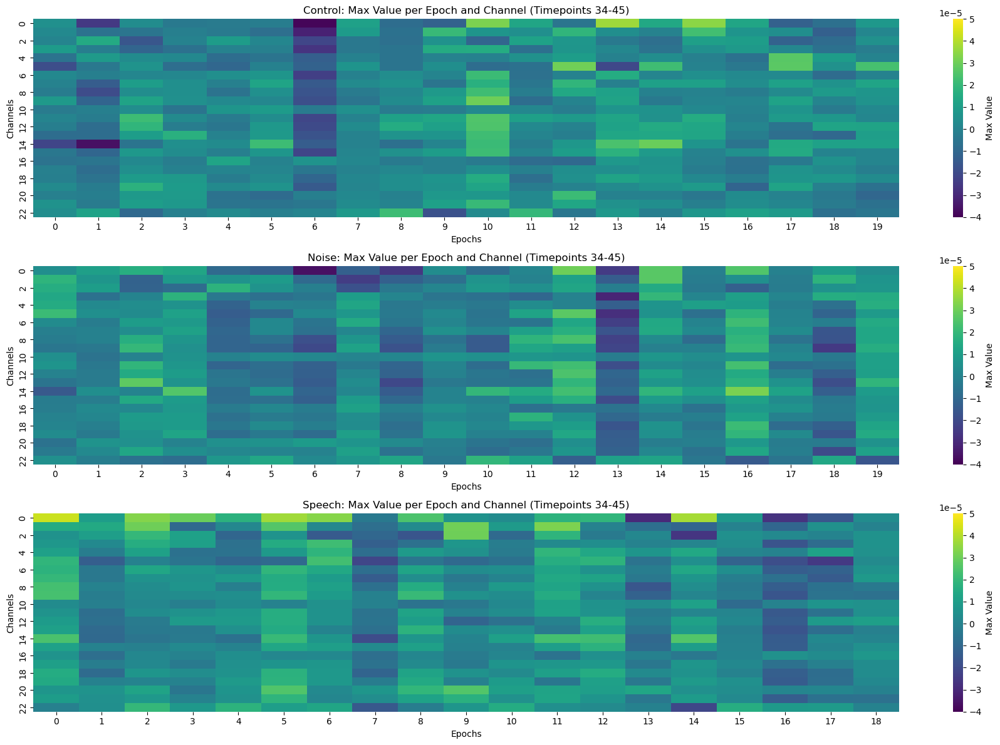

In [36]:
# BEFORE REMOVE OUTLIERS

# Calculate the global min and max values across all three datasets
vmin = -4e-5
vmax = 5e-5

# Plot the heatmaps with the same scale
plt.figure(figsize=(18, 12))

# Control
plt.subplot(3, 1, 1)
sns.heatmap(control_max.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=vmin, vmax=vmax)
plt.title('Control: Max Value per Epoch and Channel (Timepoints 34-45)')
plt.xlabel('Epochs')
plt.ylabel('Channels')

# Noise
plt.subplot(3, 1, 2)
sns.heatmap(noise_max.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=vmin, vmax=vmax)
plt.title('Noise: Max Value per Epoch and Channel (Timepoints 34-45)')
plt.xlabel('Epochs')
plt.ylabel('Channels')

# Speech
plt.subplot(3, 1, 3)
sns.heatmap(speech_max.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=vmin, vmax=vmax)
plt.title('Speech: Max Value per Epoch and Channel (Timepoints 34-45)')
plt.xlabel('Epochs')
plt.ylabel('Channels')

plt.tight_layout()
plt.show()


In [555]:
"""  
def z_score_outliers(data, threshold=3):
    mean = np.mean(data)
    std = np.std(data)
    z_scores = (data - mean) / std
    outlier_indices = np.where(np.abs(z_scores) > threshold)[0]
    return outlier_indices

# Step 1: Mean per epoch
control_means = control_max.mean(axis=1)
noise_means = noise_max.mean(axis=1)
speech_means = speech_max.mean(axis=1)

# Step 2: Z-score method for outlier detection
control_outlier_indices = z_score_outliers(control_means)
noise_outlier_indices = z_score_outliers(noise_means)
speech_outlier_indices = z_score_outliers(speech_means)

# Step 3: Remove outliers
control_max_cleaned = np.delete(control_max, control_outlier_indices, axis=0)
noise_max_cleaned = np.delete(noise_max, noise_outlier_indices, axis=0)
speech_max_cleaned = np.delete(speech_max, speech_outlier_indices, axis=0)

# Epoch index mapping
removed_control_epochs = control_idx[control_outlier_indices]
removed_noise_epochs = noise_idx[noise_outlier_indices]
removed_speech_epochs = speech_idx[speech_outlier_indices]

(
control_outlier_indices, control_max_cleaned.shape, removed_control_epochs,
noise_outlier_indices, noise_max_cleaned.shape, removed_noise_epochs,
speech_outlier_indices, speech_max_cleaned.shape, removed_speech_epochs
)
  """

'  \ndef z_score_outliers(data, threshold=3):\n    mean = np.mean(data)\n    std = np.std(data)\n    z_scores = (data - mean) / std\n    outlier_indices = np.where(np.abs(z_scores) > threshold)[0]\n    return outlier_indices\n\n# Step 1: Mean per epoch\ncontrol_means = control_max.mean(axis=1)\nnoise_means = noise_max.mean(axis=1)\nspeech_means = speech_max.mean(axis=1)\n\n# Step 2: Z-score method for outlier detection\ncontrol_outlier_indices = z_score_outliers(control_means)\nnoise_outlier_indices = z_score_outliers(noise_means)\nspeech_outlier_indices = z_score_outliers(speech_means)\n\n# Step 3: Remove outliers\ncontrol_max_cleaned = np.delete(control_max, control_outlier_indices, axis=0)\nnoise_max_cleaned = np.delete(noise_max, noise_outlier_indices, axis=0)\nspeech_max_cleaned = np.delete(speech_max, speech_outlier_indices, axis=0)\n\n# Epoch index mapping\nremoved_control_epochs = control_idx[control_outlier_indices]\nremoved_noise_epochs = noise_idx[noise_outlier_indices]\nrem

In [14]:
import numpy as np

def remove_outliers_modified_zscore(matrix, epoch_indices, threshold=3.5):
    medians = np.median(matrix, axis=1)
    mad = np.median(np.abs(medians - np.median(medians)))
    modified_z_scores = 0.6745 * (medians - np.median(medians)) / mad
    outlier_indices = np.where(np.abs(modified_z_scores) > threshold)[0]
    
    # Calculate the mean of non-outlier epochs
    non_outlier_indices = np.setdiff1d(np.arange(matrix.shape[0]), outlier_indices)
    non_outlier_mean = np.mean(matrix[non_outlier_indices], axis=0)
    
    # Replace outlier epochs with the mean of non-outlier epochs
    matrix[outlier_indices] = non_outlier_mean
    
    removed_epochs = epoch_indices[outlier_indices]
    
    return matrix, outlier_indices, removed_epochs

# Control
control_max_cleaned, control_outlier_indices, removed_control_epochs = remove_outliers_modified_zscore(control_max, control_idx)

# Noise
noise_max_cleaned, noise_outlier_indices, removed_noise_epochs = remove_outliers_modified_zscore(noise_max, noise_idx)

# Speech
speech_max_cleaned, speech_outlier_indices, removed_speech_epochs = remove_outliers_modified_zscore(speech_max, speech_idx)

# Optionally print results
print(f"Control - Removed {len(control_outlier_indices)} outlier(s):", removed_control_epochs)
print(f"Noise   - Removed {len(noise_outlier_indices)} outlier(s):", removed_noise_epochs)
print(f"Speech  - Removed {len(speech_outlier_indices)} outlier(s):", removed_speech_epochs)


Control - Removed 1 outlier(s): [14]
Noise   - Removed 0 outlier(s): []
Speech  - Removed 0 outlier(s): []


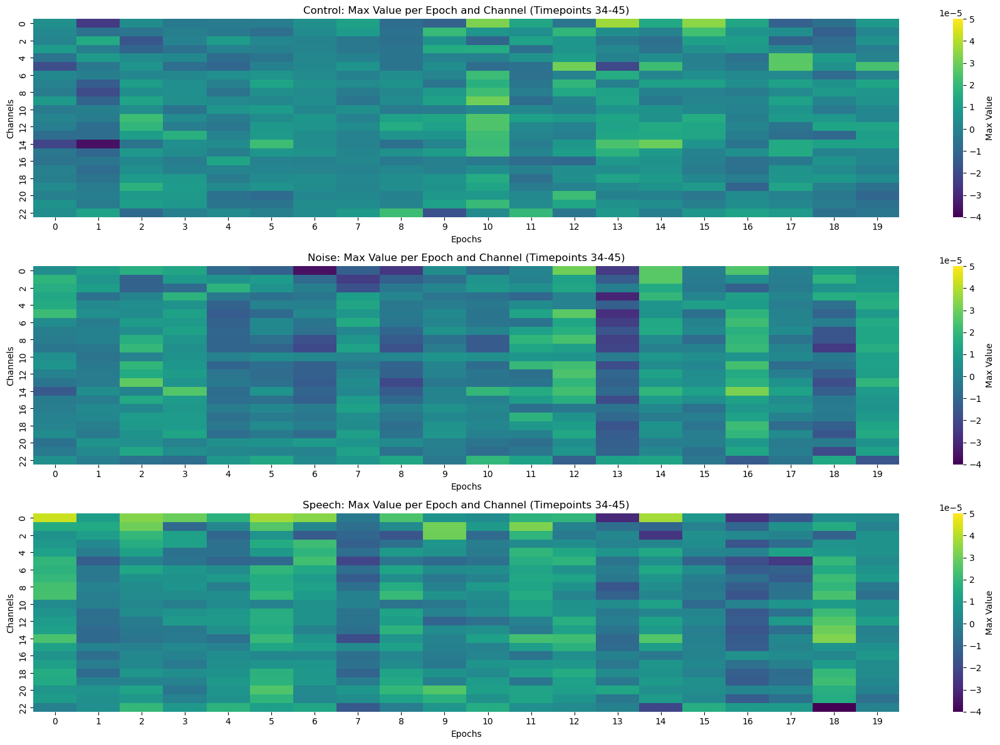

In [16]:
# AFTER OUTLIER REMOVAL
# Assuming control_max_cleaned, noise_max_cleaned, and speech_max_cleaned are your data arrays

# Calculate the global min and max values across all three datasets
vmin = -4e-5
vmax = 5e-5

# Plot the heatmaps with the same scale
plt.figure(figsize=(18, 12))

# Control
plt.subplot(3, 1, 1)
sns.heatmap(control_max_cleaned.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=vmin, vmax=vmax)
plt.title('Control: Max Value per Epoch and Channel (Timepoints 34-45)')
plt.xlabel('Epochs')
plt.ylabel('Channels')

# Noise
plt.subplot(3, 1, 2)
sns.heatmap(noise_max_cleaned.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=vmin, vmax=vmax)
plt.title('Noise: Max Value per Epoch and Channel (Timepoints 34-45)')
plt.xlabel('Epochs')
plt.ylabel('Channels')

# Speech
plt.subplot(3, 1, 3)
sns.heatmap(speech_max_cleaned.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=vmin, vmax=vmax)
plt.title('Speech: Max Value per Epoch and Channel (Timepoints 34-45)')
plt.xlabel('Epochs')
plt.ylabel('Channels')

plt.tight_layout()
plt.show()


In [558]:
""" import numpy as np

def replace_manual_outliers(matrix, outlier_indices):
    
    # Convert to numpy array in case it's not
    matrix = np.array(matrix)

    all_indices = np.arange(matrix.shape[0])
    non_outlier_indices = np.setdiff1d(all_indices, outlier_indices)
    
    if len(non_outlier_indices) == 0:
        raise ValueError("All epochs are marked as outliers. Cannot compute mean.")

    non_outlier_mean = np.mean(matrix[non_outlier_indices], axis=0)
    
    # Replace each outlier row with the mean
    matrix[outlier_indices] = non_outlier_mean

    return matrix

# Example: Manually specify outlier epochs
control_outliers_manual = [2, 3, 13]      # Replace epochs 2 and 5 in control
noise_outliers_manual = [ 3]     # Replace epochs 1, 3, 4 in noise
speech_outliers_manual = [4, 6, 19]       # Replace epochs 0 and 6 in speech

# Replace them
control_max_cleaned = replace_manual_outliers(control_max_cleaned, control_outliers_manual)
noise_max_cleaned = replace_manual_outliers(noise_max_cleaned, noise_outliers_manual)
speech_max_cleaned = replace_manual_outliers(speech_max_cleaned, speech_outliers_manual)
 """

' import numpy as np\n\ndef replace_manual_outliers(matrix, outlier_indices):\n    \n    # Convert to numpy array in case it\'s not\n    matrix = np.array(matrix)\n\n    all_indices = np.arange(matrix.shape[0])\n    non_outlier_indices = np.setdiff1d(all_indices, outlier_indices)\n    \n    if len(non_outlier_indices) == 0:\n        raise ValueError("All epochs are marked as outliers. Cannot compute mean.")\n\n    non_outlier_mean = np.mean(matrix[non_outlier_indices], axis=0)\n    \n    # Replace each outlier row with the mean\n    matrix[outlier_indices] = non_outlier_mean\n\n    return matrix\n\n# Example: Manually specify outlier epochs\ncontrol_outliers_manual = [2, 3, 13]      # Replace epochs 2 and 5 in control\nnoise_outliers_manual = [ 3]     # Replace epochs 1, 3, 4 in noise\nspeech_outliers_manual = [4, 6, 19]       # Replace epochs 0 and 6 in speech\n\n# Replace them\ncontrol_max_cleaned = replace_manual_outliers(control_max_cleaned, control_outliers_manual)\nnoise_max_clea

In [559]:
from scipy.stats import ttest_rel

""" control_max_cleaned = control_max.copy()
noise_max_cleaned = noise_max.copy()
speech_max_cleaned = speech_max.copy() """

# Ensure same number of epochs across conditions
min_epochs = min(control_max_cleaned.shape[0], noise_max_cleaned.shape[0], speech_max_cleaned.shape[0])

# Trim all matrices to the same number of epochs
control_trimmed = control_max_cleaned[:min_epochs, :]
noise_trimmed = noise_max_cleaned[:min_epochs, :]
speech_trimmed = speech_max_cleaned[:min_epochs, :]

# Perform paired t-tests
p_values_control_vs_noise = []
p_values_control_vs_speech = []

for channel in range(control_trimmed.shape[1]):
    t_stat_cn, p_cn = ttest_rel(control_trimmed[:, channel], noise_trimmed[:, channel])
    t_stat_cs, p_cs = ttest_rel(control_trimmed[:, channel], speech_trimmed[:, channel])
    
    p_values_control_vs_noise.append(p_cn)
    p_values_control_vs_speech.append(p_cs)

# Optionally, convert to numpy arrays
p_values_control_vs_noise = np.array(p_values_control_vs_noise)
p_values_control_vs_speech = np.array(p_values_control_vs_speech)

# You could also apply multiple comparisons correction here (e.g., Bonferroni or FDR)
print(p_values_control_vs_noise)
print(p_values_control_vs_speech)


[3.97258400e-01 7.31333518e-01 4.60066993e-01 2.78748689e-01
 4.11871239e-01 8.07543100e-01 3.43465441e-03 5.40930967e-04
 4.09724143e-02 9.35374837e-02 1.03916201e-01 6.91188597e-02
 1.00861096e-01 1.27733226e-01 2.61288671e-01 5.48439731e-04
 4.58835117e-03 4.87805138e-02 3.57861645e-02 7.44649683e-01]
[2.13644229e-02 9.59399564e-02 1.11340213e-01 1.08597574e-02
 2.57259016e-01 6.43251721e-01 1.80671400e-02 2.27815820e-03
 4.89137357e-03 3.47247731e-02 3.03808982e-03 4.07195402e-02
 2.94913815e-01 7.26621416e-02 2.17990633e-02 5.89063057e-04
 1.52291885e-02 1.07921875e-02 2.05249205e-02 4.02118994e-02]


In [560]:

# Get indices of the 5 smallest p-values (most significant) for control vs noise
top_5_cn_indices = np.argsort(p_values_control_vs_noise)[:5]
top_5_cs_indices = np.argsort(p_values_control_vs_speech)[:5]

print("Top 5 channels for Control vs Noise:")
for idx in top_5_cn_indices:
    print(f"Channel: {idx}, p-value: {p_values_control_vs_noise[idx]}")

print("\nTop 5 channels for Control vs Speech:")
for idx in top_5_cs_indices:
    print(f"Channel: {idx}, p-value: {p_values_control_vs_speech[idx]}")


Top 5 channels for Control vs Noise:
Channel: 7, p-value: 0.0005409309670741582
Channel: 15, p-value: 0.000548439731473432
Channel: 6, p-value: 0.003434654405648661
Channel: 16, p-value: 0.0045883511662834055
Channel: 18, p-value: 0.03578616445686203

Top 5 channels for Control vs Speech:
Channel: 15, p-value: 0.0005890630568379732
Channel: 7, p-value: 0.002278158198766011
Channel: 10, p-value: 0.003038089819673483
Channel: 8, p-value: 0.004891373566982215
Channel: 17, p-value: 0.010792187542110834


In [561]:
chanels_names= hbo_data.info['ch_names']

# Find indices of significant channels
significant_cn_indices = np.where(p_values_control_vs_noise < 0.05)[0]
significant_cs_indices = np.where(p_values_control_vs_speech < 0.05)[0]

# Sort the significant ones by their p-values
sorted_significant_cn = significant_cn_indices[np.argsort(p_values_control_vs_noise[significant_cn_indices])]
sorted_significant_cs = significant_cs_indices[np.argsort(p_values_control_vs_speech[significant_cs_indices])]

# Print results
print("Significant Channels for Control vs Noise (p < 0.05):")
for idx in sorted_significant_cn:
    print(f"Channel: {chanels_names[idx]}")

print("\nSignificant Channels for Control vs Speech (p < 0.05):")
for idx in sorted_significant_cs:
    print(f"Channel: {chanels_names[idx]}")


Significant Channels for Control vs Noise (p < 0.05):
Channel: S5_D3 hbo
Channel: S10_D11 hbo
Channel: S5_D2 hbo
Channel: S10_D12 hbo
Channel: S11_D12 hbo
Channel: S5_D4 hbo
Channel: S11_D11 hbo

Significant Channels for Control vs Speech (p < 0.05):
Channel: S10_D11 hbo
Channel: S5_D3 hbo
Channel: S7_D7 hbo
Channel: S5_D4 hbo
Channel: S11_D11 hbo
Channel: S3_D2 hbo
Channel: S10_D12 hbo
Channel: S5_D2 hbo
Channel: S11_D12 hbo
Channel: S1_D1 hbo
Channel: S10_D10 hbo
Channel: S5_D5 hbo
Channel: S12_D1 hbo
Channel: S8_D7 hbo


# All together

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 4
Subject 01, Session 01: 60 epochs left
✅ sub-01 ses-01: 9 CN sig, 22 CS sig; Control epochs removed: 1; Noise epochs removed: 0; Speech epochs removed: 0
Participant 01, Session 01


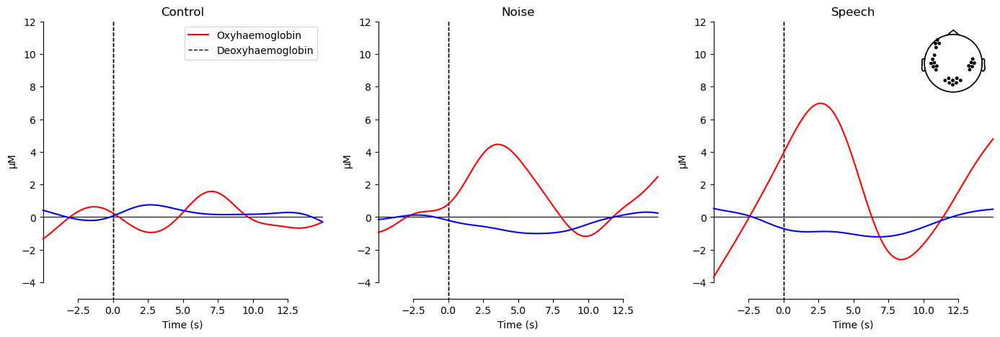

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S8_D17 785', 'S8_D17 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 4
Subject 01, Session 02: 60 epochs left
✅ sub-01 ses-02: 6 CN sig, 12 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 1
Participant 01, Session 02


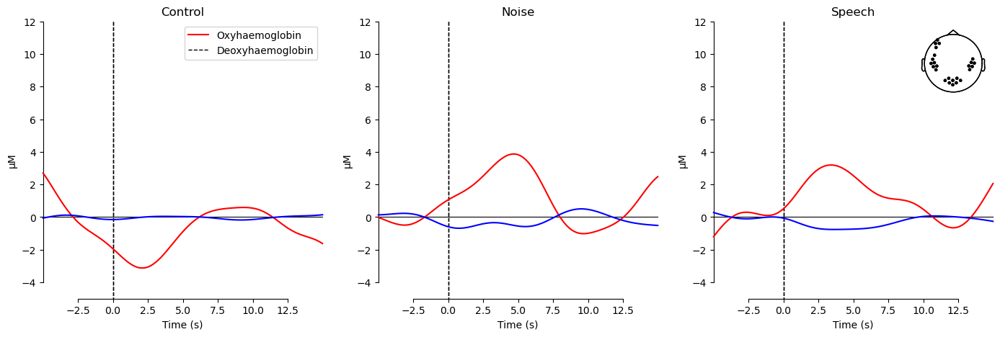

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 4
Subject 02, Session 01: 60 epochs left
✅ sub-02 ses-01: 3 CN sig, 1 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 02, Session 01


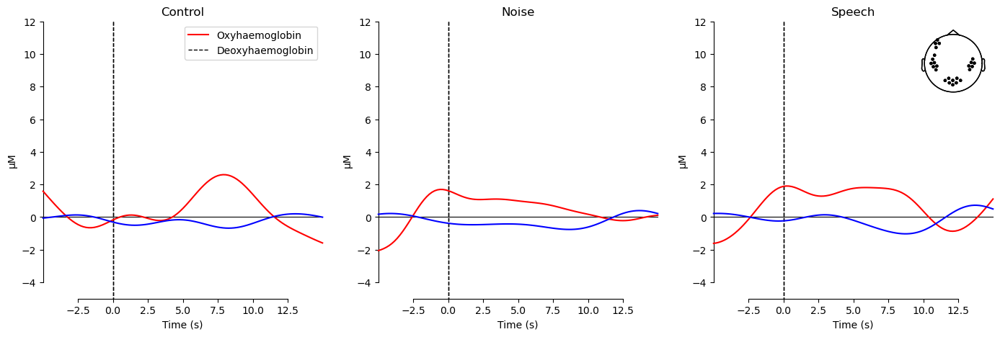

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 4
Subject 02, Session 02: 60 epochs left
✅ sub-02 ses-02: 5 CN sig, 6 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 02, Session 02


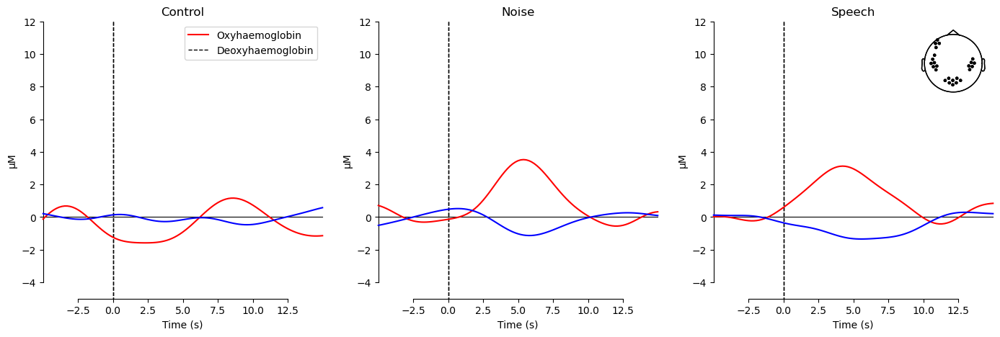

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 03, Session 01: 59 epochs left
⚠️ Not enough epochs left for Subject 03, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 6
Subject 03, Session 02: 60 epochs left
✅ sub-03 ses-02: 6 CN sig, 2 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 2
Participant 03, Session 02


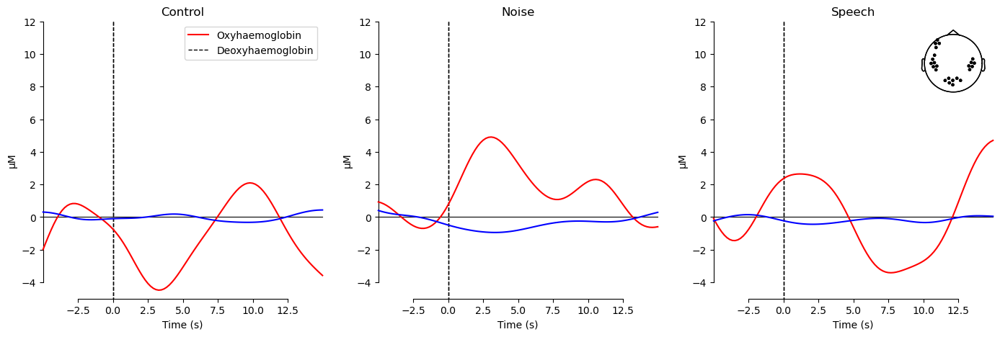

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Subject 04, Session 01: 60 epochs left
✅ sub-04 ses-01: 0 CN sig, 3 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 1
Participant 04, Session 01


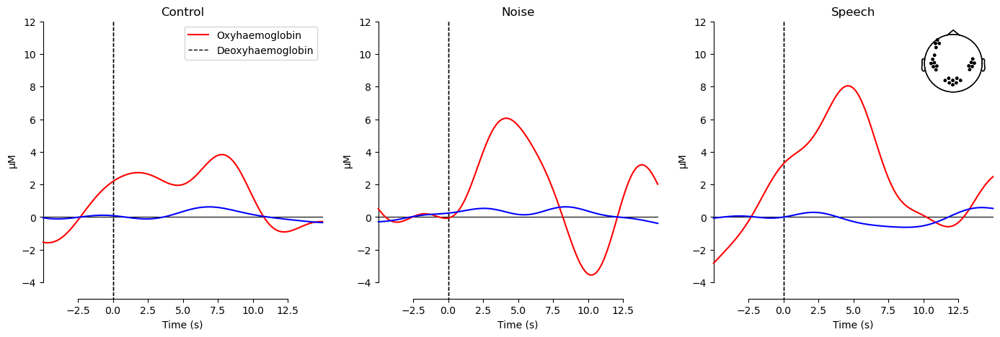

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 4
Subject 04, Session 02: 60 epochs left
✅ sub-04 ses-02: 23 CN sig, 22 CS sig; Control epochs removed: 1; Noise epochs removed: 1; Speech epochs removed: 0
Participant 04, Session 02


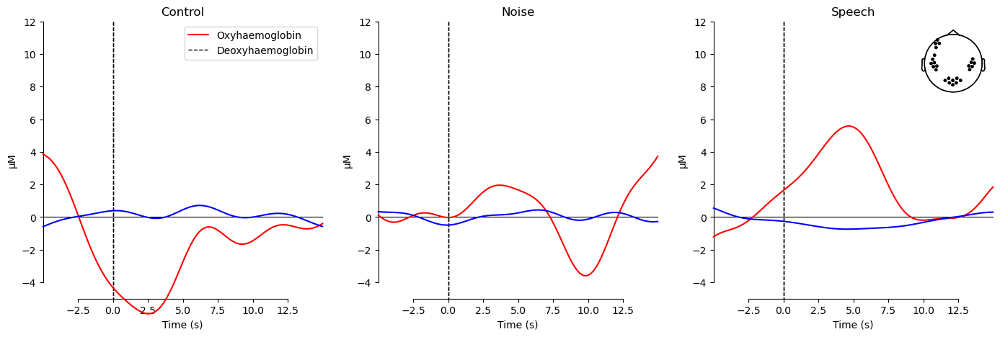

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830']
Number of bad channels: 8
Subject 05, Session 01: 60 epochs left
✅ sub-05 ses-01: 0 CN sig, 0 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 05, Session 01


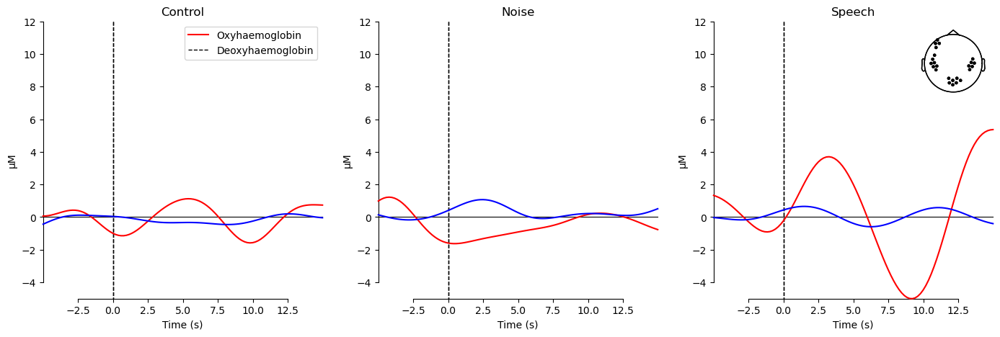

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830']
Number of bad channels: 4
Subject 05, Session 02: 47 epochs left
⚠️ Not enough epochs left for Subject 05, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D2 785', 'S4_D2 830', 'S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 10
Subject 06, Session 01: 59 epochs left
⚠️ Not enough epochs left for Subject 06, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Subje

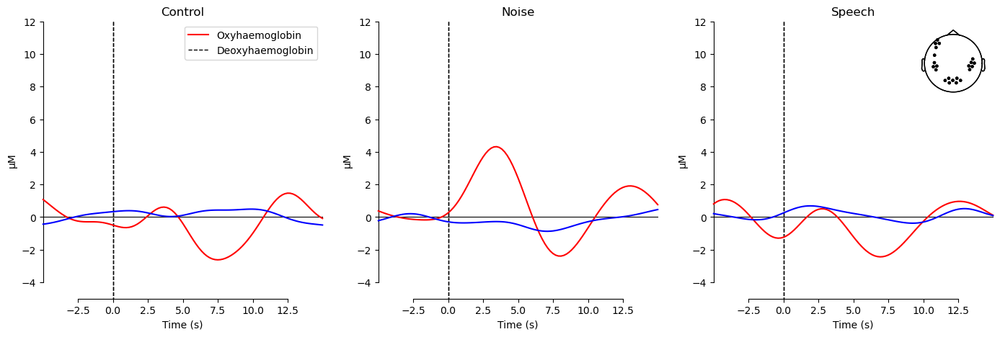

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830']
Number of bad channels: 8
Subject 07, Session 01: 60 epochs left
✅ sub-07 ses-01: 0 CN sig, 0 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 07, Session 01


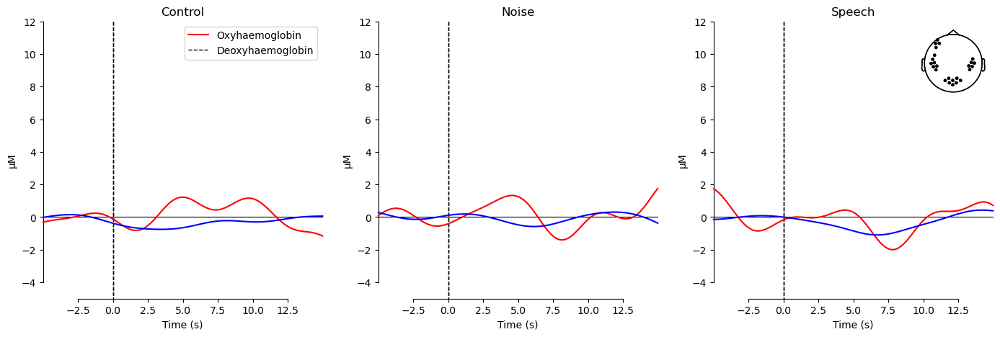

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 02: 60 epochs left
✅ sub-07 ses-02: 6 CN sig, 4 CS sig; Control epochs removed: 1; Noise epochs removed: 0; Speech epochs removed: 0
Participant 07, Session 02


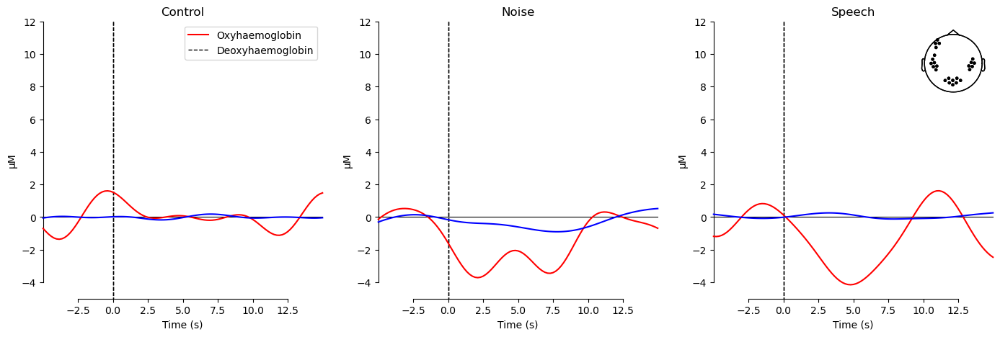

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 01: 59 epochs left
⚠️ Not enough epochs left for Subject 08, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 02: 60 epochs left
✅ sub-08 ses-02: 0 CN sig, 0 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 08, Session 02


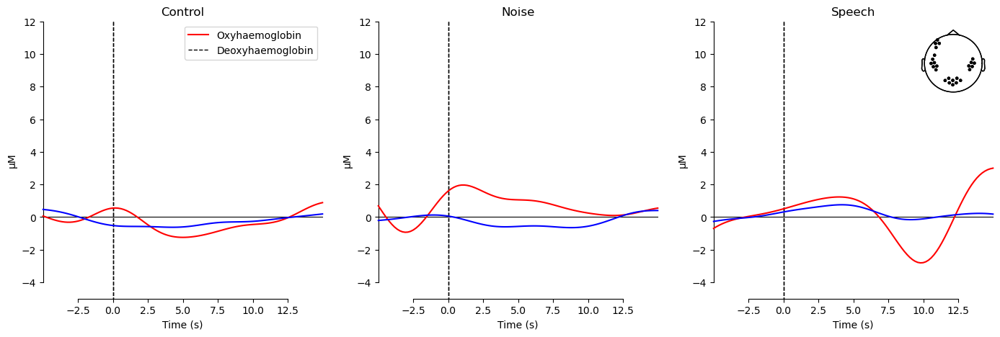

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S3_D2 785', 'S3_D2 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D18 785', 'S10_D18 830', 'S11_D11 785', 'S11_D11 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 52
Subject 09, Session 01: 60 epochs left
✅ sub-09 ses-01: 0 CN sig, 0 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs remove

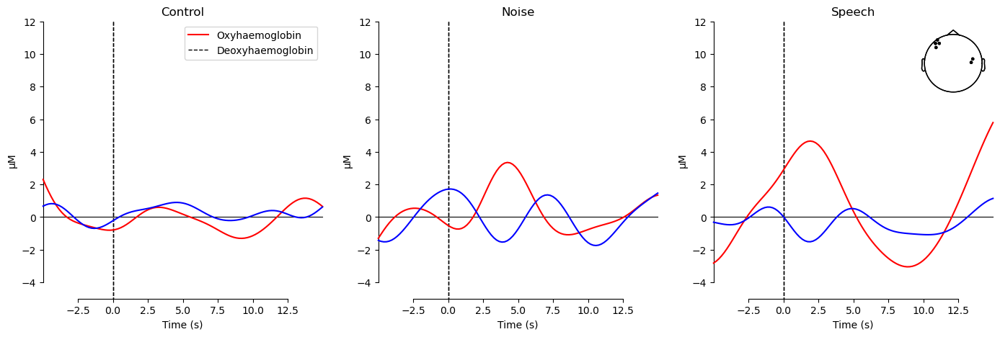

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830', 'S11_D11 785', 'S11_D11 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 50
Subject 09, Session 02: 60 epochs left
✅ sub-09 ses-02: 0 CN sig, 0 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 09, Ses

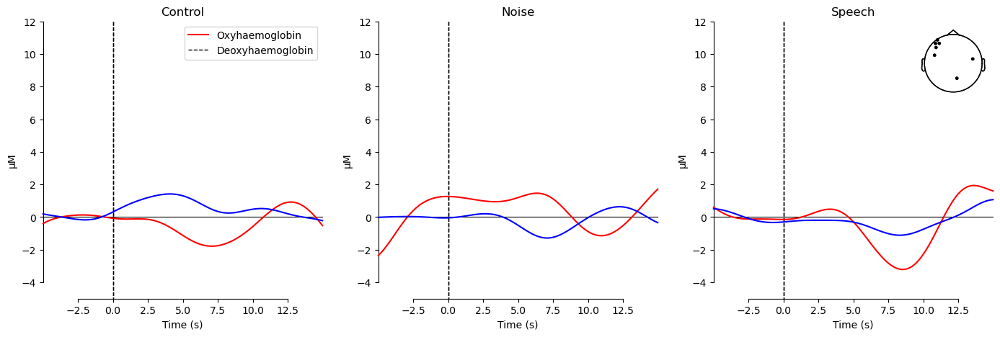

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Subject 10, Session 01: 60 epochs left
✅ sub-10 ses-01: 0 CN sig, 0 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 10, Session 01


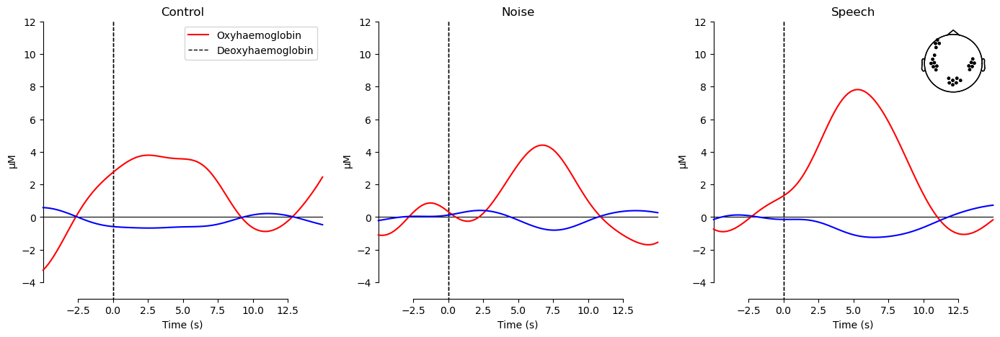

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830']
Number of bad channels: 4
Subject 10, Session 02: 8 epochs left
⚠️ Not enough epochs left for Subject 10, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 16
Subject 11, Session 01: 60 epochs left
✅ sub-11 ses-01: 0 CN sig, 0 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 11, Session 01


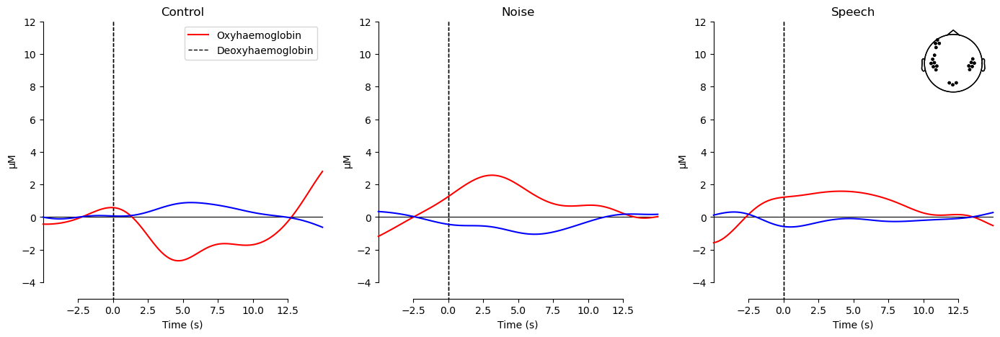

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 11, Session 02: 60 epochs left
✅ sub-11 ses-02: 0 CN sig, 1 CS sig; Control epochs removed: 1; Noise epochs removed: 0; Speech epochs removed: 0
Participant 11, Session 02


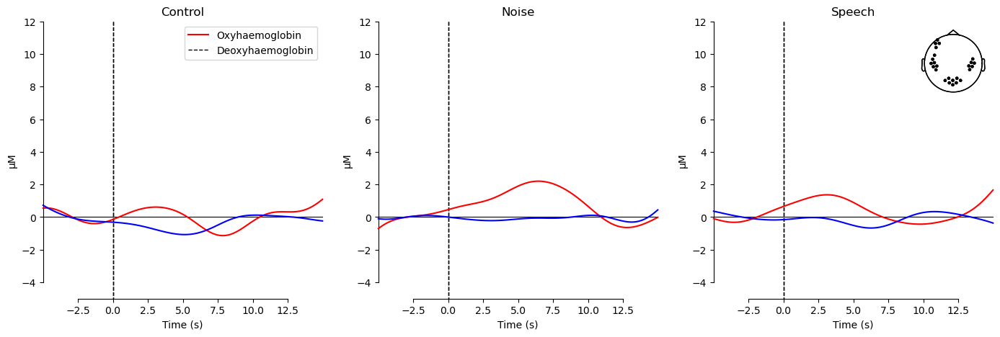

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830']
Number of bad channels: 4
Subject 12, Session 01: 59 epochs left
⚠️ Not enough epochs left for Subject 12, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830']
Number of bad channels: 4
Subject 12, Session 02: 60 epochs left
✅ sub-12 ses-02: 0 CN sig, 4 CS sig; Control epochs removed: 0; Noise epochs removed: 0; Speech epochs removed: 0
Participant 12, Session 02


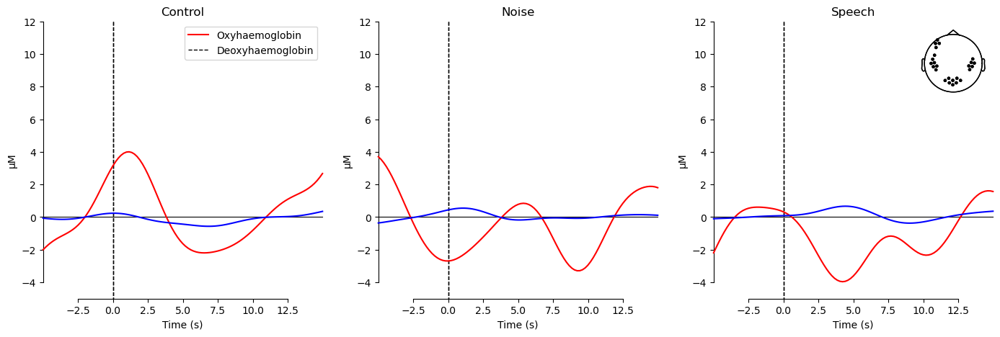

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 6
Subject 13, Session 01: 60 epochs left
✅ sub-13 ses-01: 0 CN sig, 0 CS sig; Control epochs removed: 1; Noise epochs removed: 0; Speech epochs removed: 0
Participant 13, Session 01


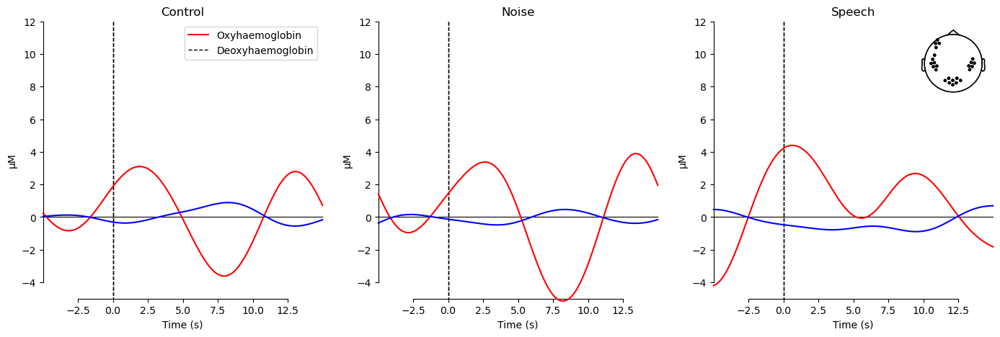

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 6
Subject 13, Session 02: 60 epochs left


KeyboardInterrupt: 

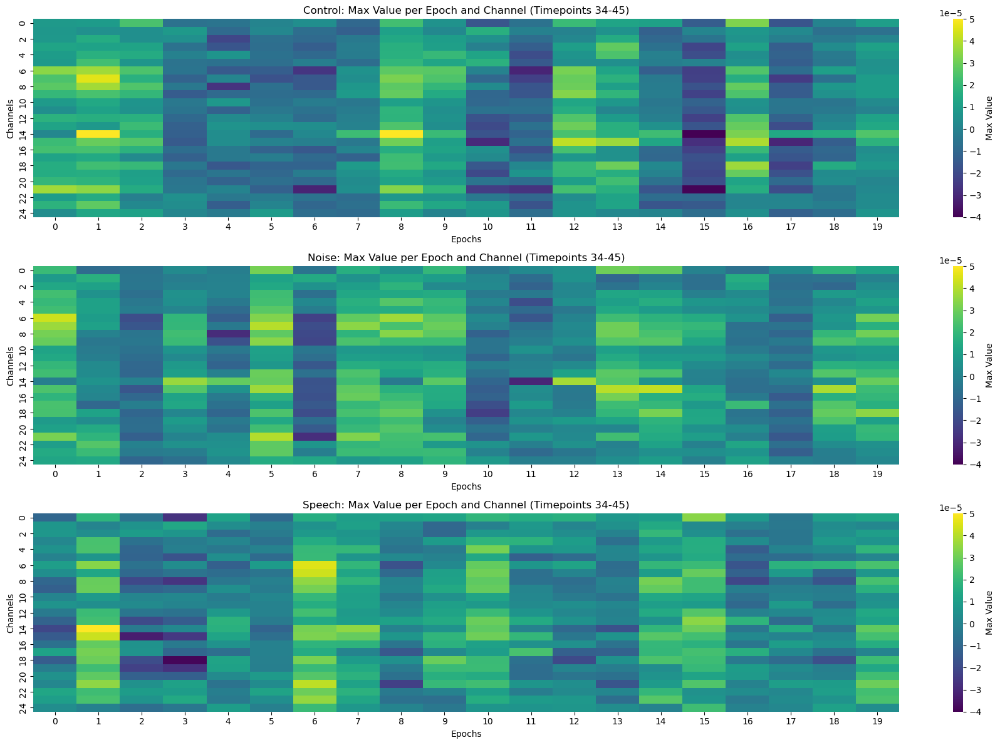

In [ ]:
import os
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import ttest_rel

# Create a root output directory
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

excluded_subjects = ["09", "20"]  # Example: exclude sub-01, sub-05, sub-08


# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
#subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers
subject_list = [s.replace("sub-", "") for s in subject_list if s.replace("sub-", "") not in excluded_subjects]

#subject_list = subject_list[:1]
print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])
global_results = []

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1,3):  
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 60:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        
        # === Create output directory for this subject/session ===
        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Clean and prepare data ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)

        # Get only HbO channels
        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        # Time slice
        time_slice = data[:, :, 34:46]
        max_values = np.max(time_slice, axis=2)

        # Indices by condition
        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        # === Plot before outlier removal ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max, noise_max, speech_max])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Timepoints 34-45)')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_before_outlier_removal.png"))
        plt.close()

        # === Outlier removal ===
        def remove_outliers_modified_zscore(matrix, epoch_indices, threshold=3.5):
            medians = np.median(matrix, axis=1)
            mad = np.median(np.abs(medians - np.median(medians)))
            modified_z_scores = 0.6745 * (medians - np.median(medians)) / mad
            outlier_indices = np.where(np.abs(modified_z_scores) > threshold)[0]
            non_outlier_indices = np.setdiff1d(np.arange(matrix.shape[0]), outlier_indices)
            non_outlier_mean = np.mean(matrix[non_outlier_indices], axis=0)
            matrix[outlier_indices] = non_outlier_mean
            removed_epochs = epoch_indices[outlier_indices]
            return matrix, outlier_indices, removed_epochs

        control_max_cleaned, outier_indices_control, removed_epochs_control = remove_outliers_modified_zscore(control_max.copy(), control_idx)
        noise_max_cleaned, outier_indices_noise, removed_epochs_noise = remove_outliers_modified_zscore(noise_max.copy(), noise_idx)
        speech_max_cleaned, outier_indices_speech, removed_epochs_speech = remove_outliers_modified_zscore(speech_max.copy(), speech_idx)

        # === Plot after outlier removal ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max_cleaned, noise_max_cleaned, speech_max_cleaned])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Timepoints 34-45) - Cleaned')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_after_outlier_removal.png"))
        plt.close()

        # === Paired t-tests ===
        min_epochs = min(control_max_cleaned.shape[0], noise_max_cleaned.shape[0], speech_max_cleaned.shape[0])
        control_trimmed = control_max_cleaned[:min_epochs, :]
        noise_trimmed = noise_max_cleaned[:min_epochs, :]
        speech_trimmed = speech_max_cleaned[:min_epochs, :]

        p_cn = np.array([ttest_rel(control_trimmed[:, ch], noise_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        p_cs = np.array([ttest_rel(control_trimmed[:, ch], speech_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        ch_names = hbo_data.info['ch_names']

        # === Significant channels ===
        sig_cn = [ch_names[i] for i in np.where(p_cn < 0.05)[0]]
        sig_cs = [ch_names[i] for i in np.where(p_cs < 0.05)[0]]

        # === Save significant channels to CSV ===
        results_df = pd.DataFrame({
            "Condition": ["Control vs Noise"] * len(sig_cn) + ["Control vs Speech"] * len(sig_cs),
            "Channel": sig_cn + sig_cs,
        })
        results_df.to_csv(os.path.join(output_dir, "significant_channels.csv"), index=False)

        for ch in sig_cn:
            global_results.append({
                "Subject": f"sub-{sub}",
                "Session": f"ses-{ses:02d}",
                "Condition": "Control vs Noise",
                "Channel": ch
            })

        for ch in sig_cs:
            global_results.append({
                "Subject": f"sub-{sub}",
                "Session": f"ses-{ses:02d}",
                "Condition": "Control vs Speech",
                "Channel": ch
            })

        
        # Optional print
        print(f"✅ sub-{sub} ses-{ses:02d}: {len(sig_cn)} CN sig, {len(sig_cs)} CS sig; Control epochs removed: {len(outier_indices_control)}; Noise epochs removed: {len(outier_indices_noise)}; Speech epochs removed: {len(outier_indices_speech)}")
        
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition])

# Save global results after loop
global_df = pd.DataFrame(global_results)
global_csv_path = os.path.join(output_root, "global_significant_channels.csv")
global_df.to_csv(global_csv_path, index=False)

print(f"\n🌍 Global significant channels saved to: {global_csv_path}")


# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


In [576]:

# === Configuration ===
REMOVE_OUTLIERS = False  # Set to False to skip outlier removal

# Create a root output directory
output_root = "individual_analysis_outputs_tDetrending"
os.makedirs(output_root, exist_ok=True)
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
#subject_list = subject_list[4:5]  # For testing, limit to one subject
print("Detected subjects:", subject_list)



subjects_df = pd.DataFrame(columns=["subject", "session"])
global_results = []
bad_channels_list = []


def remove_outliers_modified_zscore(matrix, epoch_indices, threshold=3.5):
    medians = np.median(matrix, axis=1)
    mad = np.median(np.abs(medians - np.median(medians)))
    modified_z_scores = 0.6745 * (medians - np.median(medians)) / mad
    outlier_indices = np.where(np.abs(modified_z_scores) > threshold)[0]
    non_outlier_indices = np.setdiff1d(np.arange(matrix.shape[0]), outlier_indices)
    non_outlier_mean = np.mean(matrix[non_outlier_indices], axis=0)
    matrix[outlier_indices] = non_outlier_mean
    removed_epochs = epoch_indices[outlier_indices]
    return matrix, outlier_indices, removed_epochs

for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None or len(epochs) < 10:
            print(f"⚠️ Not enough data for sub-{sub} ses-{ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        bad_ch = epochs.info['bads']
        
        bad_channels_list.append({
            "Subject": f"sub-{sub}",
            "Session": f"ses-{ses:02d}",
            "Bad_Channels": ', '.join(bad_ch)  # join them into a single string
        })

        epochs.drop_channels(bad_ch)
        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        # Use events AFTER bad epochs have been rejected
        ev = epochs.events[:, 2]  # only surviving epochs
        index_column = np.arange(0, len(ev)).reshape(-1, 1)  # indices 0,1,2,...,len(ev)-1
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))
        
        time_slice = data[:, :, 44:55]  # Timepoints 34 to 45 (inclusive)
        #time_slice = data[:, :, 34:46]
        max_values = np.max(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        if REMOVE_OUTLIERS:
            control_max_cleaned, outier_indices_control, removed_epochs_control = remove_outliers_modified_zscore(control_max.copy(), control_idx)
            noise_max_cleaned, outier_indices_noise, removed_epochs_noise = remove_outliers_modified_zscore(noise_max.copy(), noise_idx)
            speech_max_cleaned, outier_indices_speech, removed_epochs_speech = remove_outliers_modified_zscore(speech_max.copy(), speech_idx)
        else:
            control_max_cleaned = control_max.copy()
            noise_max_cleaned = noise_max.copy()
            speech_max_cleaned = speech_max.copy()
            outier_indices_control = outier_indices_noise = outier_indices_speech = []
            removed_epochs_control = removed_epochs_noise = removed_epochs_speech = []

        filename_suffix = "after_outlier_removal" if REMOVE_OUTLIERS else "raw_no_outlier_removal"

        # Plot heatmaps
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max_cleaned, noise_max_cleaned, speech_max_cleaned])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel - {filename_suffix}')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"heatmaps_{filename_suffix}.png"))
        plt.close()

        # Paired t-tests
        # Find maximum number of epochs across conditions
        max_epochs = max(control_max_cleaned.shape[0], noise_max_cleaned.shape[0], speech_max_cleaned.shape[0])

        def extend_epochs(matrix, target_len):
            if matrix.shape[0] >= target_len:
                return matrix
            mean_row = np.mean(matrix, axis=0, keepdims=True)
            num_to_add = target_len - matrix.shape[0]
            extra_rows = np.repeat(mean_row, num_to_add, axis=0)
            return np.vstack((matrix, extra_rows))

        # Extend each condition to match max length
        control_trimmed = extend_epochs(control_max_cleaned, max_epochs)
        noise_trimmed = extend_epochs(noise_max_cleaned, max_epochs)
        speech_trimmed = extend_epochs(speech_max_cleaned, max_epochs)
        
        # Plot heatmaps
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_trimmed, noise_trimmed, speech_trimmed])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel - {filename_suffix} - Extended')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"heatmaps_{filename_suffix}_Extended.png"))
        plt.close()


        p_cn = np.array([ttest_rel(control_trimmed[:, ch], noise_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        p_cs = np.array([ttest_rel(control_trimmed[:, ch], speech_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        ch_names = hbo_data.info['ch_names']

        sig_cn = [ch_names[i] for i in np.where(p_cn < 0.05)[0]]
        sig_cs = [ch_names[i] for i in np.where(p_cs < 0.05)[0]]

        results_df = pd.DataFrame({
            "Condition": ["Control vs Noise"] * len(sig_cn) + ["Control vs Speech"] * len(sig_cs),
            "Channel": sig_cn + sig_cs,
        })
        results_df.to_csv(os.path.join(output_dir, "significant_channels.csv"), index=False)

        for ch in sig_cn:
            global_results.append({"Subject": f"sub-{sub}", "Session": f"ses-{ses:02d}", "Condition": "Control vs Noise", "Channel": ch})
        for ch in sig_cs:
            global_results.append({"Subject": f"sub-{sub}", "Session": f"ses-{ses:02d}", "Condition": "Control vs Speech", "Channel": ch})

        print(f"✅ sub-{sub} ses-{ses:02d}: {len(sig_cn)} CN sig, {len(sig_cs)} CS sig; Outlier removal: {'ON' if REMOVE_OUTLIERS else 'OFF'}")

        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)

# Save global results
global_df = pd.DataFrame(global_results)
global_csv_path = os.path.join(output_root, "global_significant_channels_outliers_in.csv")
global_df.to_csv(global_csv_path, index=False)
print(f"\n🌍 Global significant channels saved to: {global_csv_path}")

bad_channels_df = pd.DataFrame(bad_channels_list)
bad_channels_path = os.path.join(output_root, "bad_channels_per_subject_session.csv")
bad_channels_df.to_csv(bad_channels_path, index=False)

print(f"\n❗ Bad channels per subject/session saved to: {bad_channels_path}")


subjects_df.to_csv("subjects_df.csv", index=True)  # Save subjects session participation


Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
✅ sub-01 ses-01: 6 CN sig, 7 CS sig; Outlier removal: OFF
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
✅ sub-01 ses-02: 0 CN sig, 2 CS sig; Outlier removal: OFF
Re

In [578]:
import pandas as pd

# Load the global CSV
global_df = pd.read_csv("individual_analysis_outputs_tDetrending/global_significant_channels_outliers_in.csv")  # Change path if needed

# Function to count channel repetitions for a specific condition
def count_channels(df, condition_name):
    filtered = df[df["Condition"] == condition_name]
    channel_counts = filtered["Channel"].value_counts().reset_index()
    channel_counts.columns = ["Channel", "Count"]
    return channel_counts

# Get counts for both conditions
control_vs_noise_counts = count_channels(global_df, "Control vs Noise")
control_vs_speech_counts = count_channels(global_df, "Control vs Speech")

# Save to separate CSVs
control_vs_noise_counts.to_csv("significant_channels_Detrending_control_vs_noise_outliers_in.csv", index=False)
control_vs_speech_counts.to_csv("significant_channels_Detrending_control_vs_speech_outliers_in.csv", index=False)

print(control_vs_noise_counts)

        Channel  Count
0   S10_D11 hbo     10
1   S11_D12 hbo     10
2   S11_D11 hbo     10
3     S5_D2 hbo      7
4     S5_D3 hbo      7
5   S10_D12 hbo      7
6    S10_D9 hbo      7
7   S10_D10 hbo      6
8     S5_D5 hbo      5
9    S12_D1 hbo      5
10    S5_D4 hbo      5
11    S8_D7 hbo      5
12    S1_D1 hbo      5
13    S7_D7 hbo      4
14    S4_D2 hbo      4
15    S2_D1 hbo      4
16    S3_D1 hbo      4
17    S3_D2 hbo      4
18    S4_D3 hbo      3
19    S6_D8 hbo      3
20    S7_D6 hbo      2
21    S9_D8 hbo      2
22    S7_D8 hbo      2
23    S8_D8 hbo      1
24    S6_D6 hbo      1


In [580]:
import pandas as pd

# Load the global CSV
global_df = pd.read_csv("individual_analysis_outputs_tDetrending/global_significant_channels_outliers_in.csv")  # Change path if needed

# Function to count channel repetitions and list subjects/sessions
def count_channels(df, condition_name):
    filtered = df[df["Condition"] == condition_name]
    
    # Group by Channel, aggregate count and list subjects/sessions
    channel_summary = (
        filtered.groupby("Channel")
        .agg(
            Count=("Channel", "size"),
            Subjects_Sessions=("Subject", lambda x: [
                f"{sub}_{ses}" for sub, ses in zip(filtered.loc[x.index, "Subject"], filtered.loc[x.index, "Session"])
            ])
        )
        .reset_index()
    )
    
    # Convert Subjects_Sessions list to a comma-separated string
    channel_summary["Subjects_Sessions"] = channel_summary["Subjects_Sessions"].apply(lambda x: ", ".join(x))
    
    # Sort by Count descending
    channel_summary = channel_summary.sort_values(by="Count", ascending=False).reset_index(drop=True)
    
    return channel_summary

# Get counts for both conditions
control_vs_noise_counts = count_channels(global_df, "Control vs Noise")
control_vs_speech_counts = count_channels(global_df, "Control vs Speech")

# Save to separate CSVs
control_vs_noise_counts.to_csv("significant_channels_Detrending_control_vs_noise_outliers_in.csv", index=False)
control_vs_speech_counts.to_csv("significant_channels_Detrending_control_vs_speech_outliers_in.csv", index=False)

# Print
print(control_vs_noise_counts)
print(control_vs_speech_counts)


        Channel  Count                                  Subjects_Sessions
0   S10_D11 hbo     10  sub-01_ses-01, sub-02_ses-02, sub-03_ses-02, s...
1   S11_D12 hbo     10  sub-01_ses-01, sub-02_ses-02, sub-03_ses-02, s...
2   S11_D11 hbo     10  sub-01_ses-01, sub-02_ses-02, sub-13_ses-02, s...
3    S10_D9 hbo      7  sub-04_ses-02, sub-07_ses-02, sub-08_ses-01, s...
4   S10_D12 hbo      7  sub-01_ses-01, sub-02_ses-02, sub-04_ses-02, s...
5     S5_D2 hbo      7  sub-01_ses-01, sub-02_ses-02, sub-03_ses-02, s...
6     S5_D3 hbo      7  sub-01_ses-01, sub-04_ses-02, sub-08_ses-01, s...
7   S10_D10 hbo      6  sub-04_ses-02, sub-14_ses-01, sub-20_ses-01, s...
8    S12_D1 hbo      5  sub-08_ses-01, sub-11_ses-01, sub-14_ses-01, s...
9     S8_D7 hbo      5  sub-03_ses-02, sub-04_ses-02, sub-07_ses-02, s...
10    S1_D1 hbo      5  sub-04_ses-02, sub-08_ses-01, sub-14_ses-01, s...
11    S5_D5 hbo      5  sub-02_ses-02, sub-04_ses-02, sub-08_ses-01, s...
12    S5_D4 hbo      5  sub-08_ses-01,

In [ ]:
import pandas as pd

# === Load the bad channels CSV ===
bad_channels_df = pd.read_csv("individual_analysis_outputs/bad_channels_per_subject_session.csv")

# === Create a list to store all bad channels ===
all_bad_channels = []

# Loop through each row and split the channels
for bads in bad_channels_df["Bad_Channels"].dropna():  # drop NaNs (sessions with no bad channels)
    channels = [ch.strip() for ch in bads.split(",")]  # split and remove extra spaces
    all_bad_channels.extend(channels)

# === Filter to keep only channels ending with "hbo" ===
hbo_bad_channels = [ch for ch in all_bad_channels if ch.endswith("hbo")]

# === Count how many times each HbO channel appears ===
hbo_bad_channel_counts = pd.Series(hbo_bad_channels).value_counts().reset_index()
hbo_bad_channel_counts.columns = ["Channel", "Count"]

# === Save to CSV ===
hbo_bad_channel_counts.to_csv("individual_analysis_outputs/hbo_bad_channel_frequencies.csv", index=False)

print("\n✅ HbO bad channel counts saved to: individual_analysis_outputs/hbo_bad_channel_frequencies.csv")
print(hbo_bad_channel_counts)



✅ HbO bad channel counts saved to: individual_analysis_outputs/hbo_bad_channel_frequencies.csv
        Channel  Count
0     S7_D8 hbo     27
1     S7_D6 hbo     24
2     S9_D8 hbo     19
3     S6_D6 hbo     17
4     S5_D3 hbo     13
5     S7_D7 hbo     12
6     S8_D7 hbo     12
7     S6_D8 hbo     10
8     S8_D8 hbo     10
9    S10_D9 hbo      8
10    S5_D5 hbo      7
11  S10_D10 hbo      6
12  S10_D11 hbo      5
13    S5_D4 hbo      4
14    S5_D2 hbo      4
15  S10_D12 hbo      4
16    S4_D3 hbo      4
17    S4_D2 hbo      4
18    S3_D2 hbo      1


# Debug of <10 epochs problem

In [487]:

# === Configuration ===
REMOVE_OUTLIERS = False  # Set to False to skip outlier removal

# Create a root output directory
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# === Configuration for participant-session selection ===
selected_subject_sessions = [
    ("04", "01"),
    ("04", "02"),
    ("07", "01"),
    ("07", "02"),
    ("08", "01"),
    ("08", "02"),
    ("12", "01"),
    ("12", "02"),
    ("20", "01"),
]

print("Selected subject-session pairs:")
for subj, sess in selected_subject_sessions:
    print(f"sub-{subj} ses-{sess}")

subjects_df = pd.DataFrame(columns=["subject", "session"])
global_results = []
bad_channels_list = []



def remove_outliers_modified_zscore(matrix, epoch_indices, threshold=3.5):
    medians = np.median(matrix, axis=1)
    mad = np.median(np.abs(medians - np.median(medians)))
    modified_z_scores = 0.6745 * (medians - np.median(medians)) / mad
    outlier_indices = np.where(np.abs(modified_z_scores) > threshold)[0]
    non_outlier_indices = np.setdiff1d(np.arange(matrix.shape[0]), outlier_indices)
    non_outlier_mean = np.mean(matrix[non_outlier_indices], axis=0)
    matrix[outlier_indices] = non_outlier_mean
    removed_epochs = epoch_indices[outlier_indices]
    return matrix, outlier_indices, removed_epochs

for sub, ses in selected_subject_sessions:
    #for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=sub,
            session=ses,
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None or len(epochs) < 10:
            print(f"⚠️ Not enough data for sub-{sub} ses-{ses}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses}")
        os.makedirs(output_dir, exist_ok=True)

        bad_ch = epochs.info['bads']
        
        bad_channels_list.append({
            "Subject": f"sub-{sub}",
            "Session": f"ses-{ses}",
            "Bad_Channels": ', '.join(bad_ch)  # join them into a single string
        })

        epochs.drop_channels(bad_ch)
        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        # Use events AFTER bad epochs have been rejected
        ev = epochs.events[:, 2]  # only surviving epochs
        index_column = np.arange(0, len(ev)).reshape(-1, 1)  # indices 0,1,2,...,len(ev)-1
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        time_slice = data[:, :, 34:46]
        max_values = np.max(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        if REMOVE_OUTLIERS:
            control_max_cleaned, outier_indices_control, removed_epochs_control = remove_outliers_modified_zscore(control_max.copy(), control_idx)
            noise_max_cleaned, outier_indices_noise, removed_epochs_noise = remove_outliers_modified_zscore(noise_max.copy(), noise_idx)
            speech_max_cleaned, outier_indices_speech, removed_epochs_speech = remove_outliers_modified_zscore(speech_max.copy(), speech_idx)
        else:
            control_max_cleaned = control_max.copy()
            noise_max_cleaned = noise_max.copy()
            speech_max_cleaned = speech_max.copy()
            outier_indices_control = outier_indices_noise = outier_indices_speech = []
            removed_epochs_control = removed_epochs_noise = removed_epochs_speech = []

        filename_suffix = "after_outlier_removal" if REMOVE_OUTLIERS else "raw_no_outlier_removal"

        # Plot heatmaps
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max_cleaned, noise_max_cleaned, speech_max_cleaned])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel - {filename_suffix}')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"heatmaps_{filename_suffix}.png"))
        plt.close()

        # Paired t-tests
        # Find maximum number of epochs across conditions
        max_epochs = max(control_max_cleaned.shape[0], noise_max_cleaned.shape[0], speech_max_cleaned.shape[0])

        def extend_epochs(matrix, target_len):
            if matrix.shape[0] >= target_len:
                return matrix
            mean_row = np.mean(matrix, axis=0, keepdims=True)
            num_to_add = target_len - matrix.shape[0]
            extra_rows = np.repeat(mean_row, num_to_add, axis=0)
            return np.vstack((matrix, extra_rows))

        # Extend each condition to match max length
        control_trimmed = extend_epochs(control_max_cleaned, max_epochs)
        noise_trimmed = extend_epochs(noise_max_cleaned, max_epochs)
        speech_trimmed = extend_epochs(speech_max_cleaned, max_epochs)
        
        # Plot heatmaps
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_trimmed, noise_trimmed, speech_trimmed])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel - {filename_suffix} - Extended')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"heatmaps_{filename_suffix}_Extended.png"))
        plt.close()


        p_cn = np.array([ttest_rel(control_trimmed[:, ch], noise_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        p_cs = np.array([ttest_rel(control_trimmed[:, ch], speech_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        ch_names = hbo_data.info['ch_names']

        sig_cn = [ch_names[i] for i in np.where(p_cn < 0.05)[0]]
        sig_cs = [ch_names[i] for i in np.where(p_cs < 0.05)[0]]

        results_df = pd.DataFrame({
            "Condition": ["Control vs Noise"] * len(sig_cn) + ["Control vs Speech"] * len(sig_cs),
            "Channel": sig_cn + sig_cs,
        })
        results_df.to_csv(os.path.join(output_dir, "significant_channels.csv"), index=False)

        for ch in sig_cn:
            global_results.append({"Subject": f"sub-{sub}", "Session": f"ses-{ses}", "Condition": "Control vs Noise", "Channel": ch})
        for ch in sig_cs:
            global_results.append({"Subject": f"sub-{sub}", "Session": f"ses-{ses}", "Condition": "Control vs Speech", "Channel": ch})

        print(f"✅ sub-{sub} ses-{ses}: {len(sig_cn)} CN sig, {len(sig_cs)} CS sig; Outlier removal: {'ON' if REMOVE_OUTLIERS else 'OFF'}")

        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)

# Save global results
global_df = pd.DataFrame(global_results)
global_csv_path = os.path.join(output_root, "global_significant_channels_outliers_in.csv")
global_df.to_csv(global_csv_path, index=False)
print(f"\n🌍 Global significant channels saved to: {global_csv_path}")

bad_channels_df = pd.DataFrame(bad_channels_list)
bad_channels_path = os.path.join(output_root, "bad_channels_per_subject_session.csv")
bad_channels_df.to_csv(bad_channels_path, index=False)

print(f"\n❗ Bad channels per subject/session saved to: {bad_channels_path}")


subjects_df.to_csv("subjects_df.csv", index=True)  # Save subjects session participation


Selected subject-session pairs:
sub-04 ses-01
sub-04 ses-02
sub-07 ses-01
sub-07 ses-02
sub-08 ses-01
sub-08 ses-02
sub-12 ses-01
sub-12 ses-02
sub-20 ses-01
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
✅ sub-04 ses-01: 1 CN sig, 2 CS sig; Outlier removal: OFF
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
✅ sub-04 ses-02: 11 CN sig, 12 CS sig; Outlier removal: OFF
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785'

In [488]:
import pandas as pd

# Load the global CSV
global_df = pd.read_csv("individual_analysis_outputs/global_significant_channels_outliers_out.csv")  # Change path if needed

# Function to count channel repetitions for a specific condition
def count_channels(df, condition_name):
    filtered = df[df["Condition"] == condition_name]
    channel_counts = filtered["Channel"].value_counts().reset_index()
    channel_counts.columns = ["Channel", "Count"]
    return channel_counts

# Get counts for both conditions
control_vs_noise_counts = count_channels(global_df, "Control vs Noise")
control_vs_speech_counts = count_channels(global_df, "Control vs Speech")

print(control_vs_noise_counts)
print(control_vs_speech_counts)


        Channel  Count
0     S1_D1 hbo      3
1     S7_D7 hbo      3
2   S11_D11 hbo      3
3   S10_D10 hbo      2
4     S2_D1 hbo      2
5     S4_D2 hbo      2
6     S8_D7 hbo      2
7     S6_D8 hbo      2
8   S10_D12 hbo      1
9     S3_D2 hbo      1
10    S5_D5 hbo      1
11    S5_D2 hbo      1
12  S10_D11 hbo      1
13   S10_D9 hbo      1
14    S7_D6 hbo      1
15    S3_D1 hbo      1
16    S4_D3 hbo      1
17    S5_D3 hbo      1
18  S11_D12 hbo      1
        Channel  Count
0     S5_D3 hbo      4
1   S10_D12 hbo      4
2     S8_D7 hbo      4
3     S8_D8 hbo      3
4     S5_D4 hbo      3
5     S5_D5 hbo      3
6     S7_D7 hbo      3
7   S10_D10 hbo      3
8   S10_D11 hbo      3
9    S10_D9 hbo      3
10    S1_D1 hbo      2
11    S7_D6 hbo      2
12    S5_D2 hbo      2
13    S3_D2 hbo      2
14  S11_D11 hbo      2
15    S4_D3 hbo      1
16    S4_D2 hbo      1
17    S6_D8 hbo      1
18    S6_D6 hbo      1


# Mean Interval all participants

In [75]:
""" from mne import grand_average
# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"
subject_list = sorted([d.replace("sub-", "") for d in os.listdir(bids_root) if d.startswith("sub-")])
#subject_list = subject_list[:5]  # For testing, limit to one subject
print("Detected subjects:", subject_list)

all_evokeds = defaultdict(list)
subjects_df = pd.DataFrame(columns=["subject", "session"])

# === Process each subject and session ===
for sub in subject_list:
    for ses in range(1, 3):  # Session 1 and 2
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None or len(epochs) < 10:
            print(f"⚠️ Skipping Subject {sub}, Session {ses:02d} (not enough data)")
            continue

        print(f"✅ Processing Subject {sub}, Session {ses:02d} with {len(epochs)} epochs")

        # Save subject/session info
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)

        # Compute evoked per condition
        for condition in epochs.event_id:
            evoked = epochs[condition].average()
            all_evokeds[condition].append(evoked)

# === After looping through all participants ===

# Grand average per condition
grand_averages = {}
for condition, evokeds in all_evokeds.items():
    grand_avg = grand_average(evokeds)
    grand_averages[condition] = grand_avg

# Extract max and min between 4 and 6 seconds
max_min_results = []

for condition, grand_avg in grand_averages.items():
    times = grand_avg.times  # time vector
    mask = (times >= 4.0) & (times <= 6.0)
    data = grand_avg.data[:, mask]  # channels x selected time points

    max_val = np.max(data)
    min_val = np.min(data)

    print(f"🔹 Condition '{condition}': Max = {max_val:.4e}, Min = {min_val:.4e}")

    max_min_results.append({
        "Condition": condition,
        "Max_4-6s": max_val,
        "Min_4-6s": min_val
    })

# Save max/min results
max_min_df = pd.DataFrame(max_min_results)
max_min_csv_path = os.path.join(output_root, "grand_average_max_min_4_6s.csv")
max_min_df.to_csv(max_min_csv_path, index=False)

print(f"\n📝 Grand average max/min values saved to: {max_min_csv_path}")
# Save subject/session dataframe
subjects_df.to_csv(os.path.join(output_root, "subjects_df.csv"), index=False)
print(f"📝 Subjects dataframe saved to: {os.path.join(output_root, 'subjects_df.csv')}") """

<>:1: SyntaxWarning: invalid escape sequence '\D'
<>:1: SyntaxWarning: invalid escape sequence '\D'
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1251248373.py:1: SyntaxWarning: invalid escape sequence '\D'
  """ from mne import grand_average


' from mne import grand_average\n# === Setup ===\noutput_root = "individual_analysis_outputs"\nos.makedirs(output_root, exist_ok=True)\n\nbids_root = r"C:\\Datasets\\Test-retest study\x08ids_dataset"\nsubject_list = sorted([d.replace("sub-", "") for d in os.listdir(bids_root) if d.startswith("sub-")])\n#subject_list = subject_list[:5]  # For testing, limit to one subject\nprint("Detected subjects:", subject_list)\n\nall_evokeds = defaultdict(list)\nsubjects_df = pd.DataFrame(columns=["subject", "session"])\n\n# === Process each subject and session ===\nfor sub in subject_list:\n    for ses in range(1, 3):  # Session 1 and 2\n        bids_path = BIDSPath(\n            subject=f"{sub}",\n            session=f"{ses:02d}",\n            task="auditory",\n            datatype="nirs",\n            root=bids_root,\n            suffix="nirs",\n            extension=".snirf",\n        )\n\n        # Analyse data\n        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_pa

In [7]:
# === Paths ===
bids_root = r"C:\Datasets\Test-retest study\bids_dataset"
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)

# === List subjects ===
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
print("Detected subjects:", subject_list)

# === Storage ===
all_evokeds = defaultdict(list)
max_min_results = []

# === Loop over subjects and sessions ===
for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Load your data
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)
        
        if raw_haemo is None or len(epochs) < 10:
            print(f"⚠️ Skipping sub-{sub} ses-{ses:02d} (not enough channels or epochs)")
            continue

        # Create subject/session output directory
        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # Drop bad channels
        epochs.drop_channels(epochs.info['bads'])

        # Pick only HbO
        hbo_epochs = epochs.copy().pick("hbo")

        # === Compute individual evokeds ===
        indiv_evoked = {}
        for condition in hbo_epochs.event_id:
            evoked = hbo_epochs[condition].average()
            indiv_evoked[condition] = evoked
            all_evokeds[condition].append(evoked)

            # Extract max/min between 4 and 6 seconds
            times = evoked.times
            idx = np.where((times >= 0) & (times <= 7.5))[0]

            if len(idx) == 0:
                print(f"⚠️ No time points between 4-6s for sub-{sub} ses-{ses:02d} condition {condition}")
                continue

            signal = evoked.data[:, idx]  # (n_channels, selected_times)
            max_val = np.max(signal)
            min_val = np.min(signal)

            max_min_results.append({
                "Subject": f"sub-{sub}",
                "Session": f"ses-{ses:02d}",
                "Condition": condition,
                "Max_4to6s": max_val,
                "Min_4to6s": min_val
            })

        print(f"✅ Finished sub-{sub} ses-{ses:02d}")

# === Save the Max/Min results ===
max_min_df = pd.DataFrame(max_min_results)
max_min_df_path = os.path.join(output_root, "max_min_per_subject.csv")
max_min_df.to_csv(max_min_df_path, index=False)
print(f"📄 Max/Min results saved to {max_min_df_path}")

# === Compute grand averages and SDs ===
#grand_averages = {}
grand_average_max_min = []

for condition, evokeds in all_evokeds.items():
    # print(condition)
    # grand_avg = grand_average(evokeds)
    # grand_averages[condition] = grand_avg

    # Collect all subjects' max/min values for this condition
    condition_max_values = max_min_df[max_min_df['Condition'] == condition]['Max_4to6s'].values
    condition_min_values = max_min_df[max_min_df['Condition'] == condition]['Min_4to6s'].values

    grand_average_max_min.append({
        "Condition": condition,
        "Max_4-6s": np.mean(condition_max_values),
        "SD_Max_4-6s": np.std(condition_max_values, ddof=1),
        "Min_4-6s": np.mean(condition_min_values),
        "SD_Min_4-6s": np.std(condition_min_values, ddof=1)
    })

# Save the grand average max/min (+ SD) to CSV
grand_avg_df = pd.DataFrame(grand_average_max_min)
grand_avg_df_path = os.path.join(output_root, "grand_average_NO_SCH_max_min_0_7.5s.csv")
grand_avg_df.to_csv(grand_avg_df_path, index=False)
print(f"📄 Grand average (mean + SD) saved to {grand_avg_df_path}")





Detected subjects: ['01', '02', '03', '04', '05', '07', '08', '10', '11', '12', '13', '16', '17', '19', '21', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
✅ Finished sub-01 ses-01
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channe

In [53]:
import pandas as pd
import os

# === Step 1: Load the CSVs ===
output_root = 'individual_analysis_outputs'
max_min_df = pd.read_csv(os.path.join(output_root, "max_min_per_subject.csv"))
grand_avg_df = pd.read_csv(os.path.join(output_root, "grand_average_max_min_4_6s.csv"))

# === Step 2: Create lists to store flagged subjects ===
larger_maxima = []
lower_minima = []

# === Step 3: Row-by-row comparison ===
for idx, row in max_min_df.iterrows():
    subject = row['Subject']
    session = row['Session']
    condition = row['Condition']
    subj_max = row['Max_4to6s']
    subj_min = row['Min_4to6s']

    # Find corresponding grand average and SD for this condition
    grand_row = grand_avg_df[grand_avg_df['Condition'] == condition]
    if grand_row.empty:
        print(f"⚠️ No grand average found for condition {condition}")
        continue

    grand_max = grand_row['Max_4-6s'].values[0]
    grand_min = grand_row['Min_4-6s'].values[0]
    grand_max_sd = grand_row['SD_Max_4-6s'].values[0]
    grand_min_sd = grand_row['SD_Min_4-6s'].values[0]

    # Define acceptance bounds
    lower_bound = grand_min - 2 * grand_min_sd
    upper_bound = grand_max + 2 * grand_max_sd

    # Compare maxima
    if subj_max > upper_bound:
        larger_maxima.append({
            "Subject": subject,
            "Session": session,
            "Condition": condition,
            "Subject_Max": subj_max,
            "Upper_Bound": upper_bound
        })

    # Compare minima
    if subj_min < lower_bound:
        lower_minima.append({
            "Subject": subject,
            "Session": session,
            "Condition": condition,
            "Subject_Min": subj_min,
            "Lower_Bound": lower_bound
        })

# === Step 4: Convert to DataFrames for easier saving/printing ===
larger_maxima_df = pd.DataFrame(larger_maxima)
lower_minima_df = pd.DataFrame(lower_minima)

# === Step 5: Save to CSVs ===
larger_maxima_df.to_csv(os.path.join(output_root, "participants_with_larger_maxima.csv"), index=False)
lower_minima_df.to_csv(os.path.join(output_root, "participants_with_lower_minima.csv"), index=False)

# === Step 6: Print summary ===
print("\n🚀 Participants with Larger Maxima (outside acceptance range):")
print(larger_maxima_df)

print("\n🚀 Participants with Lower Minima (outside acceptance range):")
print(lower_minima_df)



🚀 Participants with Larger Maxima (outside acceptance range):
  Subject Session Condition  Subject_Max  Upper_Bound
0  sub-12  ses-01   Control     0.000009     0.000009
1  sub-14  ses-01     Noise     0.000019     0.000018
2  sub-14  ses-02     Noise     0.000018     0.000018
3  sub-18  ses-01   Control     0.000012     0.000009
4  sub-18  ses-02   Control     0.000011     0.000009
5  sub-20  ses-01    Speech     0.000030     0.000020

🚀 Participants with Lower Minima (outside acceptance range):
  Subject Session Condition  Subject_Min  Lower_Bound
0  sub-04  ses-02   Control    -0.000012    -0.000010
1  sub-05  ses-02     Noise    -0.000008    -0.000007
2  sub-11  ses-01   Control    -0.000013    -0.000010
3  sub-20  ses-02     Noise    -0.000008    -0.000007
4  sub-20  ses-02    Speech    -0.000014    -0.000011


# Epoch rejection global max and min

In [ ]:
import os
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import ttest_rel

# Create a root output directory
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers
subject_list = subject_list[:1]
print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])
global_results = []

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1,2):  
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 60:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        
        # === Create output directory for this subject/session ===
        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Clean and prepare data ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)

        # Get only HbO channels
        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        # Time slice
        time_slice = data[:, :, 44:55]
        max_values = np.max(time_slice, axis=2)

        # Indices by condition
        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        # === Plot before outlier removal ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max, noise_max, speech_max])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Timepoints 34-45)')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_before_outlier_removal.png"))
        plt.close()

        # === Outlier removal ===
        def remove_outliers_modified_zscore(matrix, epoch_indices, threshold=3.5):
            medians = np.median(matrix, axis=1)
            mad = np.median(np.abs(medians - np.median(medians)))
            modified_z_scores = 0.6745 * (medians - np.median(medians)) / mad
            outlier_indices = np.where(np.abs(modified_z_scores) > threshold)[0]
            non_outlier_indices = np.setdiff1d(np.arange(matrix.shape[0]), outlier_indices)
            non_outlier_mean = np.mean(matrix[non_outlier_indices], axis=0)
            matrix[outlier_indices] = non_outlier_mean
            removed_epochs = epoch_indices[outlier_indices]
            return matrix, outlier_indices, removed_epochs

        control_max_cleaned, outier_indices_control, removed_epochs_control = remove_outliers_modified_zscore(control_max.copy(), control_idx)
        noise_max_cleaned, outier_indices_noise, removed_epochs_noise = remove_outliers_modified_zscore(noise_max.copy(), noise_idx)
        speech_max_cleaned, outier_indices_speech, removed_epochs_speech = remove_outliers_modified_zscore(speech_max.copy(), speech_idx)

        # === Plot after outlier removal ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max_cleaned, noise_max_cleaned, speech_max_cleaned])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Timepoints 34-45) - Cleaned')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_after_outlier_removal.png"))
        plt.close()

        # === Paired t-tests ===
        min_epochs = min(control_max_cleaned.shape[0], noise_max_cleaned.shape[0], speech_max_cleaned.shape[0])
        control_trimmed = control_max_cleaned[:min_epochs, :]
        noise_trimmed = noise_max_cleaned[:min_epochs, :]
        speech_trimmed = speech_max_cleaned[:min_epochs, :]

        p_cn = np.array([ttest_rel(control_trimmed[:, ch], noise_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        p_cs = np.array([ttest_rel(control_trimmed[:, ch], speech_trimmed[:, ch])[1] for ch in range(control_trimmed.shape[1])])
        ch_names = hbo_data.info['ch_names']

        # === Significant channels ===
        sig_cn = [ch_names[i] for i in np.where(p_cn < 0.05)[0]]
        sig_cs = [ch_names[i] for i in np.where(p_cs < 0.05)[0]]

        # === Save significant channels to CSV ===
        results_df = pd.DataFrame({
            "Condition": ["Control vs Noise"] * len(sig_cn) + ["Control vs Speech"] * len(sig_cs),
            "Channel": sig_cn + sig_cs,
        })
        results_df.to_csv(os.path.join(output_dir, "significant_channels.csv"), index=False)

        for ch in sig_cn:
            global_results.append({
                "Subject": f"sub-{sub}",
                "Session": f"ses-{ses:02d}",
                "Condition": "Control vs Noise",
                "Channel": ch
            })

        for ch in sig_cs:
            global_results.append({
                "Subject": f"sub-{sub}",
                "Session": f"ses-{ses:02d}",
                "Condition": "Control vs Speech",
                "Channel": ch
            })

        
        # Optional print
        print(f"✅ sub-{sub} ses-{ses:02d}: {len(sig_cn)} CN sig, {len(sig_cs)} CS sig; Control epochs removed: {len(outier_indices_control)}; Noise epochs removed: {len(outier_indices_noise)}; Speech epochs removed: {len(outier_indices_speech)}")
        
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition])

# Save global results after loop
global_df = pd.DataFrame(global_results)
global_csv_path = os.path.join(output_root, "global_significant_channels.csv")
global_df.to_csv(global_csv_path, index=False)

print(f"\n🌍 Global significant channels saved to: {global_csv_path}")


# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


Detected subjects: ['01']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Subject 01, Session 01: 59 epochs left
🚫 Rejecting Epoch 1 in Control - Bad value in Channel 2 (Value: -1.34e-05)
🚫 Rejecting Epoch 6 in Control - Bad value in Channel 16 (Value: 2.82e-05)
🚫 Rejecting Epoch 10 in Control - Bad value in Channel 0 (Value: 2.14e-05)
🚫 Rejecting Epoch 10 in Control - Bad value in Channel 3 (Value: 2.13e-05)
🚫 Rejecting Epoch 10 in Control - Bad value in Channel 4 (Value: 1.35e-05)
🚫 Rejecting Epoch 10 in Control - Bad value in Channel 5 (Value: 2.61e-05)
🚫 Rejecting Epoch 10 in Control - Bad value in Channel 6 (Value: 5.54e-05)
🚫 Rejecting Epoch 10 in Control - Bad value in Channel

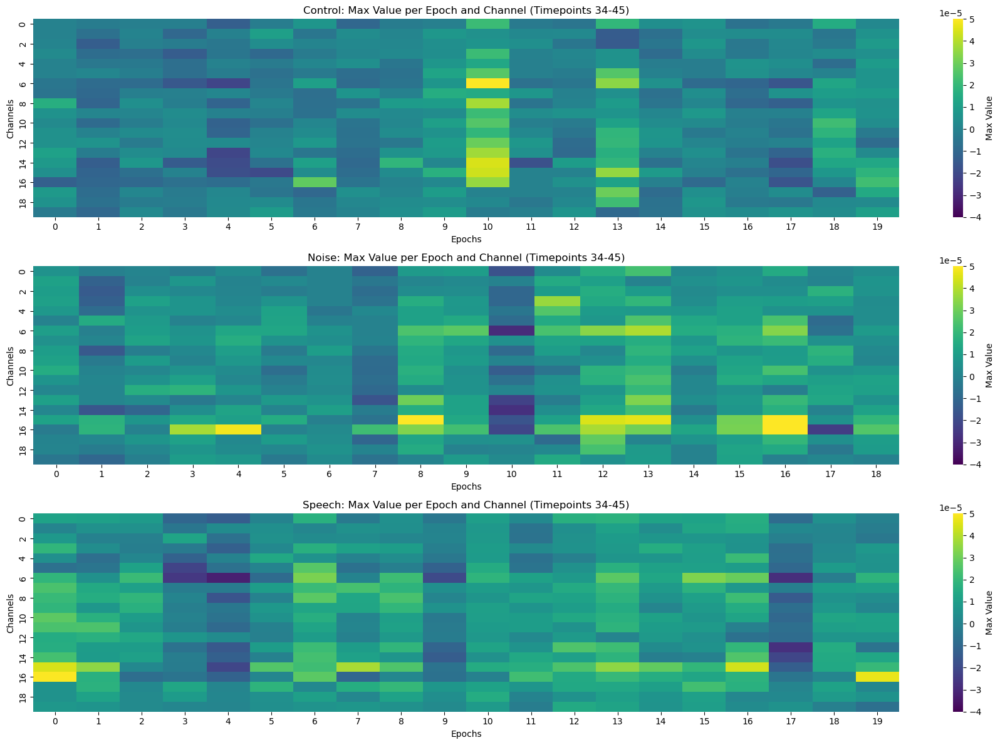

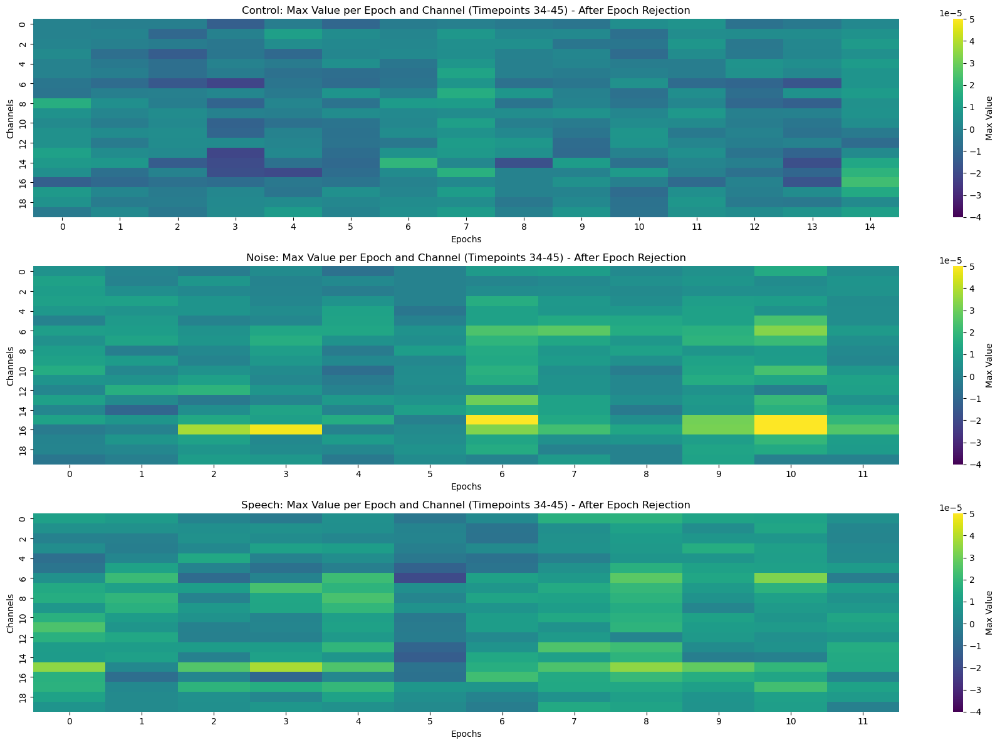

In [80]:
# Create a root output directory
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers
subject_list = subject_list[:1]  # Limit to first subject for now
print("Detected subjects:", subject_list)

# Initialize subjects dataframe
subjects_df = pd.DataFrame(columns=["subject", "session"])
global_results = []

# Set threshold factor (you can modify this!)
threshold_factor = 2  

for sub in subject_list:  # Loop over subjects
    for ses in range(1, 2):  
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        # === Create output directory for this subject/session ===
        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Clean and prepare data ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        # Get only HbO channels
        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = epochs.events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        # Time slice
        time_slice = data[:, :, 44:55]
        max_values = np.max(time_slice, axis=2)

        # Indices by condition
        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        # === Plot before epoch rejection ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max, noise_max, speech_max])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Timepoints 34-45)')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_before_epoch_rejection.png"))
        #plt.close()

        # === Calculate global mean and std for each condition ===
        control_mean = np.mean(control_max, axis=0)
        control_std = np.std(control_max, axis=0)
        noise_mean = np.mean(noise_max, axis=0)
        noise_std = np.std(noise_max, axis=0)
        speech_mean = np.mean(speech_max, axis=0)
        speech_std = np.std(speech_max, axis=0)

        # === Function to reject bad epochs ===
        def reject_epochs(data, mean, std, condition_name, threshold_factor=2):
            rejected_indices = []
            for epoch_idx in range(data.shape[0]):
                epoch = data[epoch_idx, :]
                upper_bound = mean + threshold_factor * std
                lower_bound = mean - threshold_factor * std
                if np.any((epoch > upper_bound) | (epoch < lower_bound)):
                    rejected_indices.append(epoch_idx)
                    # Print info about which channels caused rejection
                    bad_channels = np.where((epoch > upper_bound) | (epoch < lower_bound))[0]
                    for ch in bad_channels:
                        print(f"🚫 Rejecting Epoch {epoch_idx} in {condition_name} - Bad value in Channel {ch} (Value: {epoch[ch]:.2e})")
            # Remove the rejected epochs
            cleaned_data = np.delete(data, rejected_indices, axis=0)
            return cleaned_data, rejected_indices

        # === Apply rejection ===
        control_max_cleaned, rejected_control = reject_epochs(control_max, control_mean, control_std, "Control", threshold_factor)
        noise_max_cleaned, rejected_noise = reject_epochs(noise_max, noise_mean, noise_std, "Noise", threshold_factor)
        speech_max_cleaned, rejected_speech = reject_epochs(speech_max, speech_mean, speech_std, "Speech", threshold_factor)

        print(f"\nSummary of rejected epochs:")
        print(f"Control: {len(rejected_control)} epochs rejected")
        print(f"Noise: {len(rejected_noise)} epochs rejected")
        print(f"Speech: {len(rejected_speech)} epochs rejected\n")

        # === Plot after epoch rejection ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max_cleaned, noise_max_cleaned, speech_max_cleaned])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Timepoints 34-45) - After Epoch Rejection')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_after_epoch_rejection.png"))
        #plt.close()

        # 🛑 Stop here after epoch rejection
        print("\n🛑 Stopping here after epoch rejection - No t-tests performed.\n")
        break

print("\n✅ Done!\n")


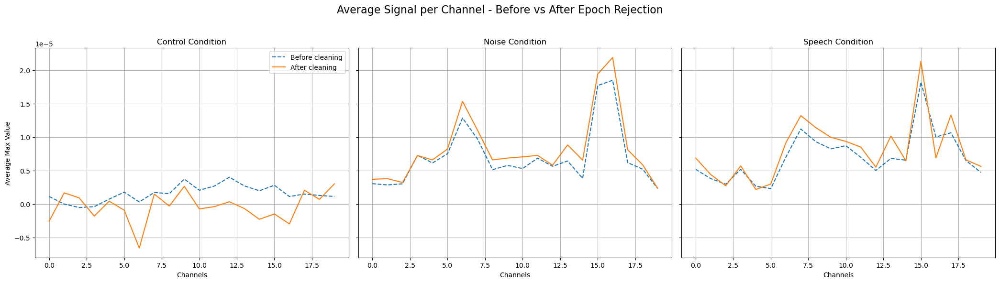

In [84]:
# === Handle unequal number of epochs ===
def pad_with_mean(data, target_length):
    """Pads the data with the mean epoch until it reaches target_length."""
    current_length = data.shape[0]
    if current_length == target_length:
        return data
    mean_epoch = np.mean(data, axis=0, keepdims=True)
    pad_count = target_length - current_length
    padded_data = np.concatenate([data, np.repeat(mean_epoch, pad_count, axis=0)], axis=0)
    return padded_data

# Find maximum number of epochs across conditions
max_epochs = max(control_max_cleaned.shape[0], noise_max_cleaned.shape[0], speech_max_cleaned.shape[0])

# Pad all conditions to have the same number of epochs
control_padded = pad_with_mean(control_max_cleaned, max_epochs)
noise_padded = pad_with_mean(noise_max_cleaned, max_epochs)
speech_padded = pad_with_mean(speech_max_cleaned, max_epochs)

# === Plot average signal per channel, in separate subplots for each condition ===
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(21, 6), sharey=True)

conditions = ["Control", "Noise", "Speech"]
data_before = [control_max, noise_max, speech_max]
data_after = [control_padded, noise_padded, speech_padded]

for ax, cond_name, before, after in zip(axes, conditions, data_before, data_after):
    channels = np.arange(before.shape[1])
    mean_before = np.mean(before, axis=0)
    mean_after = np.mean(after, axis=0)

    ax.plot(channels, mean_before, label="Before cleaning", linestyle="--")
    ax.plot(channels, mean_after, label="After cleaning", linestyle="-")
    ax.set_title(f"{cond_name} Condition")
    ax.set_xlabel('Channels')
    ax.grid(True)

axes[0].set_ylabel('Average Max Value')
axes[0].legend(loc='upper right')

plt.suptitle('Average Signal per Channel - Before vs After Epoch Rejection', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.savefig(os.path.join(output_dir, "average_signal_before_after_epoch_rejection_subplot.png"))
#plt.close()


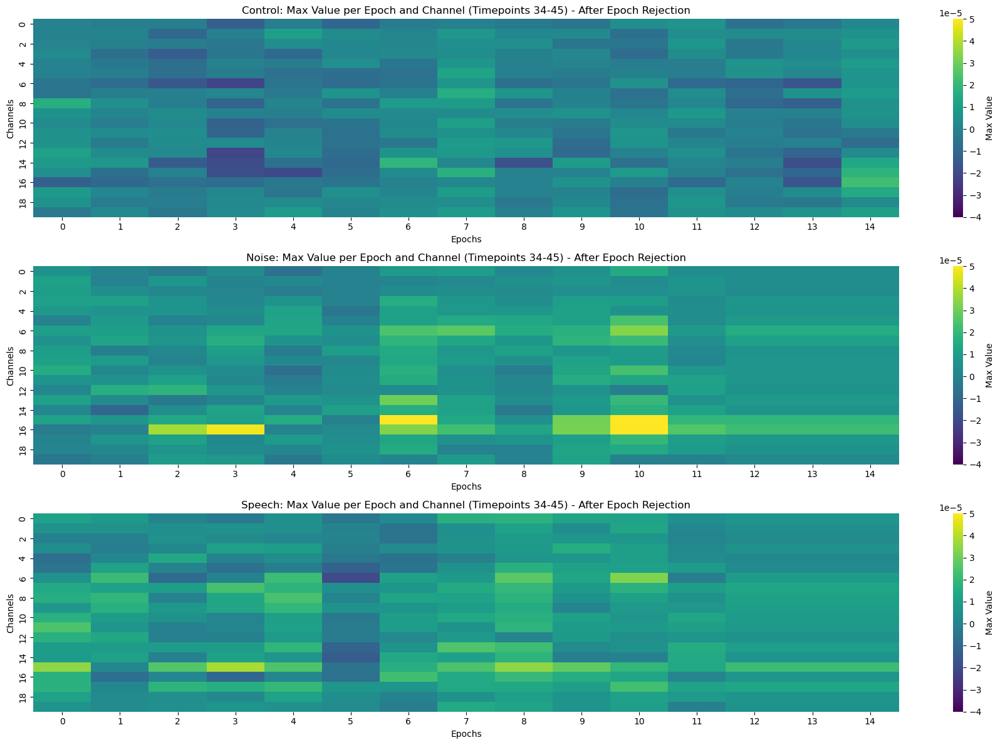

In [86]:
plt.figure(figsize=(18, 12))
for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_padded, noise_padded, speech_padded])):
    plt.subplot(3, 1, i + 1)
    sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
    plt.title(f'{name}: Max Value per Epoch and Channel (Timepoints 34-45) - After Epoch Rejection')
    plt.xlabel('Epochs')
    plt.ylabel('Channels')
plt.tight_layout()

Participant 01, Session 01 (after cleaning)


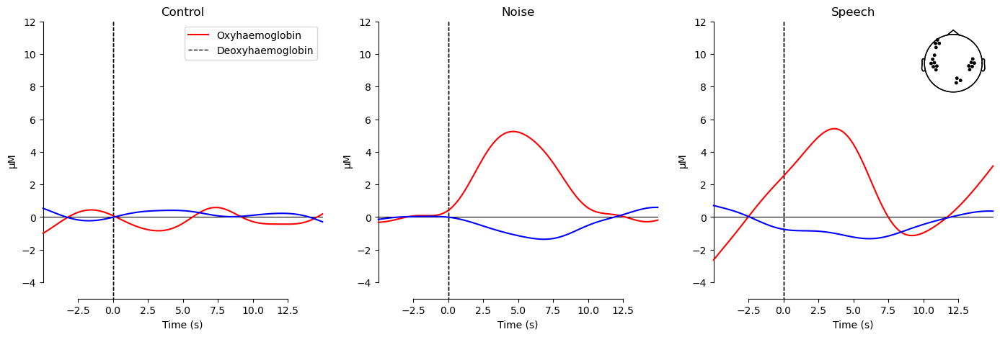

In [88]:
indiv_evoked = defaultdict(list)

# Calculate evoked responses for each condition AFTER cleaning and padding
for condition in epochs.event_id:
    indiv_evoked[condition] = epochs[condition].average()

fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
lims = dict(hbo=[-5, 12], hbr=[-5, 12])

print(f"Participant {sub}, Session {ses:02d} (after cleaning)")

for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
    for idx, evoked in enumerate(indiv_evoked):
        plot_compare_evokeds(
            {evoked: indiv_evoked[evoked]},
            combine="mean",
            picks=pick,
            axes=axes[idx],
            show=False,
            colors=[color],
            legend=False,
            ylim=lims,
            ci=0.95,
            show_sensors=idx == 2,
        )
        axes[idx].set_title(f"{evoked}")
axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])

plt.show()


In [96]:
hbo_data.times

array([-4.992, -4.8  , -4.608, -4.416, -4.224, -4.032, -3.84 , -3.648,
       -3.456, -3.264, -3.072, -2.88 , -2.688, -2.496, -2.304, -2.112,
       -1.92 , -1.728, -1.536, -1.344, -1.152, -0.96 , -0.768, -0.576,
       -0.384, -0.192,  0.   ,  0.192,  0.384,  0.576,  0.768,  0.96 ,
        1.152,  1.344,  1.536,  1.728,  1.92 ,  2.112,  2.304,  2.496,
        2.688,  2.88 ,  3.072,  3.264,  3.456,  3.648,  3.84 ,  4.032,
        4.224,  4.416,  4.608,  4.8  ,  4.992,  5.184,  5.376,  5.568,
        5.76 ,  5.952,  6.144,  6.336,  6.528,  6.72 ,  6.912,  7.104,
        7.296,  7.488,  7.68 ,  7.872,  8.064,  8.256,  8.448,  8.64 ,
        8.832,  9.024,  9.216,  9.408,  9.6  ,  9.792,  9.984, 10.176,
       10.368, 10.56 , 10.752, 10.944, 11.136, 11.328, 11.52 , 11.712,
       11.904, 12.096, 12.288, 12.48 , 12.672, 12.864, 13.056, 13.248,
       13.44 , 13.632, 13.824, 14.016, 14.208, 14.4  , 14.592, 14.784,
       14.976])

# Full code?

In [ ]:
t=hbo_data.times

t>=0 #26
t<=7.5 #66



array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False])

## Threshold approach

Detected subjects: ['01']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 10 in Control - 10 bad channels, total deviation 8.53e-05
🚫 Rejecting Epoch 9 in Control - 5 bad channels, total deviation 3.37e-05
🚫 Rejecting Epoch 17 in Control - 5 bad channels, total deviation 2.51e-05
🚫 Rejecting Epoch 13 in Control - 5 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 12 in Control - 5 bad channels, total deviation 2.12e-05
🚫 Rejecting Epoch 4 in Noise - 8 bad channels, total d

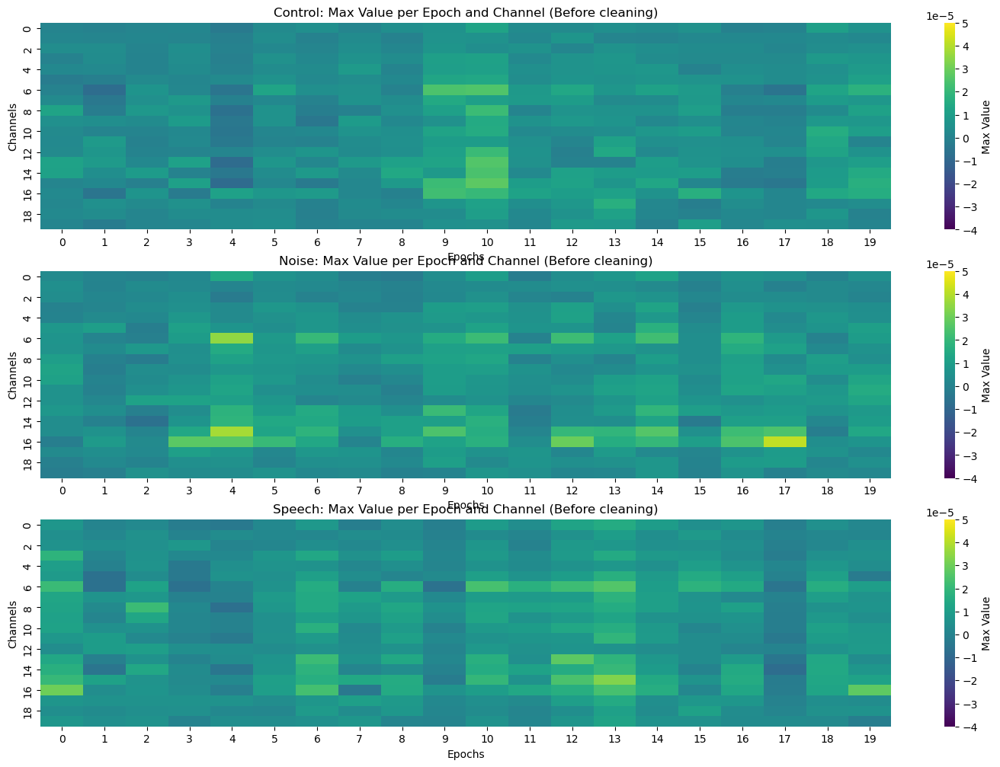

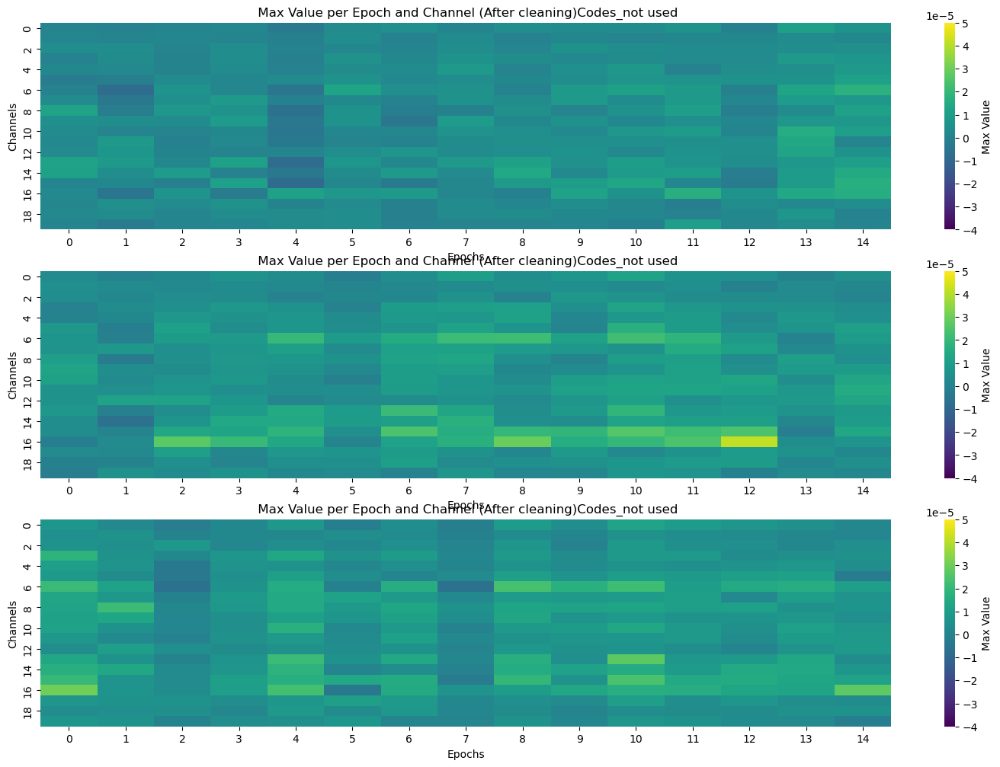

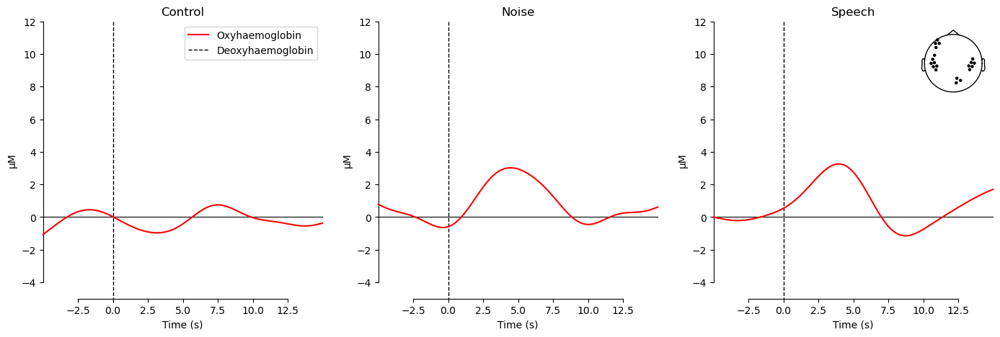

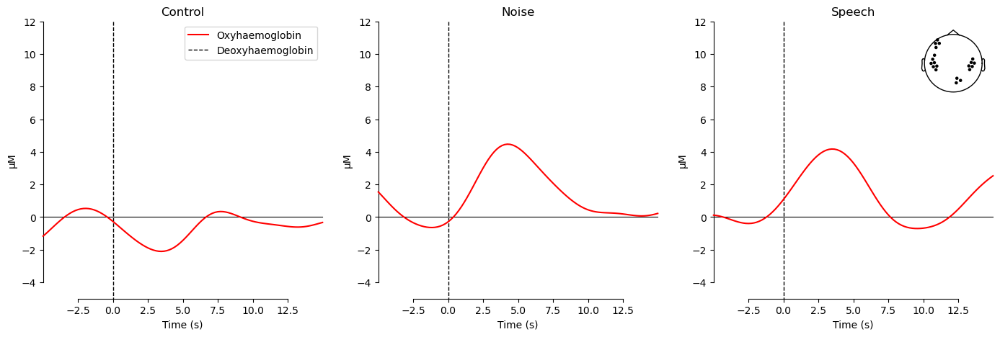

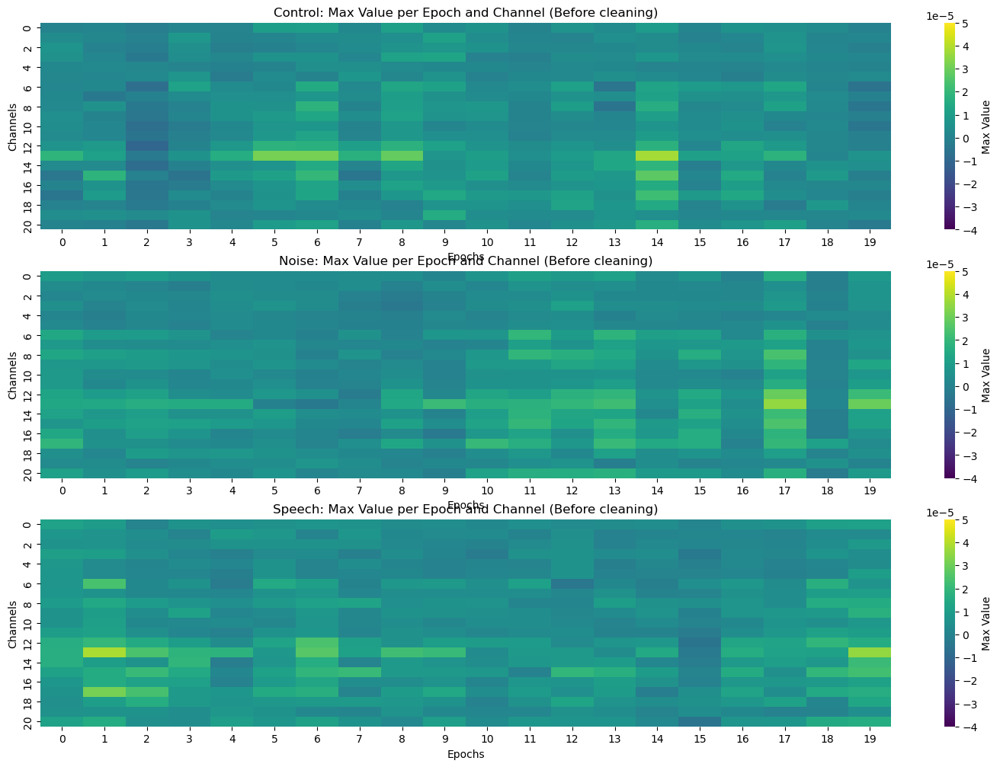

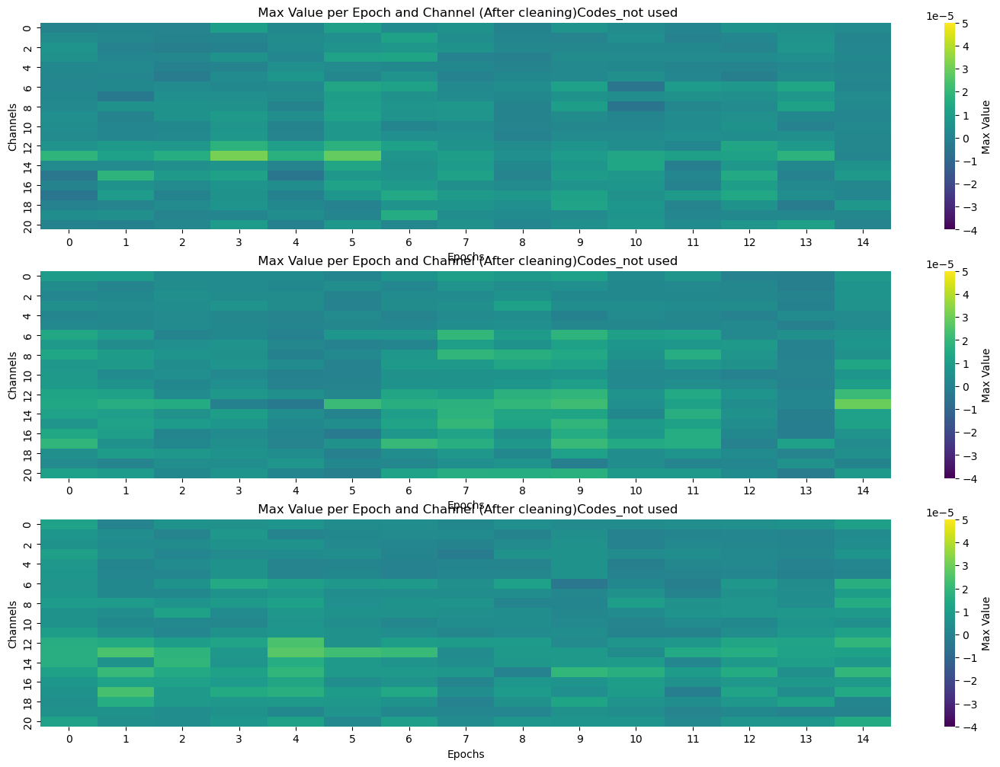

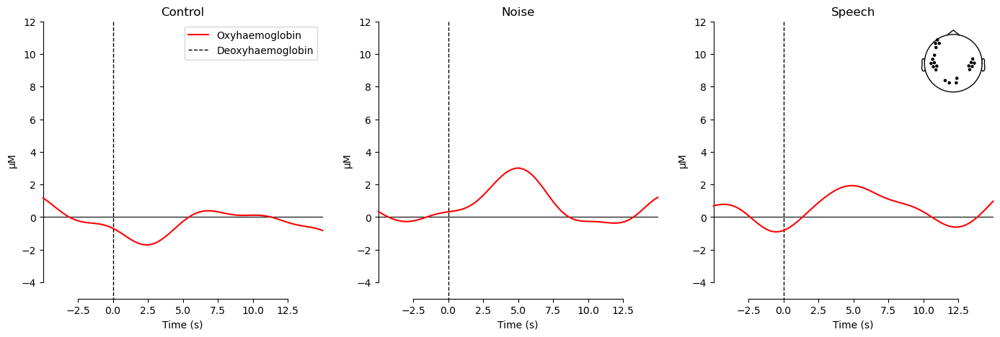

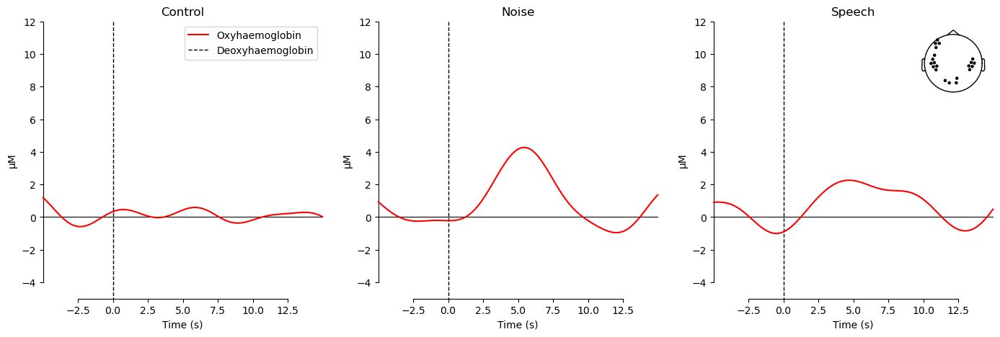

In [ ]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds

# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)

bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
subject_list = subject_list[:1]

print("Detected subjects:", subject_list)



# === Start processing ===
for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # --- Load your data ---
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Initial setup ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = epochs.events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        time_slice = data[:, :, 26:66]
        max_values = np.max(time_slice, axis=2)
        min_values = np.min(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]
        
        control_min = min_values[control_idx, :]
        noise_min = min_values[noise_idx, :]
        speech_min = min_values[speech_idx, :]
        
        n_channels = control_max.shape[1]  # Number of channels
        bad_channel_threshold = int(0.25 * n_channels) # 25% of channels


        # === Plot BEFORE cleaning ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max, noise_max, speech_max])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Before cleaning)')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        #plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_before_epoch_rejection.png"))
        
        thresholds = {
                "Control": {"mean_max": 4.25e-6, "mean_min": -4.37e-6, "std_max": 2.55e-6, "std_min": 2.49e-6},
                "Noise": {"mean_max": 6.39e-6, "mean_min": -3.68e-6, "std_max": 3.13e-6, "std_min": 1.67e-6},
                "Speech": {"mean_max": 7.12e-6, "mean_min": -4.2e-6, "std_max": 3.06e-6, "std_min": 1.94e-6},
            }
        
        
        def reject_epochs(max_data, min_data, condition_name, thresholds, threshold_factor, max_reject_ratio=0.25):
            mean_max = thresholds[condition_name]["mean_max"]
            mean_min = thresholds[condition_name]["mean_min"]
            std_max = thresholds[condition_name]["std_max"]
            std_min = thresholds[condition_name]["std_min"]

            upper_bound_max = mean_max + (threshold_factor * std_max)
            lower_bound_min = mean_min - (threshold_factor * std_min)

            rejection_scores = []  # (epoch_idx, num_bad_channels, total_violation)

            for epoch_idx in range(max_data.shape[0]):
                epoch_max = max_data[epoch_idx, :]
                epoch_min = min_data[epoch_idx, :]

                bad_max = epoch_max > upper_bound_max
                bad_min = epoch_min < lower_bound_min
                bad_channels = bad_max | bad_min

                num_bad_channels = np.sum(bad_channels)

                if num_bad_channels > 0:
                    # Only calculate deviation for bad channels
                    max_violation = np.sum(epoch_max[bad_max] - upper_bound_max)
                    min_violation = np.sum(lower_bound_min - epoch_min[bad_min])
                    total_violation = max_violation + min_violation

                    rejection_scores.append((epoch_idx, num_bad_channels, total_violation))

            # Sort by: 1) num_bad_channels DESC, 2) total_violation DESC
            sorted_scores = sorted(rejection_scores, key=lambda x: (-x[1], -x[2]))

            max_allowed_rejections = int(max_reject_ratio * max_data.shape[0])
            rejected_epochs = [idx for idx, _, _ in sorted_scores[:max_allowed_rejections]]

            # Remove rejected epochs
            cleaned_max = np.delete(max_data, rejected_epochs, axis=0)
            cleaned_min = np.delete(min_data, rejected_epochs, axis=0)

            # Logging
            for idx, chs, dev in sorted_scores[:max_allowed_rejections]:
                print(f"🚫 Rejecting Epoch {idx} in {condition_name} - {chs} bad channels, total deviation {dev:.2e}")

            return cleaned_max, cleaned_min, rejected_epochs


        


        threshold_factor = 3  # Adjust this value as needed
        
        control_max_cleaned, control_min_cleaned, rejected_control = reject_epochs(
            control_max, control_min, "Control", thresholds, threshold_factor
        )

        noise_max_cleaned, noise_min_cleaned, rejected_noise = reject_epochs(
            noise_max, noise_min, "Noise", thresholds, threshold_factor
        )

        speech_max_cleaned, speech_min_cleaned, rejected_speech = reject_epochs(
            speech_max, speech_min, "Speech", thresholds, threshold_factor
        )


        print("\nSummary of rejected epochs:")
        print(f"Control: {len(rejected_control)} epochs rejected")
        print(f"Noise: {len(rejected_noise)} epochs rejected")
        print(f"Speech: {len(rejected_speech)} epochs rejected\n")

        # === Plot AFTER cleaning ===
        plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max_cleaned, noise_max_cleaned, speech_max_cleaned])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(' Max Value per Epoch and Channel (After cleaning)'"Codes_not used")
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        #plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "heatmaps_after_epoch_rejection.png"))

        # === Clean the epochs object ===
        """ all_rejected_indices = np.concatenate([rejected_control, rejected_noise, rejected_speech])
        all_rejected_indices = np.unique(all_rejected_indices)
        print(f"Total epochs to reject: {len(all_rejected_indices)}")

        epochs_cleaned = epochs.drop(all_rejected_indices.tolist(), reason='BAD_EPOCHS')

        print(f"Remaining epochs after cleaning: {len(epochs_cleaned)}") """
        
        # Map rejected indices back to original epoch indices
        rejected_control_mapped = control_idx[rejected_control]
        rejected_noise_mapped = noise_idx[rejected_noise]
        rejected_speech_mapped = speech_idx[rejected_speech]

        # Combine all rejected epochs
        all_rejected_indices = np.concatenate([
            rejected_control_mapped,
            rejected_noise_mapped,
            rejected_speech_mapped
        ])
        all_rejected_indices = np.unique(all_rejected_indices)

        print(f"Total epochs to reject: {len(all_rejected_indices)}")

        # Now drop using the mapped indices
        epochs_cleaned = epochs.drop(all_rejected_indices.tolist(), reason='BAD_EPOCHS')

        # === Plot evoked responses BEFORE cleaning ===
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        fig, axes = plt.subplots(1, len(indiv_evoked_before), figsize=(17, 5))
        lims = dict(hbo=[-5, 12])

        print(f"Participant {sub}, Session {ses:02d} (Before Cleaning)")

        for pick, color in zip(["hbo"], ["r"]):
            for idx, evoked in enumerate(indiv_evoked_before):
                plot_compare_evokeds(
                    {evoked: indiv_evoked_before[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
                )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        #plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "evoked_before_cleaning.png"))

        # === Plot evoked responses AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        fig, axes = plt.subplots(1, len(indiv_evoked_after), figsize=(17, 5))
        lims = dict(hbo=[-5, 12])

        print(f"Participant {sub}, Session {ses:02d} (After Cleaning)")

        for pick, color in zip(["hbo"], ["r"]):
            for idx, evoked in enumerate(indiv_evoked_after):
                plot_compare_evokeds(
                    {evoked: indiv_evoked_after[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
                )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        #plt.tight_layout()
        plt.savefig(os.path.join(output_dir, "evoked_after_cleaning.png"))

print("\n✅ Done!")


## ROI - epoch rejection before and after

### 1 participant (test)

In [159]:
epochs.ch_names

['S1_D1 hbo',
 'S1_D1 hbr',
 'S2_D1 hbo',
 'S2_D1 hbr',
 'S3_D1 hbo',
 'S3_D1 hbr',
 'S3_D2 hbo',
 'S3_D2 hbr',
 'S4_D2 hbo',
 'S4_D2 hbr',
 'S4_D3 hbo',
 'S4_D3 hbr',
 'S5_D2 hbo',
 'S5_D2 hbr',
 'S5_D3 hbo',
 'S5_D3 hbr',
 'S5_D4 hbo',
 'S5_D4 hbr',
 'S5_D5 hbo',
 'S5_D5 hbr',
 'S6_D8 hbo',
 'S6_D8 hbr',
 'S8_D8 hbo',
 'S8_D8 hbr',
 'S9_D8 hbo',
 'S9_D8 hbr',
 'S10_D9 hbo',
 'S10_D9 hbr',
 'S10_D10 hbo',
 'S10_D10 hbr',
 'S10_D11 hbo',
 'S10_D11 hbr',
 'S10_D12 hbo',
 'S10_D12 hbr',
 'S11_D11 hbo',
 'S11_D11 hbr',
 'S11_D12 hbo',
 'S11_D12 hbr',
 'S12_D1 hbo',
 'S12_D1 hbr']

In [163]:
# Define your ROIs as dictionaries with optode names
rois = {
    "Left_Auditory": ["S4_D2 hbo", "S4_D3 hbo", "S5_D2 hbo", "S5_D3 hbo", "S5_D4 hbo", "S5_D5 hbo"],
    "Right_Auditory": ["S10_D9 hbo", "S10_D10 hbo", "S10_D11 hbo", "S10_D12 hbo", "S11_D11 hbo", "S11_D12 hbo"],
    "Visual": ["S6_D6 hbo", "S6_D8 hbo", "S7_D6 hbo", "S7_D7 hbo","S8_D7 hbo", "S8_D8 hbo", "S9_D8 hbo", "S7_D8 hbo"],
    "Front": ["S1_D1 hbo", "S2_D1 hbo", "S3_D1 hbo", "S3_D2 hbo","S12_D1 hbo"],
}


In [211]:
from mne.viz import plot_compare_evokeds

def plot_evoked_rois(evoked_dict, roi_definitions, output_path, title_prefix=""):
    # Number of ROIs (columns) to create
    fig, axes = plt.subplots(1, len(roi_definitions), figsize=(6 * len(roi_definitions), 5))
    if len(roi_definitions) == 1:
        axes = [axes]
    
    # Define colors for each condition
    condition_colors = {
        "Control": "r",  # Red for Control
        "Noise": "g",    # Green for Noise
        "Speech": "b"    # Blue for Speech
    }
    
    # Iterate through each ROI
    for ax, (roi_name, optodes) in zip(axes, roi_definitions.items()):
        # Create a dictionary to store evoked data for the legend
        evoked_for_legend = {}

        # For each condition, plot evoked responses with different colors
        for condition_name, evoked in evoked_dict.items():
            picks = [ch for ch in optodes if ch in evoked.ch_names]
            if not picks:
                print(f"⚠️ No channels found in ROI '{roi_name}' for {condition_name}")
                continue
            
            # Plot the evoked response for the current condition with the corresponding color
            plot_compare_evokeds(
                {condition_name: evoked},
                picks=picks,
                axes=ax,
                combine='mean',
                show=False,
                colors=[condition_colors.get(condition_name, 'k')],  # Default to black if not defined
                ylim=dict(hbo=[-5, 12])
            )

            # Store the evoked for the condition in the dictionary for the legend
            evoked_for_legend[condition_name] = evoked
        
        # Set the title for the ROI plot
        ax.set_title(f"{title_prefix} ROI: {roi_name}")
        
        # Create a legend with conditions
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles, labels, title="Conditions")
    
    # Save the plot
    plt.savefig(output_path)


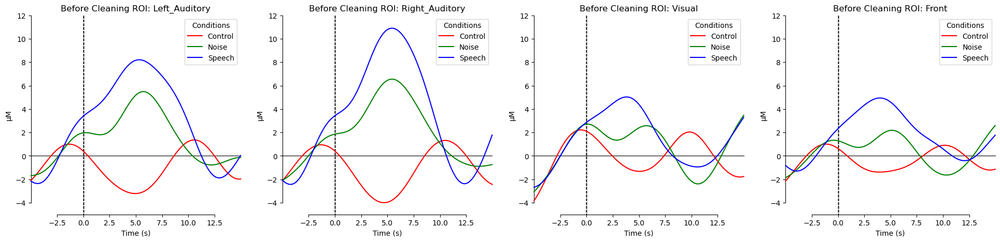

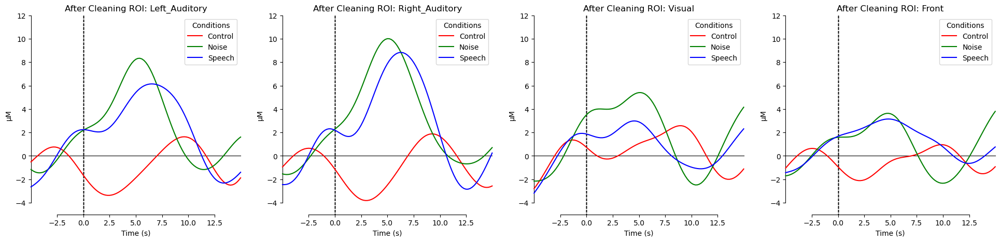

In [174]:
# BEFORE cleaning
plot_evoked_rois(
    evoked_dict=indiv_evoked_before,
    roi_definitions=rois,
    output_path=os.path.join(output_dir, "evoked_before_cleaning_rois.png"),
    title_prefix="Before Cleaning"
)

# AFTER cleaning
plot_evoked_rois(
    evoked_dict=indiv_evoked_after,
    roi_definitions=rois,
    output_path=os.path.join(output_dir, "evoked_after_cleaning_rois.png"),
    title_prefix="After Cleaning"
)


In [177]:
output_dir

'individual_analysis_outputs\\sub-24\\ses-02'

### All participants

Detected subjects: ['01', '02', '03', '04', '05', '07', '08', '10', '11', '12', '13', '16', '17', '19', '21', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 10 in Control - 17 bad channels, total deviation 1.28e-04
🚫 Rejecting Epoch 9 in Control - 12 bad channels, total deviation 6.53e-05
🚫 Rejecting Epoch 12 in Control - 10 bad channels, total deviation 6.98e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 19 in Control - 9 

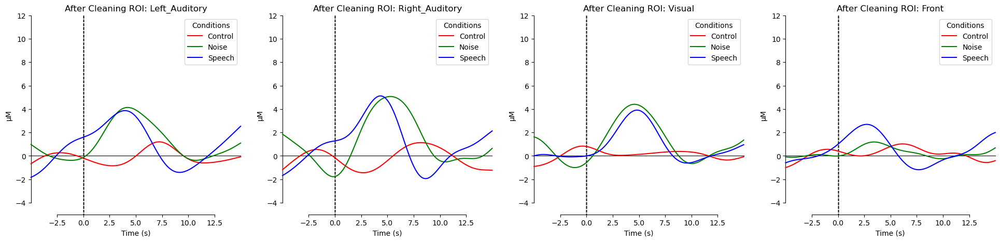

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 8
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 01, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 2 in Control - 16 bad channels, total deviation 1.57e-04
🚫 Rejecting Epoch 3 in Control - 15 bad channels, total deviation 1.04e-04
🚫 Rejecting Epoch 14 in Control - 14 bad channels, total deviation 1.30e-04
🚫 Rejecting Epoch 19 in Control - 13 bad channels, total deviation 1.18e-04
🚫 Rejecting Epoch 6 in Control - 12 bad channels, total deviation 7.89e-05
🚫 Rejecting Epoch 3 in Noise - 21 bad channels, total deviation 1.87e+02
🚫

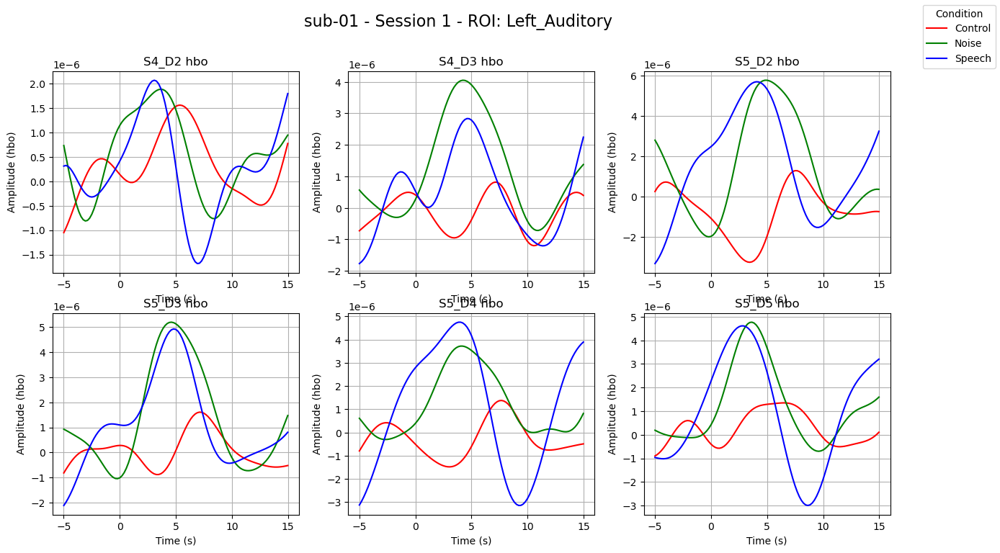

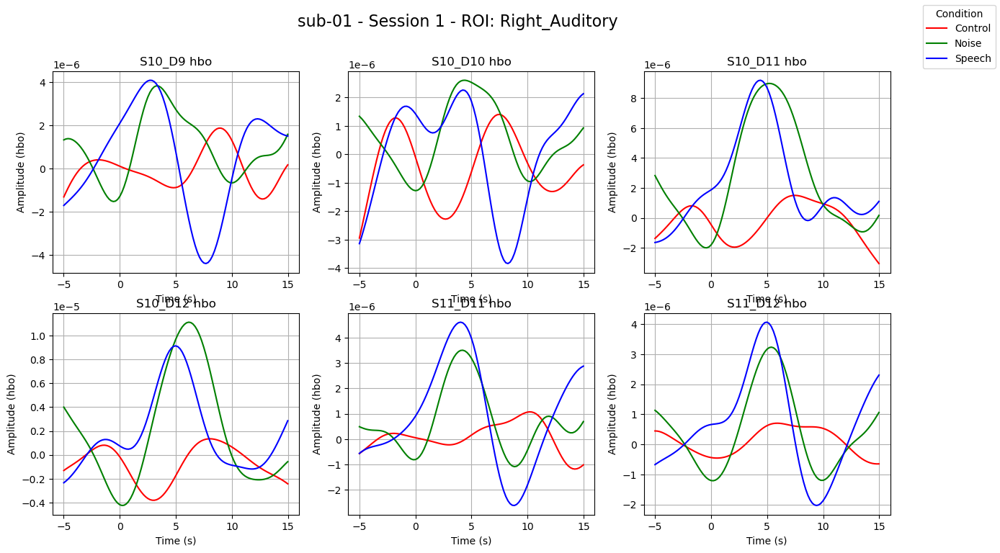

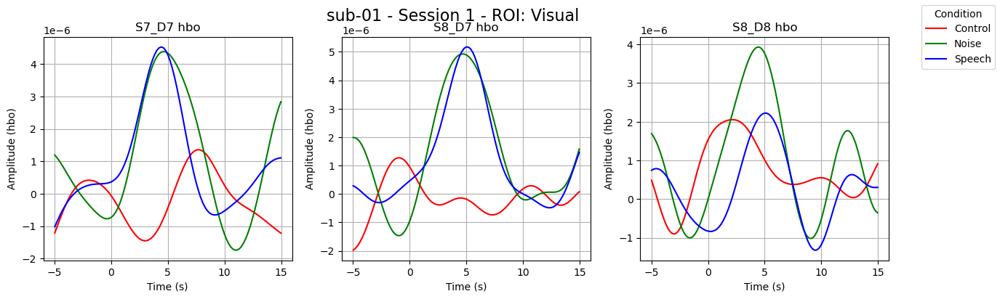

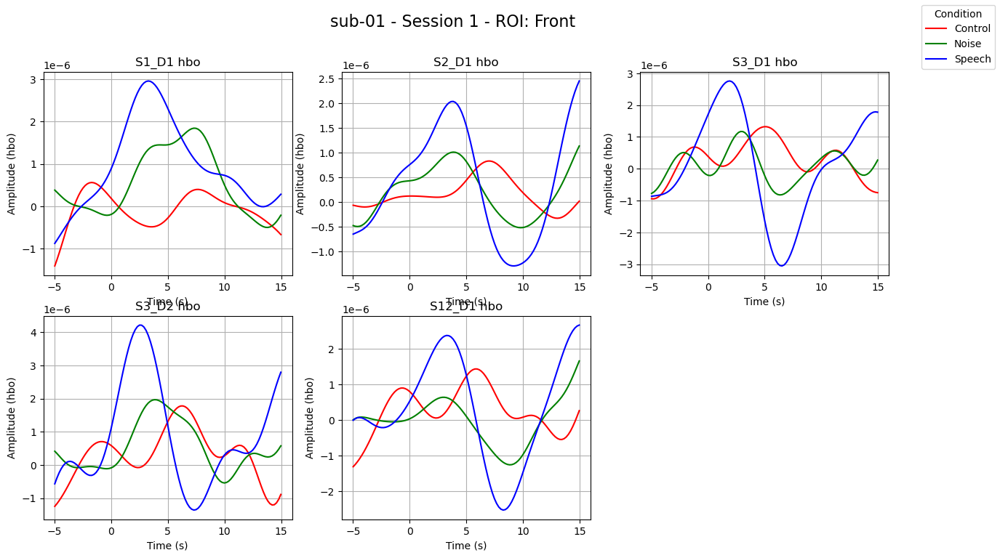

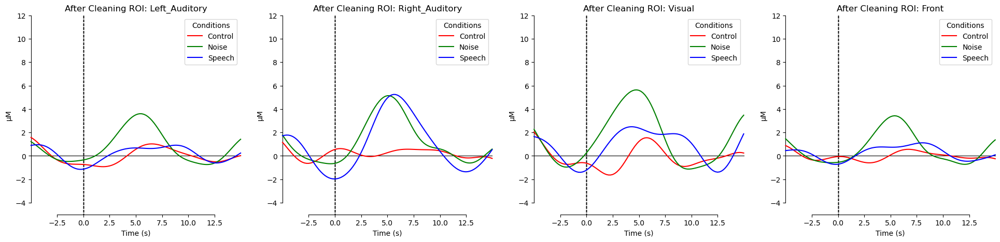

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 02, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 11 in Control - 19 bad channels, total deviation 1.00e-04
🚫 Rejecting Epoch 1 in Control - 19 bad channels, total deviation 9.24e-05
🚫 Rejecting Epoch 3 in Control - 17 bad channels, total deviation 1.12e-04
🚫 Rejecting Epoch 0 in Control - 15 bad channels, total deviation 1.08e-04
🚫 Rejecting Epoch 16 in Control - 15 bad channels, total deviation 9.16e-05
🚫 Rejecting Epoch 16 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 14 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 5 in Noise - 24 ba

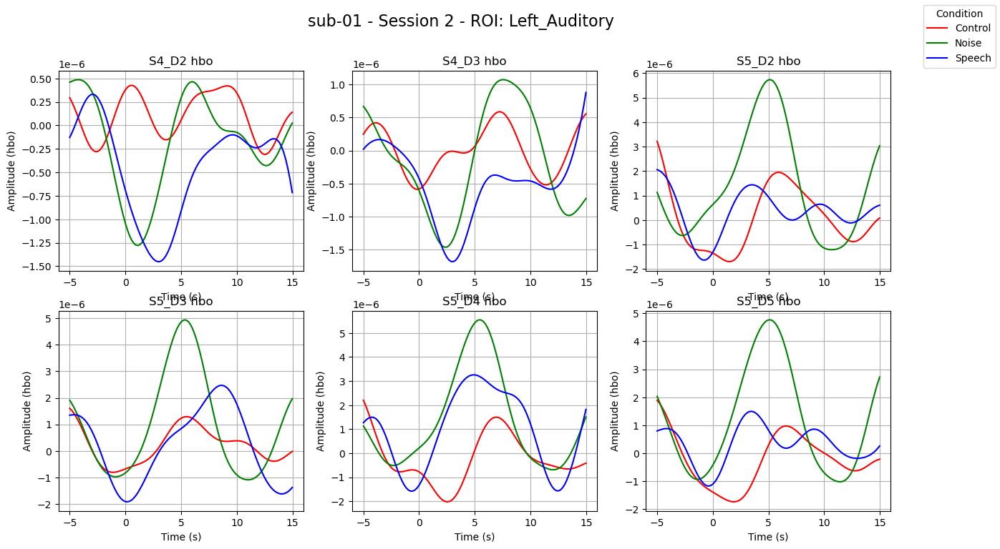

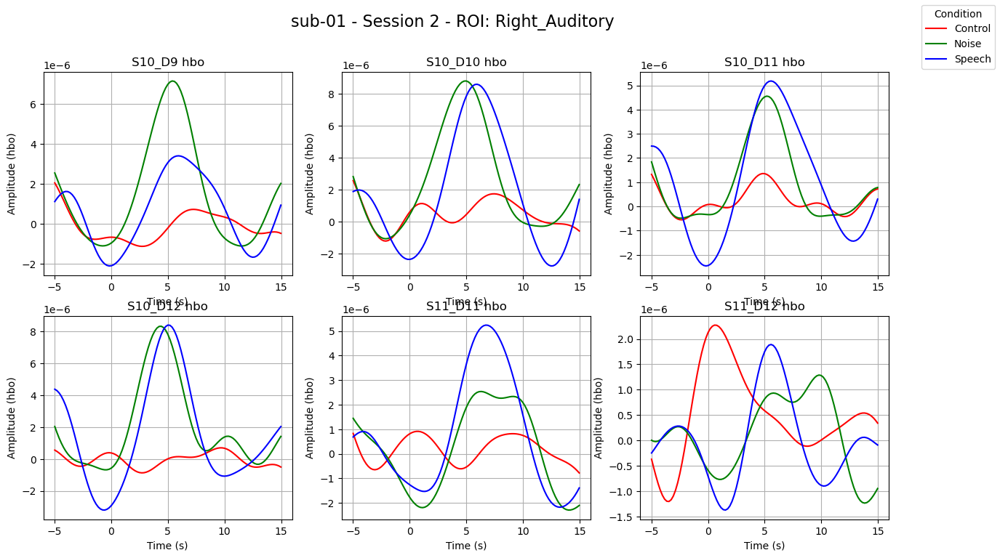

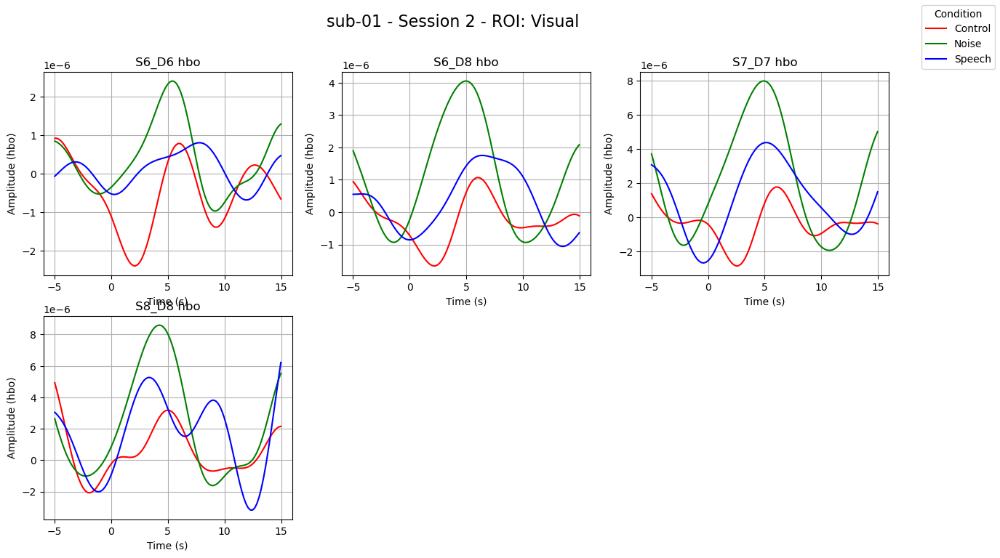

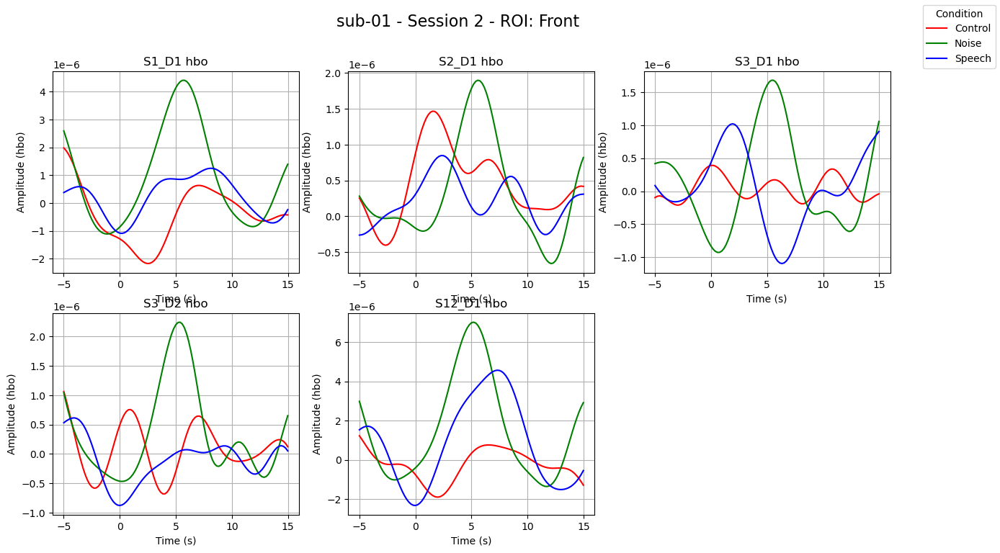

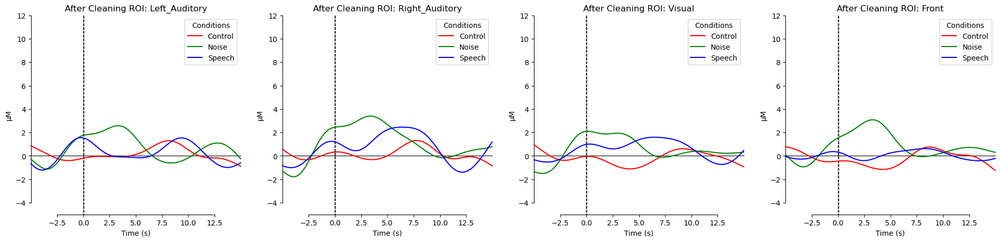

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 02, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 3 in Control - 17 bad channels, total deviation 1.93e-04
🚫 Rejecting Epoch 2 in Control - 13 bad channels, total deviation 1.07e-04
🚫 Rejecting Epoch 4 in Control - 12 bad channels, total deviation 8.93e-05
🚫 Rejecting Epoch 15 in Control - 9 bad channels, total deviation 1.09e-04
🚫 Rejecting Epoch 16 in Control - 9 bad channels, total deviation 4.88e-05
🚫 Rejecting Epoch 18

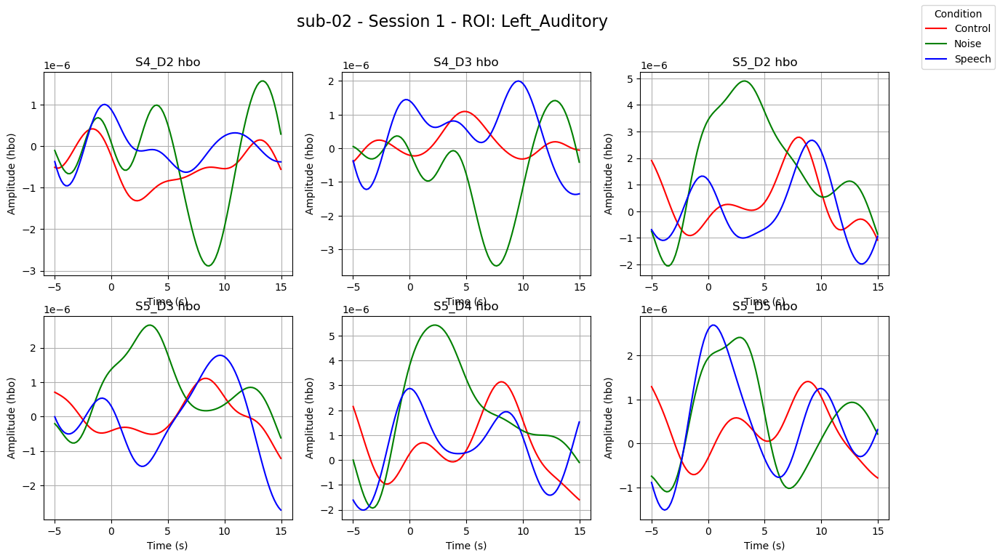

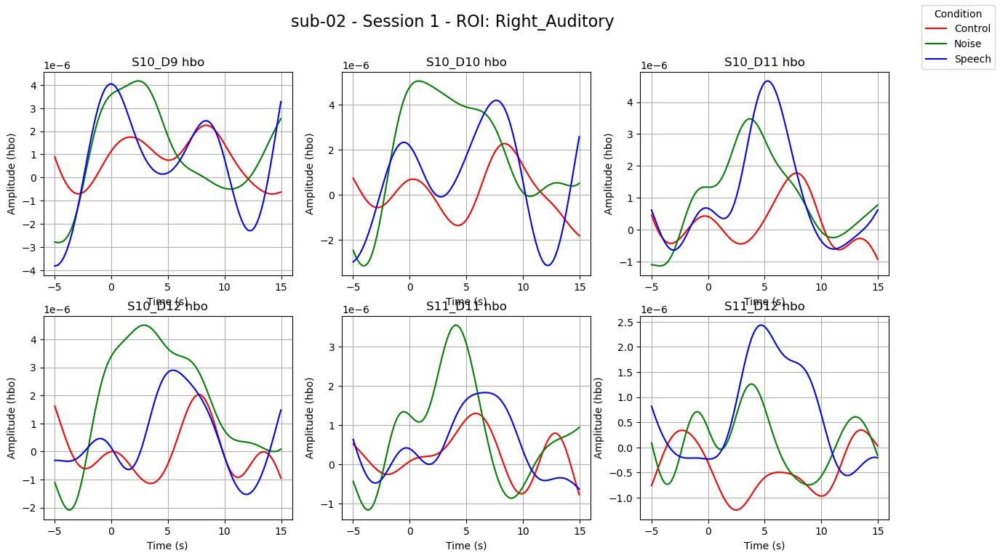

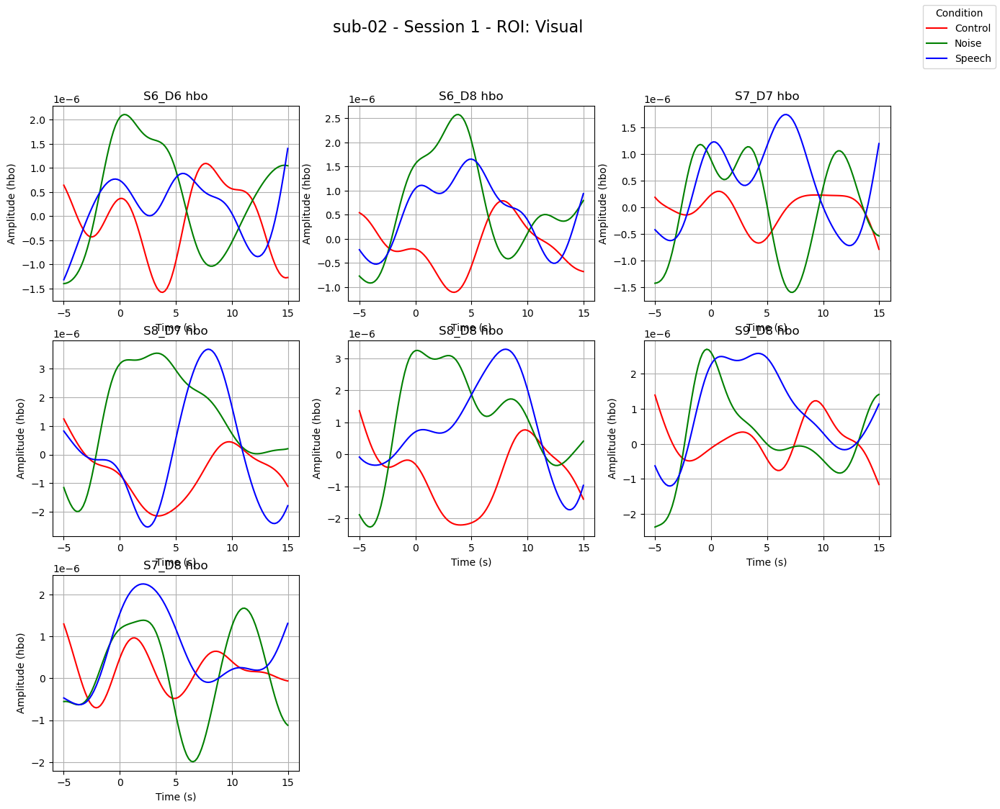

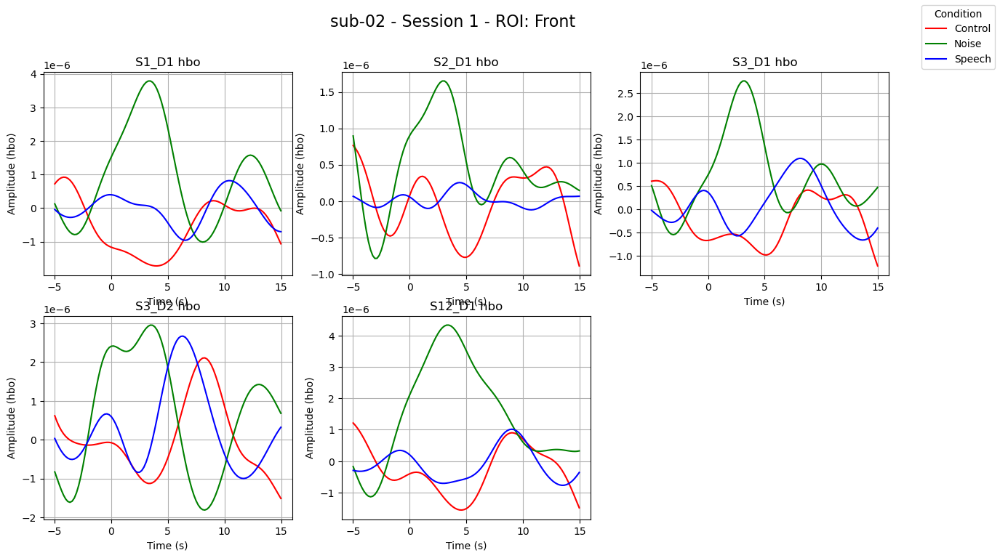

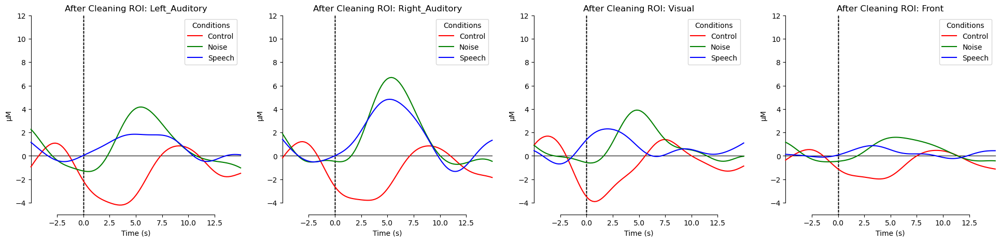

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 03, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 15 in Control - 22 bad channels, total deviation 1.74e-04
🚫 Rejecting Epoch 19 in Control - 19 bad channels, total deviation 1.95e-04
🚫 Rejecting Epoch 14 in Control - 18 bad channels, total deviation 2.00e-04
🚫 Rejecting Epoch 6 in Control - 18 bad channels, total deviation 1.11e-04
🚫 Rejecting Epoch 11 in Control - 17 bad channels, total deviation 1.79e-04
🚫 Rejecting Epoch 19 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 2 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 R

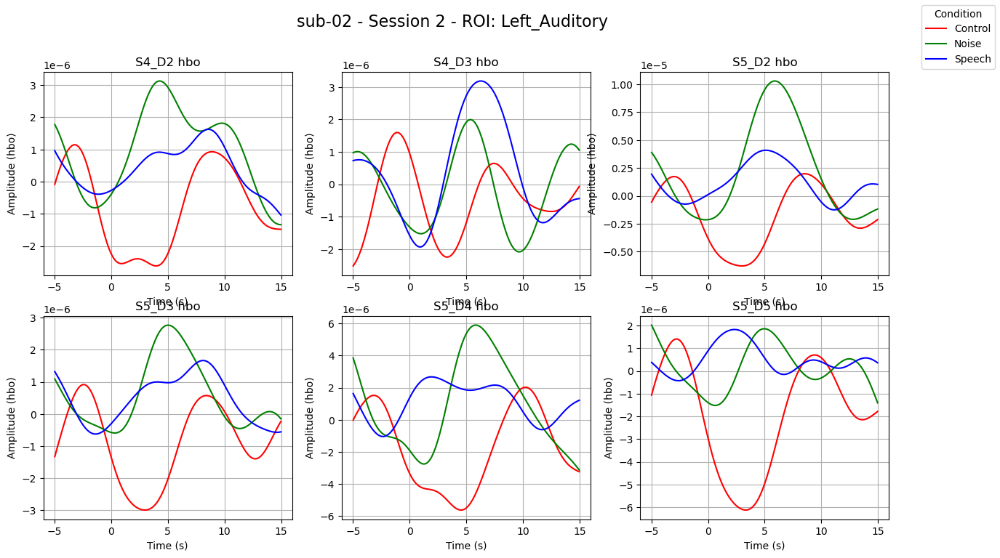

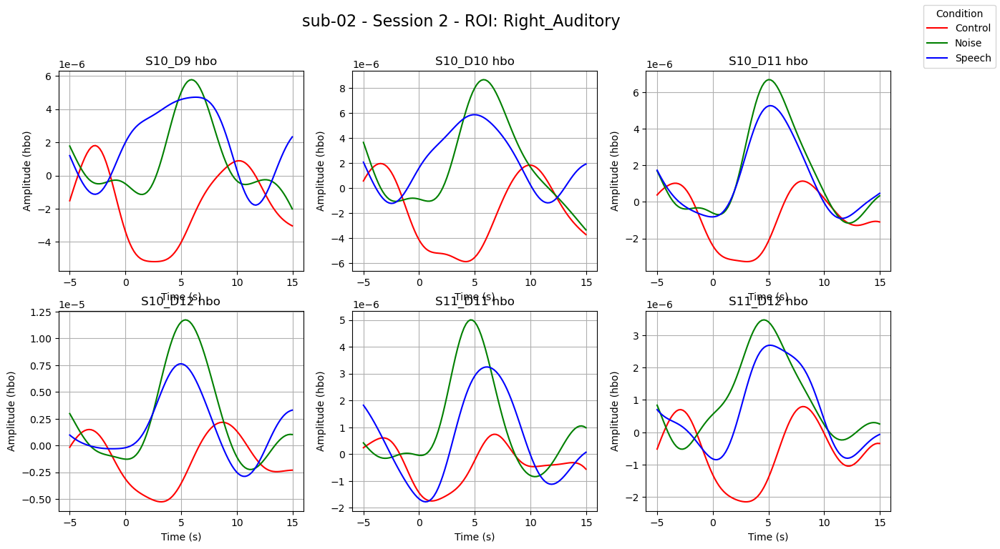

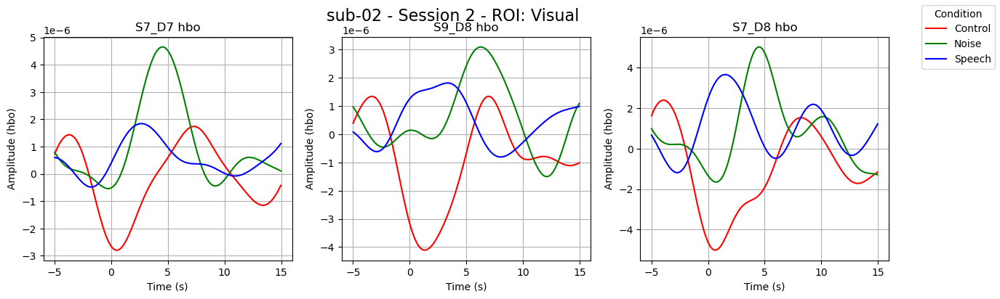

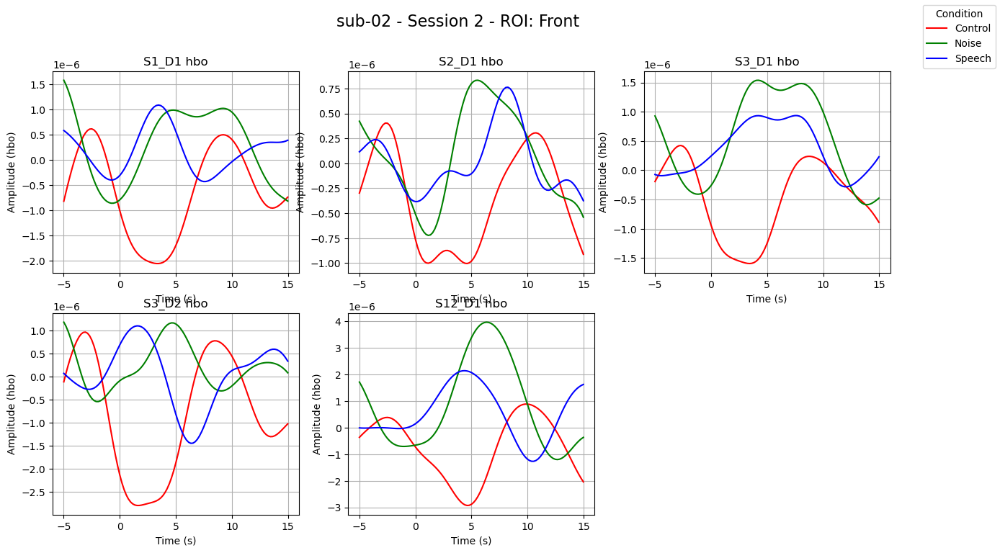

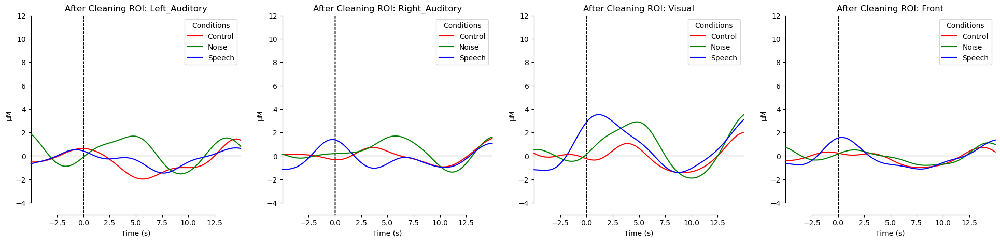

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 03, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 3 in Control - 24 bad channels, total deviation 6.15e-04
🚫 Rejecting Epoch 4 in Control - 24 bad channels, total deviation 5.28e-04
🚫 Rejecting Epoch 0 in Control - 24 bad channels, total deviation 4.24e-04
🚫 Rejecting Epoch 7 in Control - 24 bad channels, total deviation 3.77e-04
🚫 Rejecting Epoch 16 in Control - 24 bad channels, total deviation 3.76e-04
🚫 Rejecting Epoch 10 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 7 in Noise - 24 bad channels, to

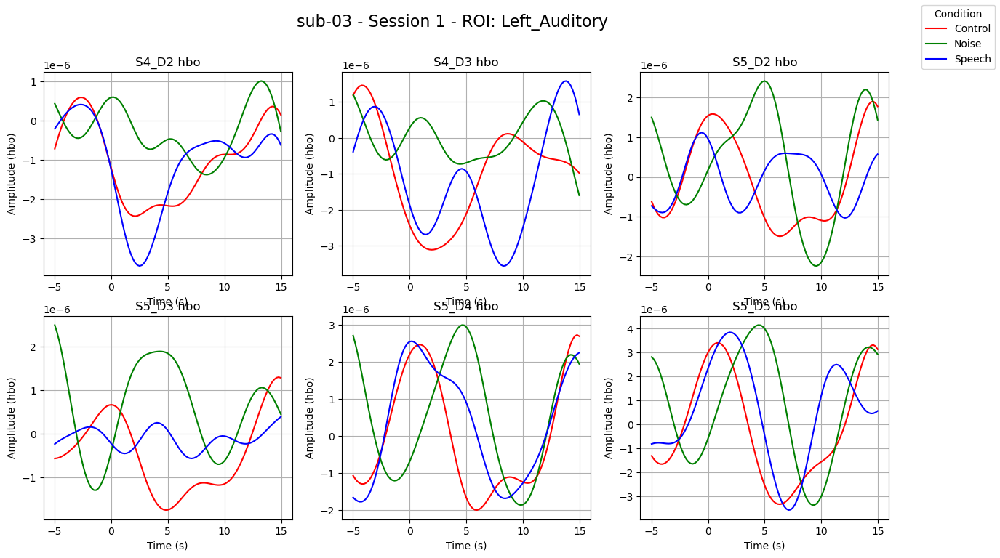

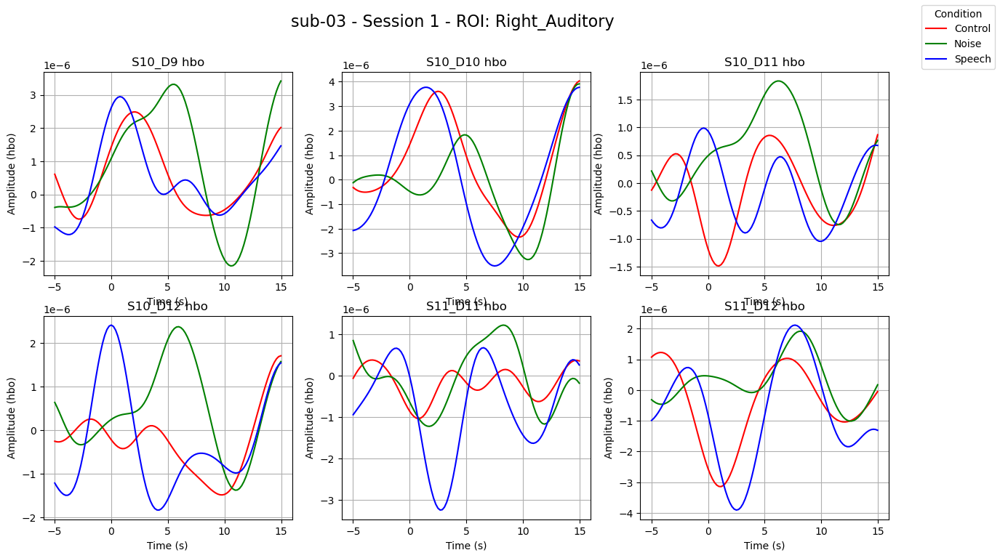

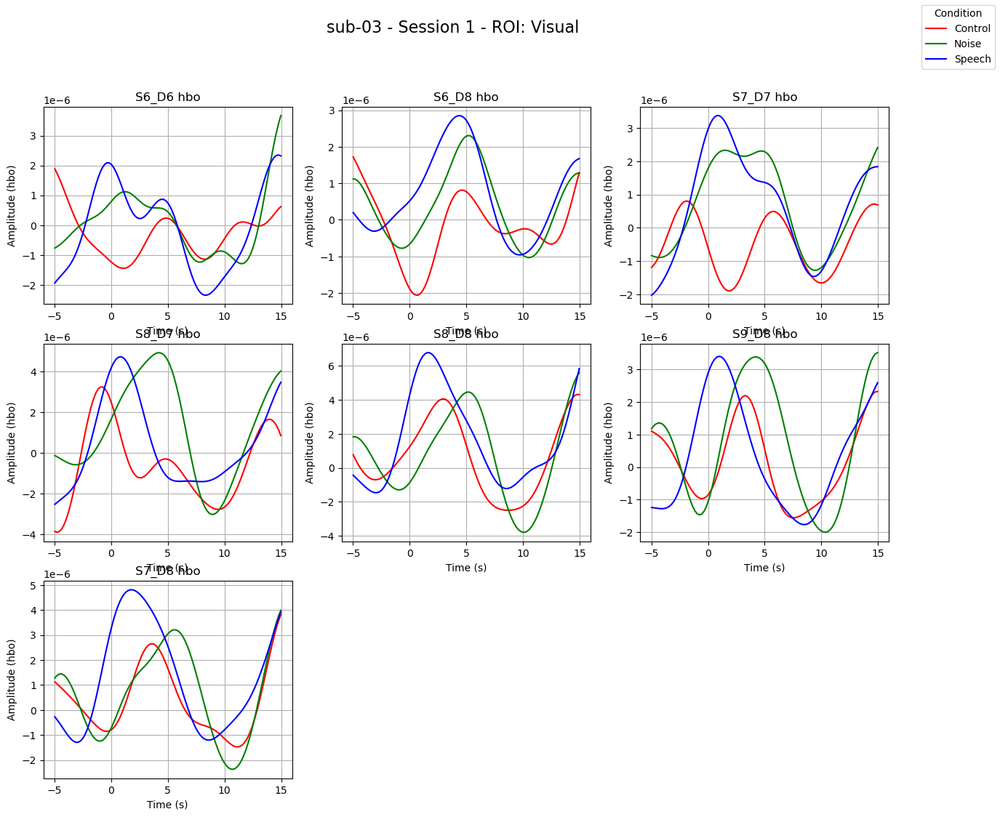

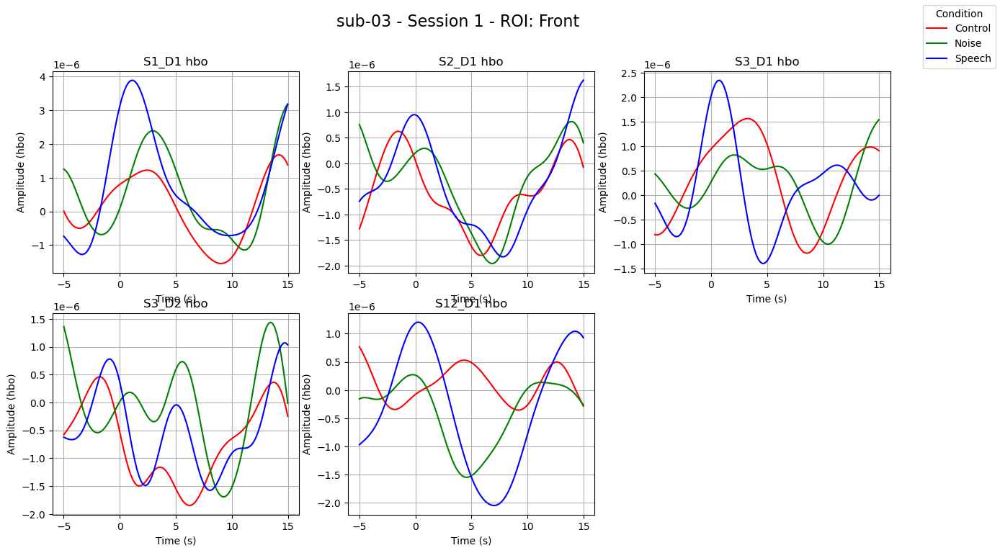

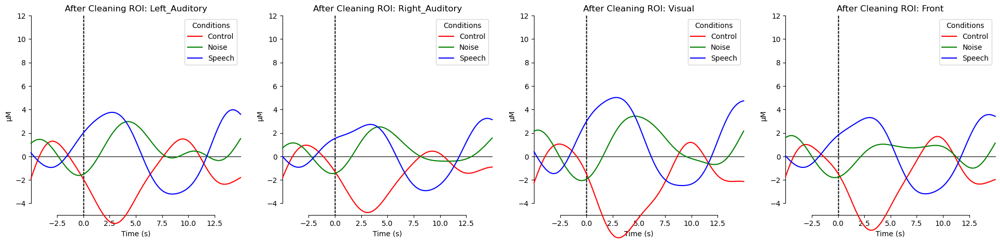

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 04, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 15 in Control - 25 bad channels, total deviation 3.57e-04
🚫 Rejecting Epoch 9 in Control - 25 bad channels, total deviation 2.86e-04
🚫 Rejecting Epoch 2 in Control - 23 bad channels, total deviation 2.32e-04
🚫 Rejecting Epoch 1 in Control - 23 bad channels, total deviation 2.29e-04
🚫 Rejecting Epoch 3 in Control - 22 bad channels, total deviation 1.48e-04
🚫 Rejecting Epoch 17 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 14 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 

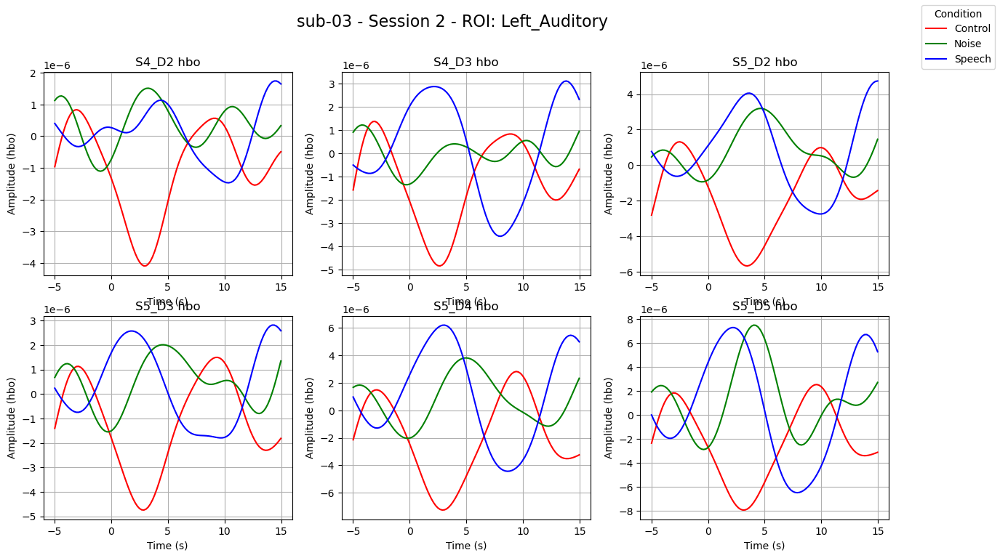

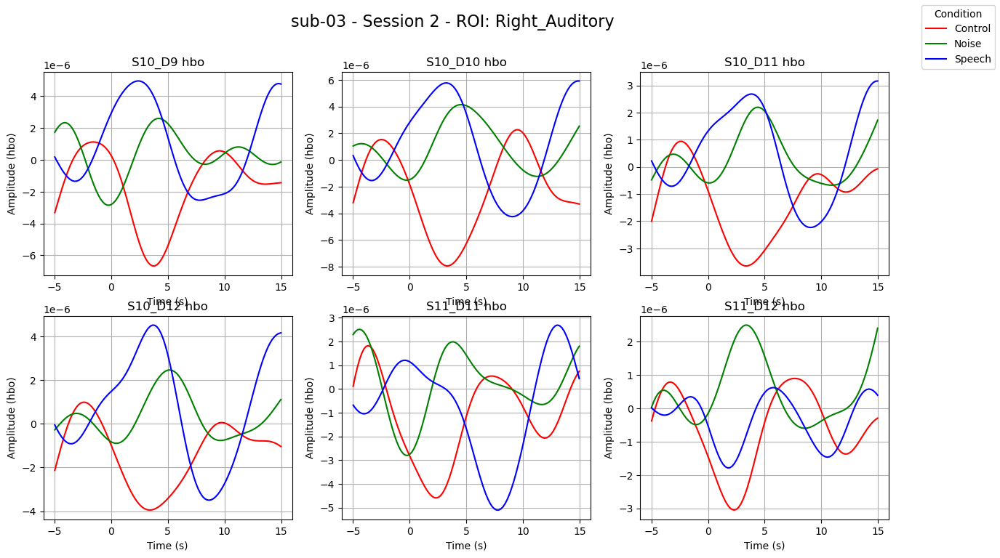

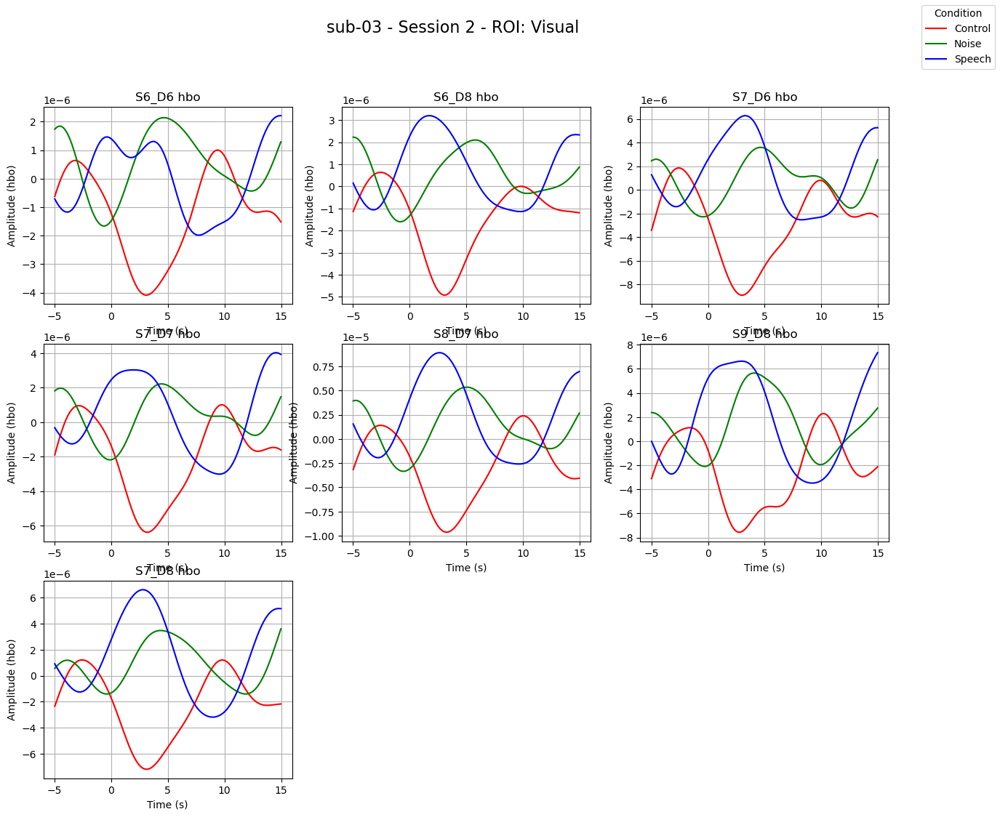

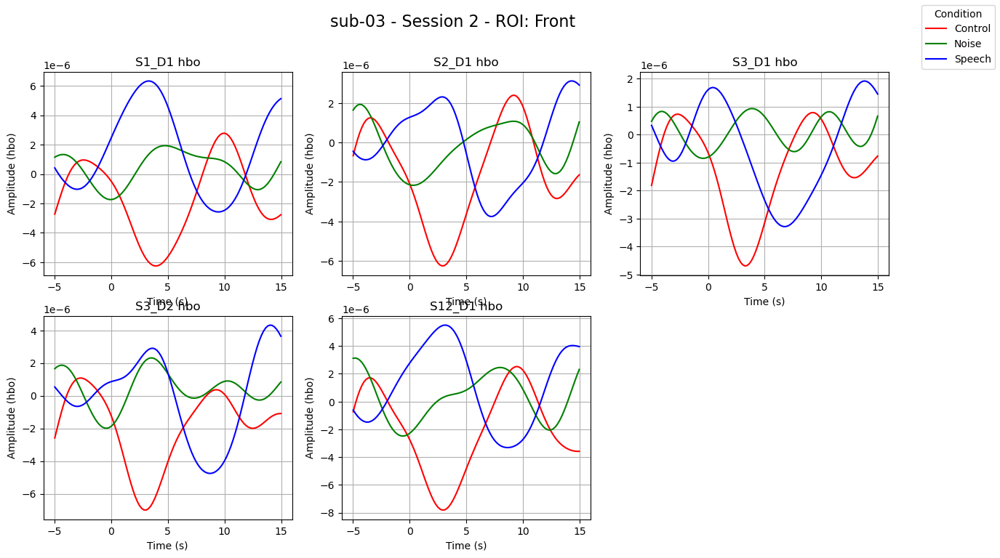

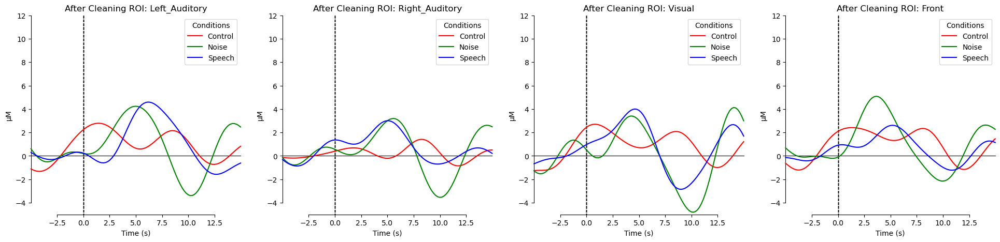

: 

In [ ]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds

# === Define the plot_evoked_rois function ===
def plot_evoked_rois(evoked_dict, roi_definitions, output_path, title_prefix=""):
    # Number of ROIs (columns) to create
    fig, axes = plt.subplots(1, len(roi_definitions), figsize=(6 * len(roi_definitions), 5))
    if len(roi_definitions) == 1:
        axes = [axes]
    
    # Define colors for each condition
    condition_colors = {
        "Control": "r",  # Red for Control
        "Noise": "g",    # Green for Noise
        "Speech": "b"    # Blue for Speech
    }
    
    # Iterate through each ROI
    for ax, (roi_name, optodes) in zip(axes, roi_definitions.items()):
        # Create a dictionary to store evoked data for the legend
        evoked_for_legend = {}

        # For each condition, plot evoked responses with different colors
        for condition_name, evoked in evoked_dict.items():
            picks = [ch for ch in optodes if ch in evoked.ch_names]
            if not picks:
                print(f"⚠️ No channels found in ROI '{roi_name}' for {condition_name}")
                continue
            
            # Plot the evoked response for the current condition with the corresponding color
            plot_compare_evokeds(
                {condition_name: evoked},
                picks=picks,
                axes=ax,
                combine='mean',
                show=False,
                colors=[condition_colors.get(condition_name, 'k')],  # Default to black if not defined
                ylim=dict(hbo=[-5, 12])
            )

            # Store the evoked for the condition in the dictionary for the legend
            evoked_for_legend[condition_name] = evoked
        
        # Set the title for the ROI plot
        ax.set_title(f"{title_prefix} ROI: {roi_name}")
        
        # Create a legend with conditions
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles, labels, title="Conditions")
    
    # Save the plot
    plt.savefig(output_path)
    # Show the plot
    plt.show()

# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)



bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"


# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

#subject_list = subject_list[14:15]  # Limit to first subject for now
print("Detected subjects:", subject_list)

# === Start processing ===
for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # --- Load your data ---
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Initial setup ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = epochs.events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        time_slice = data[:, :, 26:105]
        max_values = np.max(time_slice, axis=2)
        min_values = np.min(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        control_min = min_values[control_idx, :]
        noise_min = min_values[noise_idx, :]
        speech_min = min_values[speech_idx, :]

        n_channels = control_max.shape[1]  # Number of channels
        bad_channel_threshold = int(0.25 * n_channels)  # 25% of channels

        # === Plot BEFORE cleaning ===
        """ plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max, noise_max, speech_max])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Before cleaning)')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.savefig(os.path.join(output_dir, "heatmaps_before_epoch_rejection.png")) """
        #NON_IDEAL
        """ thresholds = {
                "Control": {"mean_max": 4.25e-6, "mean_min": -4.37e-6, "std_max": 2.55e-6, "std_min": 2.49e-6},
                "Noise": {"mean_max": 6.39e-6, "mean_min": -3.68e-6, "std_max": 3.13e-6, "std_min": 1.67e-6},
                "Speech": {"mean_max": 7.12e-6, "mean_min": -4.2e-6, "std_max": 3.06e-6, "std_min": 1.94e-6},
            } """
        
        # IDEAL
        thresholds = {
                "Control": {"mean_max": 4.16e-6, "mean_min": -4.23e-6, "std_max": 2.51e-6, "std_min": 2.32e-6},
                "Noise": {"mean_max": 6.08e-6, "mean_min": -3.61e-6, "std_max": 2.55e-6, "std_min": 1.54-6},
                "Speech": {"mean_max": 7.16e-6, "mean_min": -3.88e-6, "std_max": 3.16e-6, "std_min": 1.5e-6},
            } 
        
        # NO SHORT CHANELS
        """ thresholds = {
                "Control": {"mean_max": 4.21e-6, "mean_min": -4.02e-6, "std_max": 2.22e-6, "std_min": 2.03e-6},
                "Noise": {"mean_max": 5.95e-6, "mean_min": -3.46e-6, "std_max": 2.53e-6, "std_min": 1.64-6},
                "Speech": {"mean_max": 7.07e-6, "mean_min": -3.81e-6, "std_max": 3.05e-6, "std_min": 1.78e-6},
            }
        """
        def reject_epochs(max_data, min_data, condition_name, thresholds, threshold_factor, max_reject_ratio=0.25):
            mean_max = thresholds[condition_name]["mean_max"]
            mean_min = thresholds[condition_name]["mean_min"]
            std_max = thresholds[condition_name]["std_max"]
            std_min = thresholds[condition_name]["std_min"]

            upper_bound_max = mean_max + (threshold_factor * std_max)
            lower_bound_min = mean_min - (threshold_factor * std_min)

            rejection_scores = []  # (epoch_idx, num_bad_channels, total_violation)

            for epoch_idx in range(max_data.shape[0]):
                epoch_max = max_data[epoch_idx, :]
                epoch_min = min_data[epoch_idx, :]

                bad_max = epoch_max > upper_bound_max
                bad_min = epoch_min < lower_bound_min
                bad_channels = bad_max | bad_min

                num_bad_channels = np.sum(bad_channels)

                if num_bad_channels > 0:
                    max_violation = np.sum(epoch_max[bad_max] - upper_bound_max)
                    min_violation = np.sum(lower_bound_min - epoch_min[bad_min])
                    total_violation = max_violation + min_violation

                    rejection_scores.append((epoch_idx, num_bad_channels, total_violation))

            # Sort by: 1) num_bad_channels DESC, 2) total_violation DESC
            sorted_scores = sorted(rejection_scores, key=lambda x: (-x[1], -x[2]))

            max_allowed_rejections = int(max_reject_ratio * max_data.shape[0])
            rejected_epochs = [idx for idx, _, _ in sorted_scores[:max_allowed_rejections]]

            # Remove rejected epochs
            cleaned_max = np.delete(max_data, rejected_epochs, axis=0)
            cleaned_min = np.delete(min_data, rejected_epochs, axis=0)

            # Logging
            for idx, chs, dev in sorted_scores[:max_allowed_rejections]:
                print(f"🚫 Rejecting Epoch {idx} in {condition_name} - {chs} bad channels, total deviation {dev:.2e}")

            return cleaned_max, cleaned_min, rejected_epochs

        threshold_factor = 2  # Adjust this value as needed

        control_max_cleaned, control_min_cleaned, rejected_control = reject_epochs(
            control_max, control_min, "Control", thresholds, threshold_factor
        )

        noise_max_cleaned, noise_min_cleaned, rejected_noise = reject_epochs(
            noise_max, noise_min, "Noise", thresholds, threshold_factor
        )

        speech_max_cleaned, speech_min_cleaned, rejected_speech = reject_epochs(
            speech_max, speech_min, "Speech", thresholds, threshold_factor
        )

        # Create new cleaned Epochs arrays
        epochs_cleaned = epochs_before_cleaning.copy()

        epochs_cleaned = epochs_cleaned.drop([idx for idx in rejected_control + rejected_noise + rejected_speech])
        
        
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        # === Plot AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        rois = {
            "Left_Auditory": ["S4_D2 hbo", "S4_D3 hbo", "S5_D2 hbo", "S5_D3 hbo", "S5_D4 hbo", "S5_D5 hbo"],
            "Right_Auditory": ["S10_D9 hbo", "S10_D10 hbo", "S10_D11 hbo", "S10_D12 hbo", "S11_D11 hbo", "S11_D12 hbo"],
            "Visual": ["S6_D6 hbo", "S6_D8 hbo", "S7_D6 hbo", "S7_D7 hbo","S8_D7 hbo", "S8_D8 hbo", "S9_D8 hbo", "S7_D8 hbo"],
            "Front": ["S1_D1 hbo", "S2_D1 hbo", "S3_D1 hbo", "S3_D2 hbo","S12_D1 hbo"],
        }
        
        
        # === Plot before cleaning (same as before epoch rejection) ===
        plot_evoked_rois(
            evoked_dict=indiv_evoked_before,
            roi_definitions=rois,
            output_path=os.path.join(output_dir, "evoked_before_cleaning_rois.png"),
            title_prefix="Before Cleaning"
        )
        # Call the function to plot evoked responses for each ROI (before cleaning)
        plot_evoked_rois(
            evoked_dict=indiv_evoked_after,
            roi_definitions=rois,
            output_path=os.path.join(output_dir, "evoked_after_cleaning_rois.png"),
            title_prefix="After Cleaning"
        )
        
        
       

print("\n✅ Done!")


### Single Optode rejection per participant

Detected subjects: ['01', '02', '03', '04', '05', '07', '08', '10', '11', '12', '13', '16', '17', '19', '21', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 10 in Control - 17 bad channels, total deviation 1.28e-04
🚫 Rejecting Epoch 9 in Control - 12 bad channels, total deviation 6.53e-05
🚫 Rejecting Epoch 12 in Control - 10 bad channels, total deviation 6.98e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 19 in Control - 9 

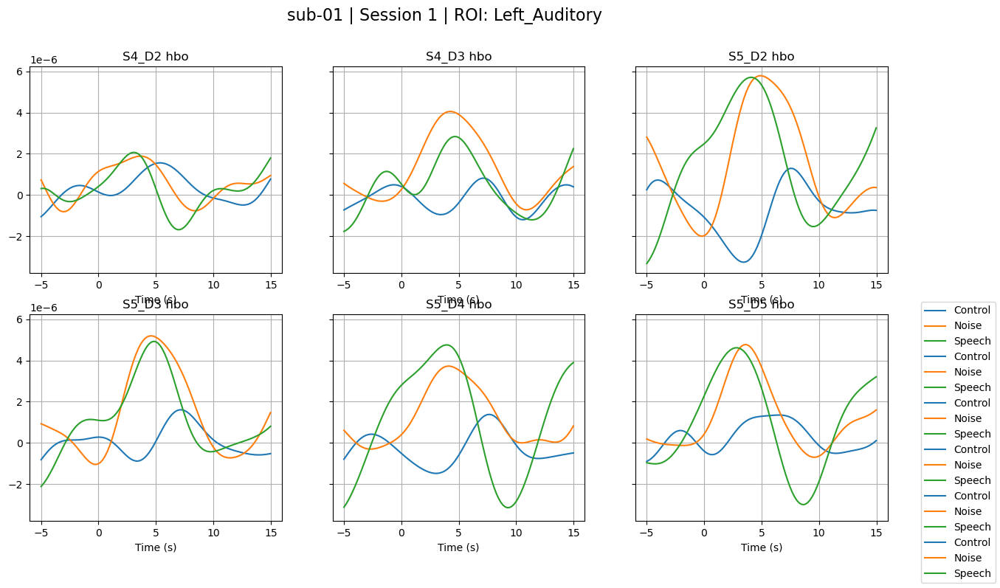

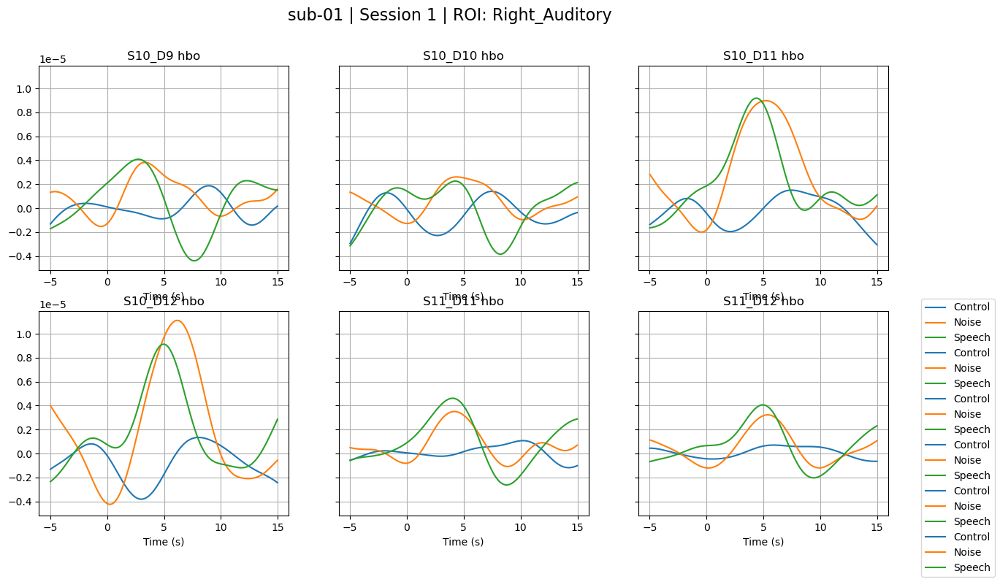

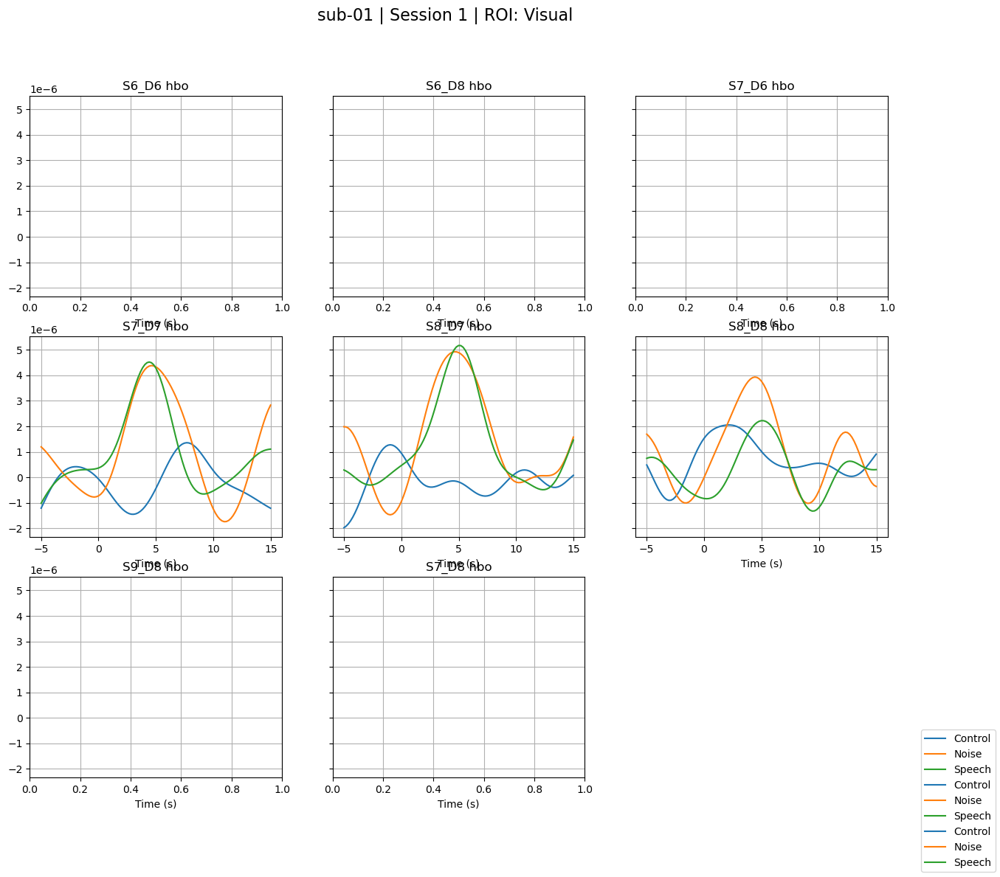

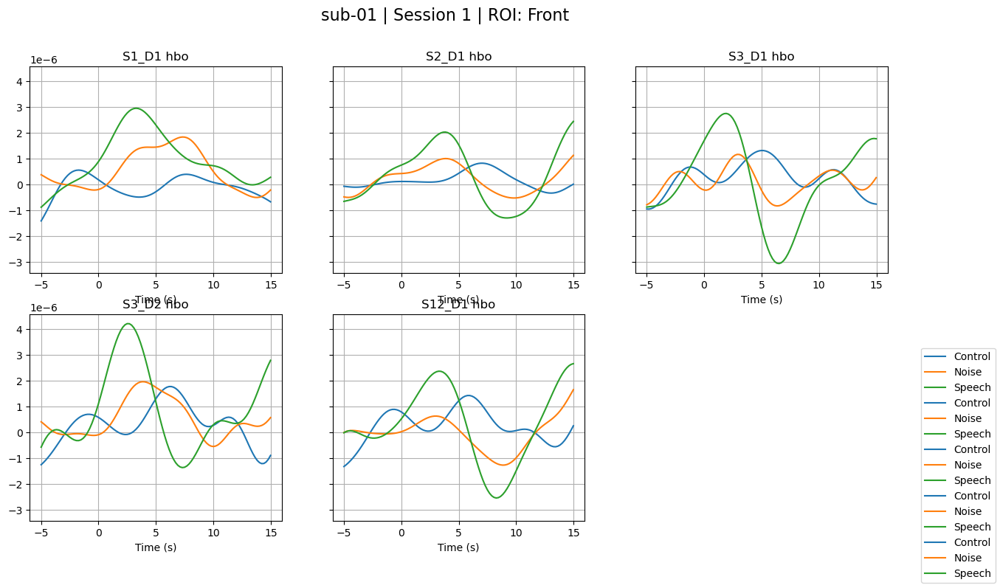

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 8
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 01, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 2 in Control - 16 bad channels, total deviation 1.57e-04
🚫 Rejecting Epoch 3 in Control - 15 bad channels, total deviation 1.04e-04
🚫 Rejecting Epoch 14 in Control - 14 bad channels, total deviation 1.30e-04
🚫 Rejecting Epoch 19 in Control - 13 bad channels, total deviation 1.18e-04
🚫 Rejecting Epoch 6 in Control - 12 bad channels, total deviation 7.89e-05
🚫 Rejecting Epoch 3 in Noise - 21 bad channels, total deviation 1.87e+02
🚫

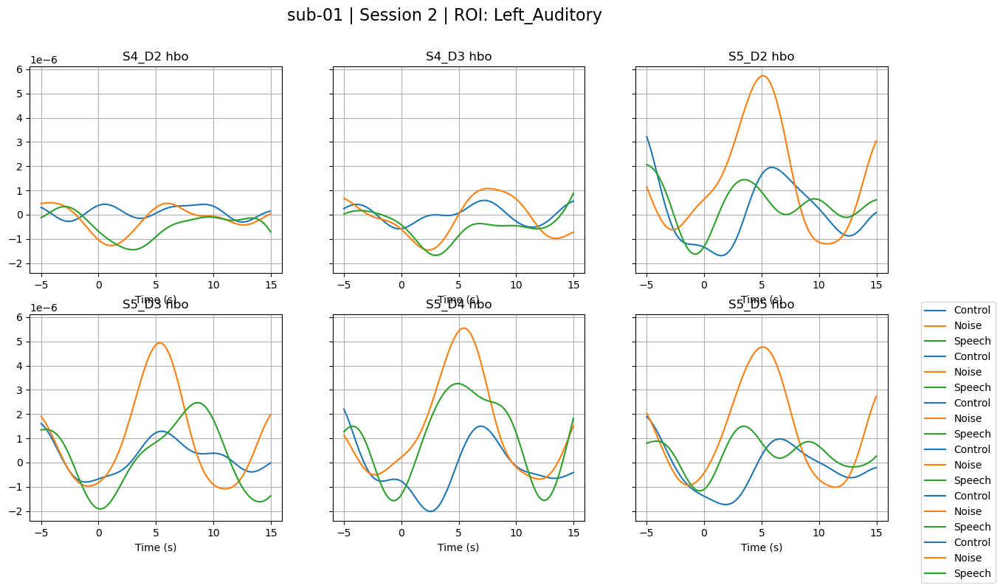

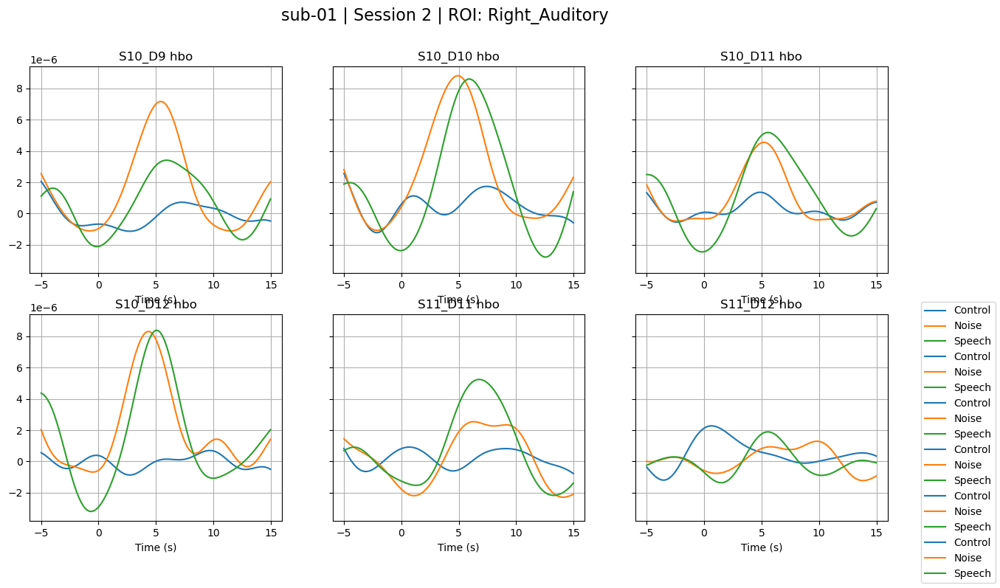

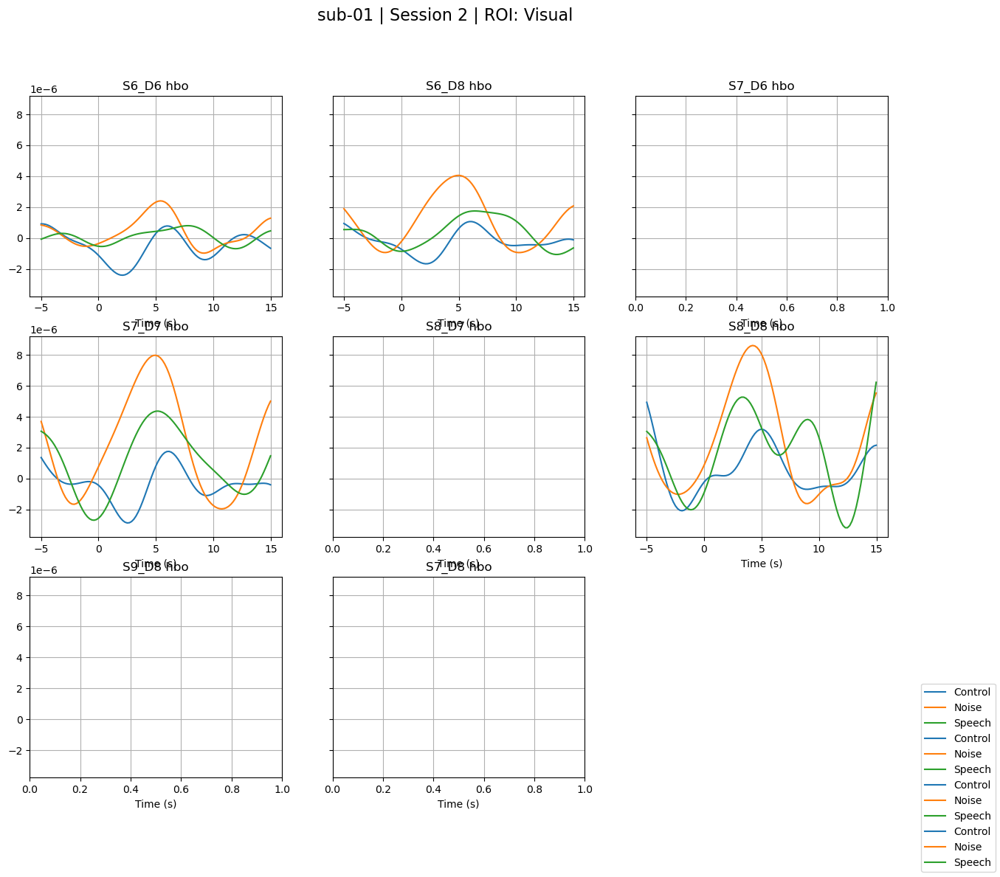

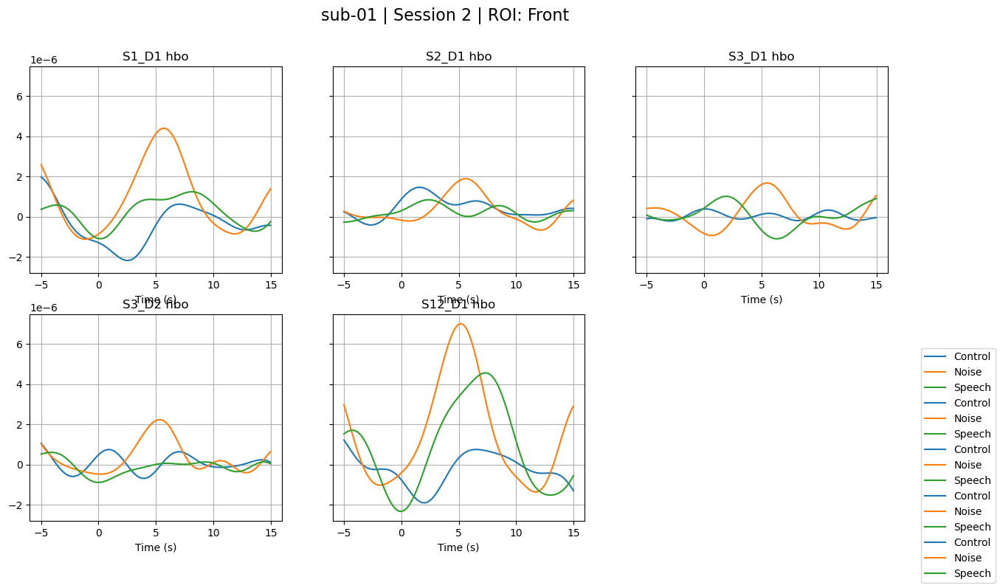

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 02, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 11 in Control - 19 bad channels, total deviation 1.00e-04
🚫 Rejecting Epoch 1 in Control - 19 bad channels, total deviation 9.24e-05
🚫 Rejecting Epoch 3 in Control - 17 bad channels, total deviation 1.12e-04
🚫 Rejecting Epoch 0 in Control - 15 bad channels, total deviation 1.08e-04
🚫 Rejecting Epoch 16 in Control - 15 bad channels, total deviation 9.16e-05
🚫 Rejecting Epoch 16 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 14 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 5 in Noise - 24 ba

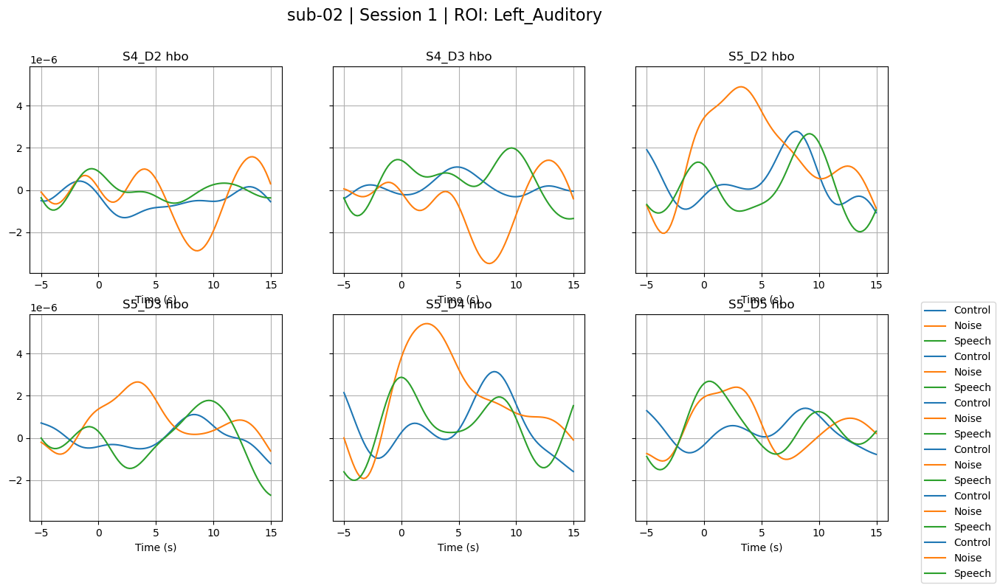

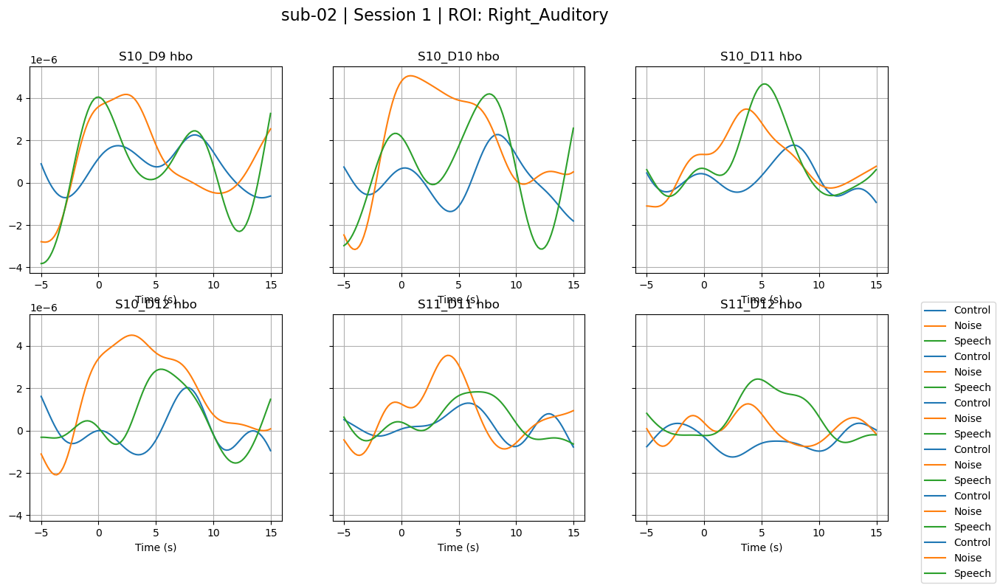

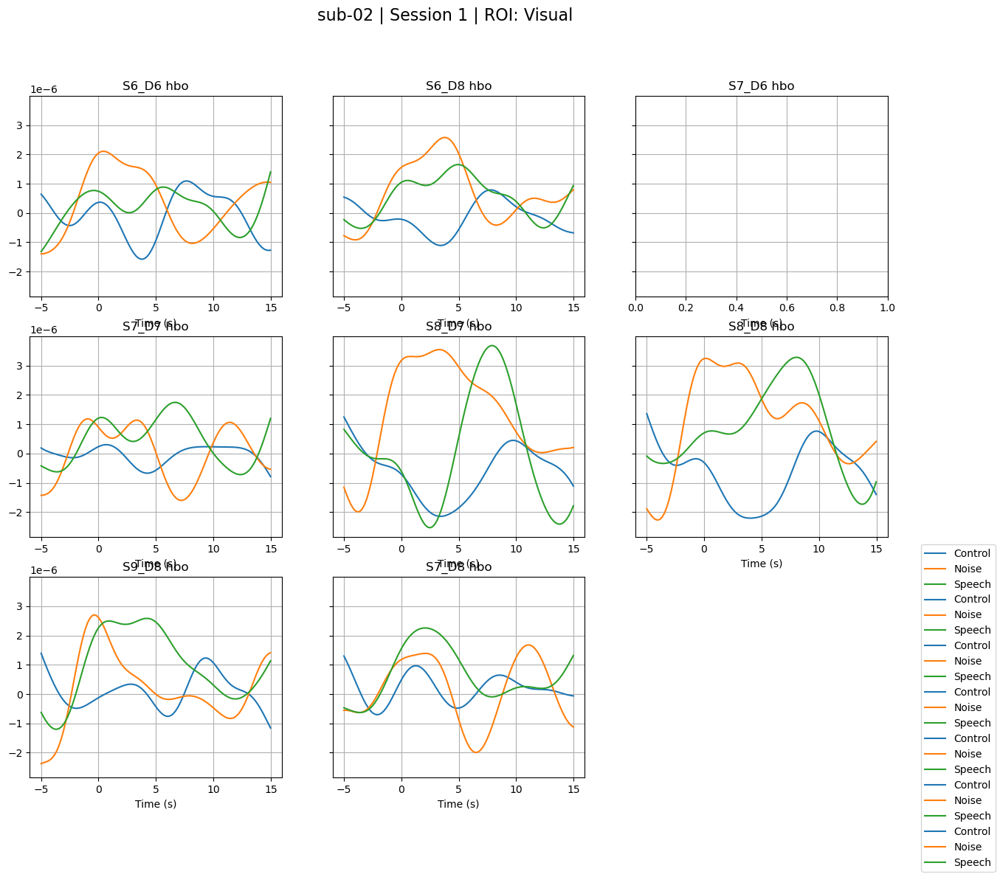

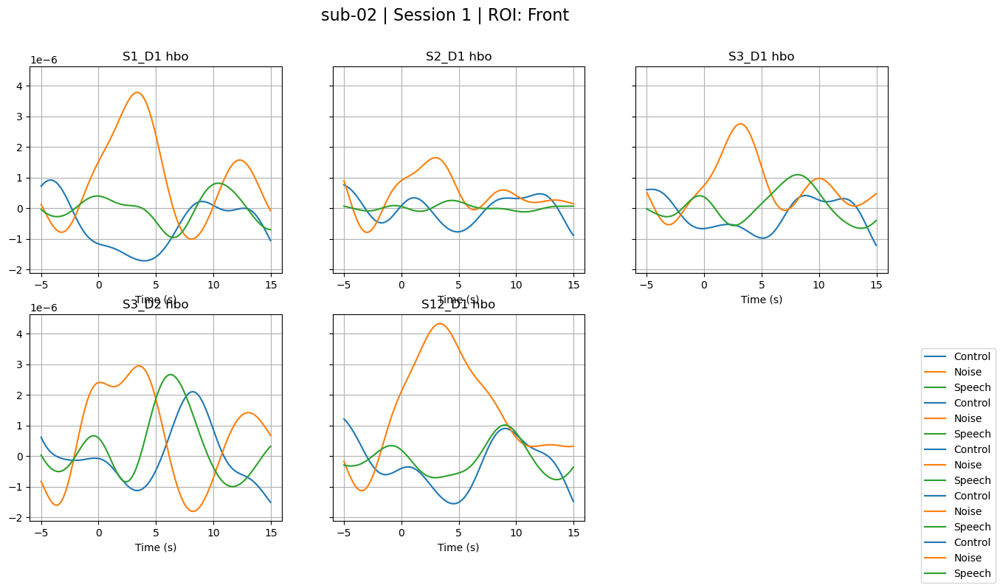

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 02, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 3 in Control - 17 bad channels, total deviation 1.93e-04
🚫 Rejecting Epoch 2 in Control - 13 bad channels, total deviation 1.07e-04
🚫 Rejecting Epoch 4 in Control - 12 bad channels, total deviation 8.93e-05
🚫 Rejecting Epoch 15 in Control - 9 bad channels, total deviation 1.09e-04
🚫 Rejecting Epoch 16 in Control - 9 bad channels, total deviation 4.88e-05
🚫 Rejecting Epoch 18

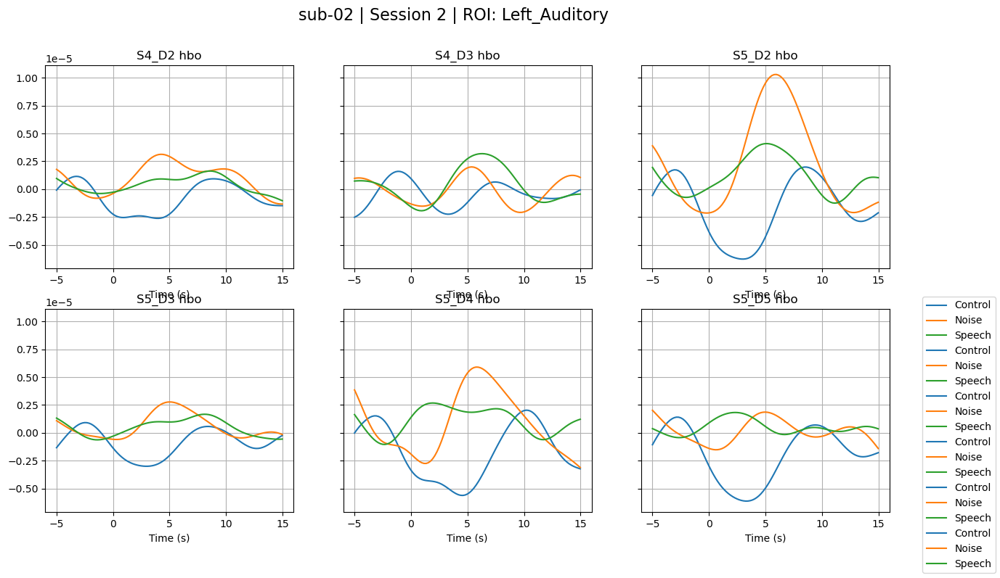

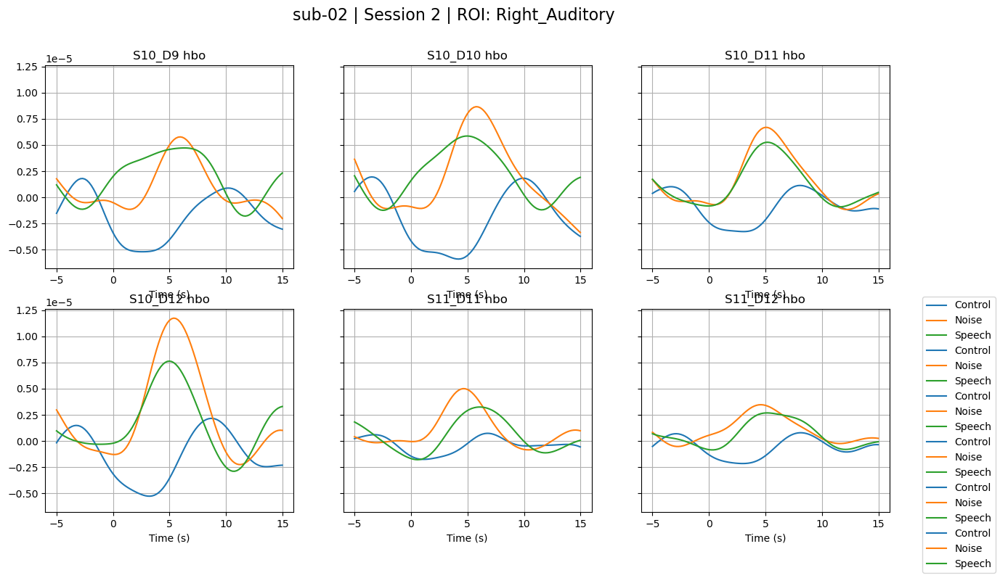

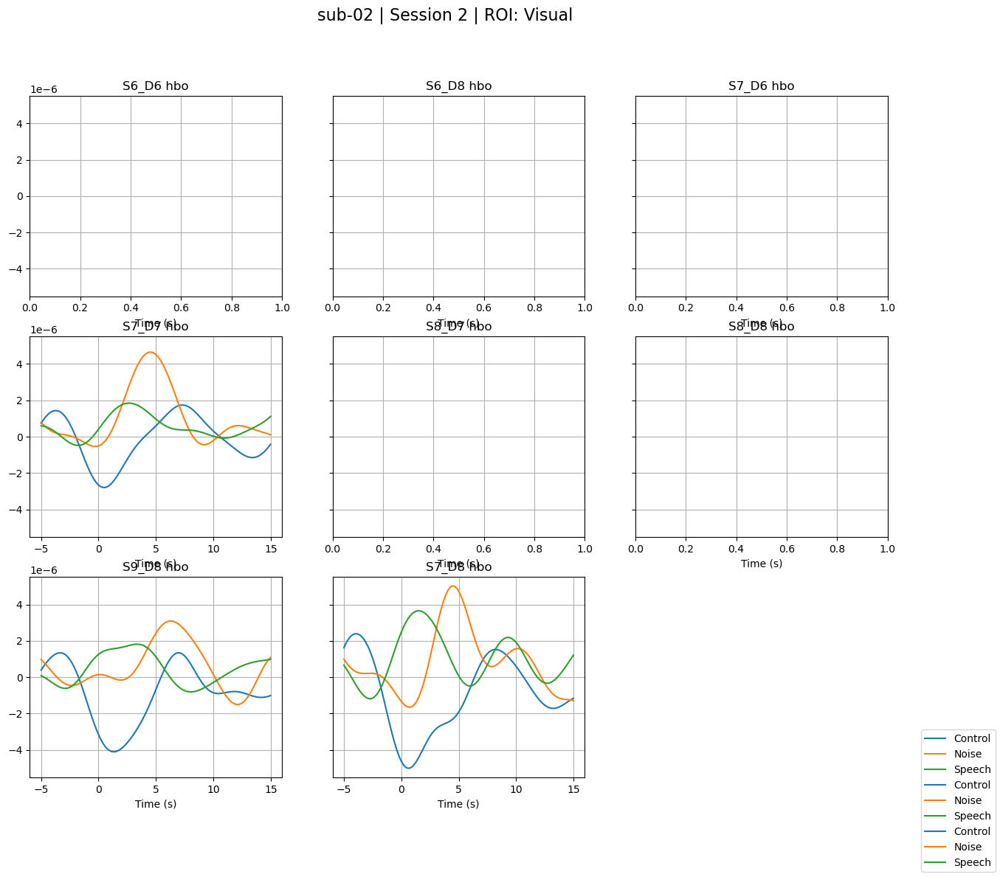

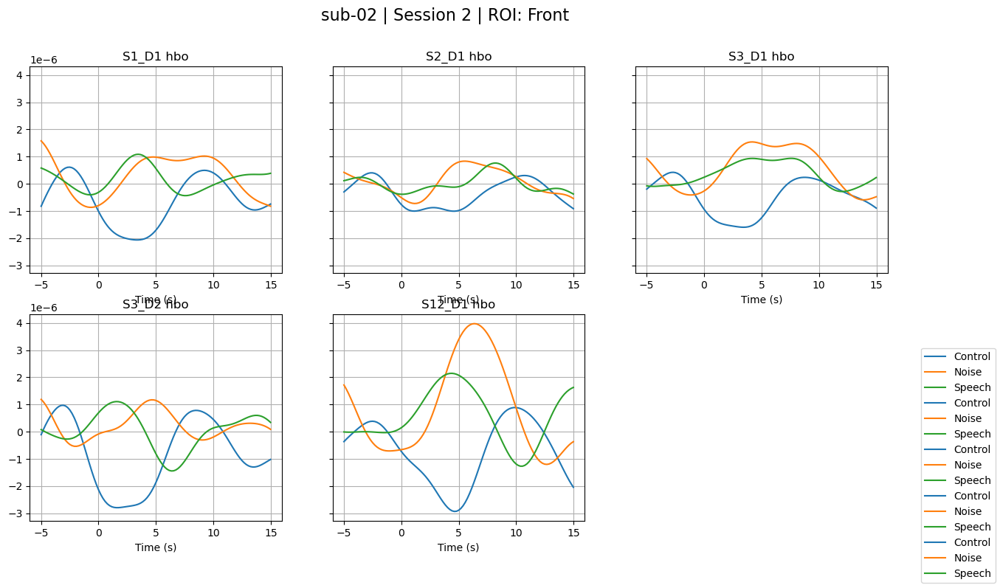

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 03, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 15 in Control - 22 bad channels, total deviation 1.74e-04
🚫 Rejecting Epoch 19 in Control - 19 bad channels, total deviation 1.95e-04
🚫 Rejecting Epoch 14 in Control - 18 bad channels, total deviation 2.00e-04
🚫 Rejecting Epoch 6 in Control - 18 bad channels, total deviation 1.11e-04
🚫 Rejecting Epoch 11 in Control - 17 bad channels, total deviation 1.79e-04
🚫 Rejecting Epoch 19 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 2 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 R

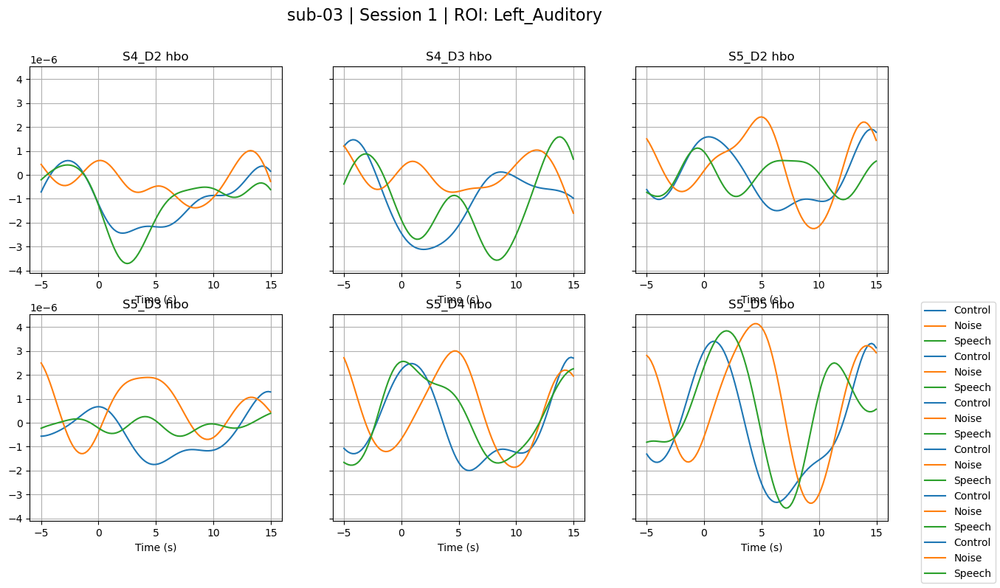

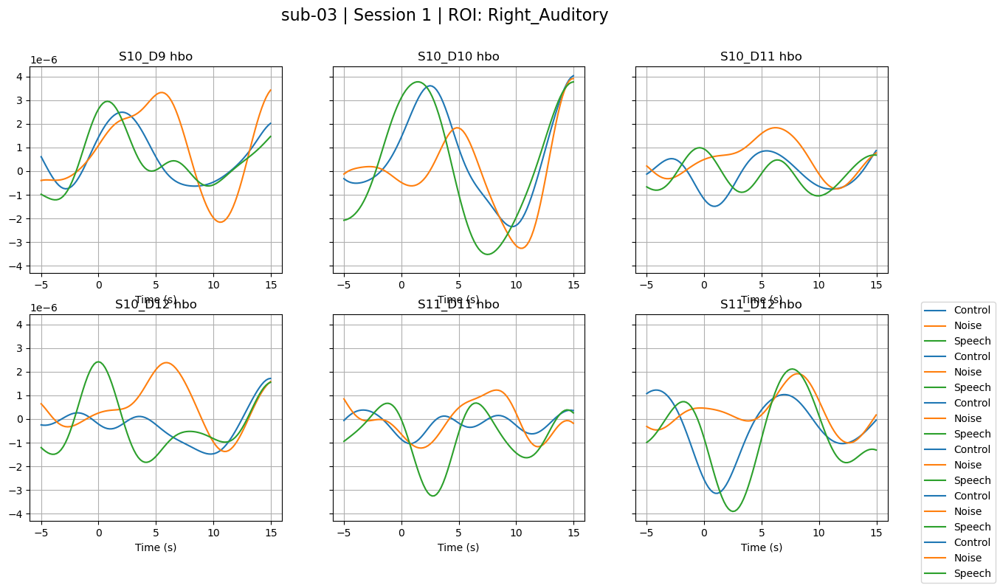

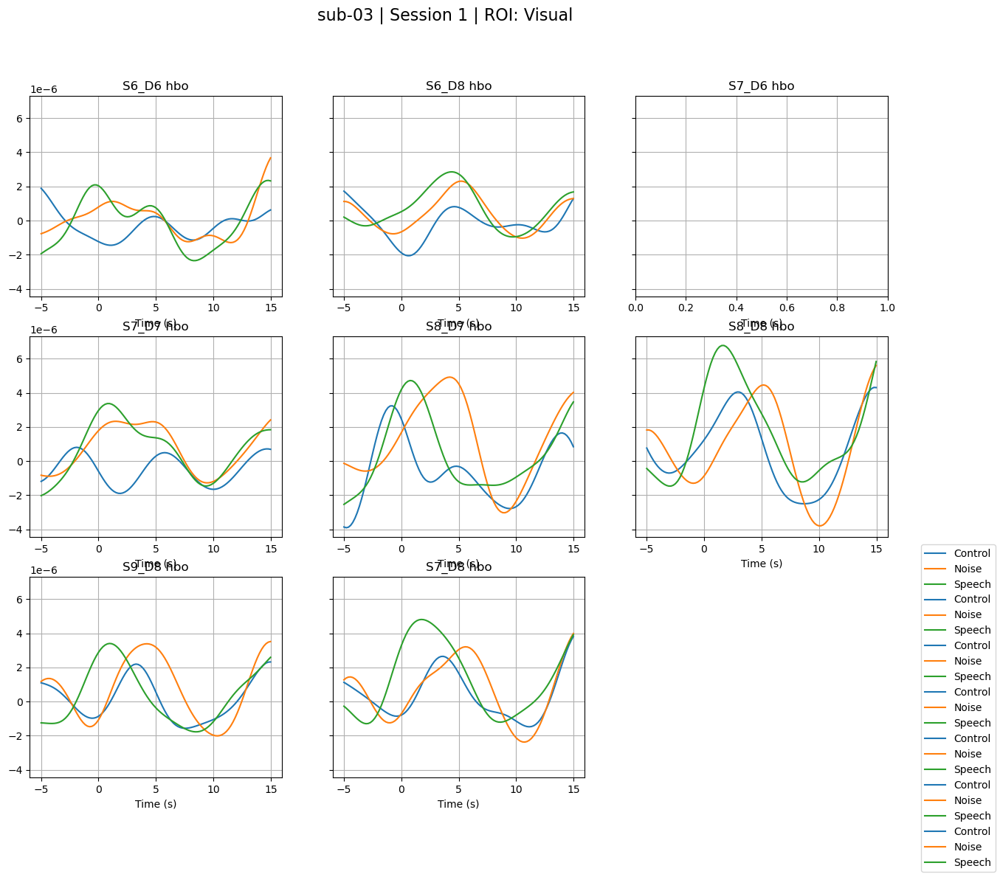

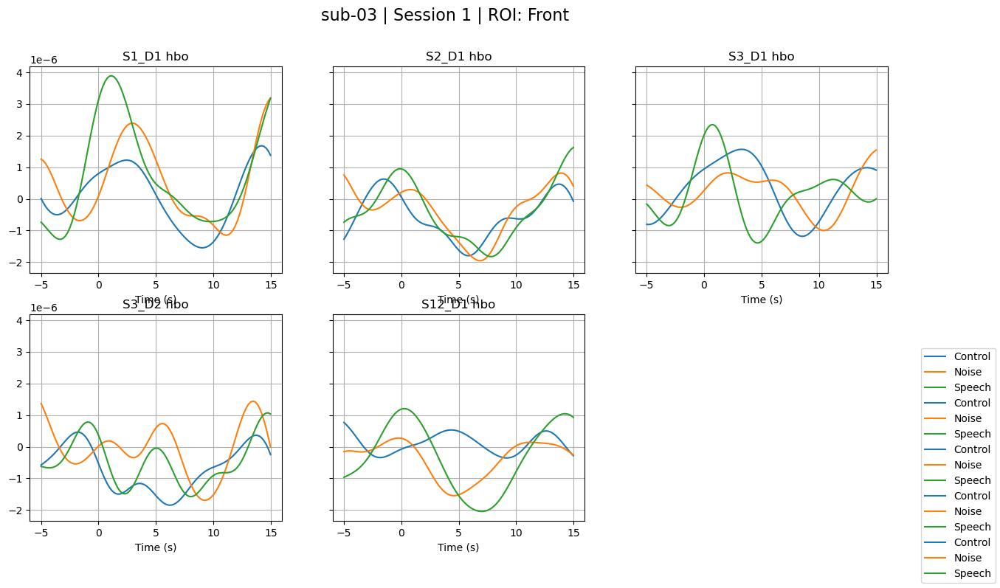

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 03, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 3 in Control - 24 bad channels, total deviation 6.15e-04
🚫 Rejecting Epoch 4 in Control - 24 bad channels, total deviation 5.28e-04
🚫 Rejecting Epoch 0 in Control - 24 bad channels, total deviation 4.24e-04
🚫 Rejecting Epoch 7 in Control - 24 bad channels, total deviation 3.77e-04
🚫 Rejecting Epoch 16 in Control - 24 bad channels, total deviation 3.76e-04
🚫 Rejecting Epoch 10 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 7 in Noise - 24 bad channels, to

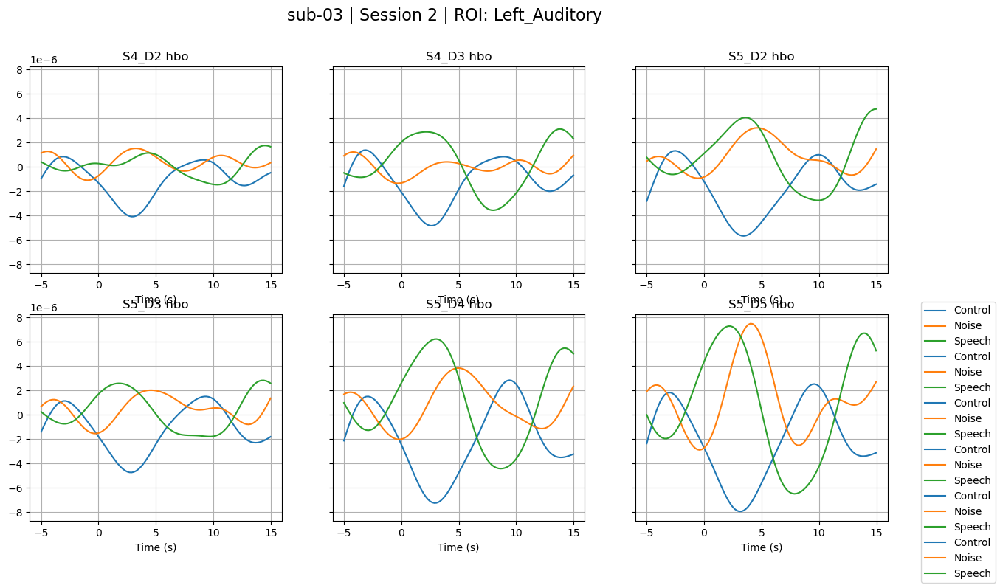

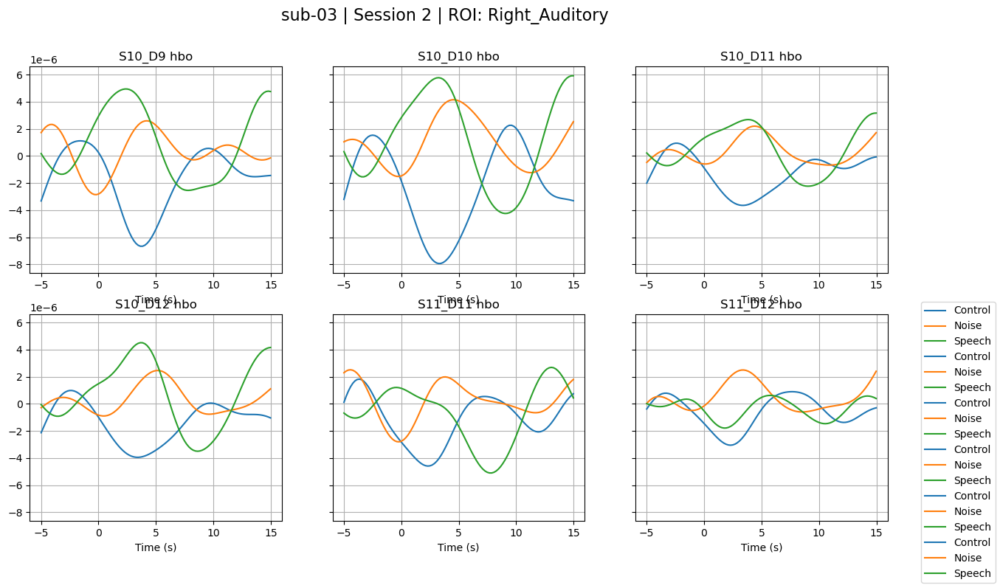

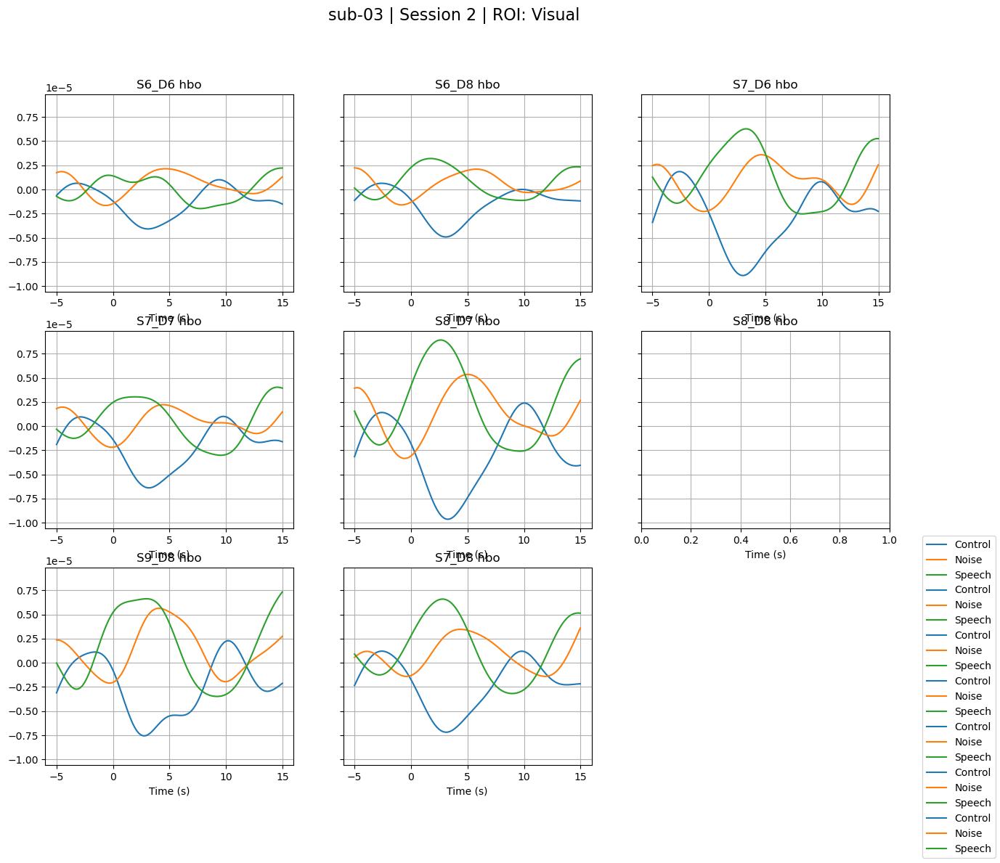

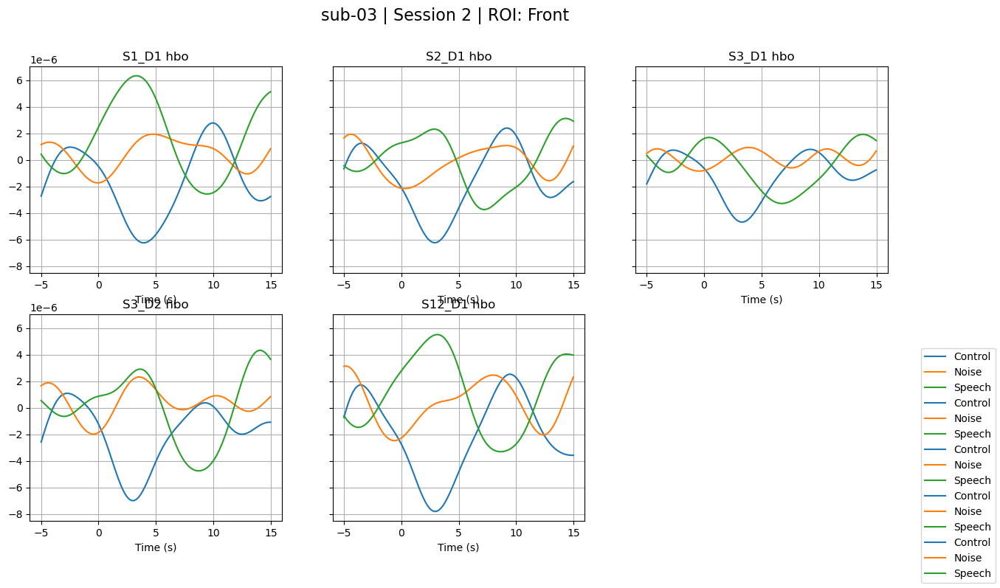

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 04, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 15 in Control - 25 bad channels, total deviation 3.57e-04
🚫 Rejecting Epoch 9 in Control - 25 bad channels, total deviation 2.86e-04
🚫 Rejecting Epoch 2 in Control - 23 bad channels, total deviation 2.32e-04
🚫 Rejecting Epoch 1 in Control - 23 bad channels, total deviation 2.29e-04
🚫 Rejecting Epoch 3 in Control - 22 bad channels, total deviation 1.48e-04
🚫 Rejecting Epoch 17 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 14 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 

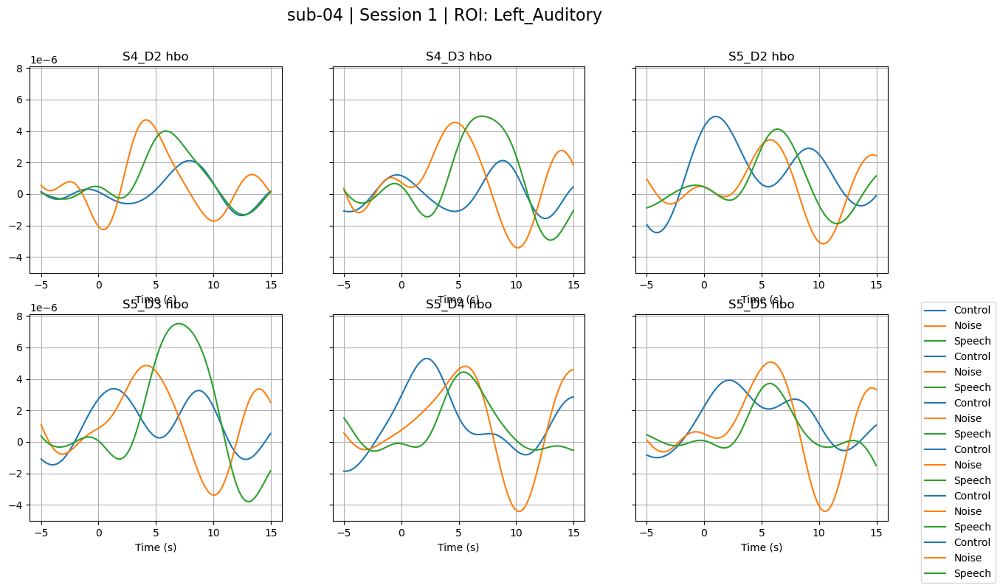

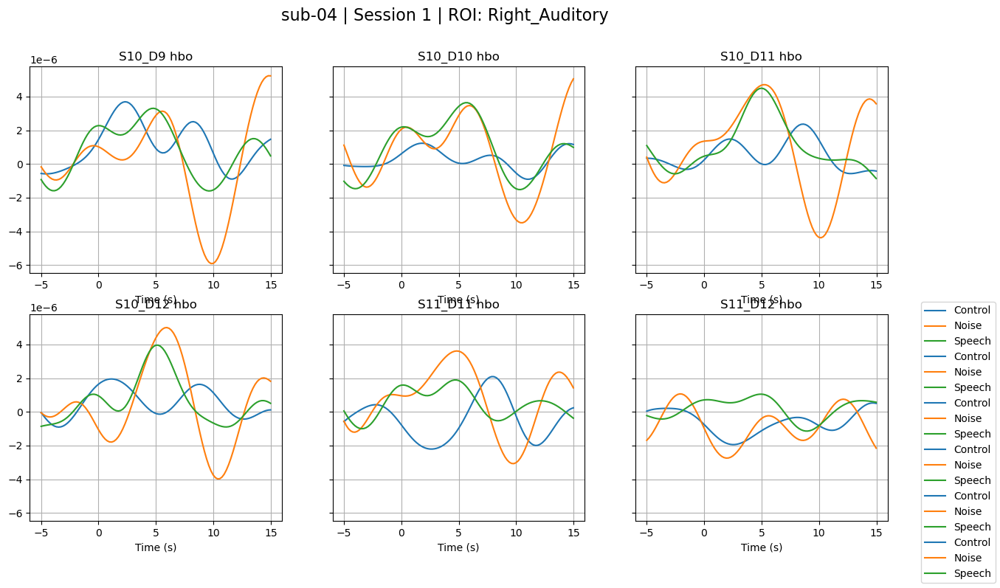

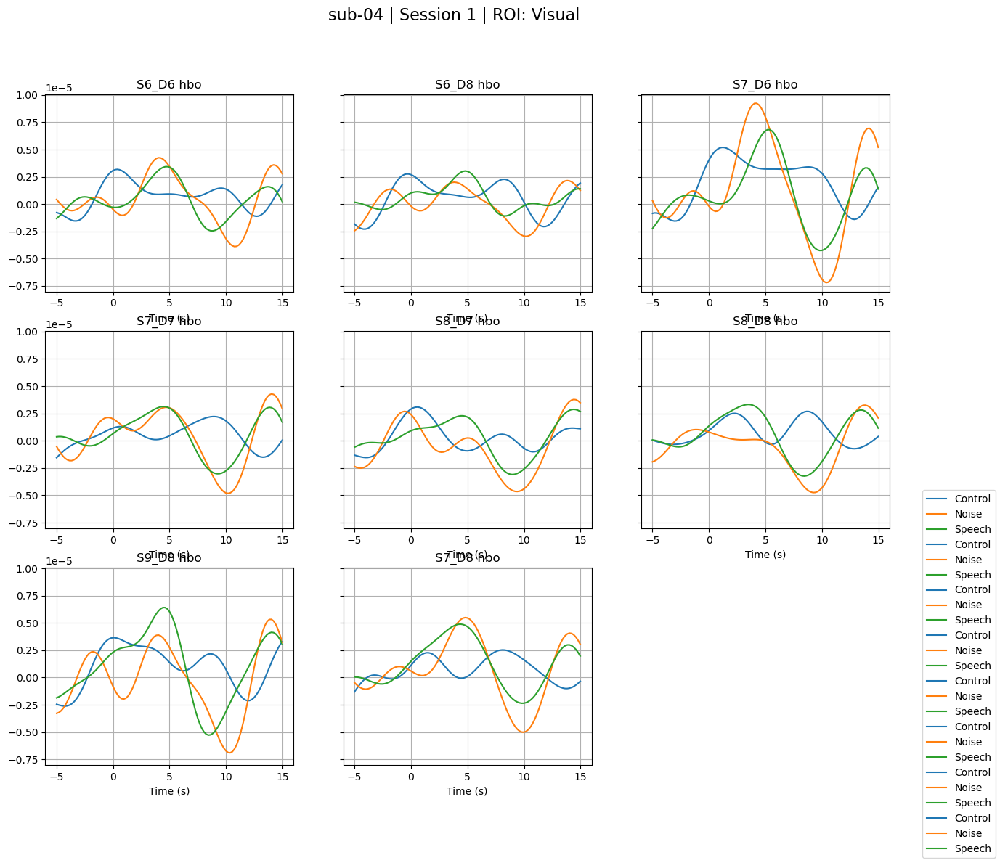

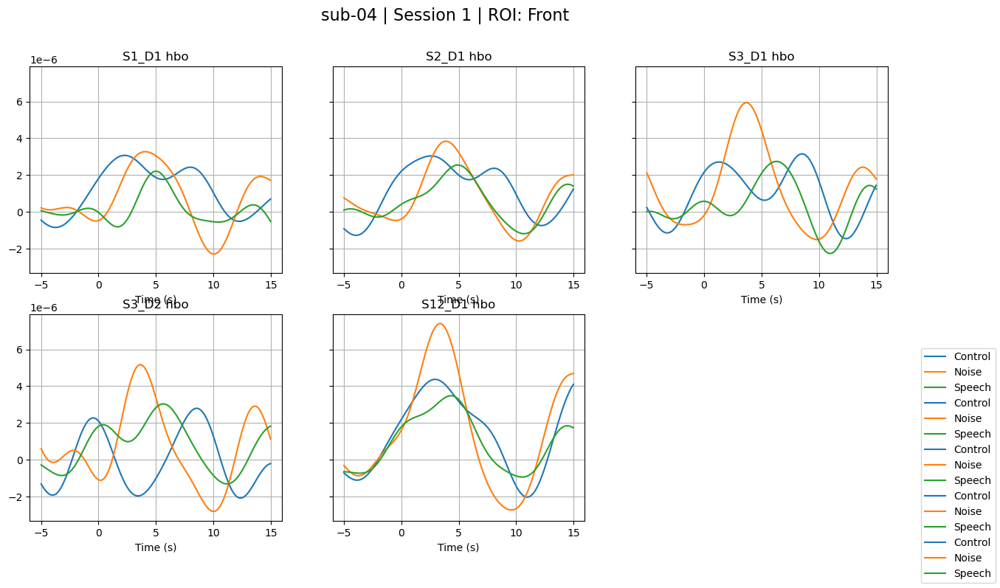

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 04, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 11 in Control - 19 bad channels, total deviation 2.16e-04
🚫 Rejecting Epoch 10 in Control - 18 bad channels, total deviation 1.57e-04
🚫 Rejecting Epoch 2 in Control - 18 bad channels, total deviation 1.37e-04
🚫 Rejecting Epoch 1 in Control - 17 bad channels, total deviation 1.53e-04
🚫 Rejecting Epoch 15 in Control - 17 bad channels, total deviation 1.39e-04
🚫 Rejecting Epoch 13 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 12 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 3 in Noise - 2

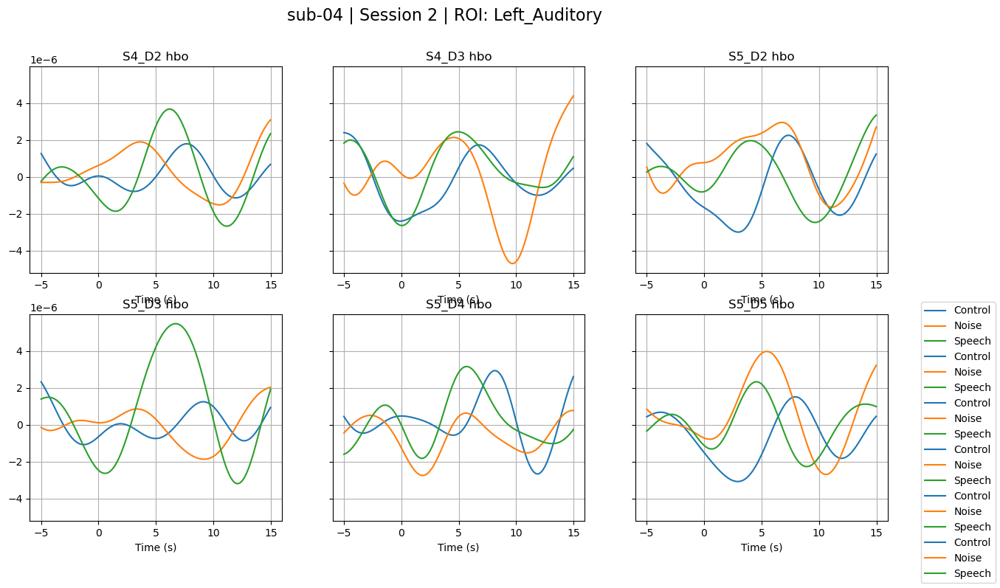

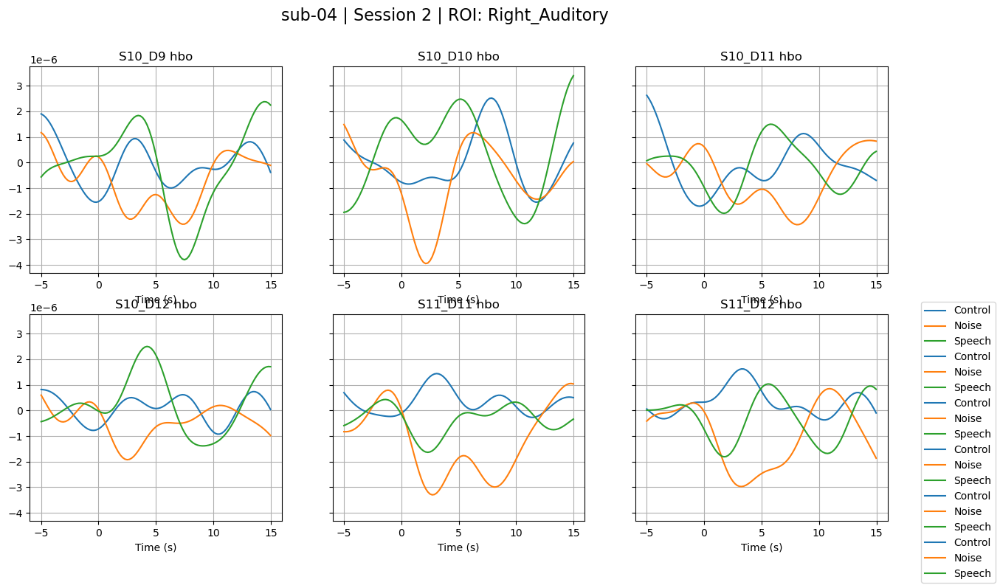

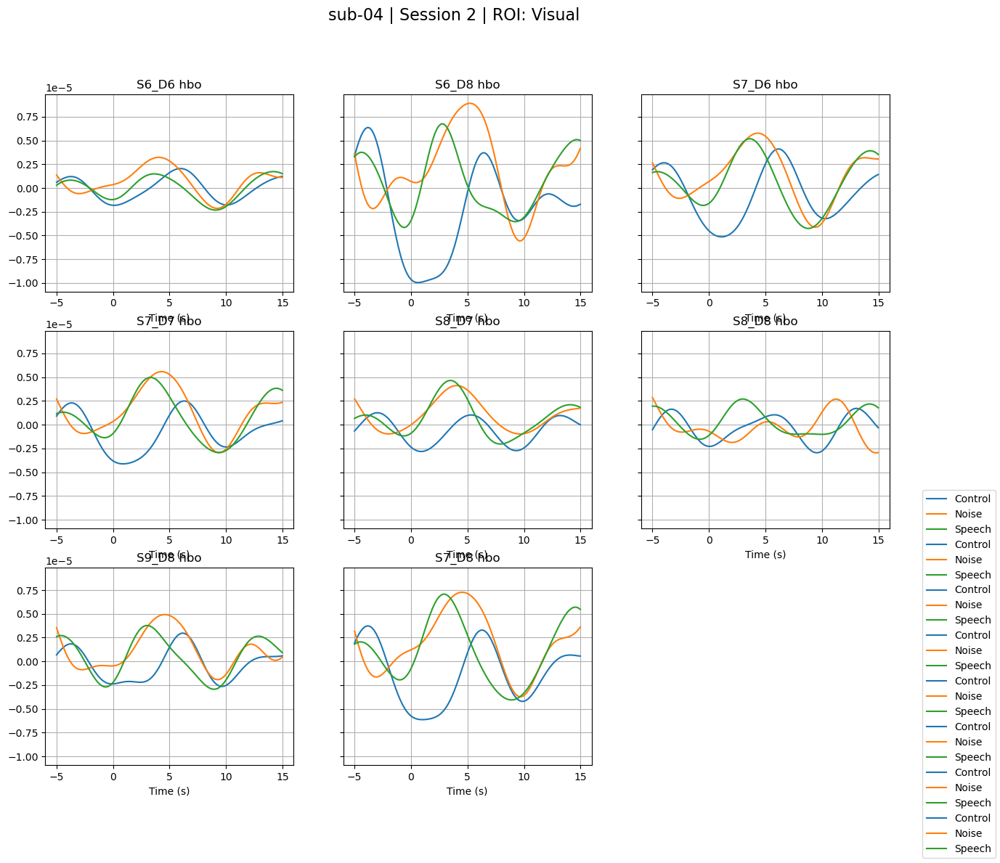

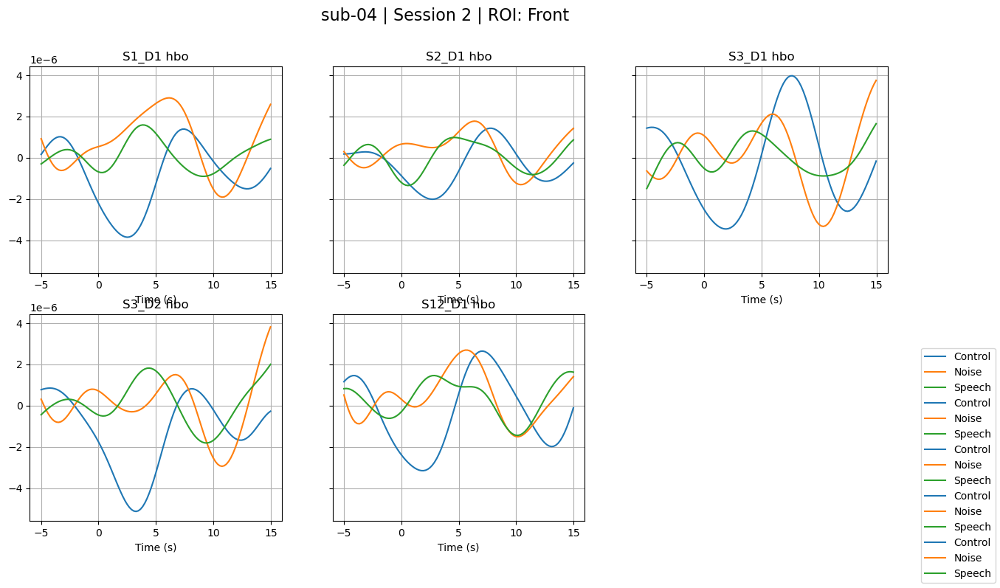

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 05, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 19 in Control - 20 bad channels, total deviation 1.31e-04
🚫 Rejecting Epoch 6 in Control - 18 bad channels, total deviation 1.81e-04
🚫 Rejecting Epoch 10 in Control - 18 bad channels, total deviation 1.22e-04
🚫 Rejecting Epoch 18 in Control - 18 bad channels, total deviation 1.18e-04
🚫 Rejecting Epoch 1 in Control - 17 bad channels, total deviation 8.40e-05
🚫 Rejecting Epoch 6 in Noise - 23 bad channels, total deviation 2.05e+02
🚫 Rejecting Epoch 7 in Noise - 23 bad channels, total de

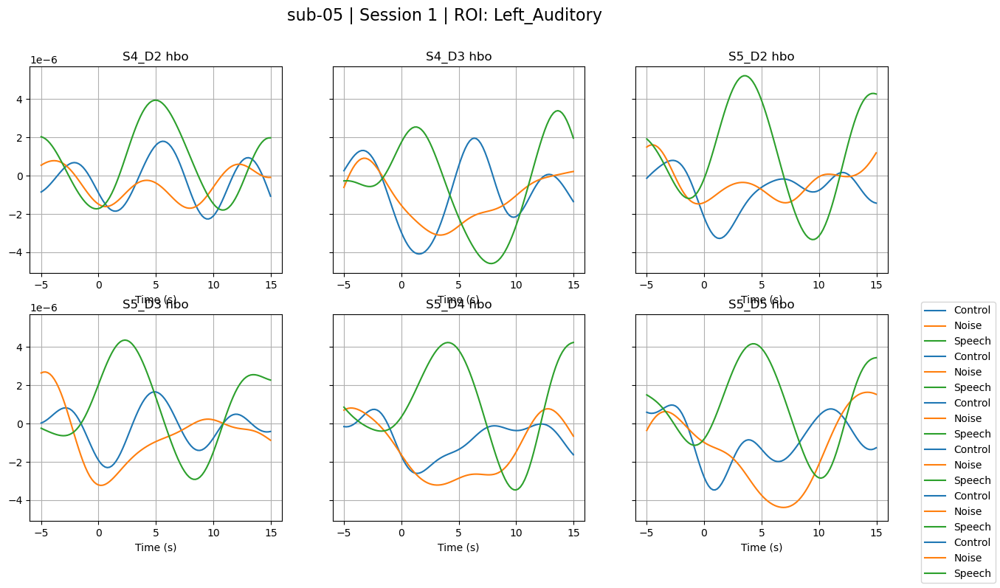

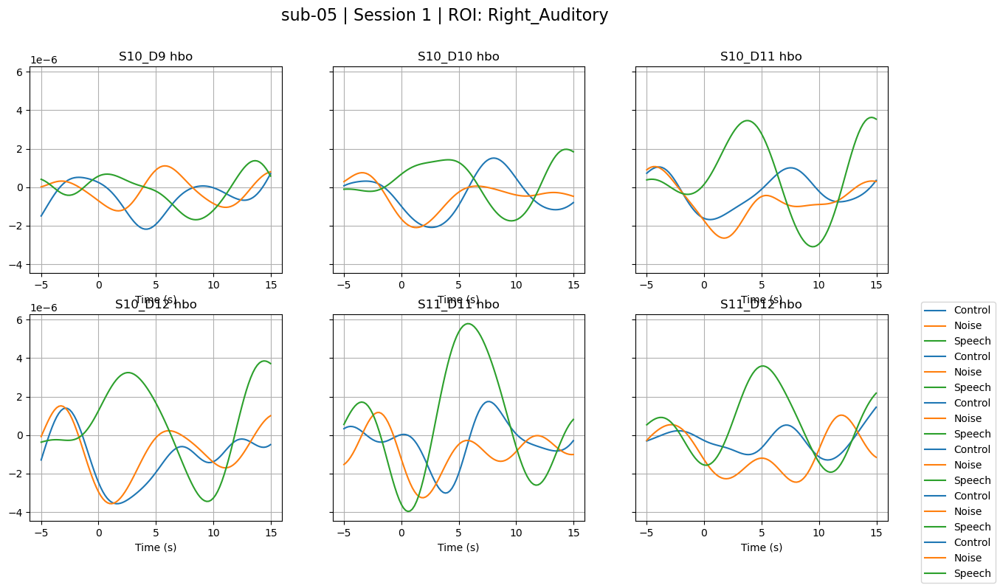

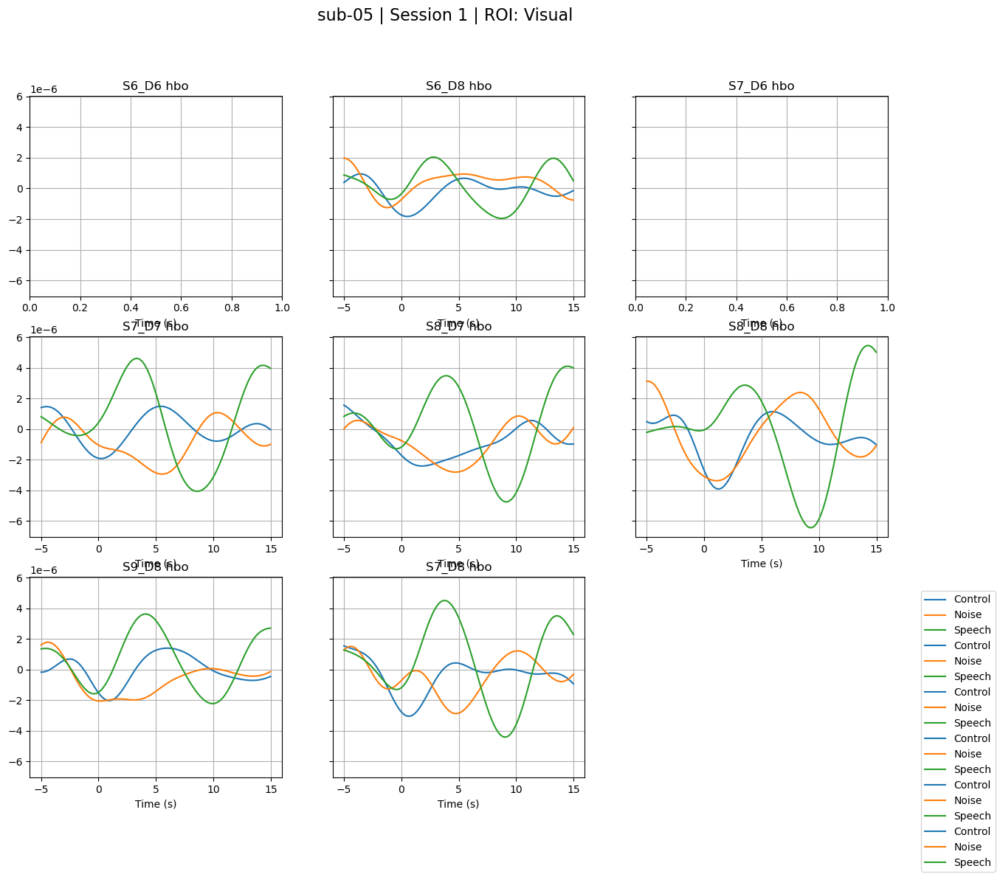

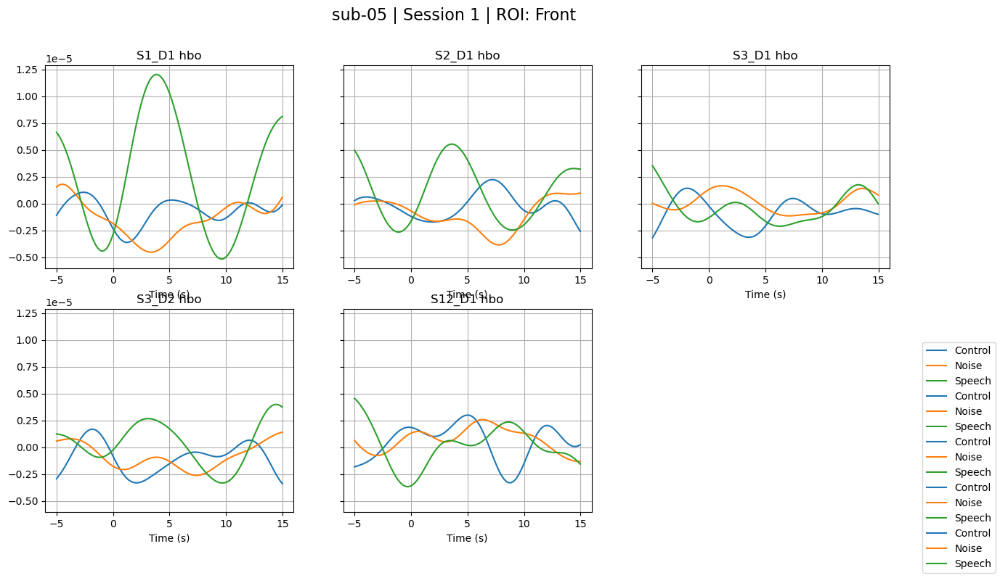

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 05, Session 02: 56 epochs loaded
🚫 Rejecting Epoch 19 in Control - 20 bad channels, total deviation 4.32e-04
🚫 Rejecting Epoch 12 in Control - 19 bad channels, total deviation 4.37e-04
🚫 Rejecting Epoch 5 in Control - 19 bad channels, total deviation 2.98e-04
🚫 Rejecting Epoch 9 in Control - 19 bad channels, total deviation 2.66e-04
🚫 Rejecting Epoch 17 in Control - 19 bad channels, total deviation 2.38e-04
🚫 Rejecting Epoch

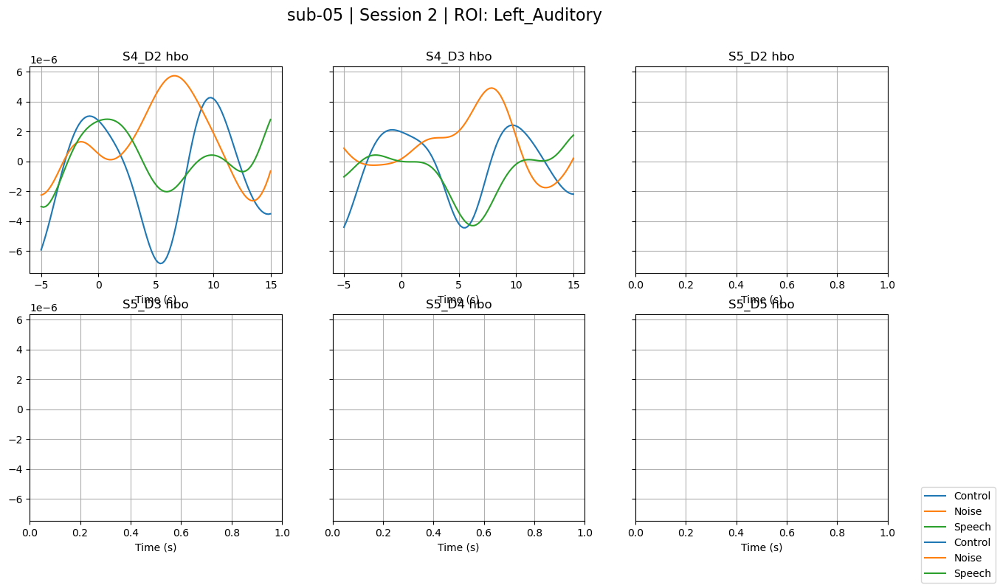

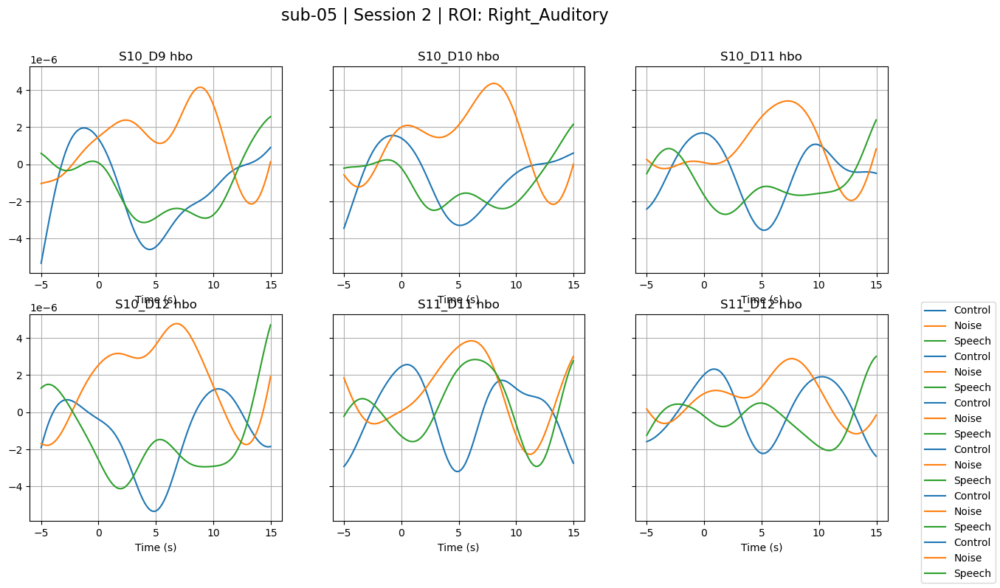

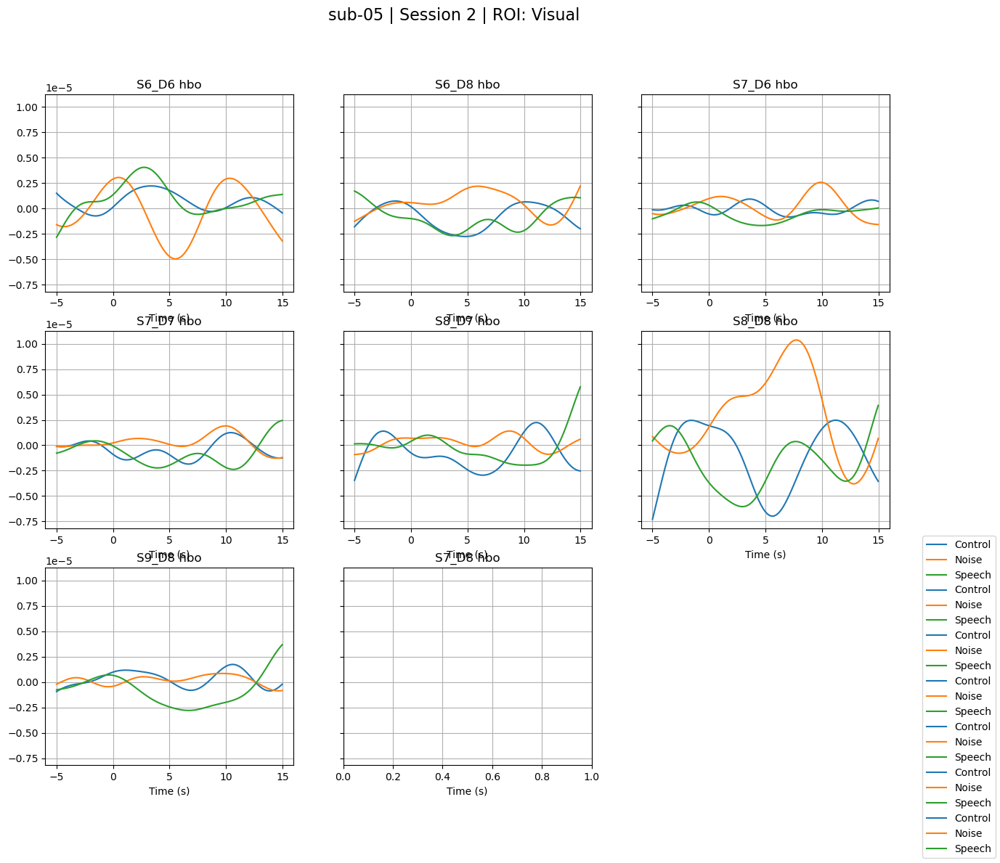

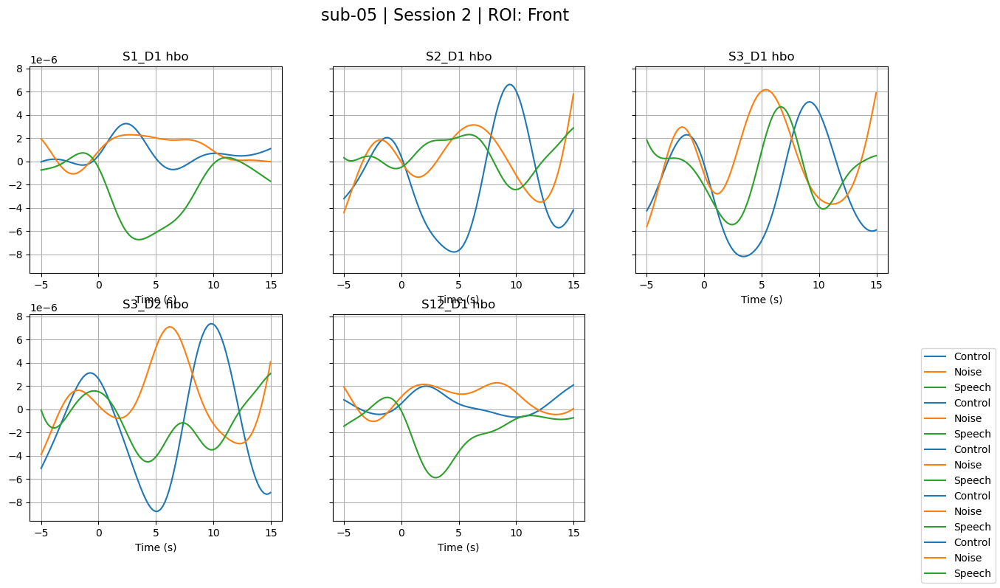

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 0 in Control - 16 bad channels, total deviation 9.11e-05
🚫 Rejecting Epoch 15 in Control - 15 bad channels, total deviation 4.89e-05
🚫 Rejecting Epoch 19 in Control - 13 bad channels, total deviation 7.30e-05
🚫 Rejecting Epoch 9 in Control - 13 bad channels, total deviation 6.77e-05
🚫 Rejecting Epoch 11 in Control - 13 bad channels, total deviation 6.53e-05
🚫 Rejecting Epoch 2 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 11 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 R

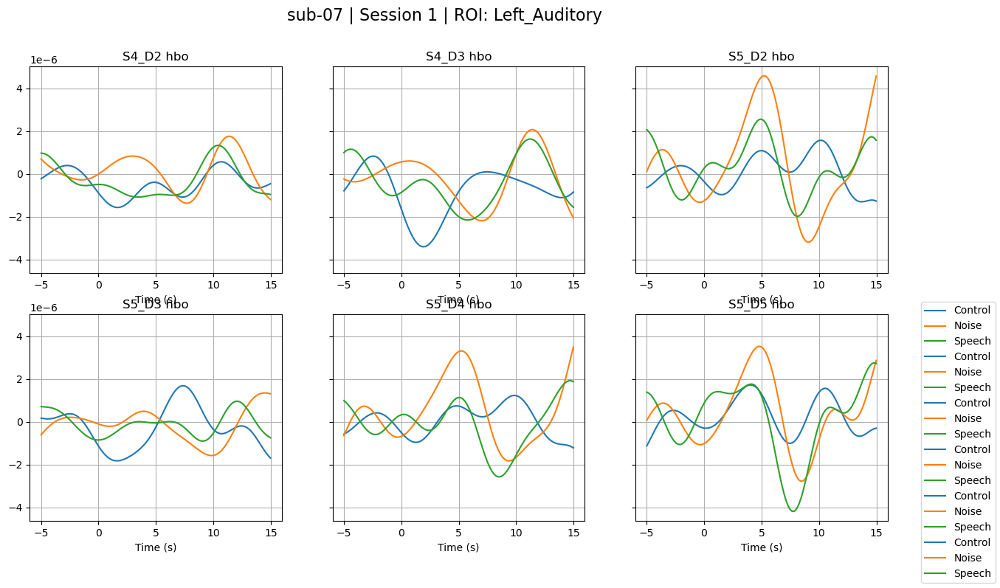

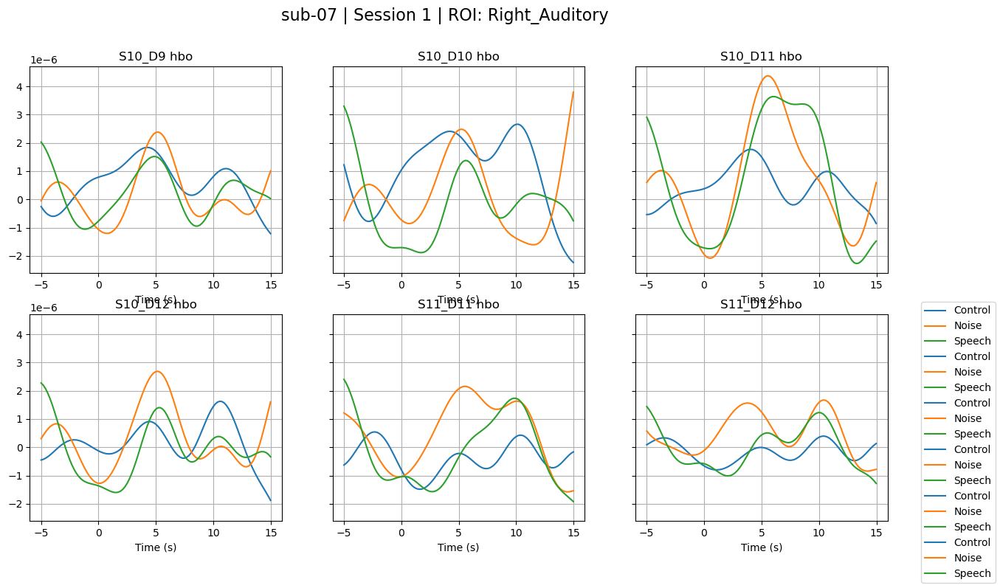

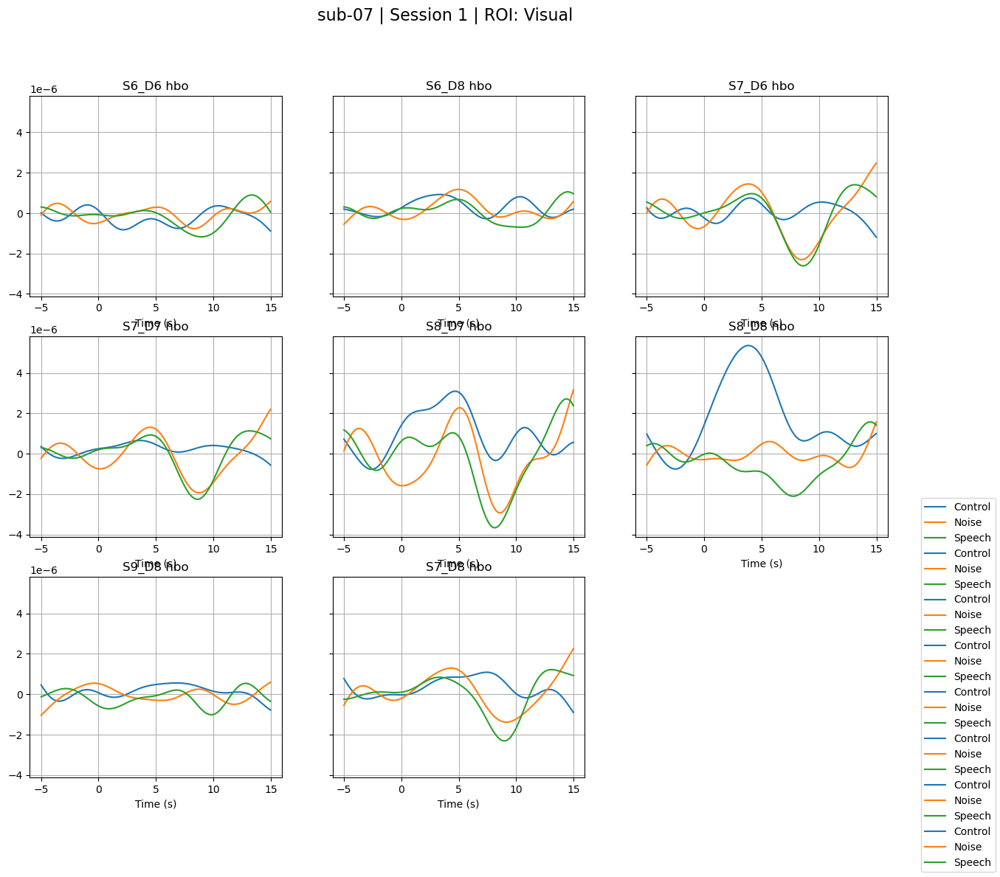

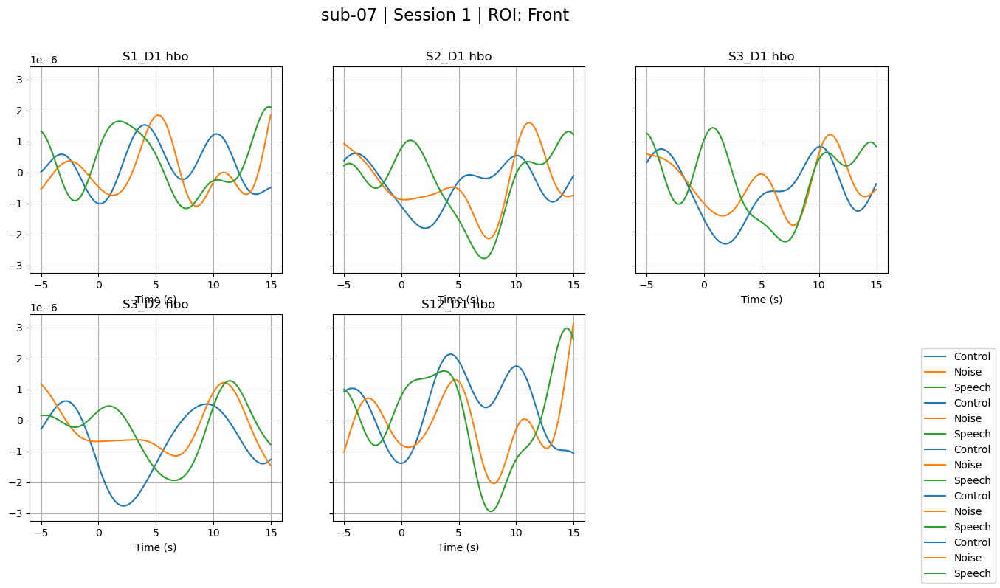

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 6 in Control - 19 bad channels, total deviation 1.43e-04
🚫 Rejecting Epoch 15 in Control - 18 bad channels, total deviation 1.01e-04
🚫 Rejecting Epoch 11 in Control - 13 bad channels, total deviation 9.06e-05
🚫 Rejecting Epoch 0 in Control - 13 bad channels, total deviation 5.18e-05
🚫 Rejecting Epoch 19 in Control - 13 bad channels, total deviation 4.92e-05
🚫 Rejecting Epoch 0 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 12 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 R

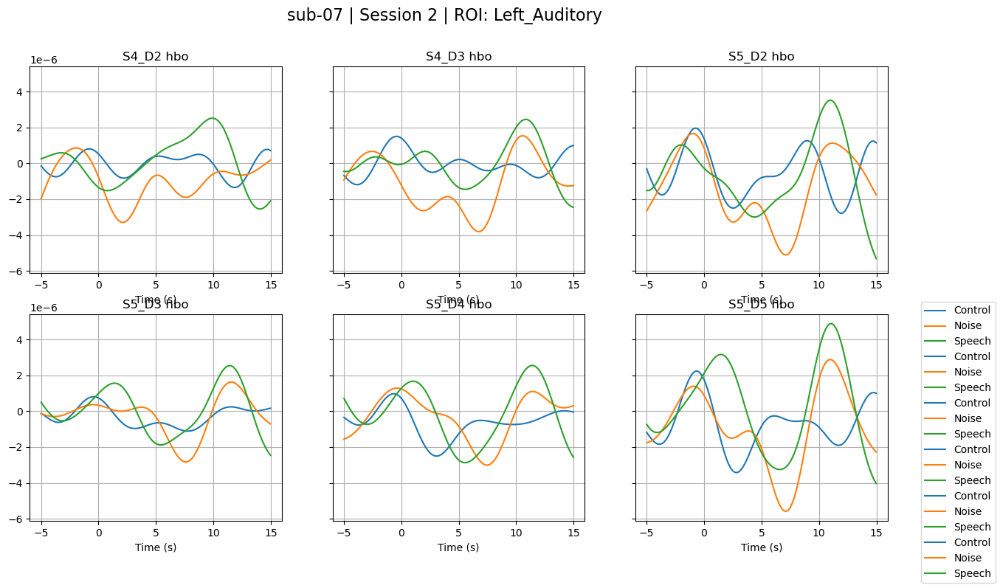

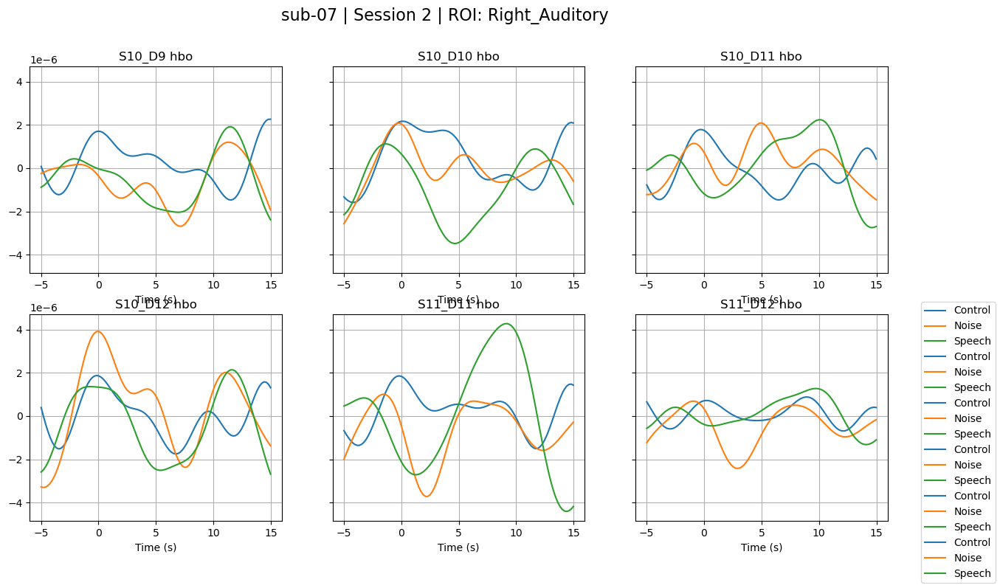

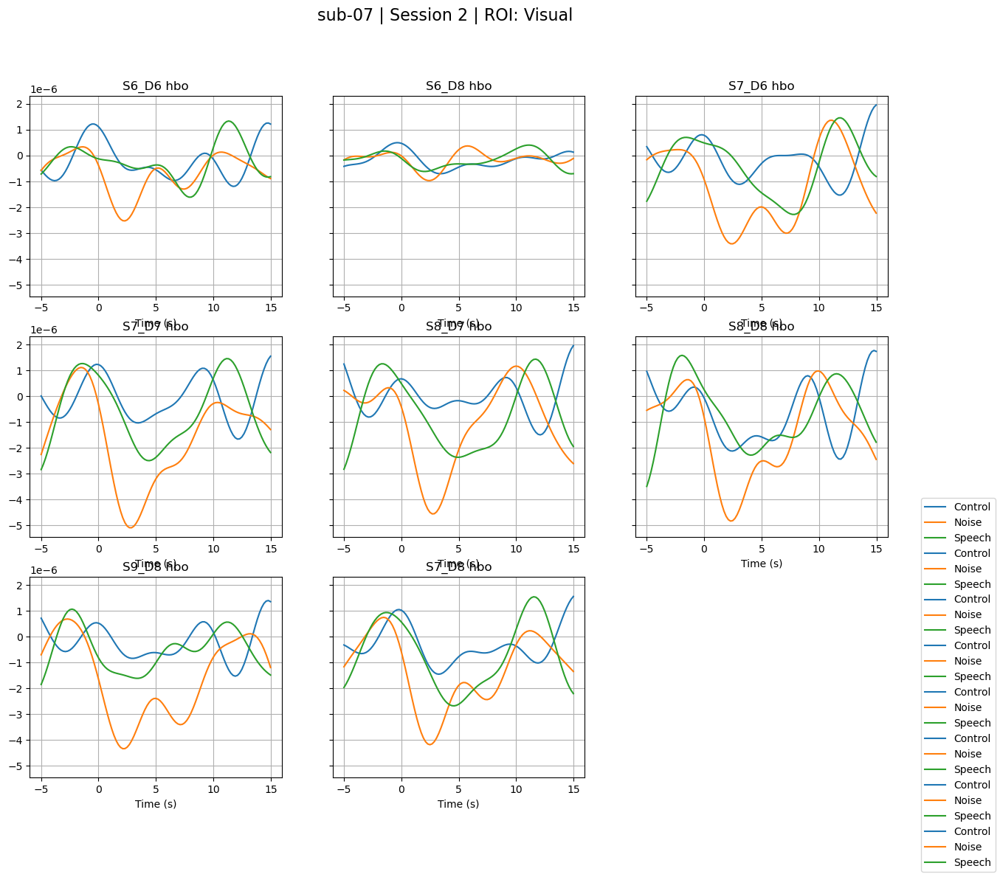

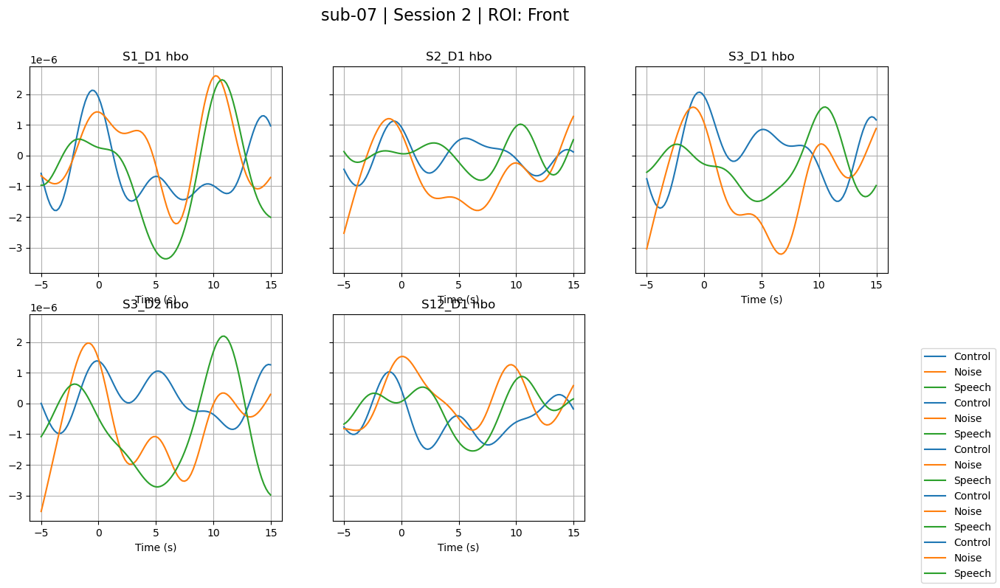

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 13 in Control - 19 bad channels, total deviation 1.60e-04
🚫 Rejecting Epoch 2 in Control - 17 bad channels, total deviation 1.60e-04
🚫 Rejecting Epoch 19 in Control - 14 bad channels, total deviation 4.50e-05
🚫 Rejecting Epoch 12 in Control - 12 bad channels, total deviation 4.12e-05
🚫 Rejecting Epoch 11 in Control - 10 bad channels, total deviation 7.67e-05
🚫 Rejecting Epoch 13 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 4 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 11 in Noise - 25 bad channels, total de

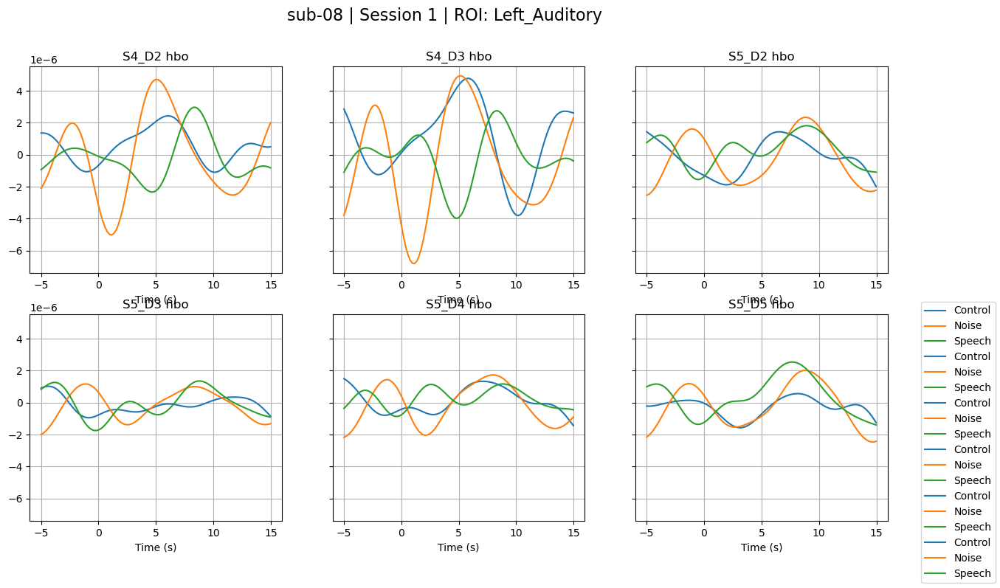

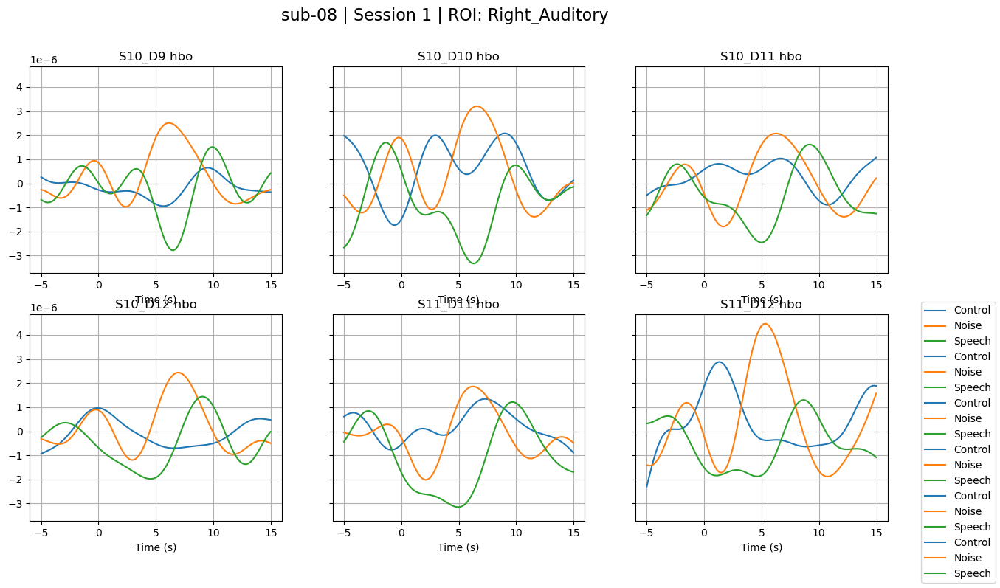

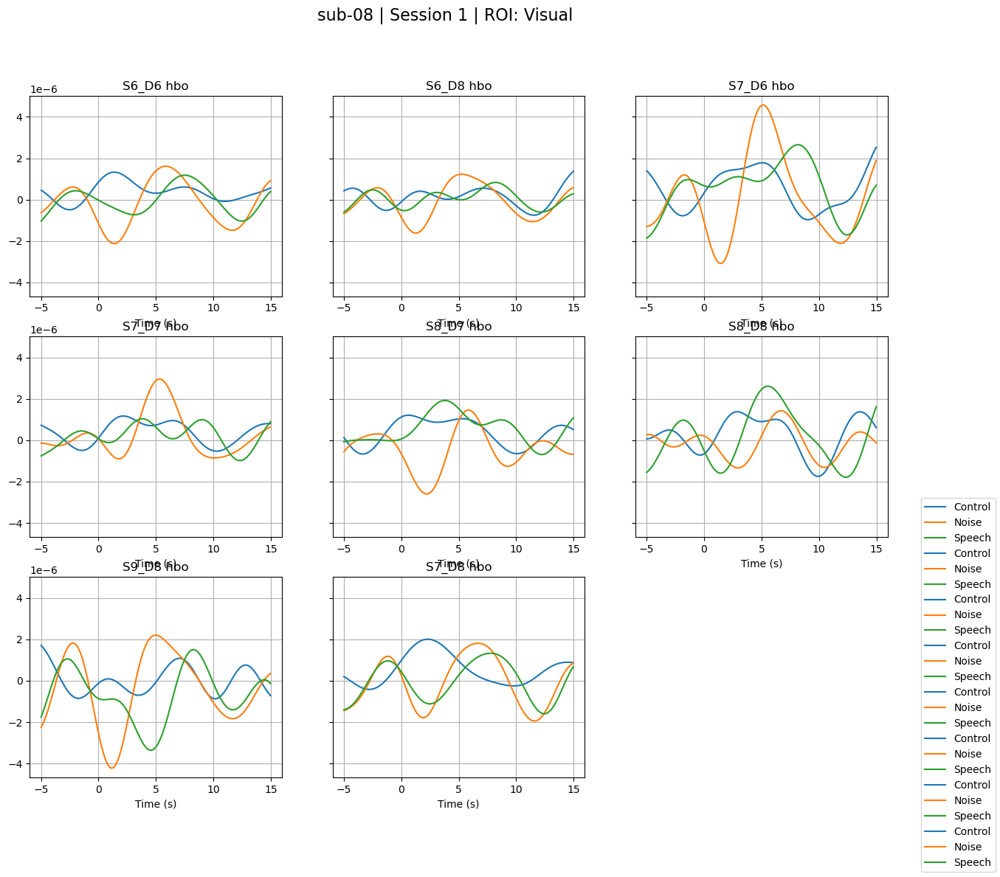

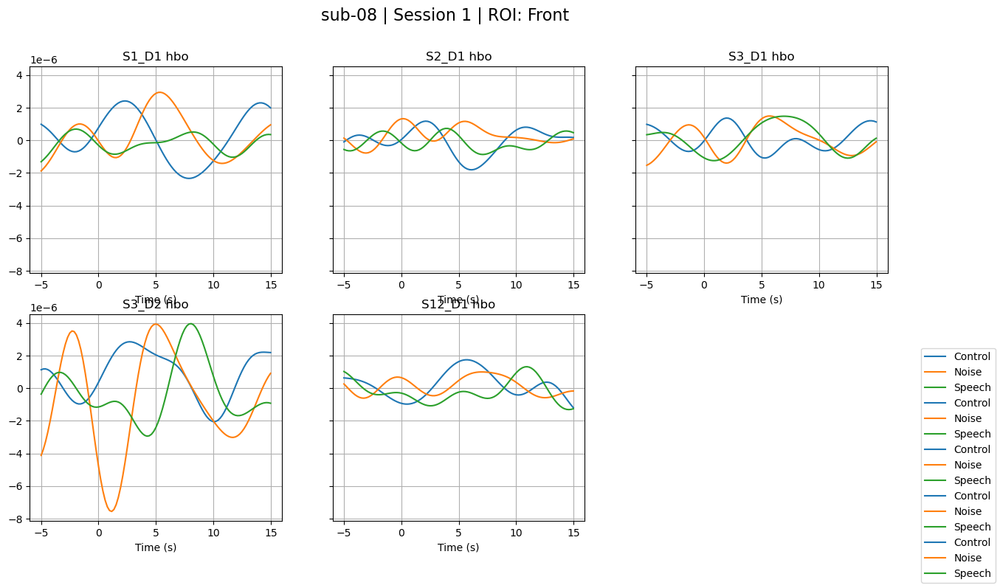

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 14 in Control - 16 bad channels, total deviation 6.37e-05
🚫 Rejecting Epoch 4 in Control - 15 bad channels, total deviation 8.85e-05
🚫 Rejecting Epoch 18 in Control - 13 bad channels, total deviation 7.11e-05
🚫 Rejecting Epoch 10 in Control - 12 bad channels, total deviation 4.98e-05
🚫 Rejecting Epoch 0 in Control - 12 bad channels, total deviation 3.47e-05
🚫 Rejecting Epoch 2 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 11 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 13 in Noise - 25 bad channels, total dev

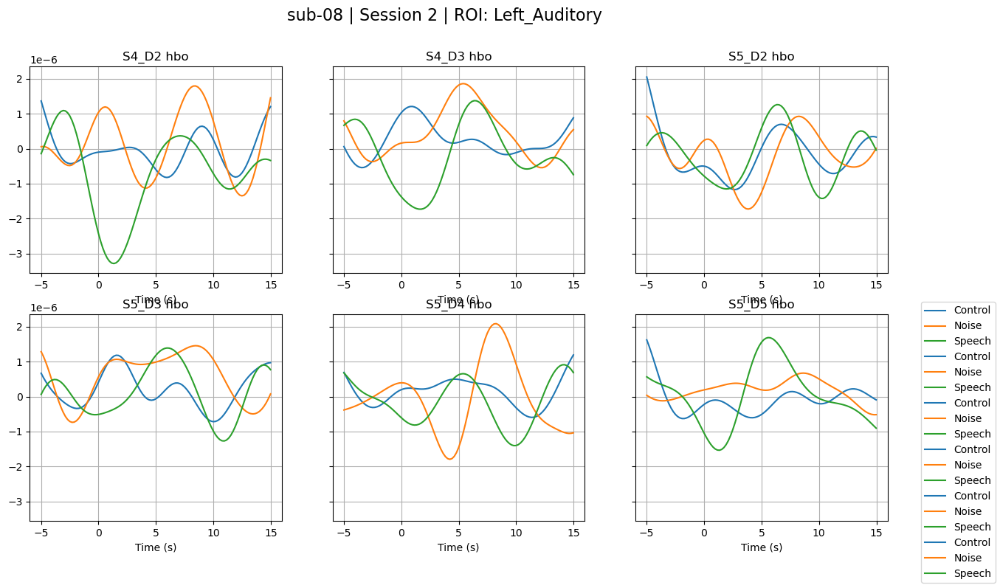

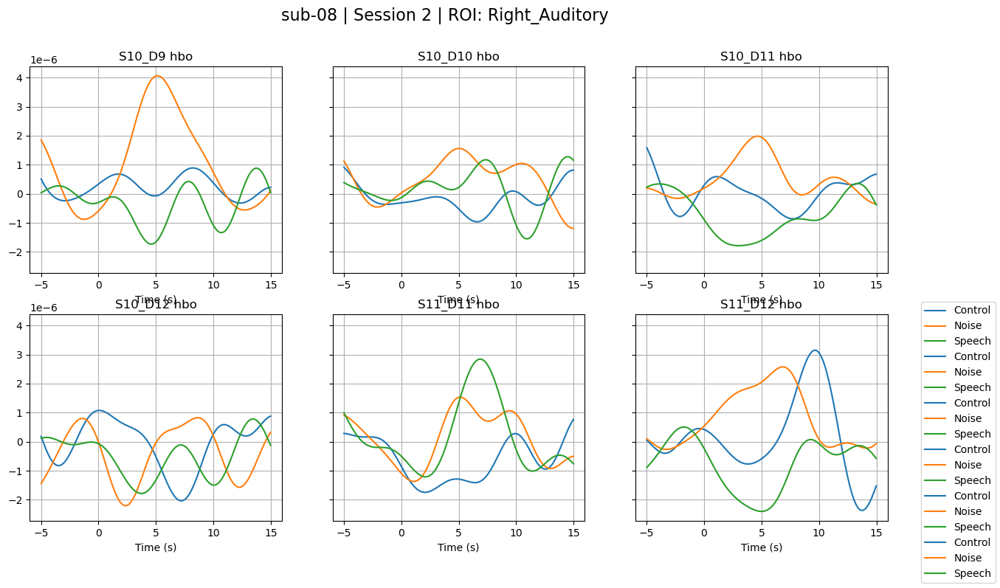

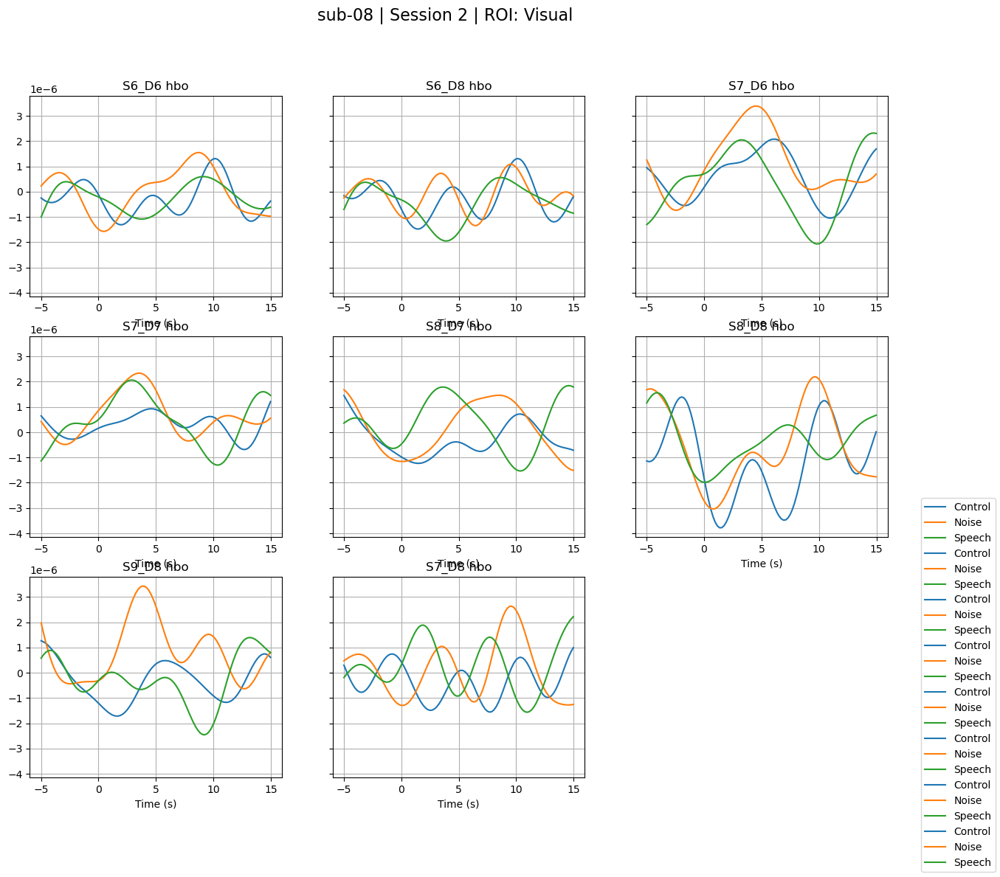

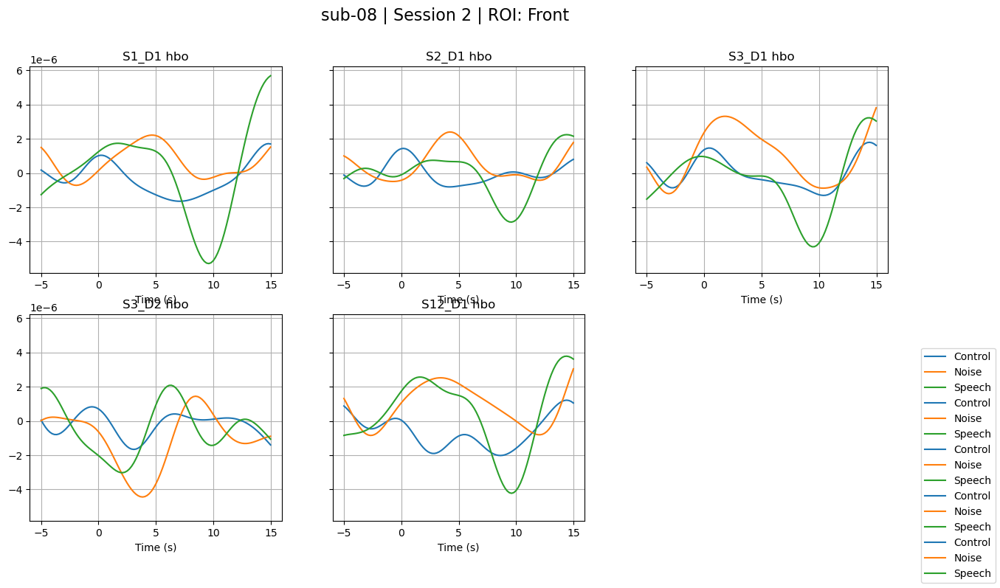

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 10, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 6 in Control - 24 bad channels, total deviation 2.70e-04
🚫 Rejecting Epoch 1 in Control - 23 bad channels, total deviation 1.62e-04
🚫 Rejecting Epoch 9 in Control - 22 bad channels, total deviation 2.46e-04
🚫 Rejecting Epoch 5 in Control - 22 bad channels, total deviation 2.27e-04
🚫 Rejecting Epoch 2 in Control - 22 bad channels, total deviation 2.06e-04
🚫 Rejecting Epoch 7 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 12 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 4 in Noise - 24 bad c

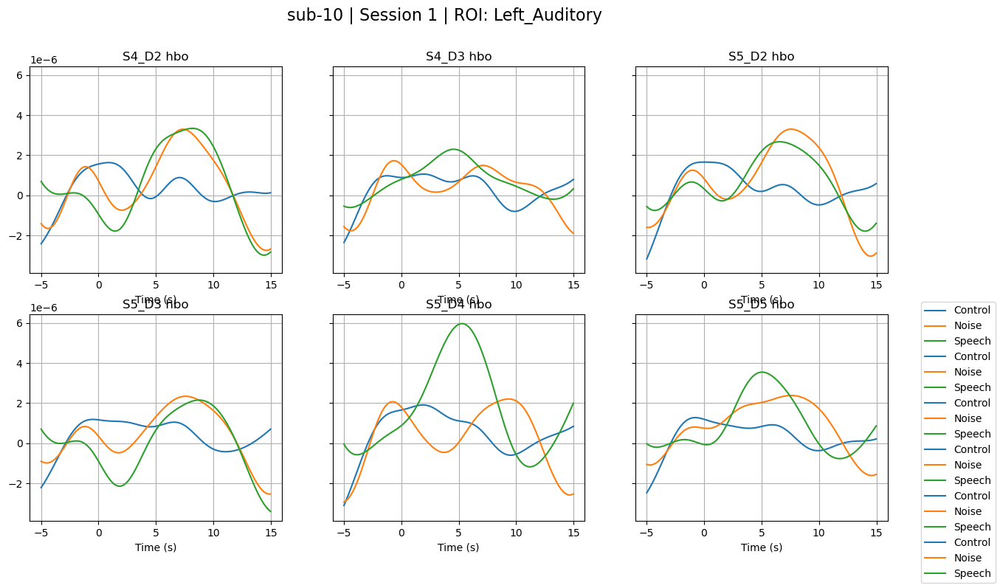

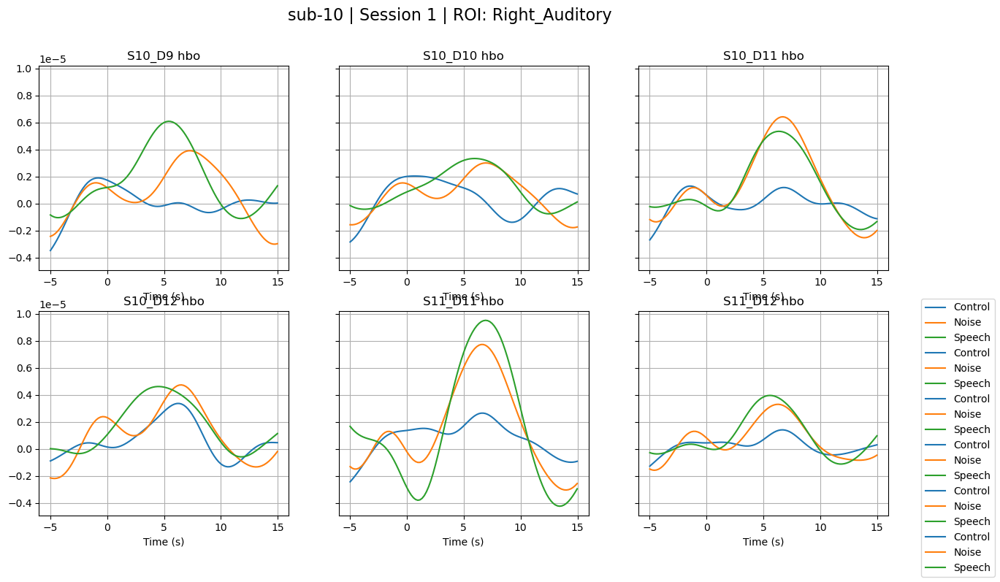

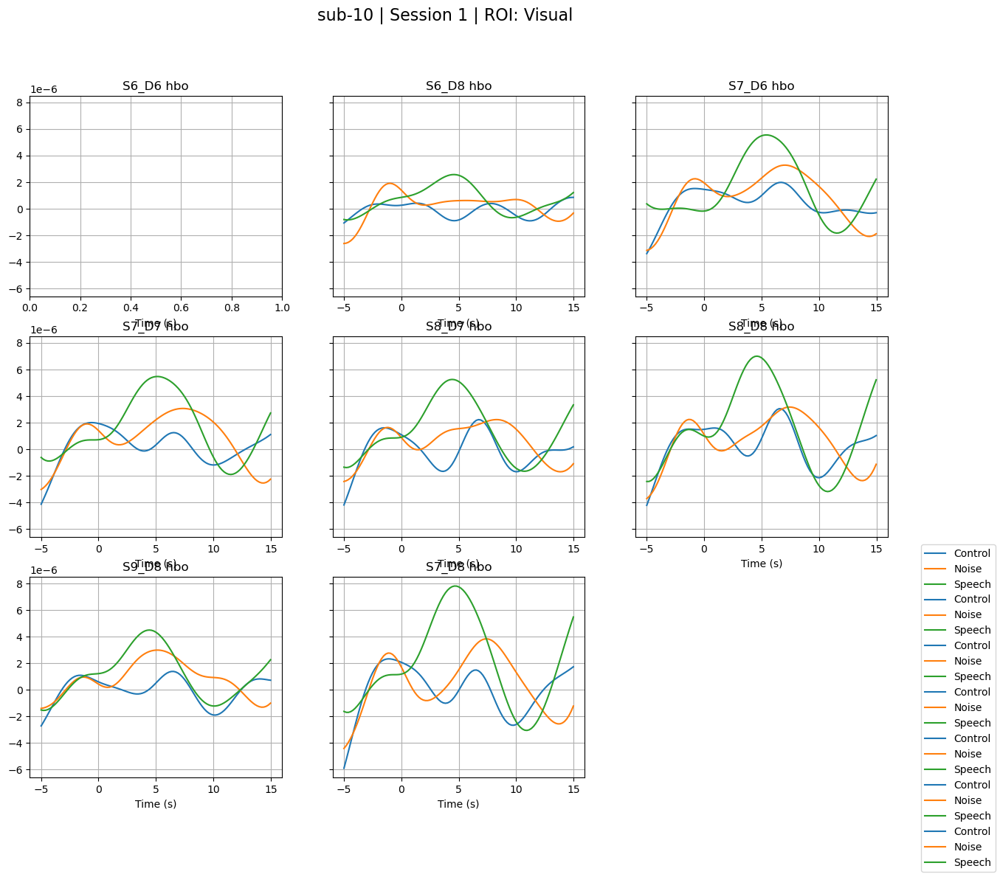

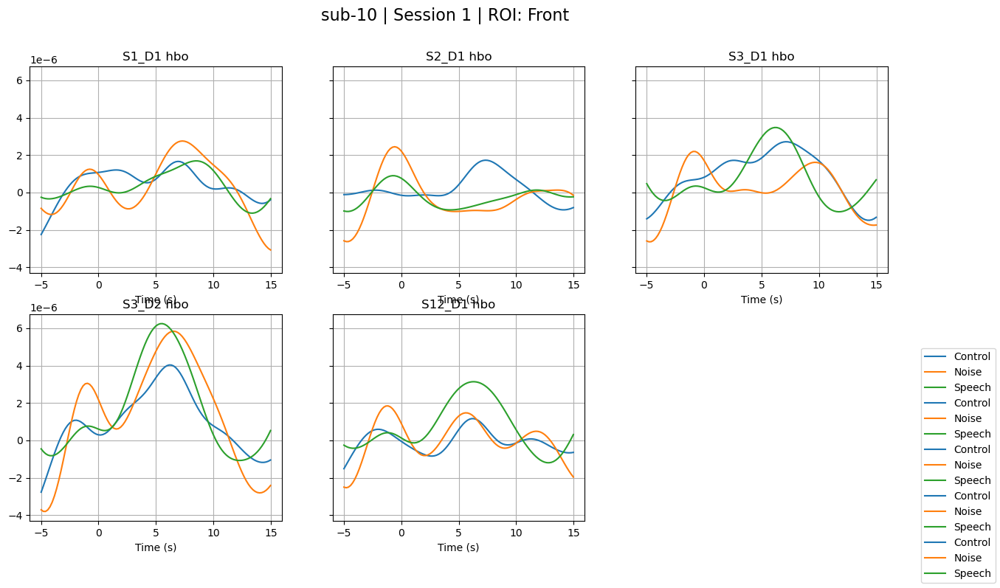

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 10, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 11 in Control - 24 bad channels, total deviation 3.66e-04
🚫 Rejecting Epoch 17 in Control - 23 bad channels, total deviation 4.19e-04
🚫 Rejecting Epoch 15 in Control - 23 bad channels, total deviation 2.59e-04
🚫 Rejecting Epoch 10 in Control - 22 bad channels, total deviation 3.20e-04
🚫 Rejecting Epoch 7 in Control - 22 bad channels, total deviation 2.33e-04
🚫 Rejecting Epoch 18 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 19 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Re

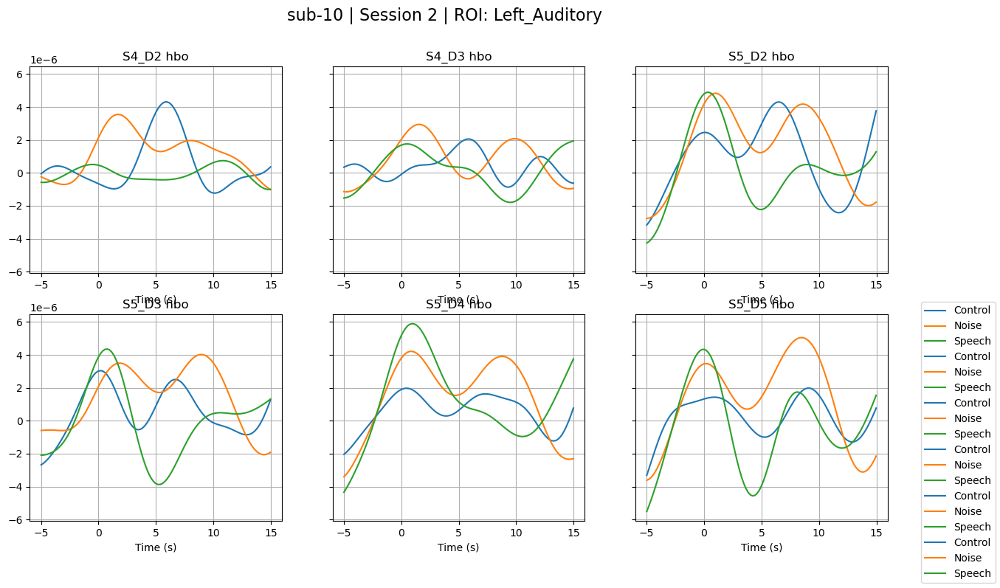

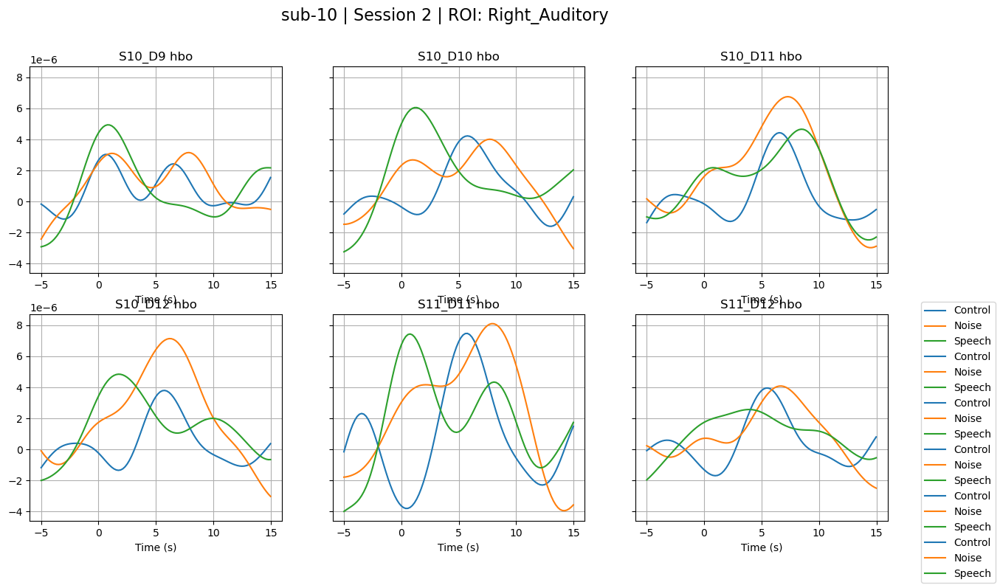

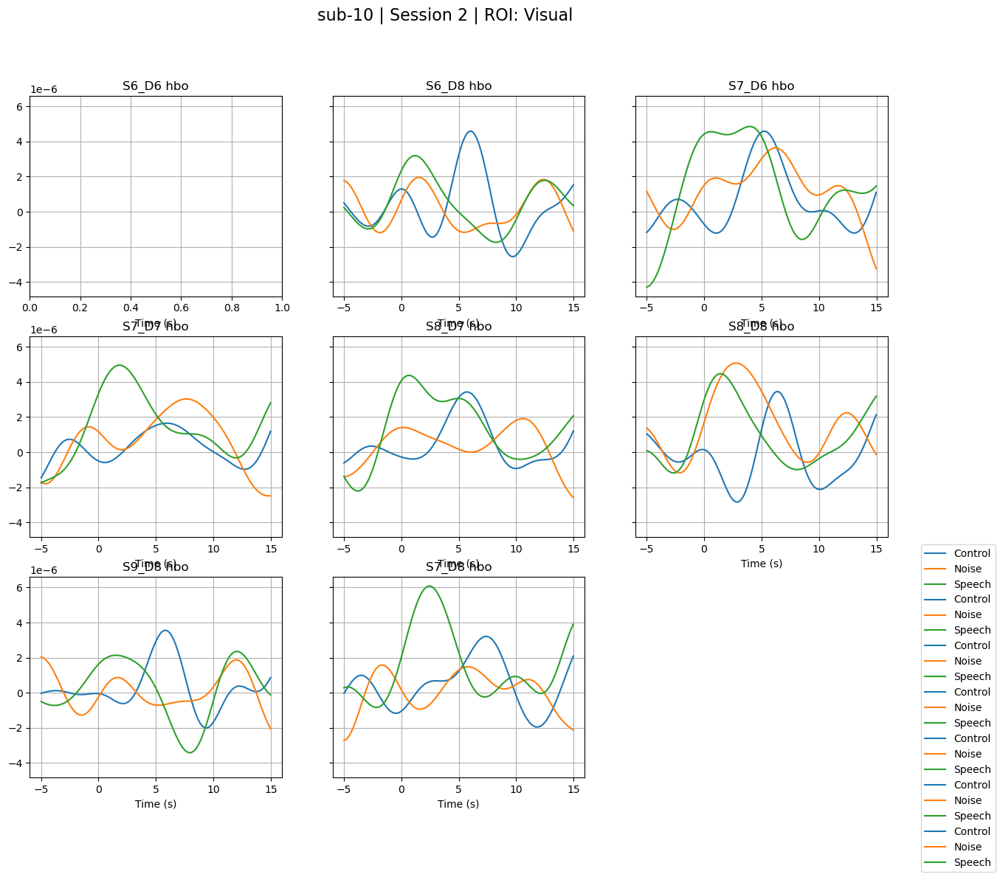

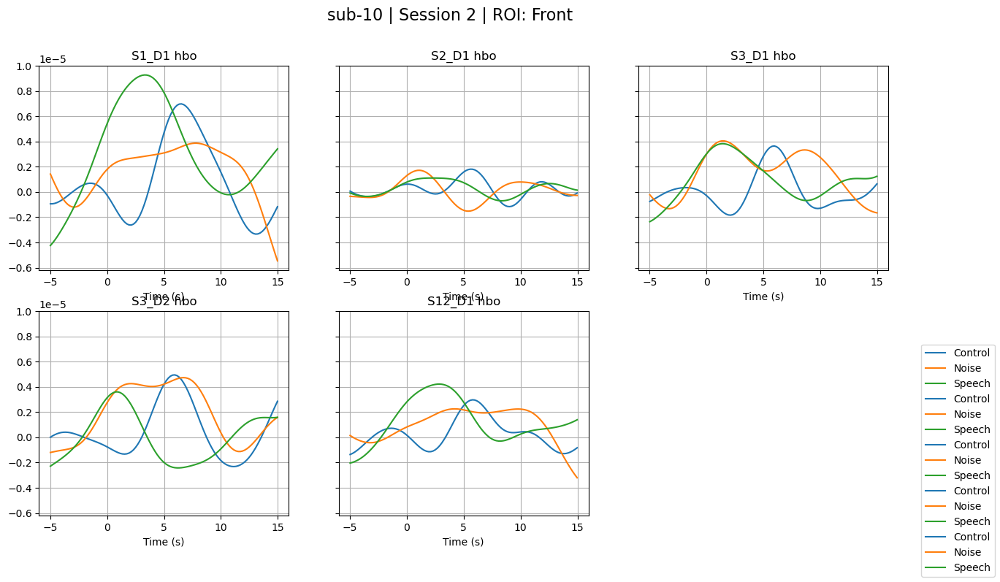

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 11, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 10 in Control - 17 bad channels, total deviation 3.64e-04
🚫 Rejecting Epoch 2 in Control - 17 bad channels, total deviation 2.23e-04
🚫 Rejecting Epoch 0 in Control - 17 bad channels, total deviation 1.37e-04
🚫 Rejecting Epoch 13 in Control - 16 bad channels, total deviation 1.88e-04
🚫 Rejecting Epoch 6 in Control - 16 bad channels, total deviation 1.85e-04
🚫 Rejecting Epoch 12 in Noise - 20 bad channels

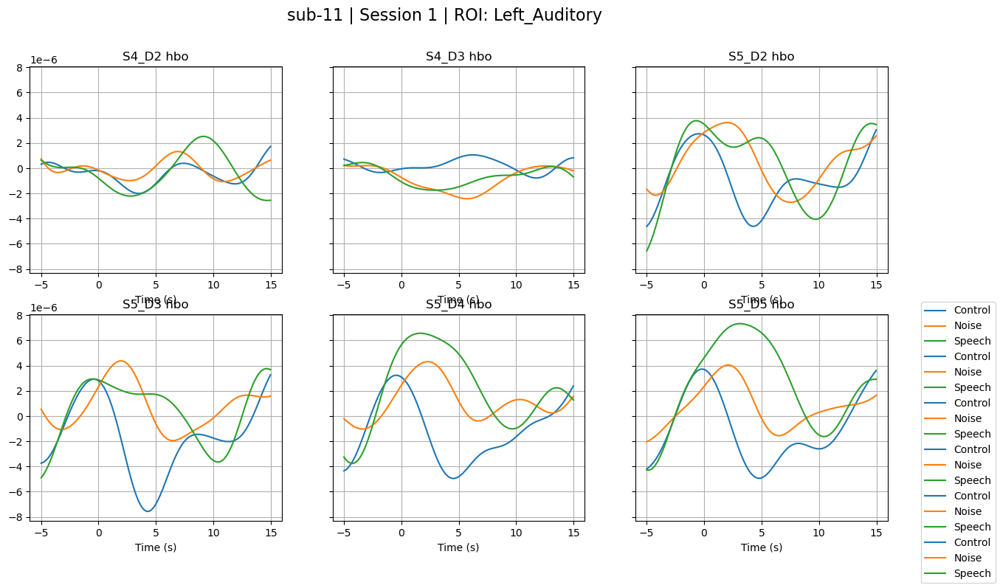

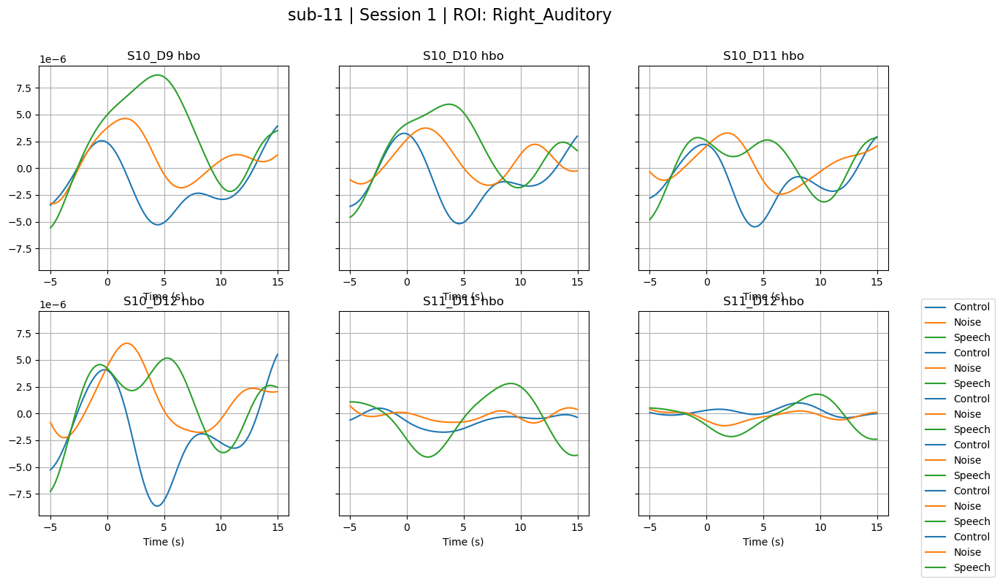

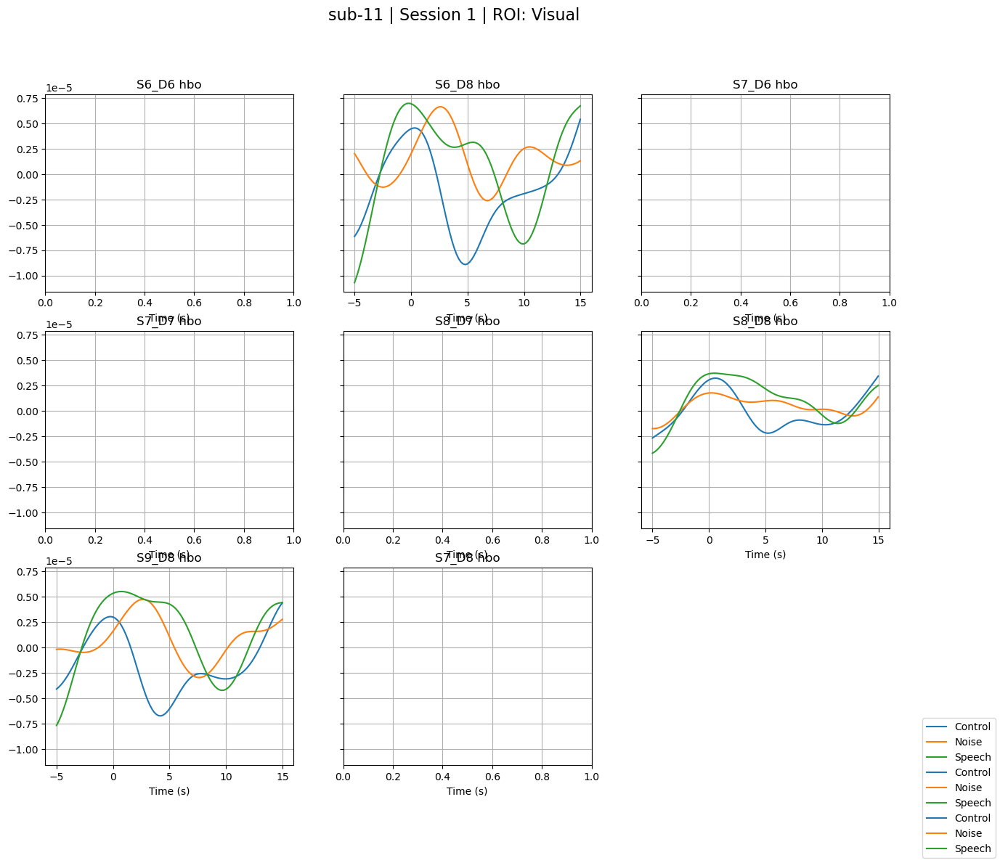

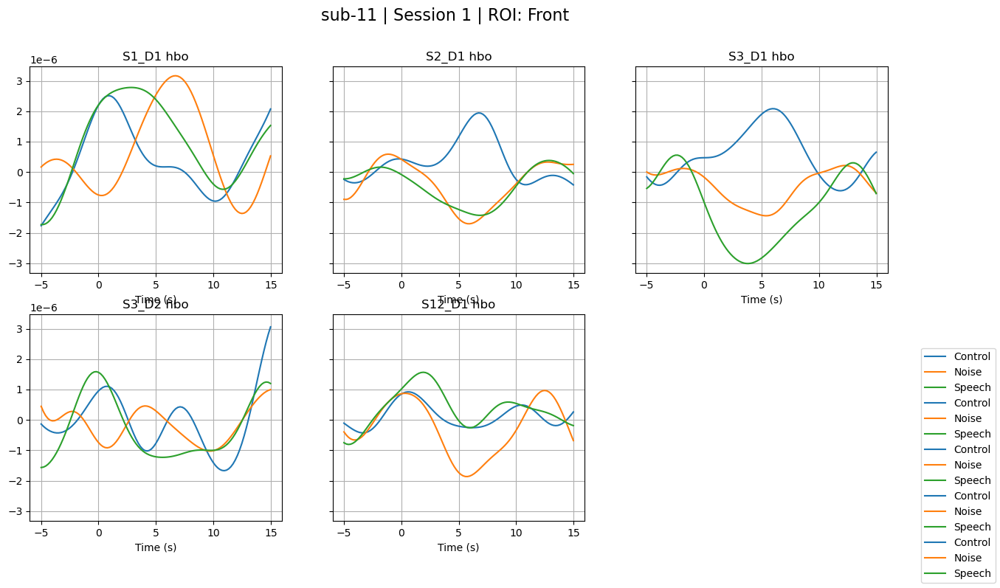

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 8
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 11, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 2 in Control - 17 bad channels, total deviation 1.50e-04
🚫 Rejecting Epoch 7 in Control - 15 bad channels, total deviation 1.35e-04
🚫 Rejecting Epoch 15 in Control - 14 bad channels, total deviation 2.03e-04
🚫 Rejecting Epoch 14 in Control - 12 bad channels, total deviation 1.04e-04
🚫 Rejecting Epoch 1 in Control - 11 bad channels, total deviation 7.41e-05
🚫 Rejecting Epoch 17 in Noise - 21 bad channe

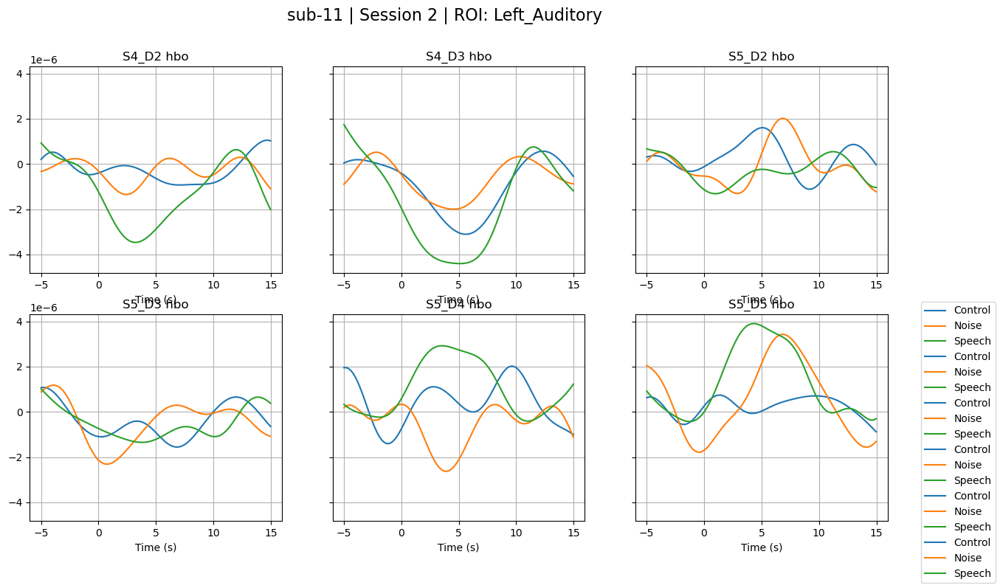

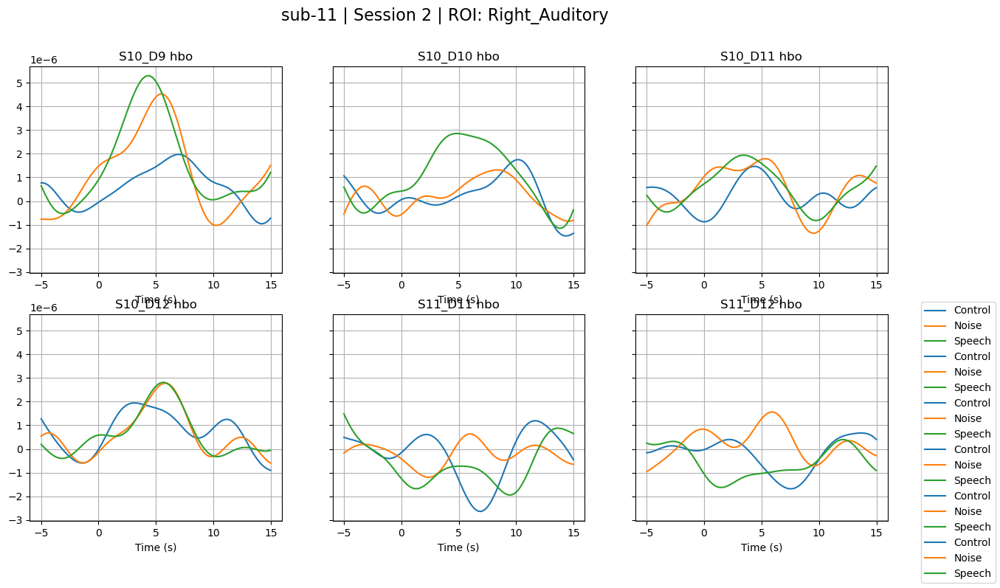

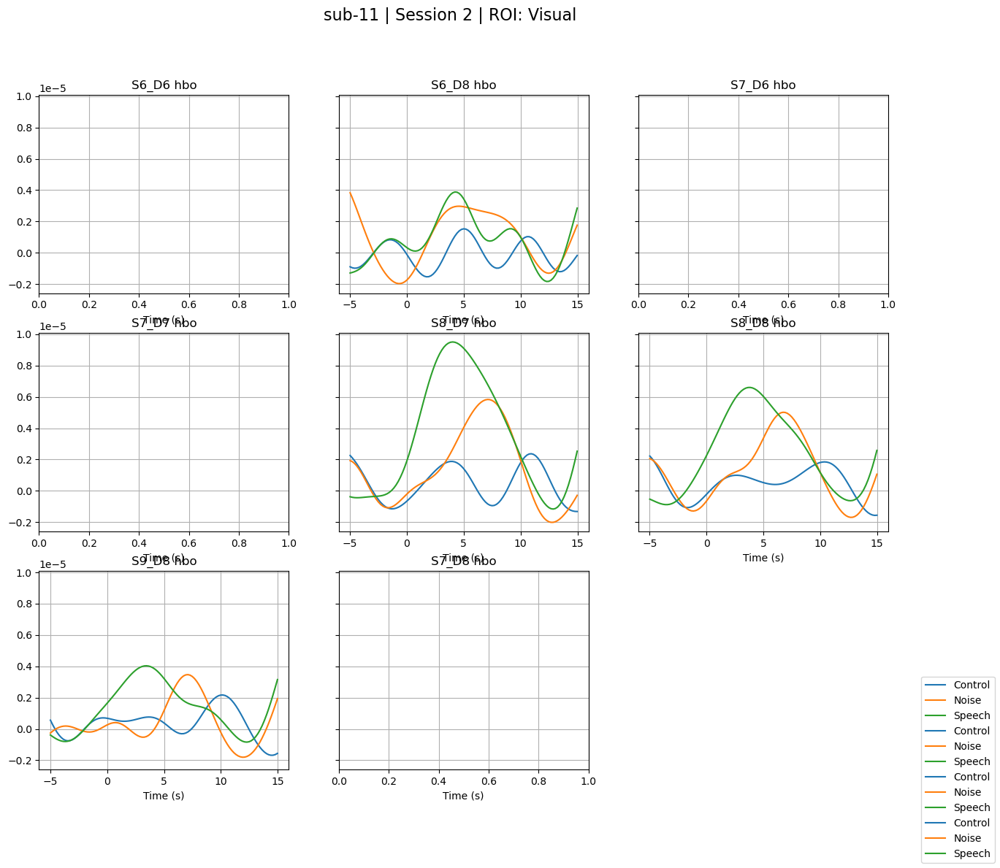

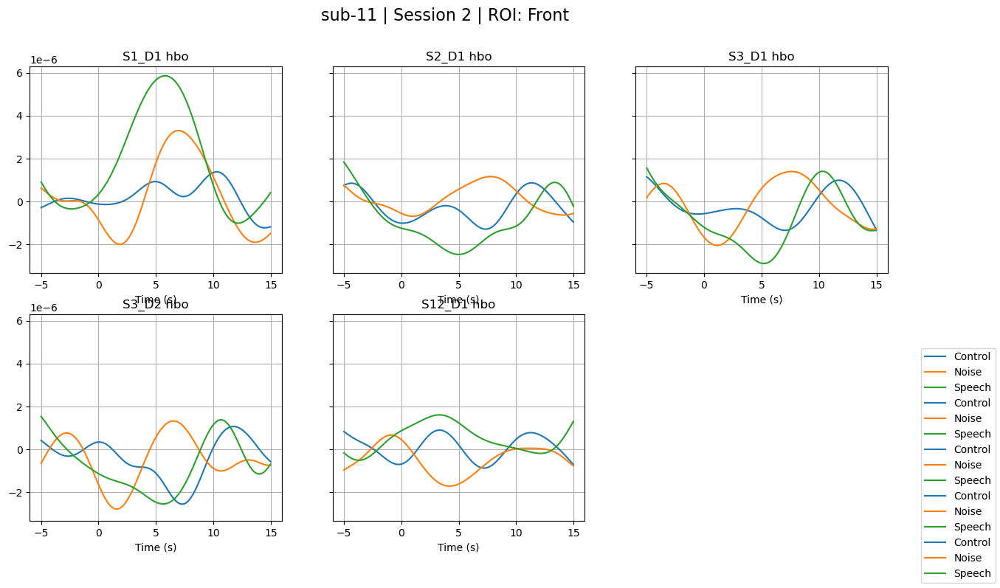

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 12, Session 01: 59 epochs loaded
🚫 Rejecting Epoch 18 in Control - 23 bad channels, total deviation 3.93e-04
🚫 Rejecting Epoch 15 in Control - 23 bad channels, total deviation 3.31e-04
🚫 Rejecting Epoch 14 in Control - 23 bad channels, total deviation 2.27e-04
🚫 Rejecting Epoch 9 in Control - 21 bad channels, total deviation 4.17e-04
🚫 Rejecting Epoch 2 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 5 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 4 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 6 in Noise - 25 

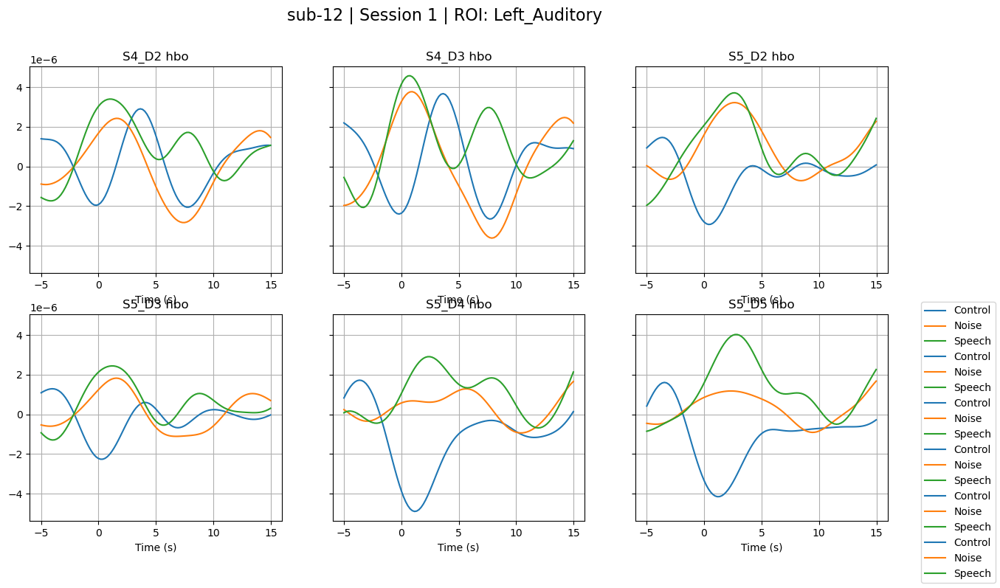

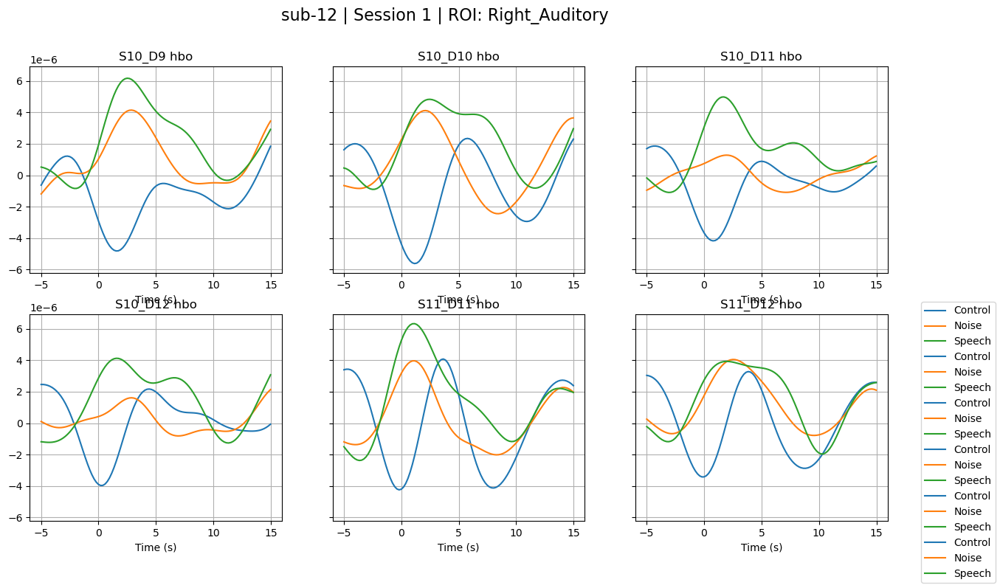

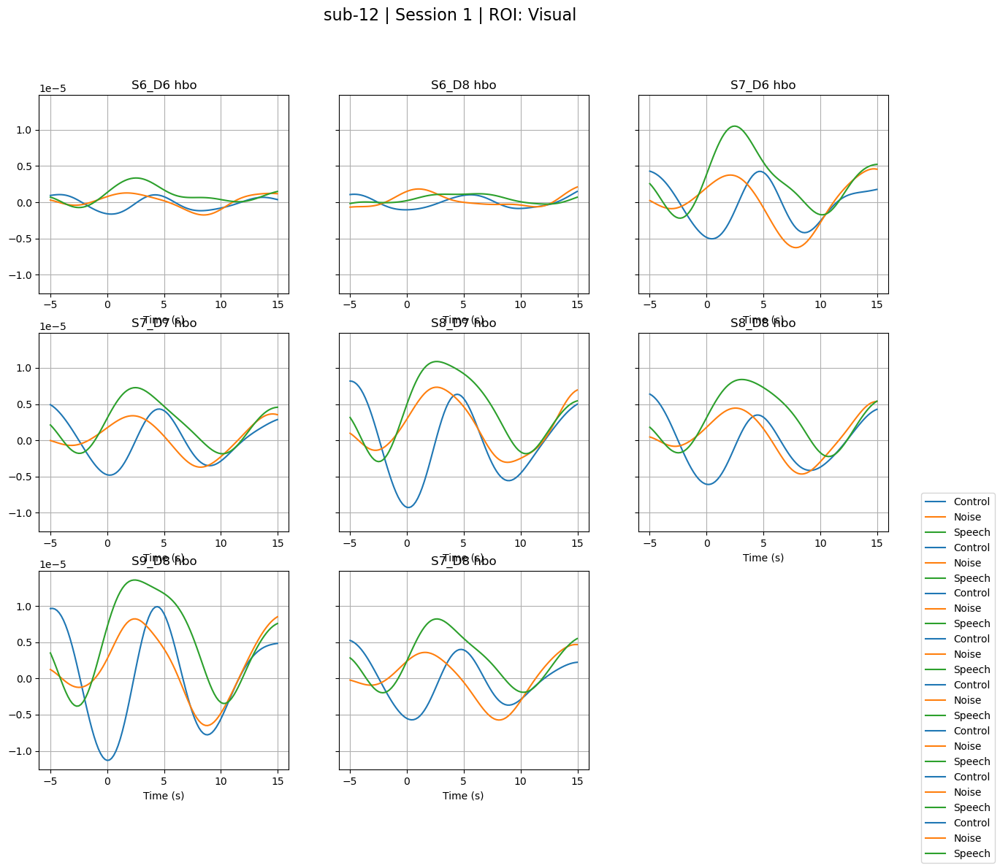

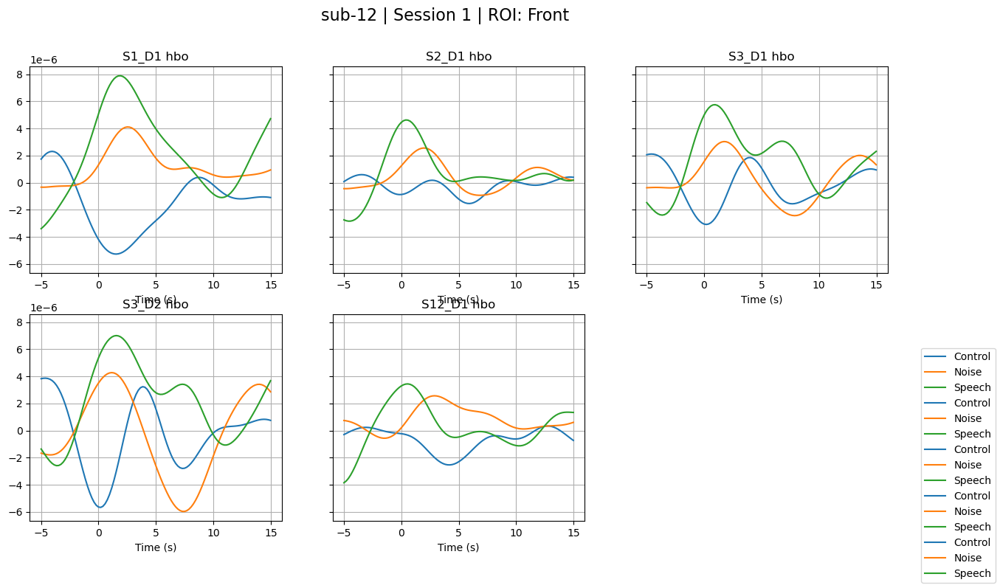

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 12, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 16 in Control - 25 bad channels, total deviation 3.67e-04
🚫 Rejecting Epoch 7 in Control - 25 bad channels, total deviation 2.50e-04
🚫 Rejecting Epoch 15 in Control - 24 bad channels, total deviation 2.66e-04
🚫 Rejecting Epoch 3 in Control - 23 bad channels, total deviation 2.81e-04
🚫 Rejecting Epoch 9 in Control - 23 bad channels, total deviation 2.04e-04
🚫 Rejecting Epoch 7 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 6 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 5 in Noise - 25

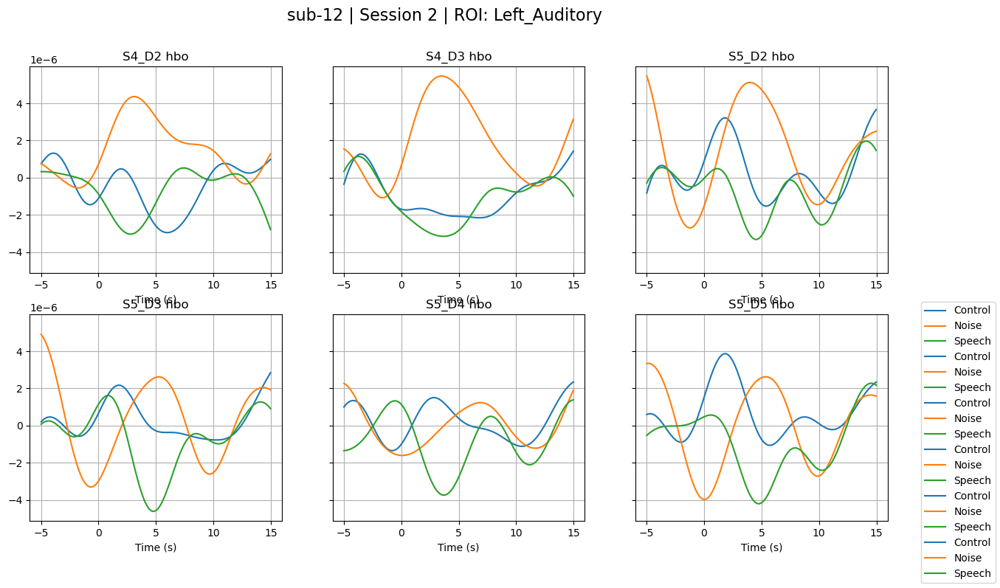

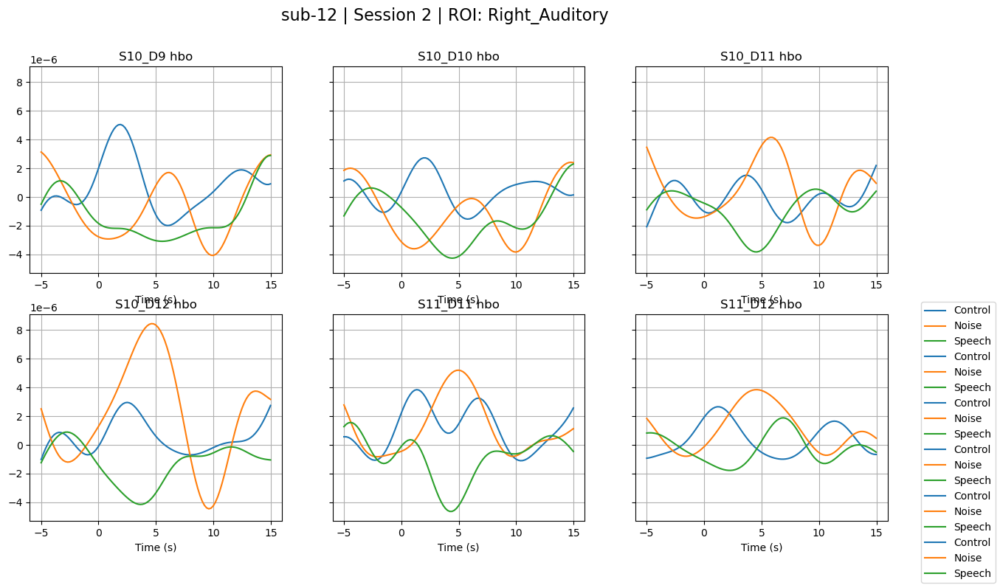

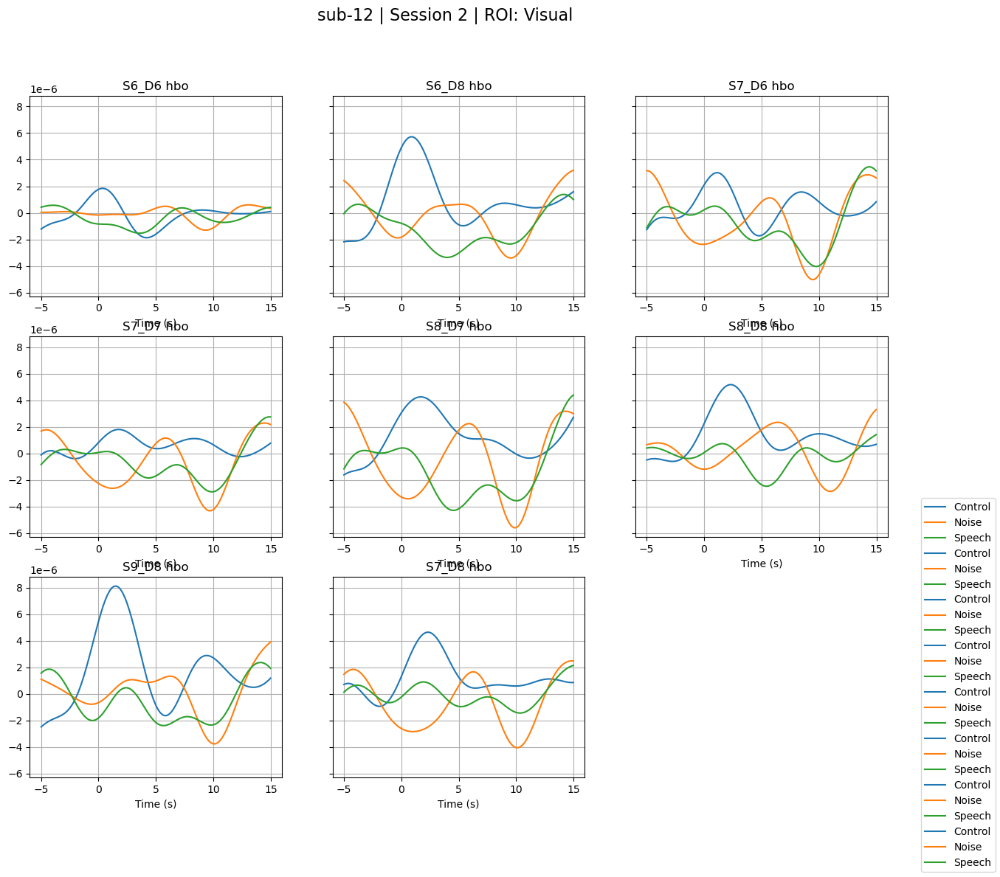

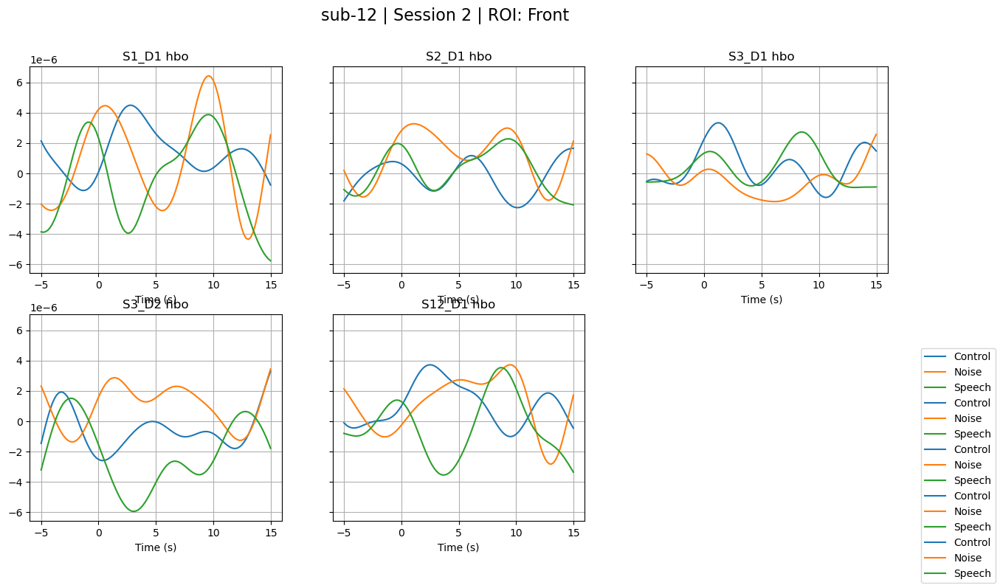

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 13, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 0 in Control - 20 bad channels, total deviation 2.33e-04
🚫 Rejecting Epoch 16 in Control - 20 bad channels, total deviation 2.03e-04
🚫 Rejecting Epoch 10 in Control - 20 bad channels, total deviation 1.60e-04
🚫 Rejecting Epoch 11 in Control - 20 bad channels, total deviation 1.23e-04
🚫 Rejecting Epoch 9 in Control - 19 bad channels, total deviation 2.52e-04
🚫 Rejecting Epoch 12 in Noise - 23 bad channels, total deviation 2.05e+02
🚫 Rejecting Epoch 11

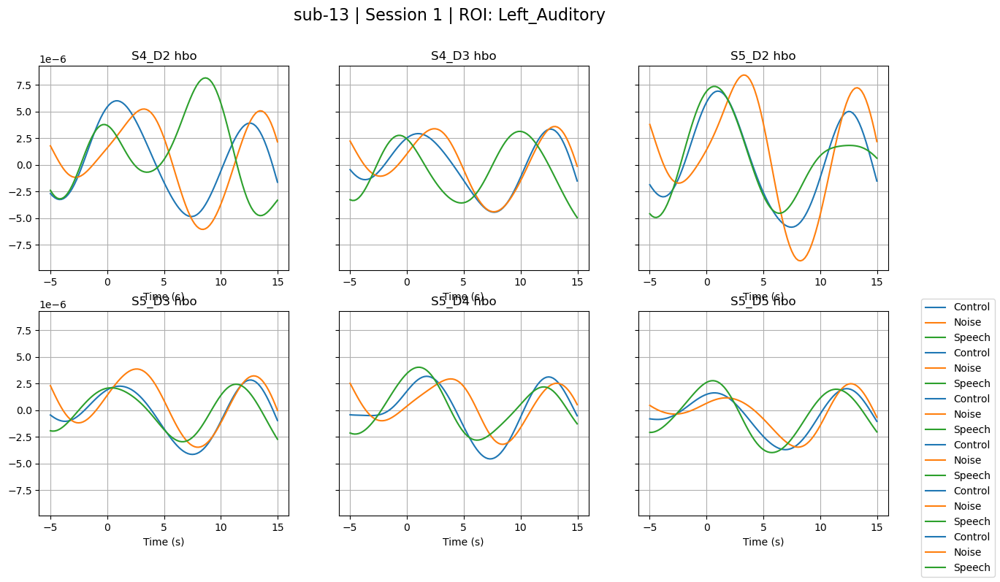

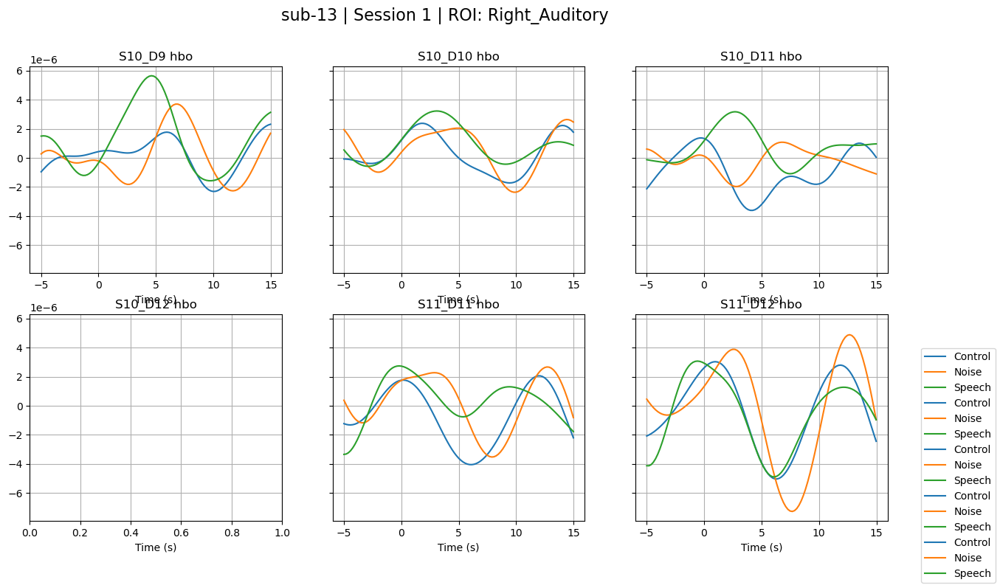

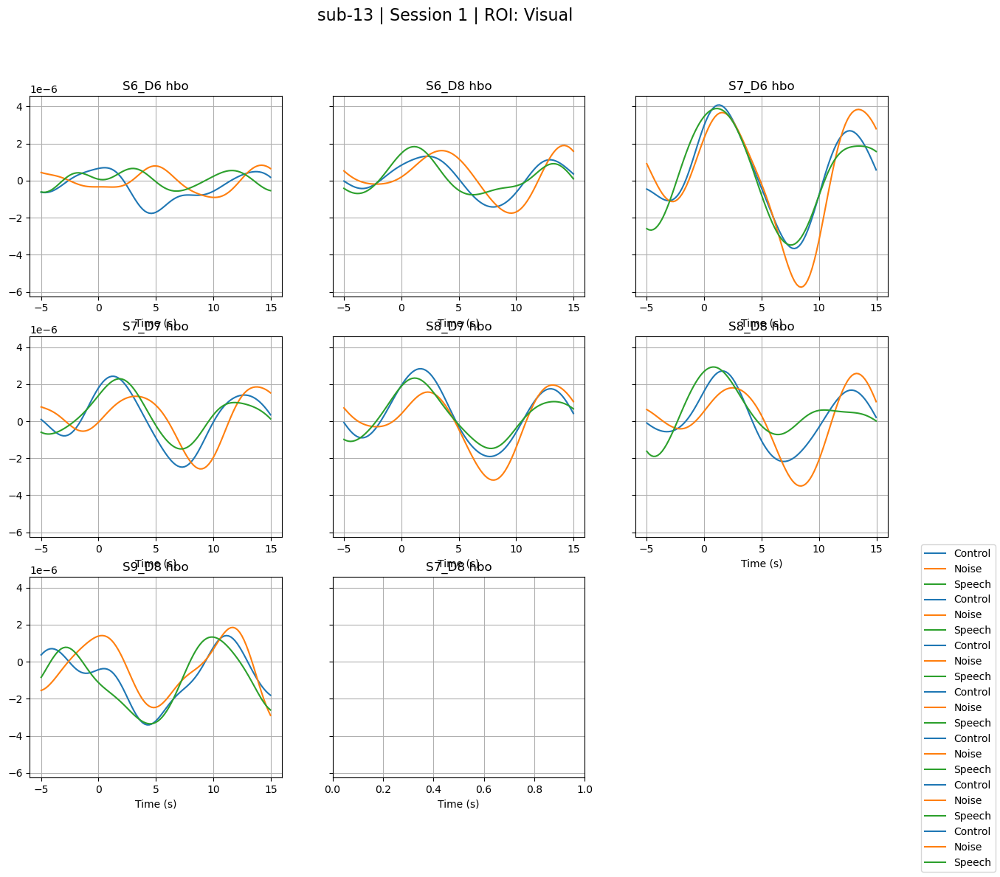

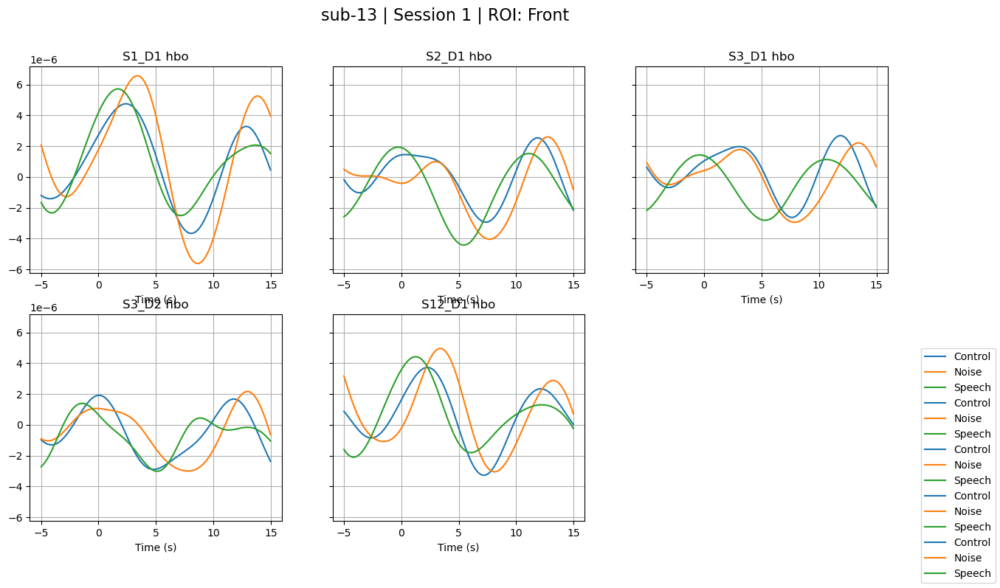

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 13, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 6 in Control - 23 bad channels, total deviation 4.10e-04
🚫 Rejecting Epoch 2 in Control - 23 bad channels, total deviation 3.72e-04
🚫 Rejecting Epoch 19 in Control - 23 bad channels, total deviation 3.43e-04
🚫 Rejecting Epoch 1 in Control - 23 bad channels, total deviation 2.58e-04
🚫 Rejecting Epoch 15 in Control - 22 bad channels, total deviation 3.68e-04
🚫 Rejecting Epoch 10 in Noise - 23 bad channels, total deviation 2.05e+02
🚫 Rejecting Epoch 13 in Noise - 23 bad channels, tot

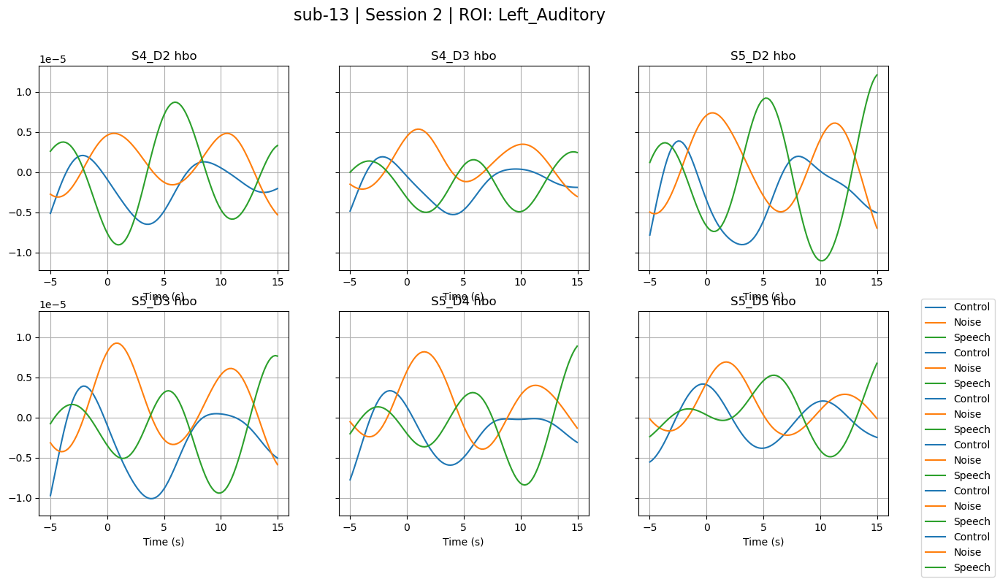

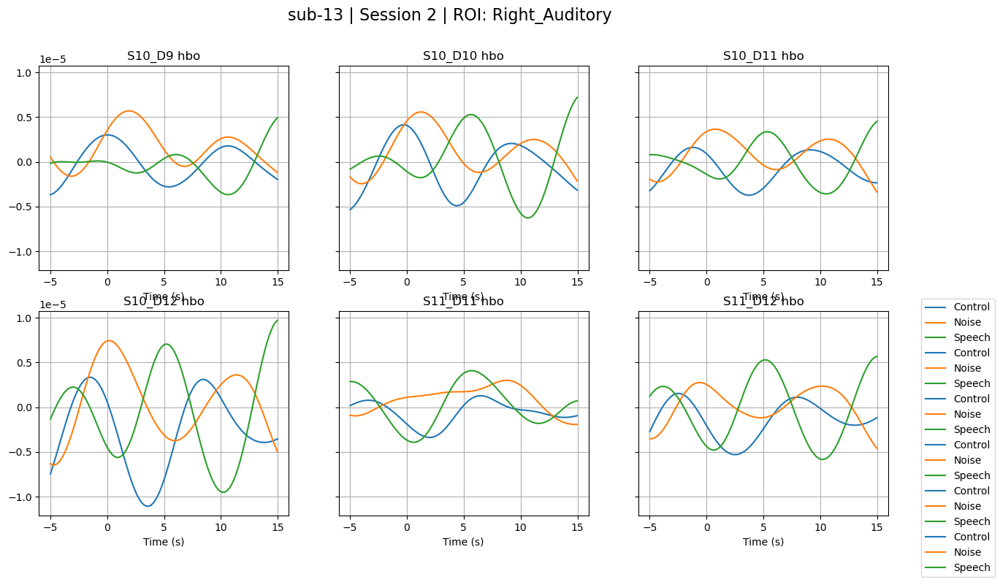

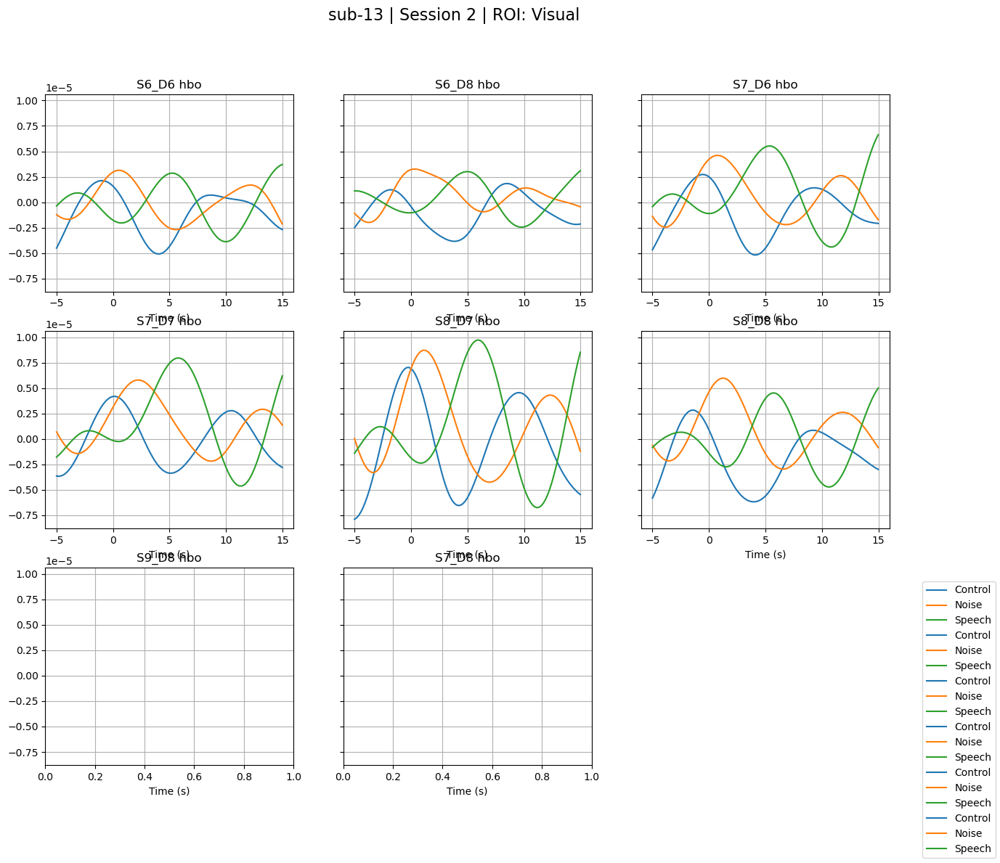

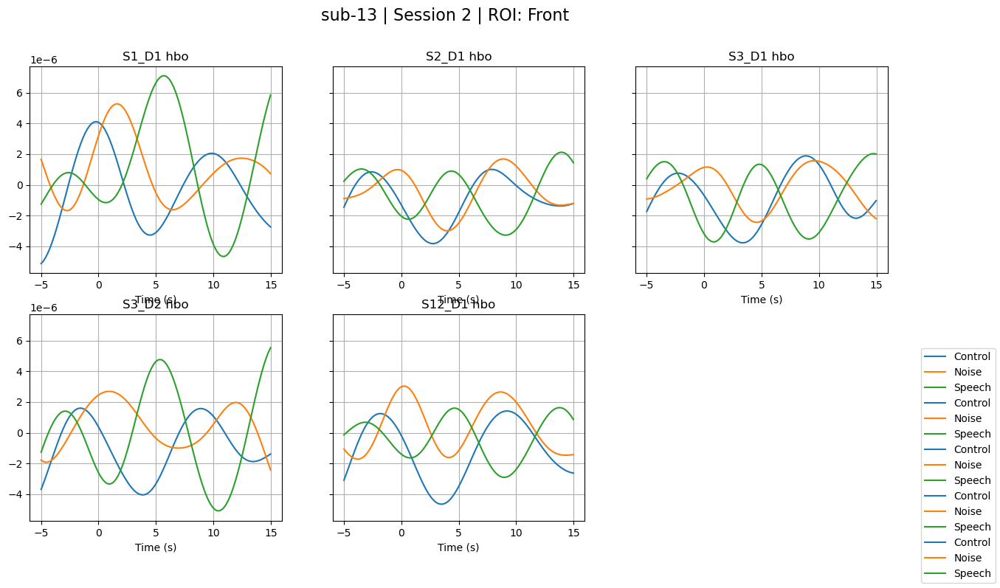

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 4
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 4
✅ Number of good short channels: 12
Subject 16, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 19 in Control - 24 bad channels, total deviation 3.01e-04
🚫 Rejecting Epoch 5 in Control - 22 bad channels, total deviation 1.52e-04
🚫 Rejecting Epoch 10 in Control - 21 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 1 in Control - 21 bad channels, total deviation 1.84e-04
🚫 Rejecting Epoch 6 in Control - 20 bad channels, total deviation 2.19e-04
🚫 Rejecting Epoch 19 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 17 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epoch 9 in Noise - 25 bad channels, total deviation 2.23e+02
🚫 Rejecting Epo

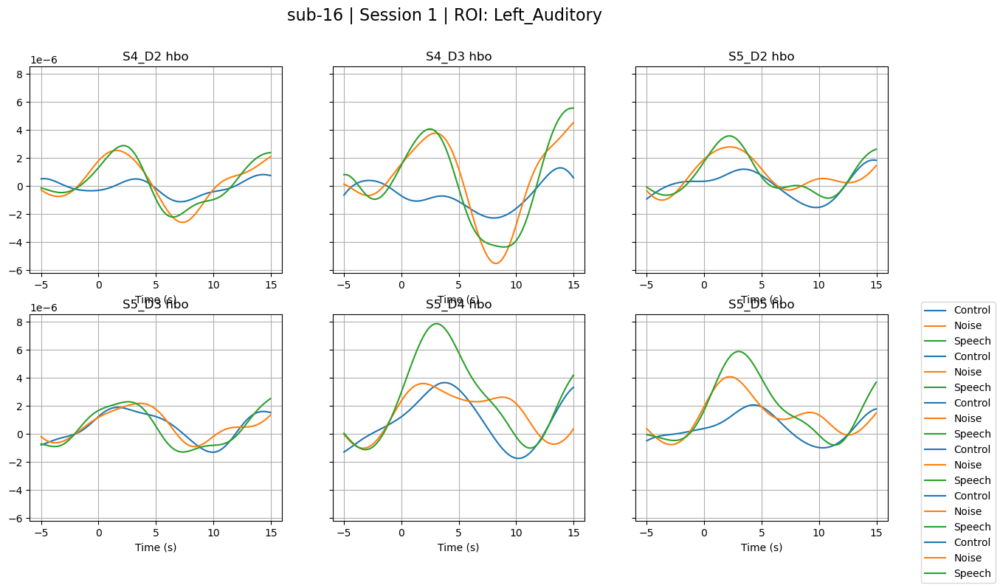

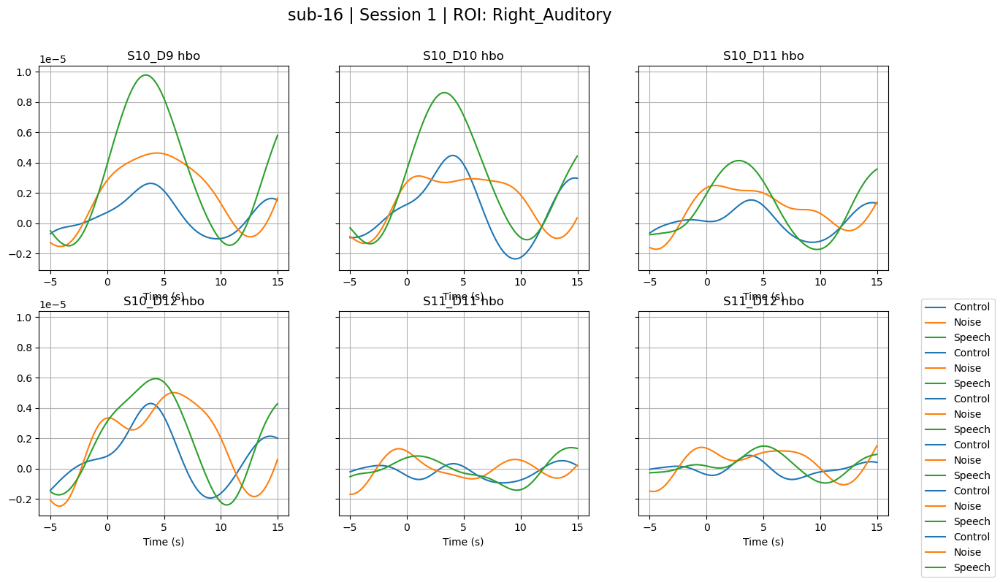

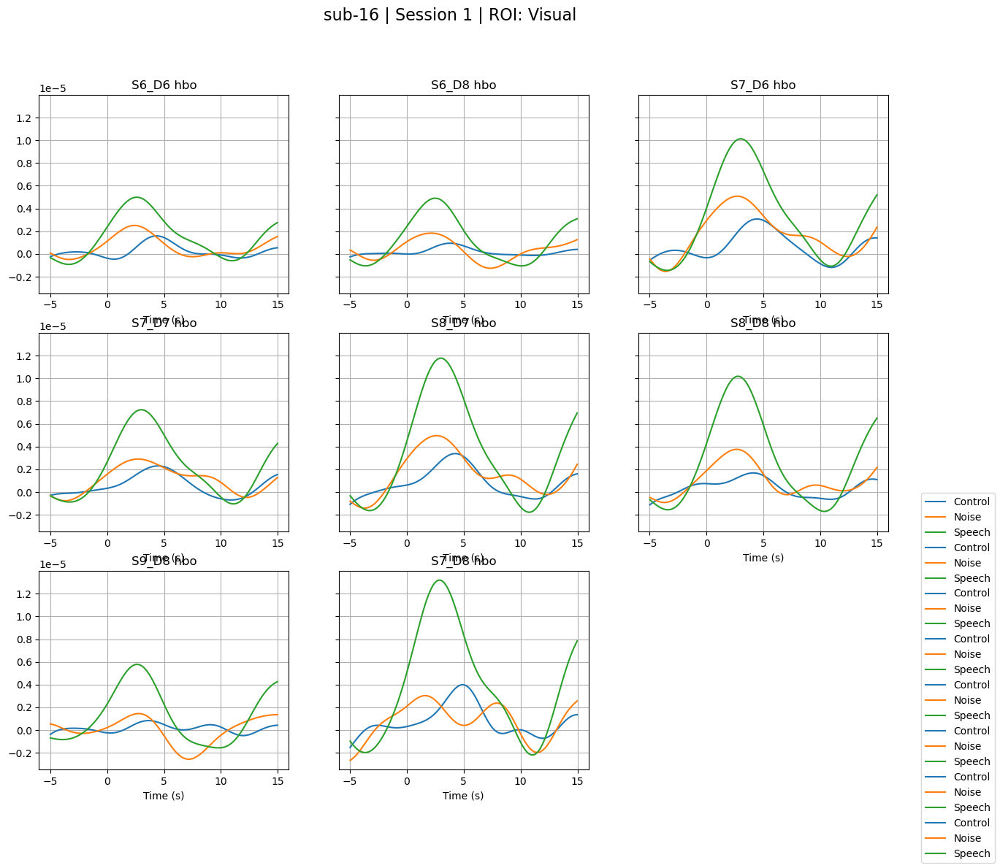

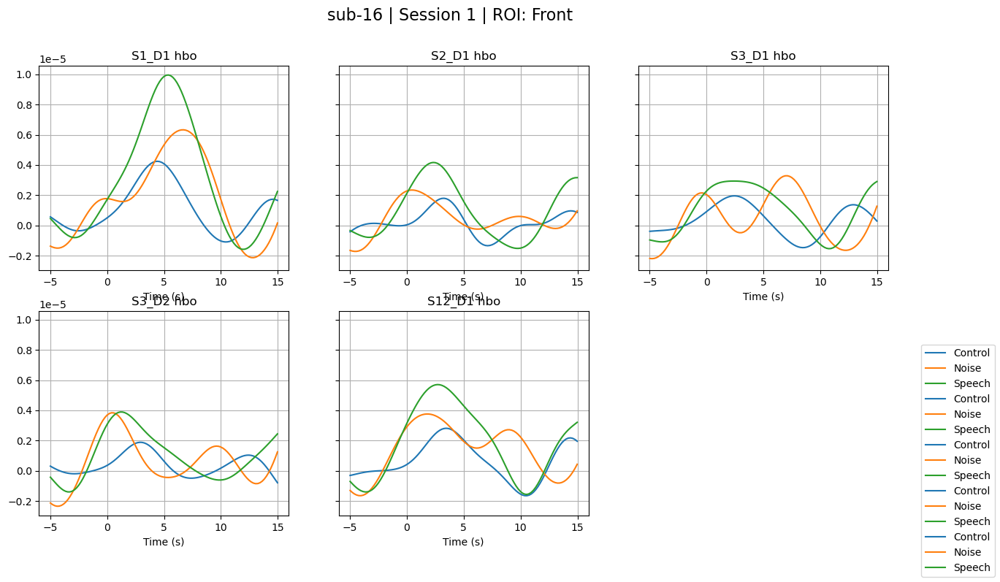

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 16, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 19 in Control - 16 bad channels, total deviation 6.45e-05
🚫 Rejecting Epoch 15 in Control - 14 bad channels, total deviation 4.25e-05
🚫 Rejecting Epoch 14 in Control - 12 bad channels, total deviation 7.41e-05
🚫 Rejecting Epoch 1 in Control - 11 bad channels, total deviation 9.14e-05
🚫 Rejecting Epoch 13 in Control - 11 bad channels, total deviation 6.77e-05
🚫 Rejecting Epoch 13 in Noise - 23 bad channels, total deviation 2.05e+02
🚫 Rejecting Epoch 7 in Noise - 23 bad channels, tota

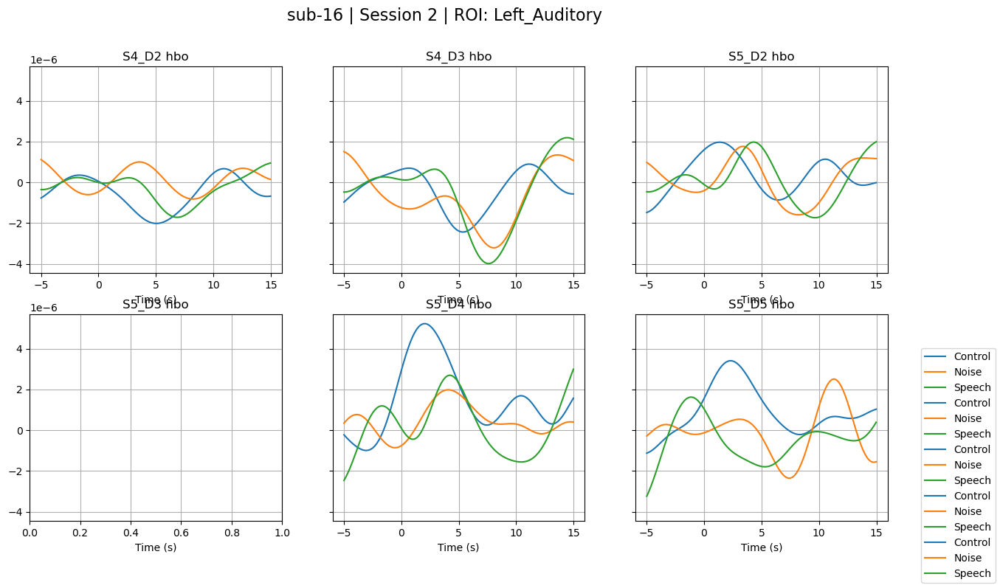

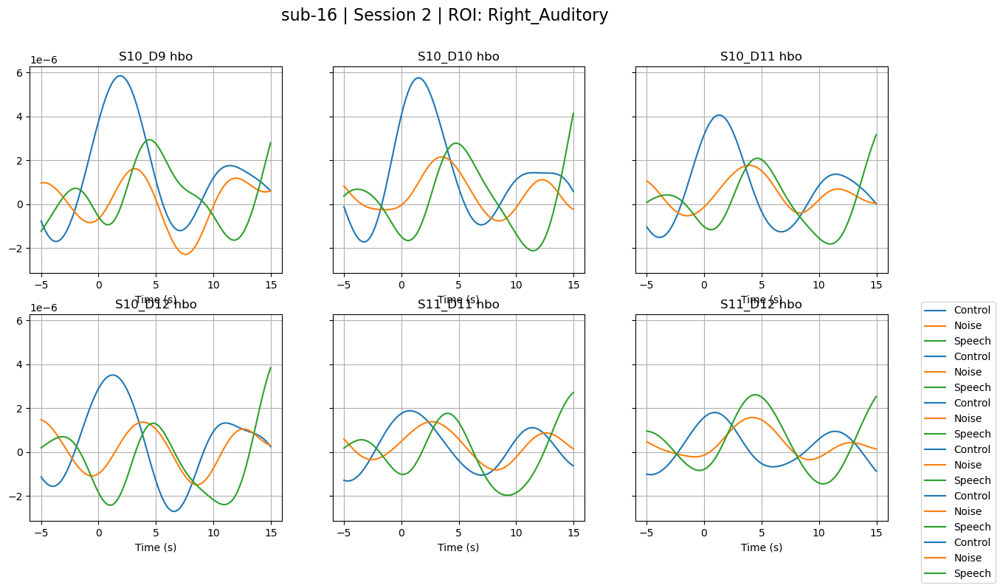

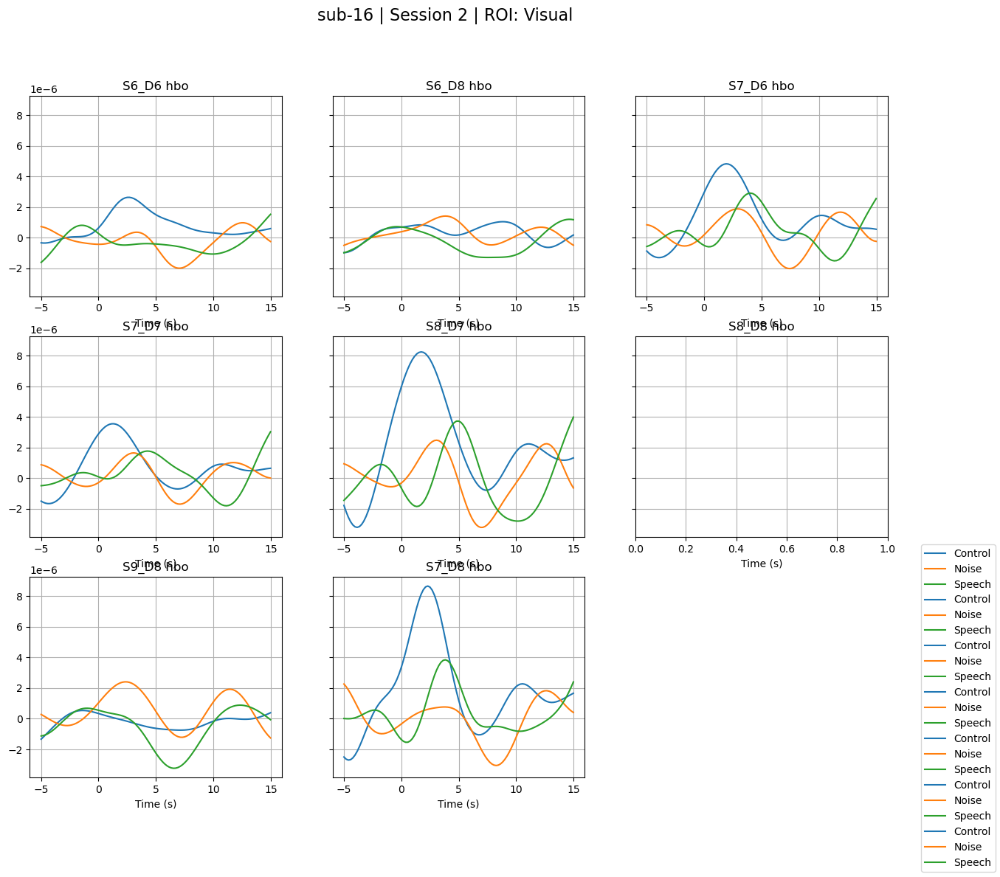

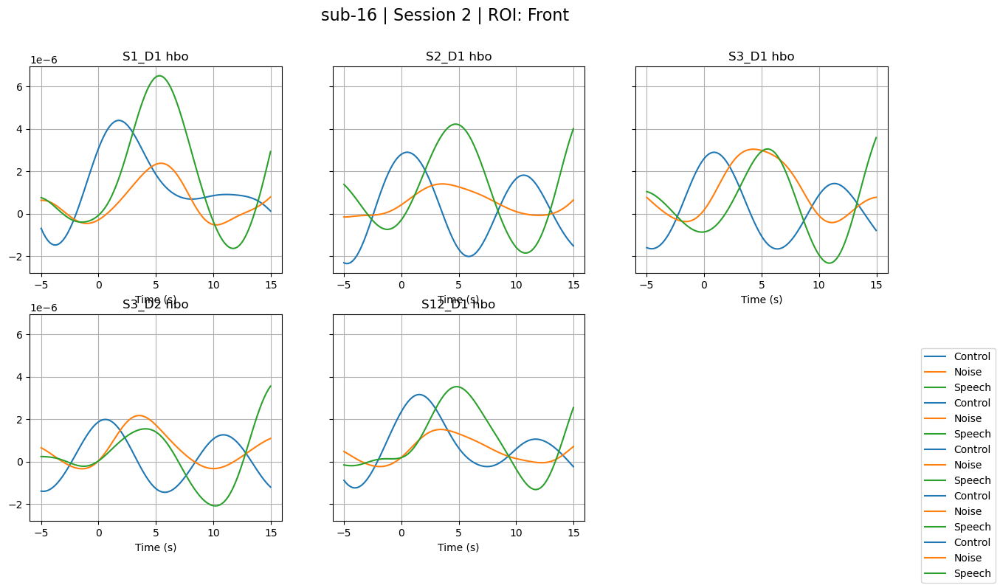

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 17, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 17 in Control - 15 bad channels, total deviation 8.68e-05
🚫 Rejecting Epoch 13 in Control - 13 bad channels, total deviation 6.01e-05
🚫 Rejecting Epoch 6 in Control - 10 bad channels, total deviation 5.51e-05
🚫 Rejecting Epoch 9 in Control - 10 bad channels, total deviation 3.79e-05
🚫 Rejecting Epoch 18 in Control - 10 bad channels, total deviation 3.41e-05
🚫 Rejecting Epoch 12 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 11 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 17 in Noise - 2

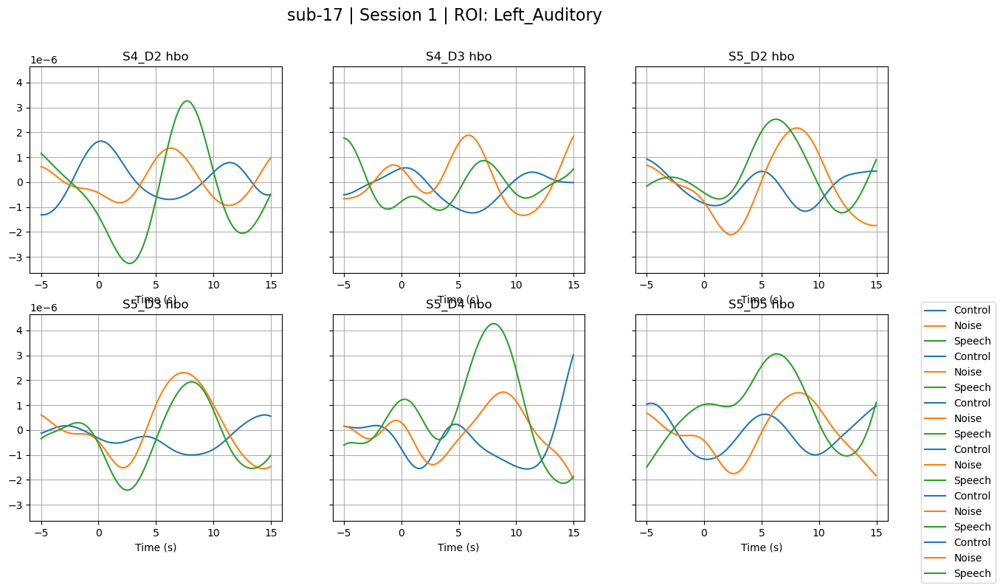

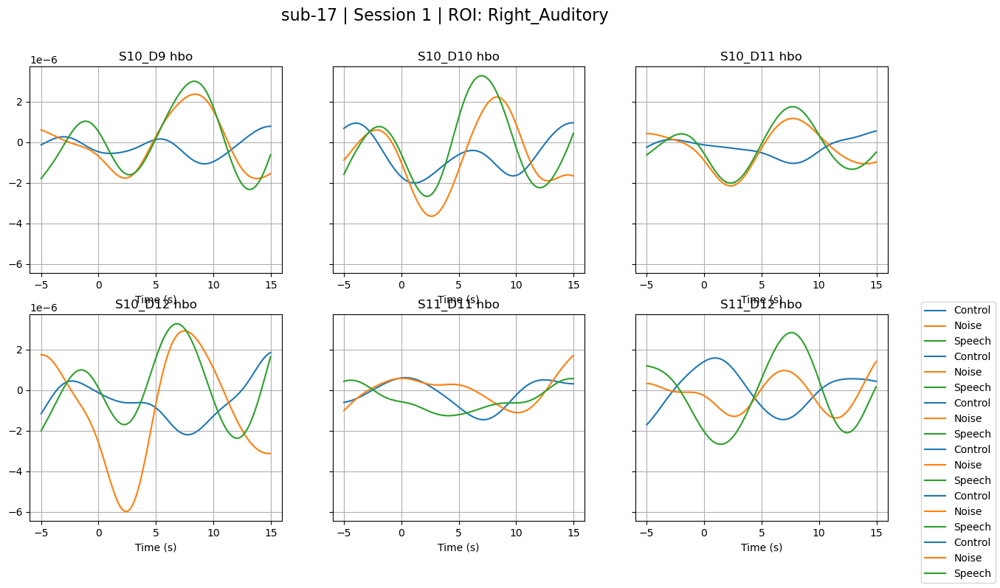

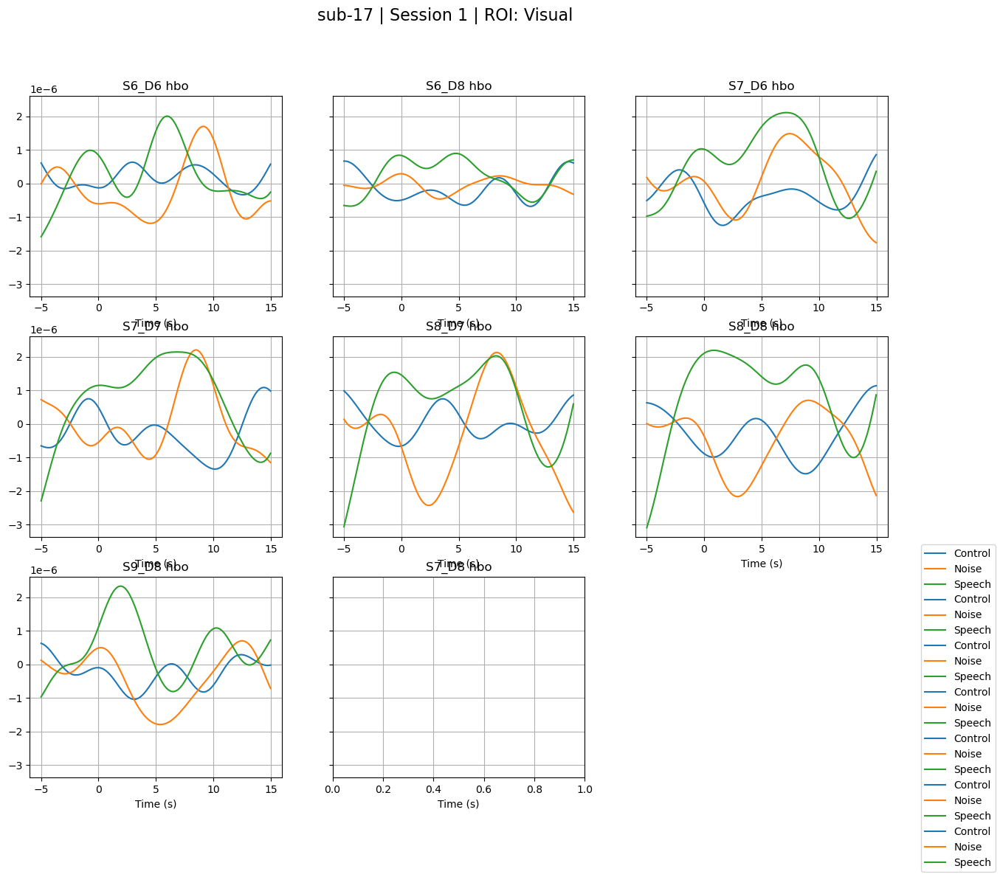

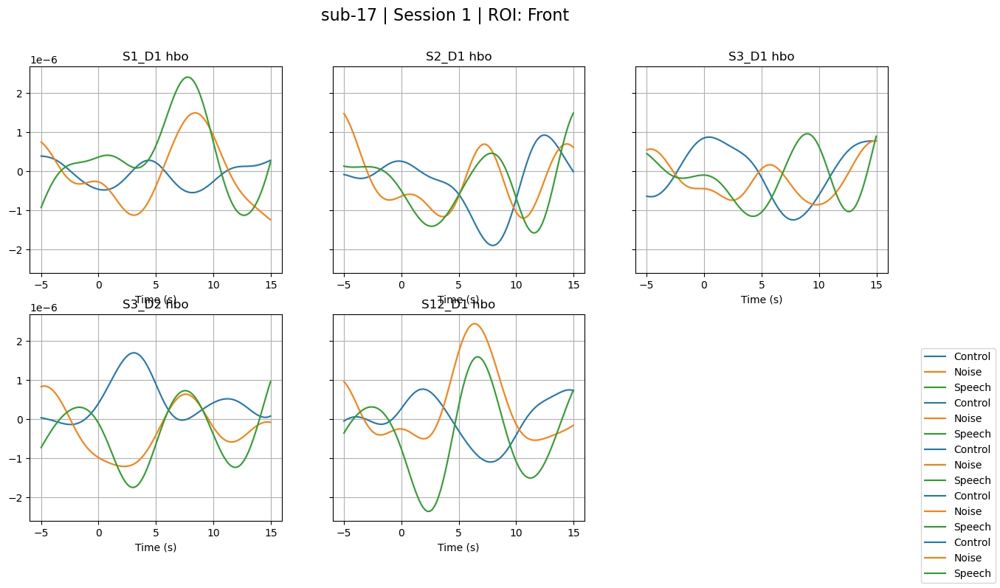

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 6
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 17, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 16 in Control - 18 bad channels, total deviation 1.59e-04
🚫 Rejecting Epoch 19 in Control - 18 bad channels, total deviation 9.34e-05
🚫 Rejecting Epoch 10 in Control - 17 bad channels, total deviation 1.69e-04
🚫 Rejecting Epoch 14 in Control - 17 bad channels, total deviation 1.67e-04
🚫 Rejecting Epoch 18 in Control - 12 bad channels, total deviation 1.18e-04
🚫 Rejecting Epoch 14 in Noise - 22 bad channels, total deviation 1.96e+02
🚫 Rejecting Epoch 11 in Noise - 22 bad channels, tot

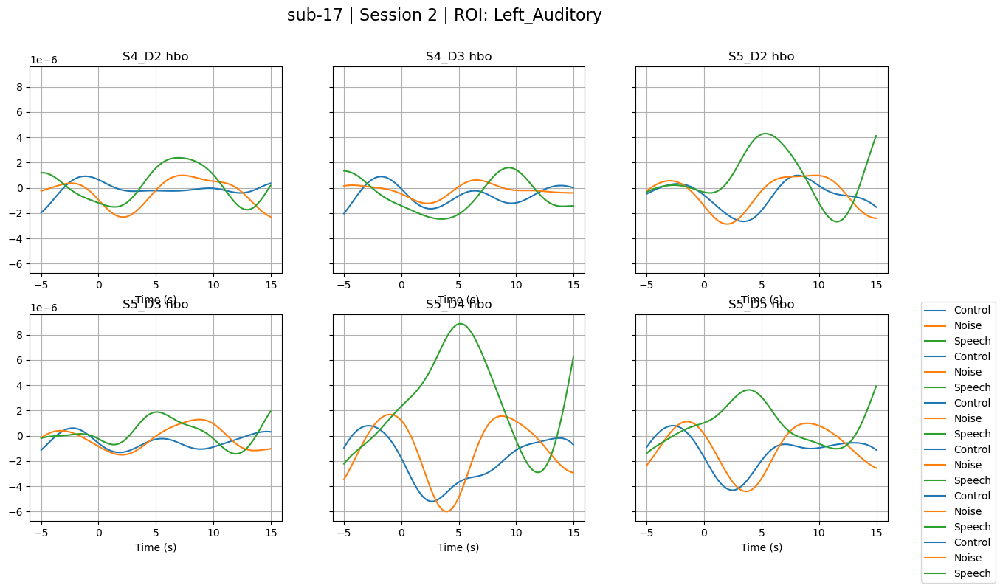

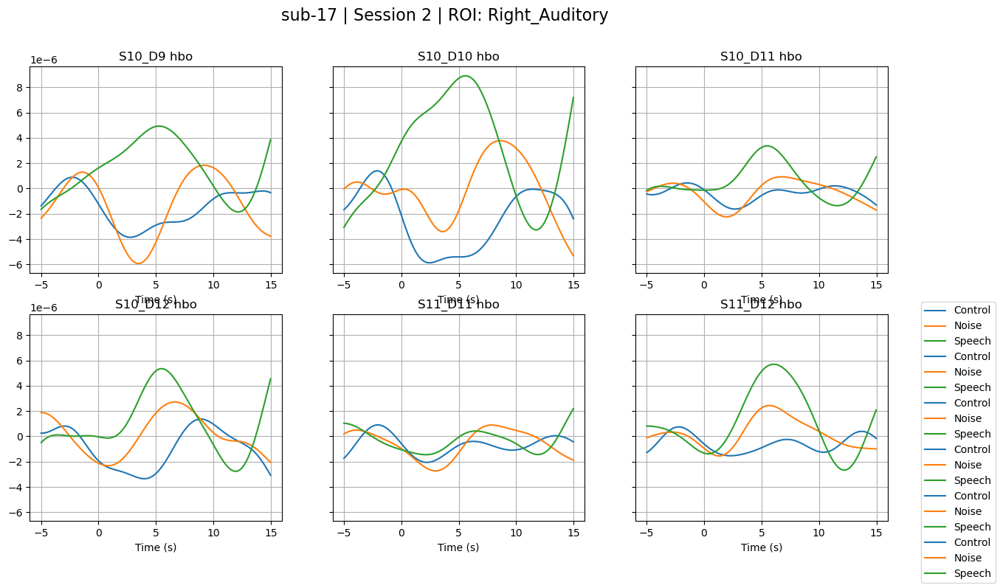

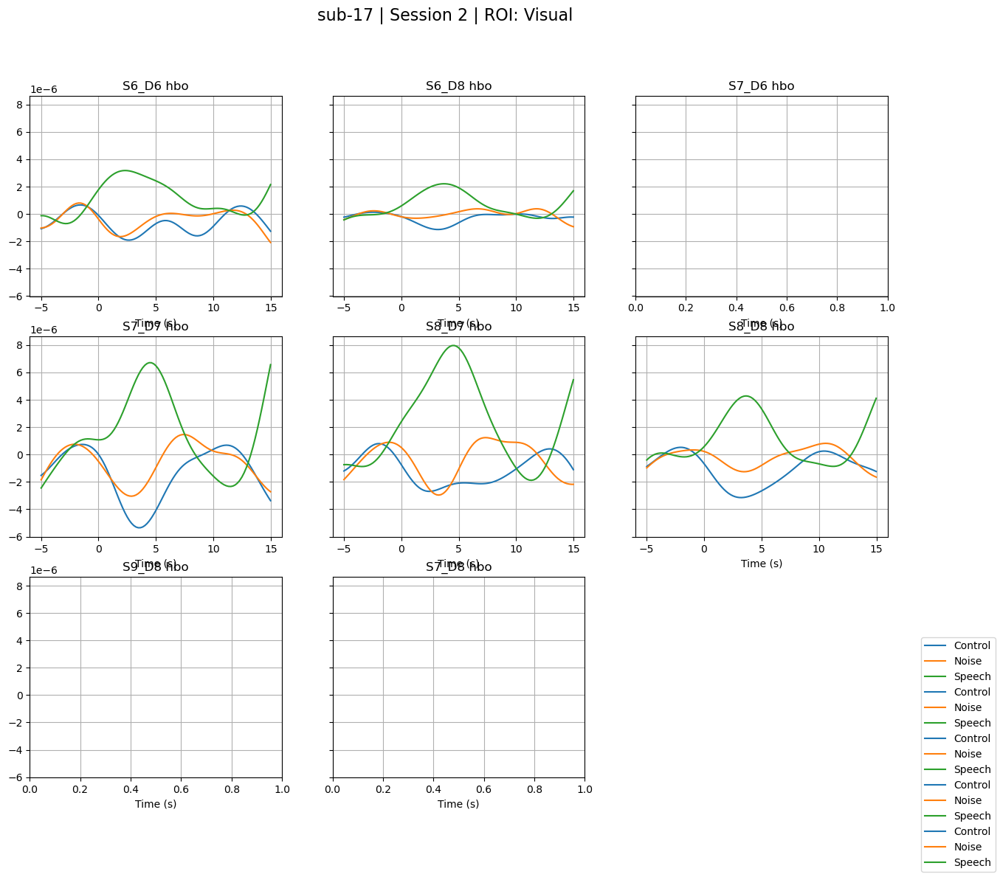

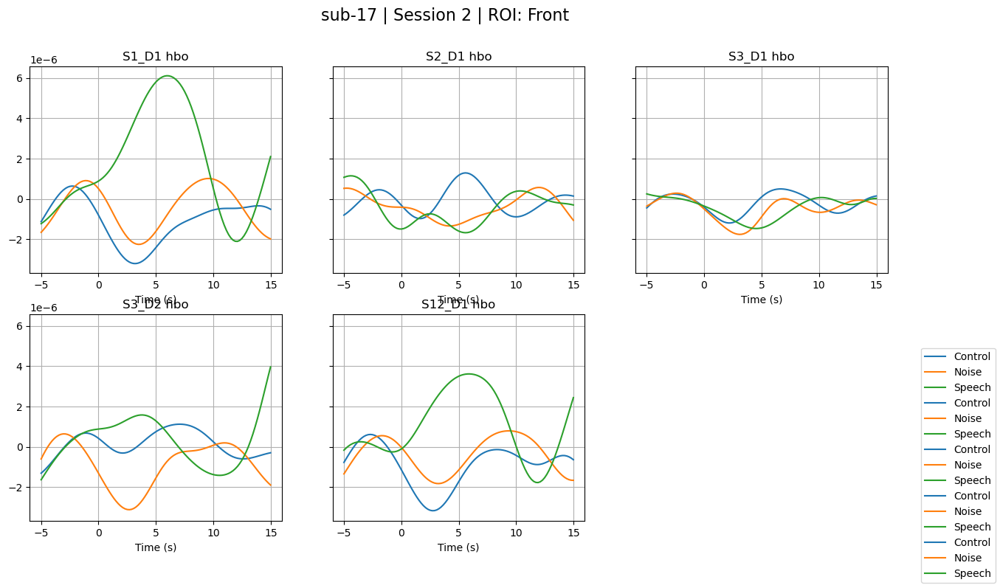

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 19, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 2 in Control - 15 bad channels, total deviation 1.23e-04
🚫 Rejecting Epoch 12 in Control - 13 bad channels, total deviation 5.64e-05
🚫 Rejecting Epoch 6 in Control - 11 bad channels, total deviation 6.97e-05
🚫 Rejecting Epoch 19 in Control - 11 bad channels, total deviation 5.41e-05
🚫 Rejecting Epoch 7 in Control - 9 bad channels, total deviation 3.39e-05
🚫 Rejecting Epoch 13 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 16 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 0 in Noise - 24 b

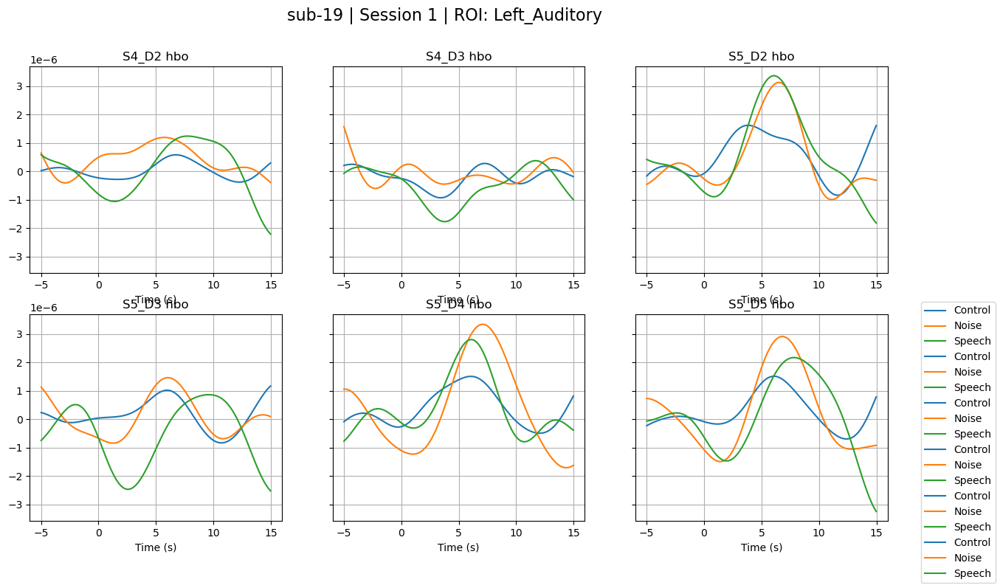

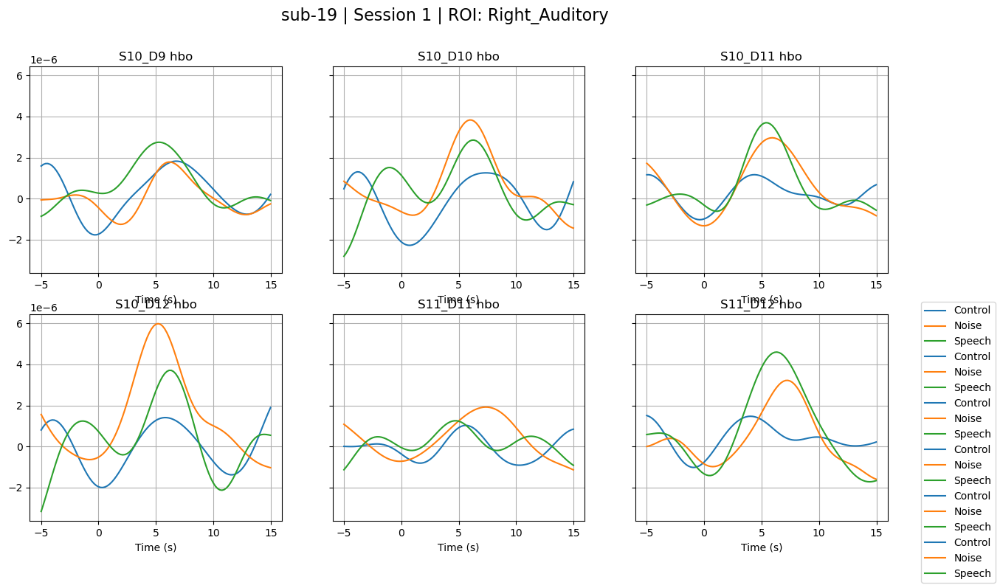

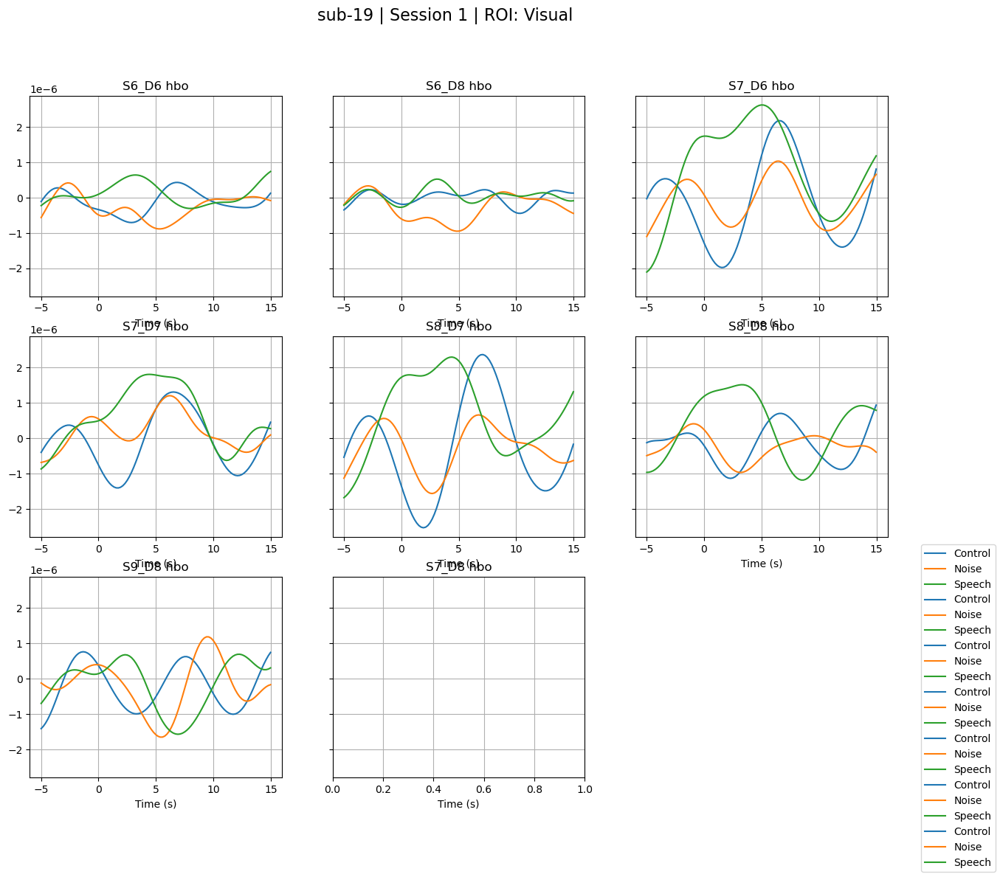

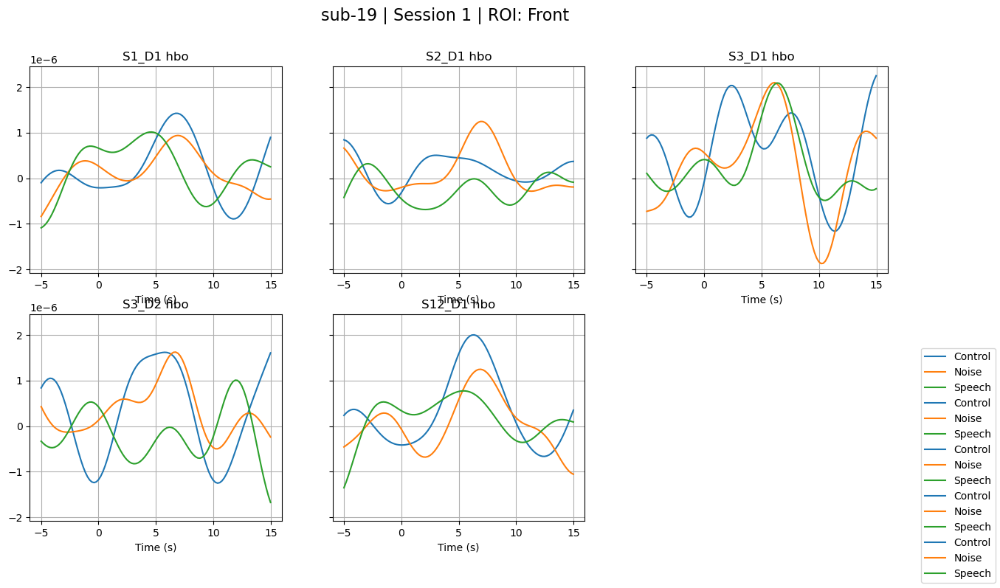

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 4
✅ Number of good short channels: 12
Subject 19, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 9 in Control - 17 bad channels, total deviation 1.16e-04
🚫 Rejecting Epoch 7 in Control - 16 bad channels, total deviation 1.02e-04
🚫 Rejecting Epoch 16 in Control - 16 bad channels, total deviation 8.95e-05
🚫 Rejecting Epoch 14 in Control - 16 bad channels, total deviation 8.07e-05
🚫 Rejecting Epoch 1 in Control - 15 bad channels, total deviation 7.55e-05
🚫 Rejecting Epoch 19 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 3 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 16 in Noise - 24 bad channels, total deviatio

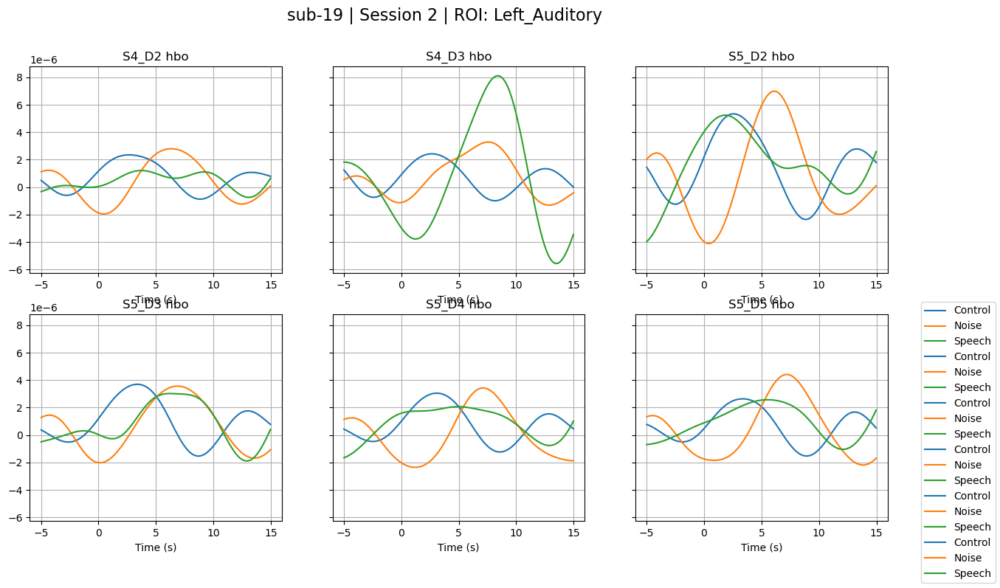

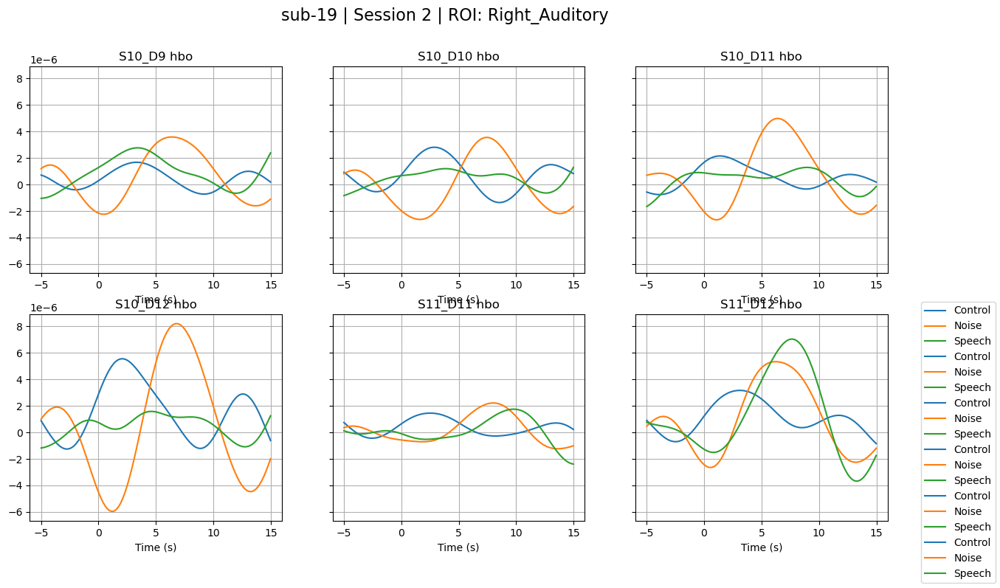

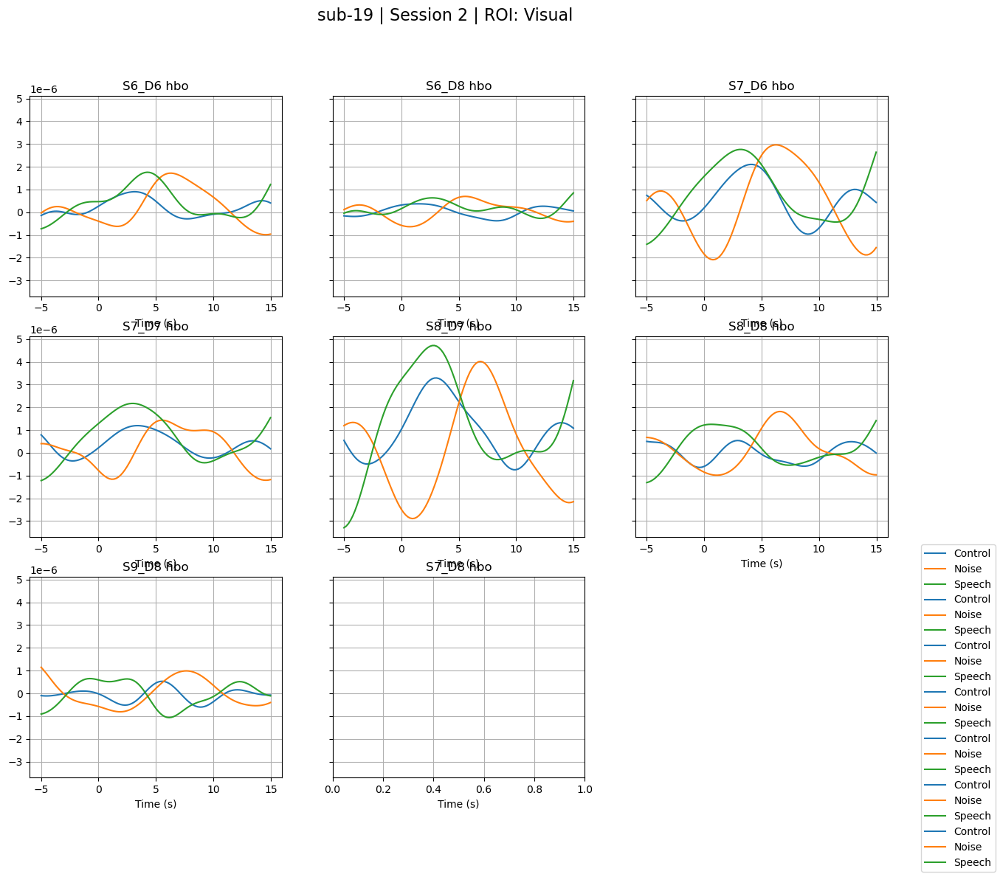

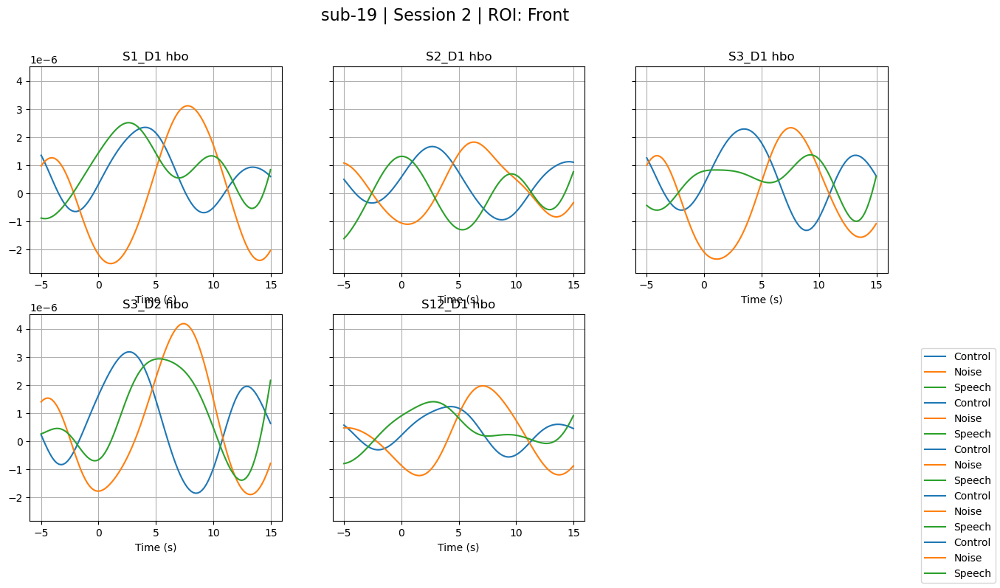

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 21, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 5 in Control - 19 bad channels, total deviation 8.96e-05
🚫 Rejecting Epoch 6 in Control - 15 bad channels, total deviation 5.72e-05
🚫 Rejecting Epoch 7 in Control - 13 bad channels, total deviation 5.38e-05
🚫 Rejecting Epoch 16 in Control - 13 bad channels, total deviation 5.12e-05
🚫 Rejecting Epoch 10 in Control - 13 bad channels, total deviation 4.50e-05
🚫 Rejecting Epoch 14 in Noise - 24 bad channels, total deviation 2.14e+02
🚫 Rejecting Epoch 6 in Noise - 24 bad channels, tot

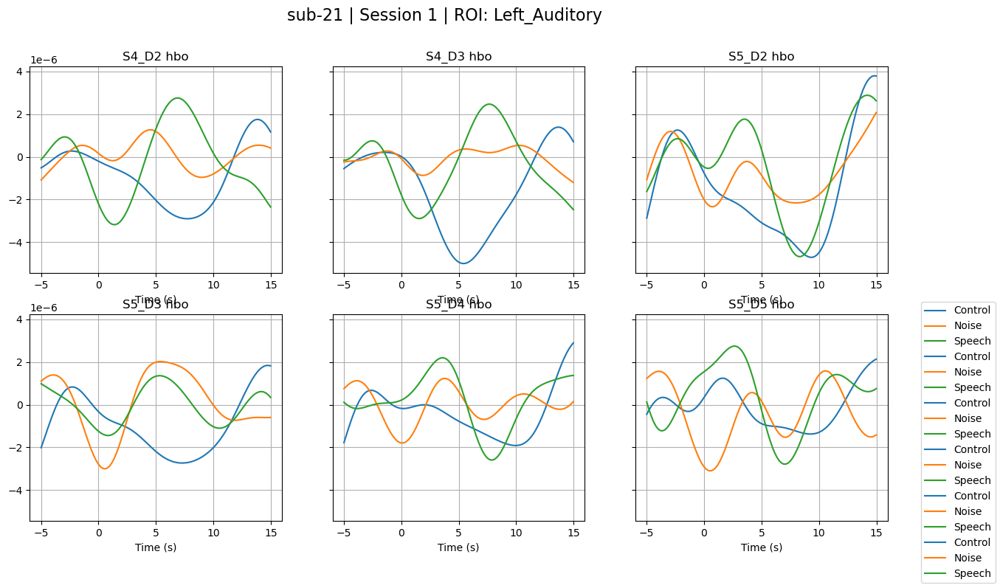

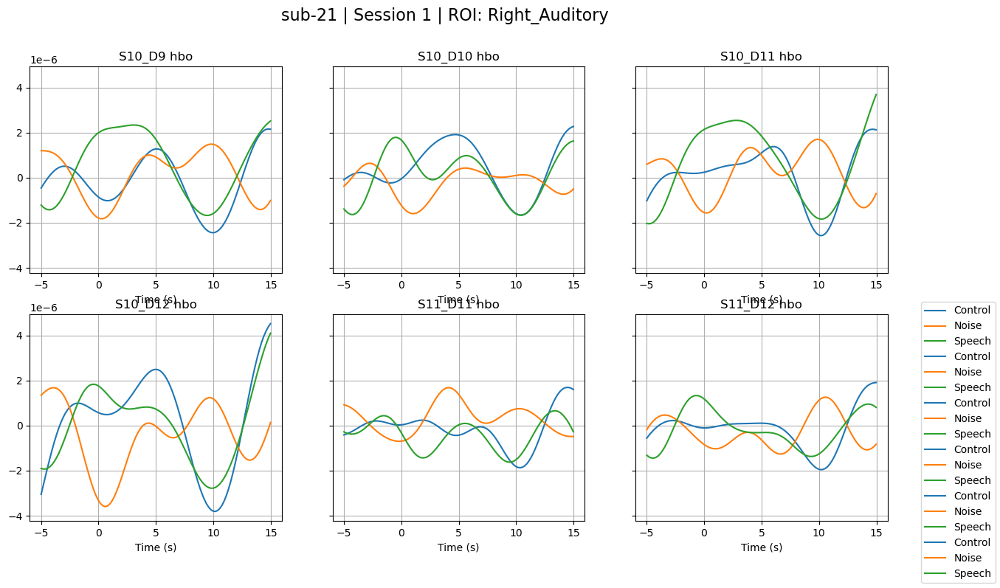

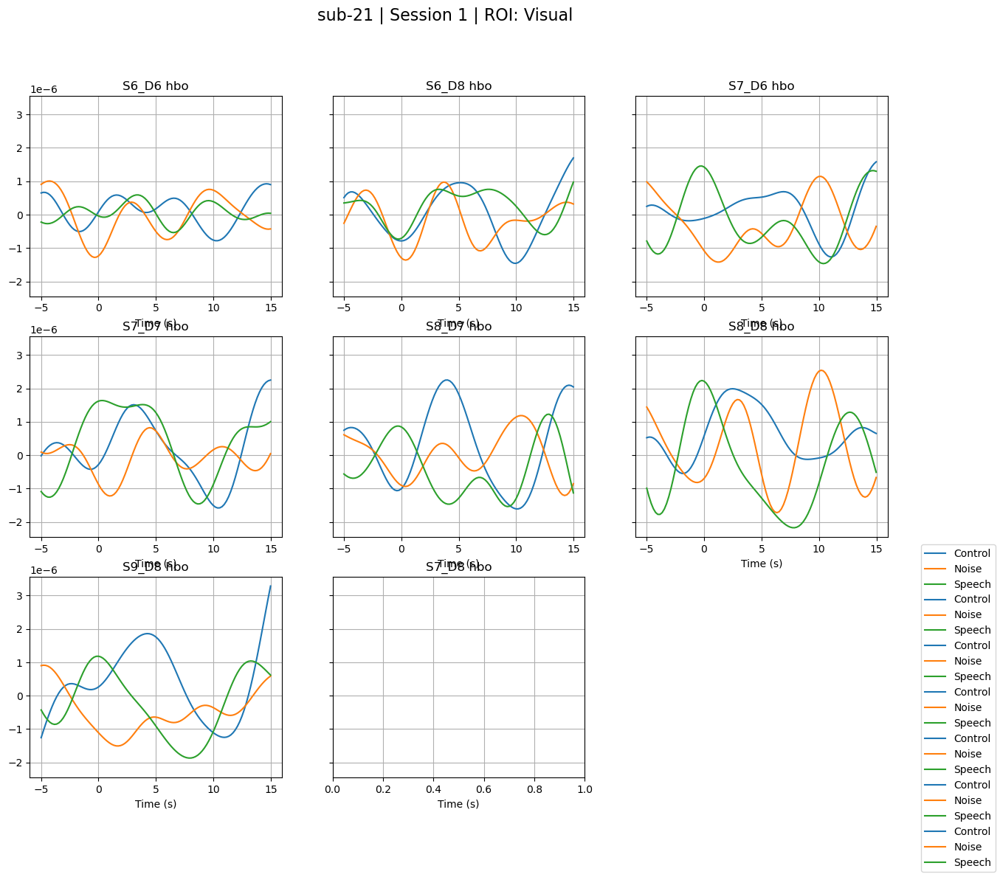

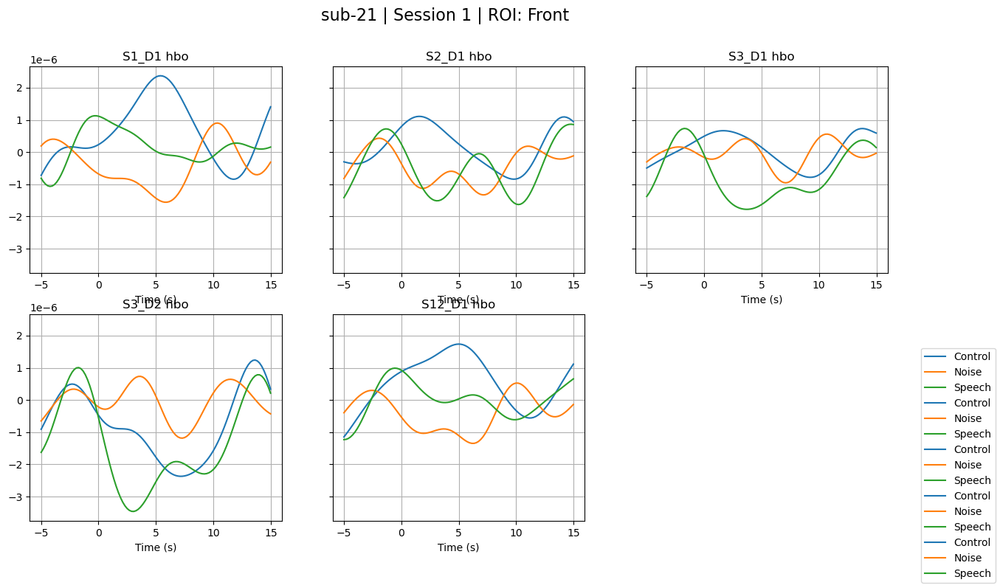

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 6
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 21, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 14 in Control - 17 bad channels, total deviation 1.59e-04
🚫 Rejecting Epoch 13 in Control - 17 bad channels, total deviation 8.54e-05
🚫 Rejecting Epoch 1 in Control - 16 bad channels, total deviation 6.28e-05
🚫 Rejecting Epoch 17 in Control - 15 bad channels, total deviation 1.06e-04
🚫 Rejecting Epoch 16 in Control - 14 bad channels, total deviation 1.26e-04
🚫 Rejecting Epoch 0 in Noise - 22 bad cha

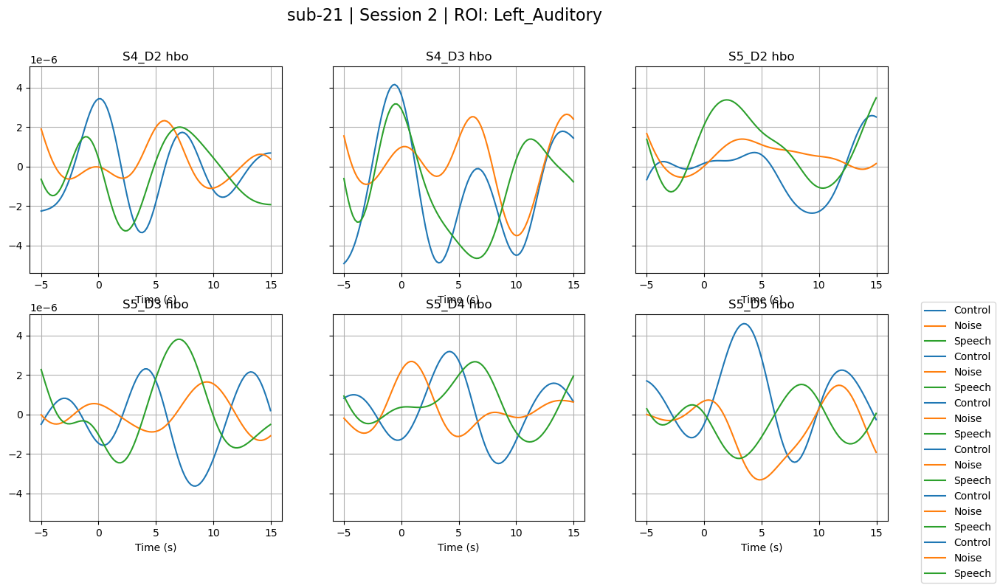

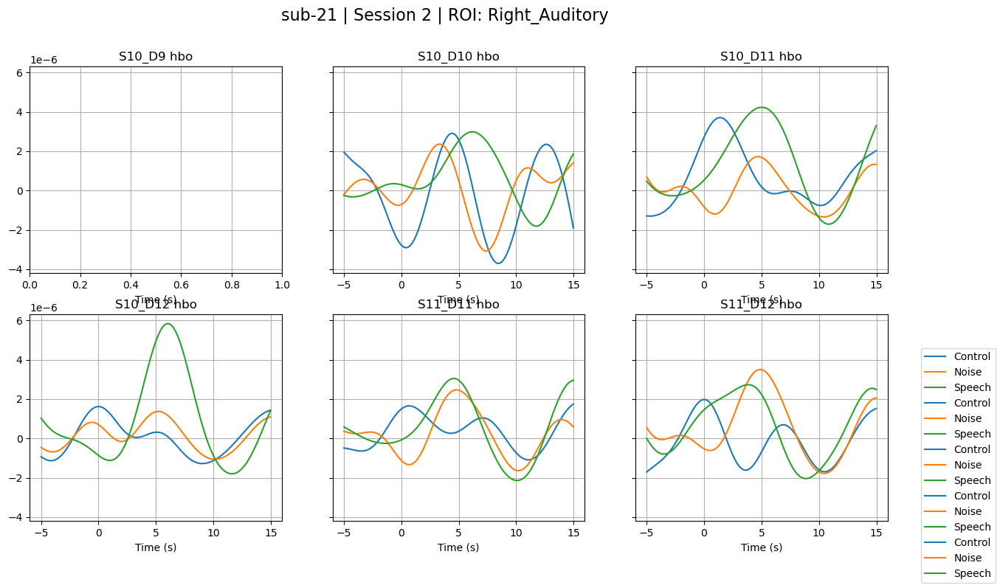

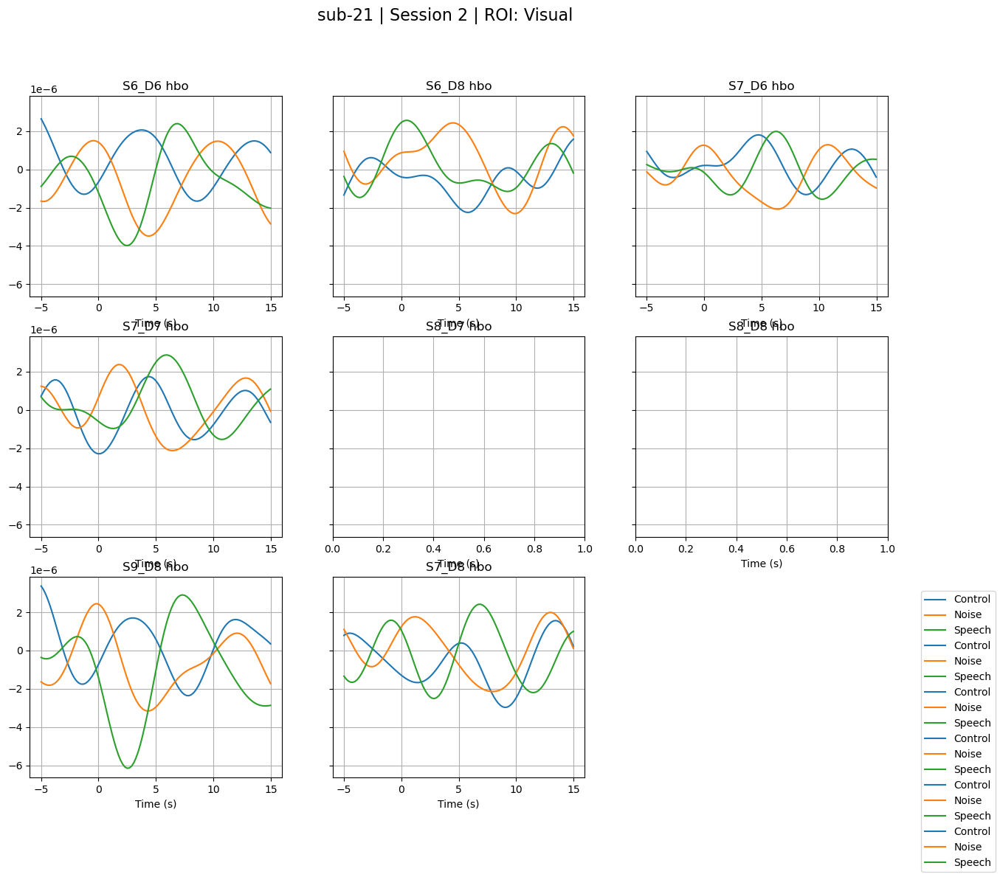

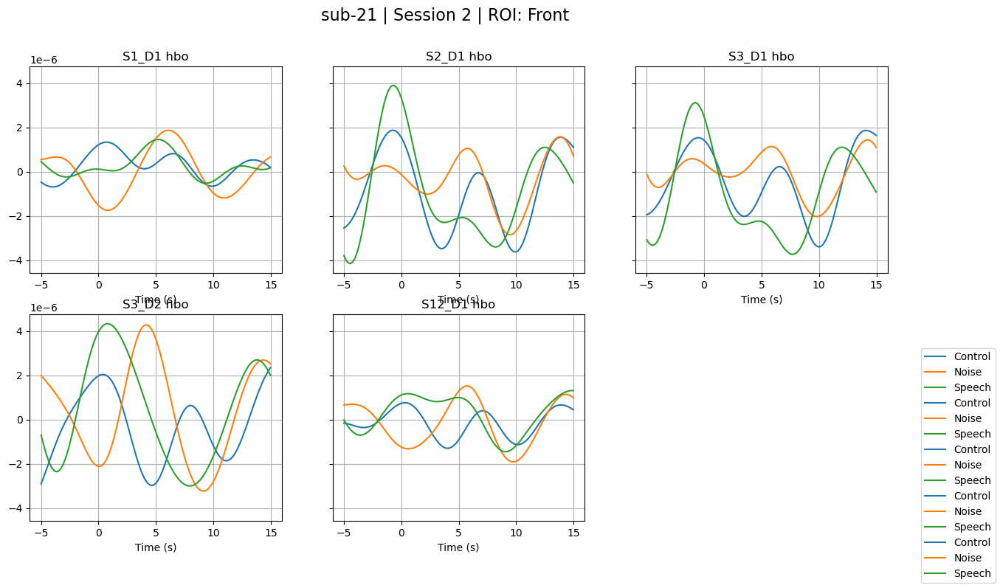

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Number of all (good and bad) short channels: 16
Number of bad long channels: 12
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 24, Session 01: 60 epochs loaded
🚫 Rejecting Epoch 19 in Control - 18 bad channels, total deviation 1.54e-04
🚫 Rejecting Epoch 16 in Control - 18 bad channels, total deviation 1.39e-04
🚫 Rejecting Epoch 6 in Control - 18 bad channels, total deviation 1.13e-04
🚫 Rejecting Epoch 15 in Control - 18 bad channels, total deviation 1.12e-04
🚫 Rejecting Epoch 2 in Control - 16 ba

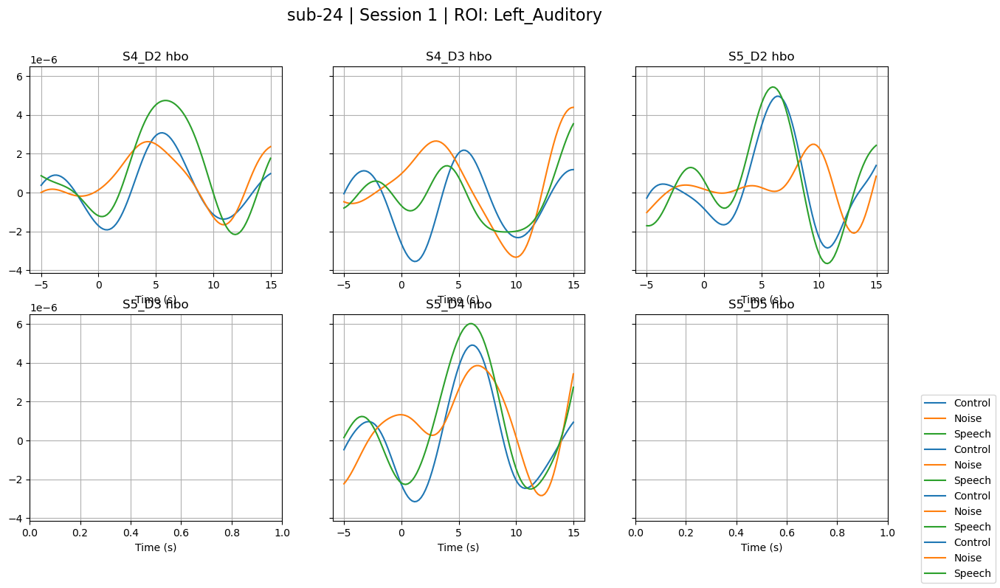

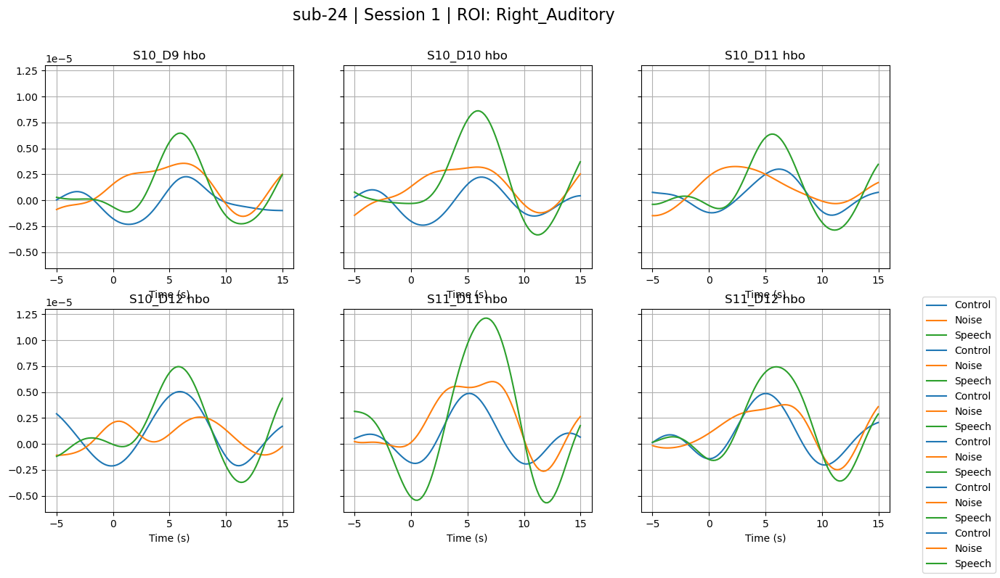

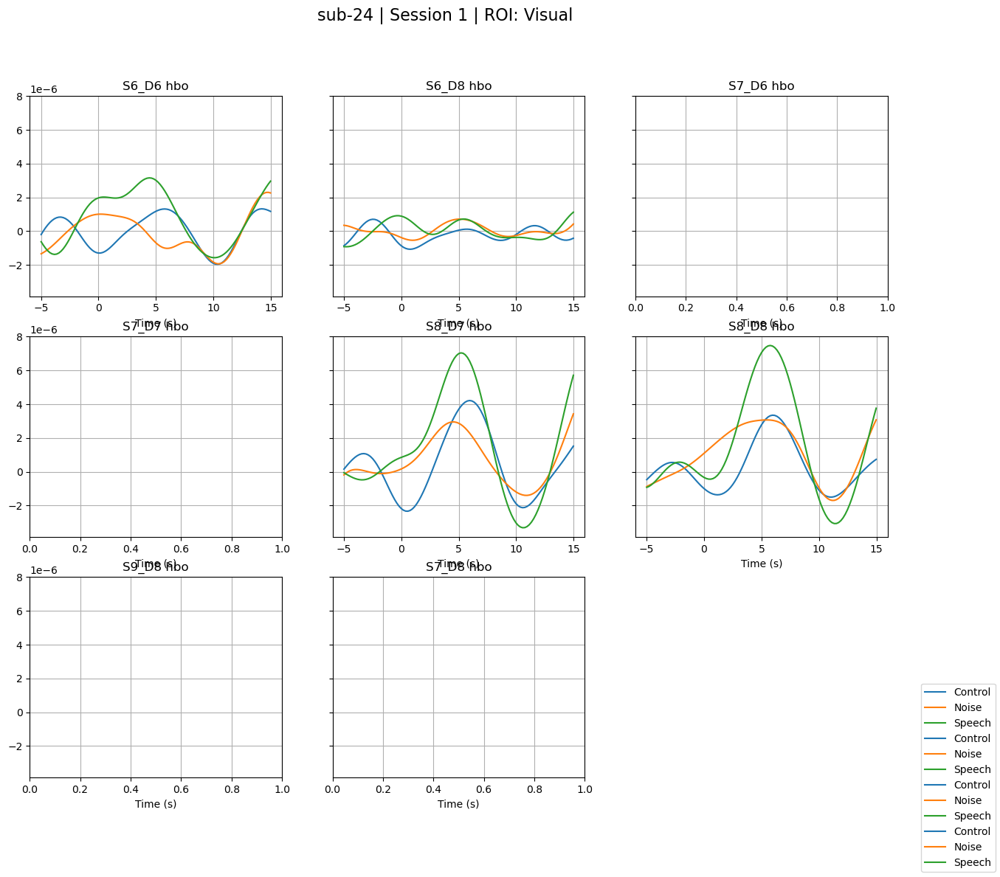

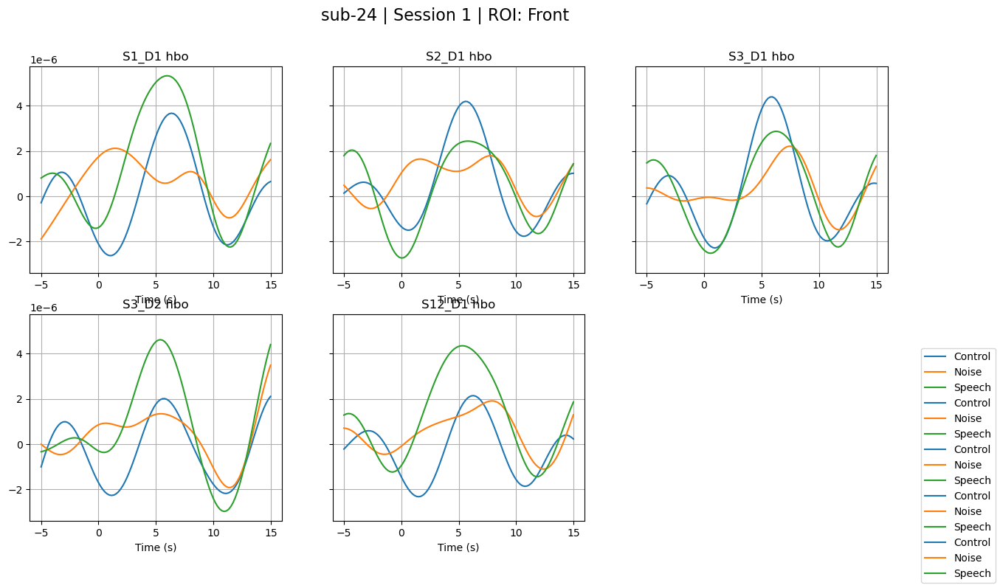

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 24, Session 02: 60 epochs loaded
🚫 Rejecting Epoch 11 in Control - 18 bad channels, total deviation 2.43e-04
🚫 Rejecting Epoch 19 in Control - 18 bad channels, total deviation 2.31e-04
🚫 Rejecting Epoch 0 in Control - 18 bad channels, total deviation 9.15e-05
🚫 Rejecting Epoch 12 in Control - 17 bad channels, total deviation 1.54e-04
🚫 Rejecting Epoch 17 in Control - 17 bad channels, total deviati

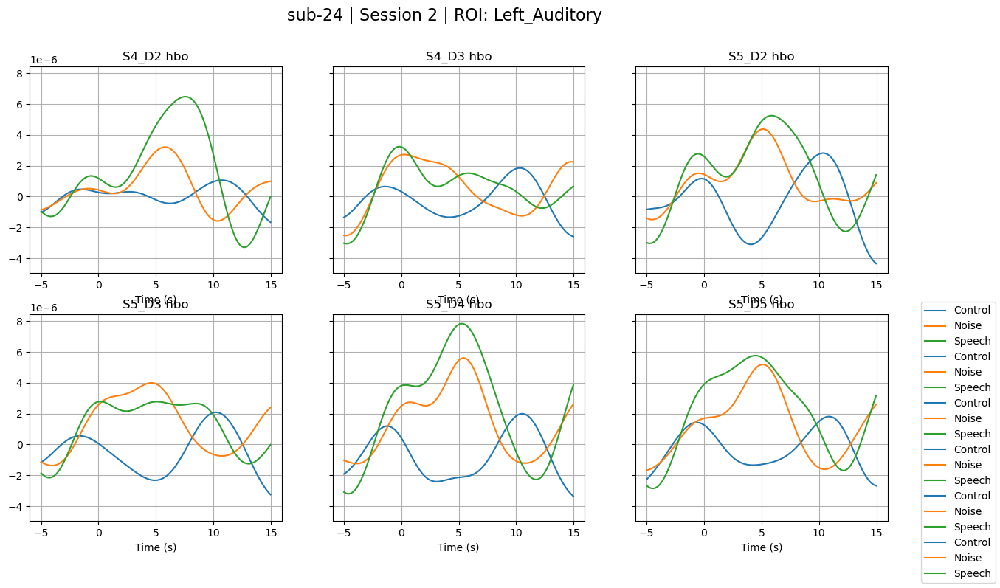

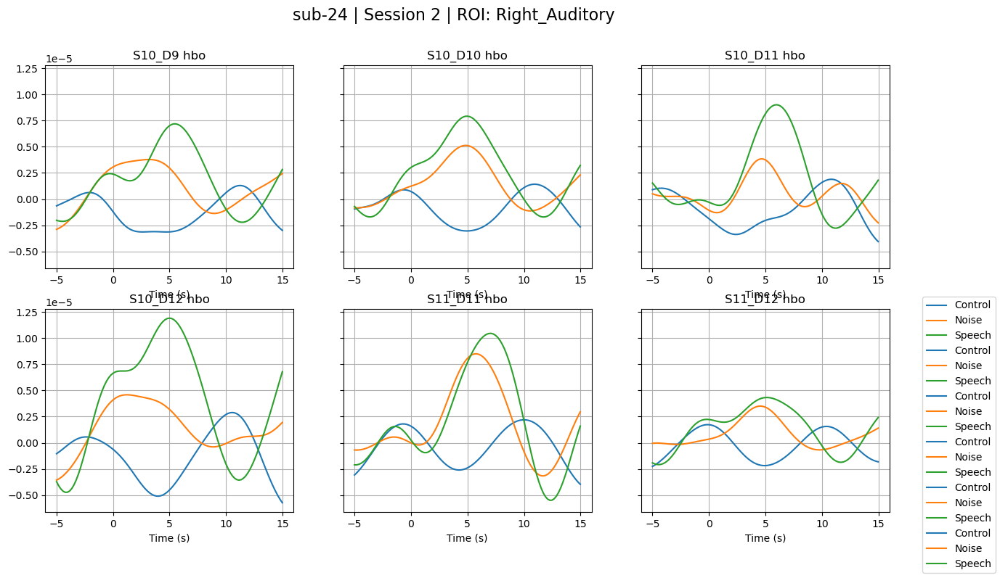

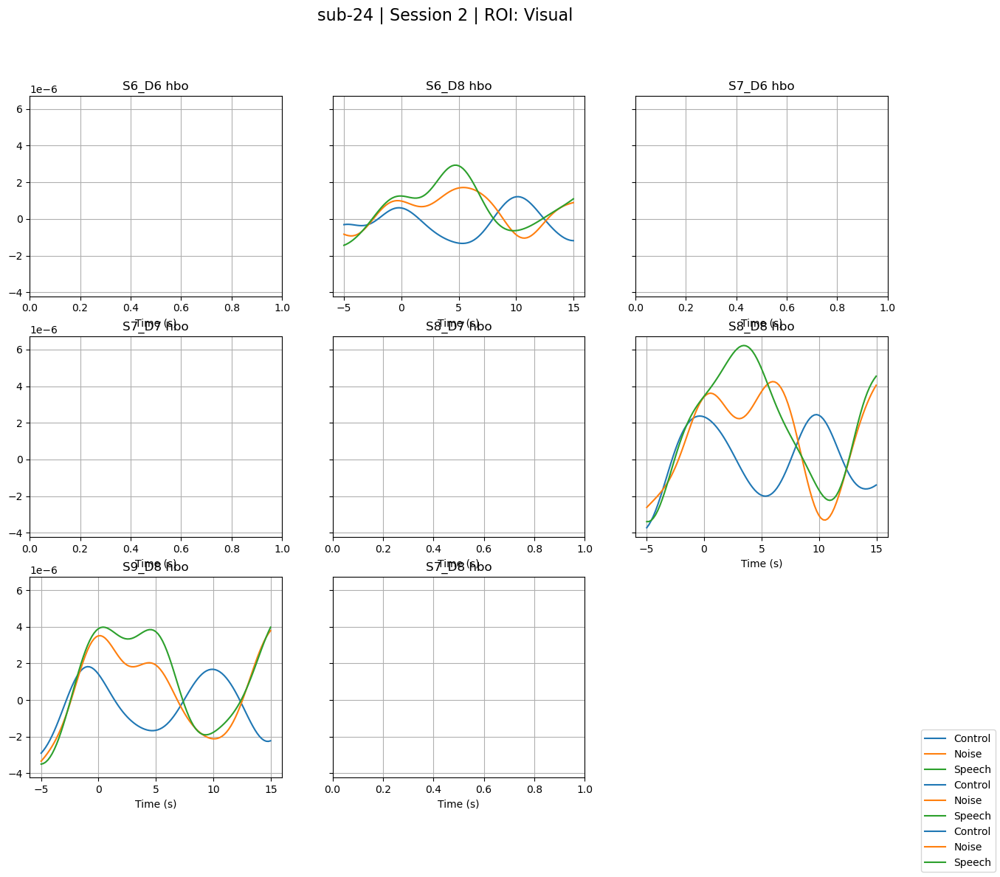

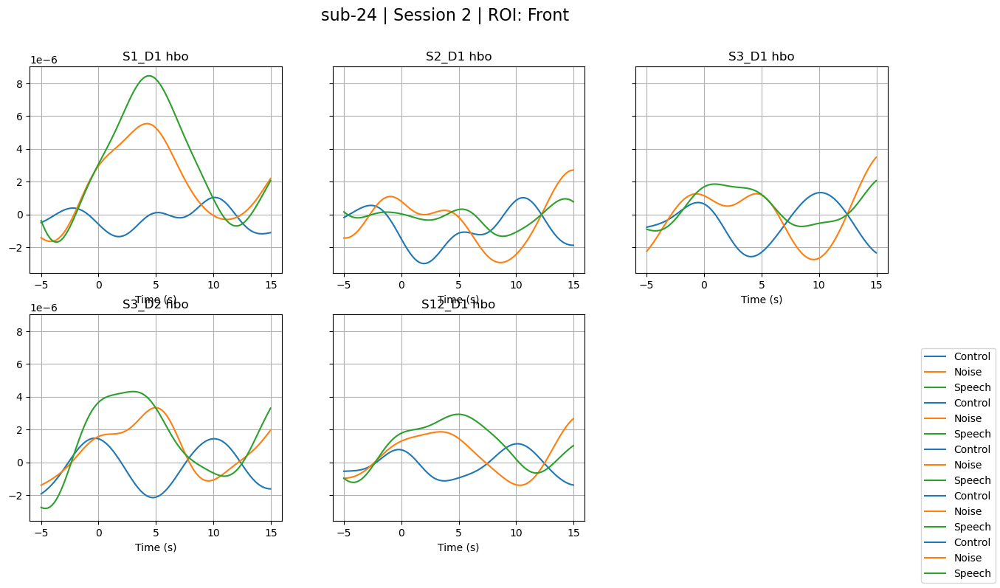


✅ Done!


In [7]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds

def plot_avg_response_per_roi(epochs, roi_name, roi_optodes, event_dict, output_dir, subject_id, session_id):
    import matplotlib.pyplot as plt
    import os
    
    n_optodes = len(roi_optodes)
    n_cols = 3
    n_rows = int(np.ceil(n_optodes / n_cols))

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 4 * n_rows), sharey=True)
    axes = axes.flatten()

    time = epochs.times

    for i, optode in enumerate(roi_optodes):
        ax = axes[i]
        for condition, event_id in event_dict.items():
            try:
                data = epochs[condition].copy().pick(optode).average().data[0]
                ax.plot(time, data, label=condition)
            except Exception as e:
                #print(f"⚠️ Could not plot {condition} for {optode}: {e}")
                continue
        ax.set_title(optode)
        ax.set_xlabel("Time (s)")
        ax.grid(True)

    for ax in axes[n_optodes:]:
        fig.delaxes(ax)

    fig.suptitle(f"{subject_id} | Session {session_id} | ROI: {roi_name}", fontsize=16)
    fig.legend(loc='lower right')

    out_path = os.path.join(output_dir, f"{subject_id}_ses-{session_id:02d}_{roi_name}_optode_responses.png")
    fig.savefig(out_path)
    
    plt.show()



# === Define the plot_evoked_rois function ===
def plot_evoked_rois(evoked_dict, roi_definitions, output_path, title_prefix=""):
    # Number of ROIs (columns) to create
    fig, axes = plt.subplots(1, len(roi_definitions), figsize=(6 * len(roi_definitions), 5))
    if len(roi_definitions) == 1:
        axes = [axes]
    
    # Define colors for each condition
    condition_colors = {
        "Control": "r",  # Red for Control
        "Noise": "g",    # Green for Noise
        "Speech": "b"    # Blue for Speech
    }
    
    # Iterate through each ROI
    for ax, (roi_name, optodes) in zip(axes, roi_definitions.items()):
        # Create a dictionary to store evoked data for the legend
        evoked_for_legend = {}

        # For each condition, plot evoked responses with different colors
        for condition_name, evoked in evoked_dict.items():
            picks = [ch for ch in optodes if ch in evoked.ch_names]
            if not picks:
                print(f"⚠️ No channels found in ROI '{roi_name}' for {condition_name}")
                continue
            
            # Plot the evoked response for the current condition with the corresponding color
            plot_compare_evokeds(
                {condition_name: evoked},
                picks=picks,
                axes=ax,
                combine='mean',
                show=False,
                colors=[condition_colors.get(condition_name, 'k')],  # Default to black if not defined
                ylim=dict(hbo=[-5, 12])
            )

            # Store the evoked for the condition in the dictionary for the legend
            evoked_for_legend[condition_name] = evoked
        
        # Set the title for the ROI plot
        ax.set_title(f"{title_prefix} ROI: {roi_name}")
        
        # Create a legend with conditions
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles, labels, title="Conditions")
    
    # Save the plot
    plt.savefig(output_path)
    # Show the plot
    plt.show()

# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)



bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"


# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

#subject_list = subject_list[:1]  # Limit to first subject for now
print("Detected subjects:", subject_list)

# === Start processing ===
for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # --- Load your data ---
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Initial setup ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = epochs.events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        time_slice = data[:, :, 26:105]
        max_values = np.max(time_slice, axis=2)
        min_values = np.min(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        control_min = min_values[control_idx, :]
        noise_min = min_values[noise_idx, :]
        speech_min = min_values[speech_idx, :]

        n_channels = control_max.shape[1]  # Number of channels
        bad_channel_threshold = int(0.25 * n_channels)  # 25% of channels

        # === Plot BEFORE cleaning ===
        """ plt.figure(figsize=(18, 12))
        for i, (name, mat) in enumerate(zip(["Control", "Noise", "Speech"], [control_max, noise_max, speech_max])):
            plt.subplot(3, 1, i + 1)
            sns.heatmap(mat.T, cmap="viridis", cbar_kws={'label': 'Max Value'}, vmin=-4e-5, vmax=5e-5)
            plt.title(f'{name}: Max Value per Epoch and Channel (Before cleaning)')
            plt.xlabel('Epochs')
            plt.ylabel('Channels')
        plt.savefig(os.path.join(output_dir, "heatmaps_before_epoch_rejection.png")) """
        #NON_IDEAL
        """ thresholds = {
                "Control": {"mean_max": 4.25e-6, "mean_min": -4.37e-6, "std_max": 2.55e-6, "std_min": 2.49e-6},
                "Noise": {"mean_max": 6.39e-6, "mean_min": -3.68e-6, "std_max": 3.13e-6, "std_min": 1.67e-6},
                "Speech": {"mean_max": 7.12e-6, "mean_min": -4.2e-6, "std_max": 3.06e-6, "std_min": 1.94e-6},
            } """
        
        # IDEAL
        thresholds = {
                "Control": {"mean_max": 4.16e-6, "mean_min": -4.23e-6, "std_max": 2.51e-6, "std_min": 2.32e-6},
                "Noise": {"mean_max": 6.08e-6, "mean_min": -3.61e-6, "std_max": 2.55e-6, "std_min": 1.54-6},
                "Speech": {"mean_max": 7.16e-6, "mean_min": -3.88e-6, "std_max": 3.16e-6, "std_min": 1.5e-6},
            } 
        
        # NO SHORT CHANELS
        """ thresholds = {
                "Control": {"mean_max": 4.21e-6, "mean_min": -4.02e-6, "std_max": 2.22e-6, "std_min": 2.03e-6},
                "Noise": {"mean_max": 5.95e-6, "mean_min": -3.46e-6, "std_max": 2.53e-6, "std_min": 1.64-6},
                "Speech": {"mean_max": 7.07e-6, "mean_min": -3.81e-6, "std_max": 3.05e-6, "std_min": 1.78e-6},
            }
        """
        def reject_epochs(max_data, min_data, condition_name, thresholds, threshold_factor, max_reject_ratio=0.25):
            mean_max = thresholds[condition_name]["mean_max"]
            mean_min = thresholds[condition_name]["mean_min"]
            std_max = thresholds[condition_name]["std_max"]
            std_min = thresholds[condition_name]["std_min"]

            upper_bound_max = mean_max + (threshold_factor * std_max)
            lower_bound_min = mean_min - (threshold_factor * std_min)

            rejection_scores = []  # (epoch_idx, num_bad_channels, total_violation)

            for epoch_idx in range(max_data.shape[0]):
                epoch_max = max_data[epoch_idx, :]
                epoch_min = min_data[epoch_idx, :]

                bad_max = epoch_max > upper_bound_max
                bad_min = epoch_min < lower_bound_min
                bad_channels = bad_max | bad_min

                num_bad_channels = np.sum(bad_channels)

                if num_bad_channels > 0:
                    max_violation = np.sum(epoch_max[bad_max] - upper_bound_max)
                    min_violation = np.sum(lower_bound_min - epoch_min[bad_min])
                    total_violation = max_violation + min_violation

                    rejection_scores.append((epoch_idx, num_bad_channels, total_violation))

            # Sort by: 1) num_bad_channels DESC, 2) total_violation DESC
            sorted_scores = sorted(rejection_scores, key=lambda x: (-x[1], -x[2]))

            max_allowed_rejections = int(max_reject_ratio * max_data.shape[0])
            rejected_epochs = [idx for idx, _, _ in sorted_scores[:max_allowed_rejections]]

            # Remove rejected epochs
            cleaned_max = np.delete(max_data, rejected_epochs, axis=0)
            cleaned_min = np.delete(min_data, rejected_epochs, axis=0)

            # Logging
            for idx, chs, dev in sorted_scores[:max_allowed_rejections]:
                print(f"🚫 Rejecting Epoch {idx} in {condition_name} - {chs} bad channels, total deviation {dev:.2e}")

            return cleaned_max, cleaned_min, rejected_epochs

        threshold_factor = 2  # Adjust this value as needed

        control_max_cleaned, control_min_cleaned, rejected_control = reject_epochs(
            control_max, control_min, "Control", thresholds, threshold_factor
        )

        noise_max_cleaned, noise_min_cleaned, rejected_noise = reject_epochs(
            noise_max, noise_min, "Noise", thresholds, threshold_factor
        )

        speech_max_cleaned, speech_min_cleaned, rejected_speech = reject_epochs(
            speech_max, speech_min, "Speech", thresholds, threshold_factor
        )

        # Create new cleaned Epochs arrays
        epochs_cleaned = epochs_before_cleaning.copy()

        epochs_cleaned = epochs_cleaned.drop([idx for idx in rejected_control + rejected_noise + rejected_speech])
        
        
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        # === Plot AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        rois = {
            "Left_Auditory": ["S4_D2 hbo", "S4_D3 hbo", "S5_D2 hbo", "S5_D3 hbo", "S5_D4 hbo", "S5_D5 hbo"],
            "Right_Auditory": ["S10_D9 hbo", "S10_D10 hbo", "S10_D11 hbo", "S10_D12 hbo", "S11_D11 hbo", "S11_D12 hbo"],
            "Visual": ["S6_D6 hbo", "S6_D8 hbo", "S7_D6 hbo", "S7_D7 hbo","S8_D7 hbo", "S8_D8 hbo", "S9_D8 hbo", "S7_D8 hbo"],
            "Front": ["S1_D1 hbo", "S2_D1 hbo", "S3_D1 hbo", "S3_D2 hbo","S12_D1 hbo"],
        }
        
        
        for roi_name, roi_optodes in rois.items():
            plot_avg_response_per_roi(
                epochs=epochs_cleaned,
                roi_name=roi_name,
                roi_optodes=roi_optodes,
                event_dict=event_dict,
                output_dir=output_dir,
                subject_id=f"sub-{sub}",
                session_id=ses
            )

        
       

print("\n✅ Done!")

### Different reject percentages

In [216]:
def reject_epochs(max_data, min_data, condition_name, thresholds, threshold_factor, max_reject_ratio=0):
                mean_max = thresholds[condition_name]["mean_max"]
                mean_min = thresholds[condition_name]["mean_min"]
                std_max = thresholds[condition_name]["std_max"]
                std_min = thresholds[condition_name]["std_min"]

                upper_bound_max = mean_max + (threshold_factor * std_max)
                lower_bound_min = mean_min - (threshold_factor * std_min)

                rejection_scores = []  # (epoch_idx, num_bad_channels, total_violation)

                for epoch_idx in range(max_data.shape[0]):
                    epoch_max = max_data[epoch_idx, :]
                    epoch_min = min_data[epoch_idx, :]

                    bad_max = epoch_max > upper_bound_max
                    bad_min = epoch_min < lower_bound_min
                    bad_channels = bad_max | bad_min

                    num_bad_channels = np.sum(bad_channels)

                    if num_bad_channels > 0:
                        max_violation = np.sum(epoch_max[bad_max] - upper_bound_max)
                        min_violation = np.sum(lower_bound_min - epoch_min[bad_min])
                        total_violation = max_violation + min_violation

                        rejection_scores.append((epoch_idx, num_bad_channels, total_violation))

                # Sort by: 1) num_bad_channels DESC, 2) total_violation DESC
                sorted_scores = sorted(rejection_scores, key=lambda x: (-x[1], -x[2]))

                max_allowed_rejections = int(max_reject_ratio * max_data.shape[0])
                rejected_epochs = [idx for idx, _, _ in sorted_scores[:max_allowed_rejections]]

                # Remove rejected epochs
                cleaned_max = np.delete(max_data, rejected_epochs, axis=0)
                cleaned_min = np.delete(min_data, rejected_epochs, axis=0)

                # Logging
                for idx, chs, dev in sorted_scores[:max_allowed_rejections]:
                    print(f"🚫 Rejecting Epoch {idx} in {condition_name} - {chs} bad channels, total deviation {dev:.2e}")

                return cleaned_max, cleaned_min, rejected_epochs


Detected subjects: ['20']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 6
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 20, Session 02: 59 epochs loaded
Processing Subject 20, Session 02 with rejection ratio: 0


C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


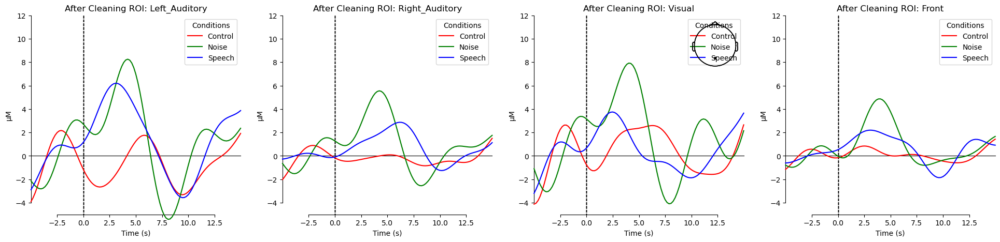

Processing Subject 20, Session 02 with rejection ratio: 0.05
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 3 in Speech - 10 bad channels, total deviation 7.90e-05


C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


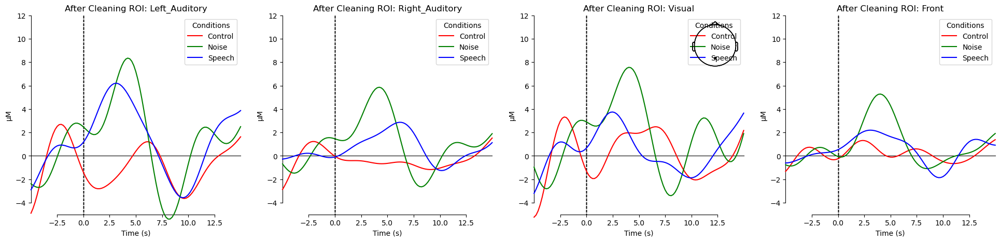

Processing Subject 20, Session 02 with rejection ratio: 0.1
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 7 in Noise - 14 bad channels, total deviation 7.86e-05
🚫 Rejecting Epoch 3 in Speech - 10 bad channels, total deviation 7.90e-05
🚫 Rejecting Epoch 18 in Speech - 8 bad channels, total deviation 4.43e-05


C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


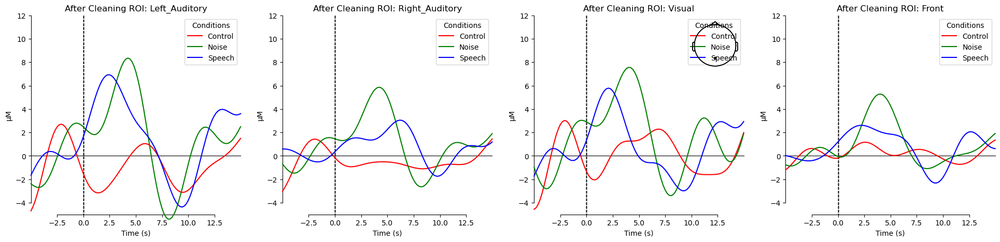

Processing Subject 20, Session 02 with rejection ratio: 0.2
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 7 in Noise - 14 bad channels, total deviation 7.86e-05
🚫 Rejecting Epoch 10 in Noise - 13 bad channels, total deviation 1.05e-04
🚫 Rejecting Epoch 17 in Noise - 12 bad channels, total deviation 1.92e-04
🚫 Rejecting Epoch 3 in Speech - 10 bad channels, total deviation 7.90e-05
🚫 Rejecting Epoch 18 in Speech - 8 bad channels, total deviation 4.43e-05
🚫 Rejecting Epoch 4 in Speech - 7 bad channels, total deviation 6.95e-05
🚫 Rejecting Epoch 2 in Speech - 7 bad channels, total deviation 3.90e-05


C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


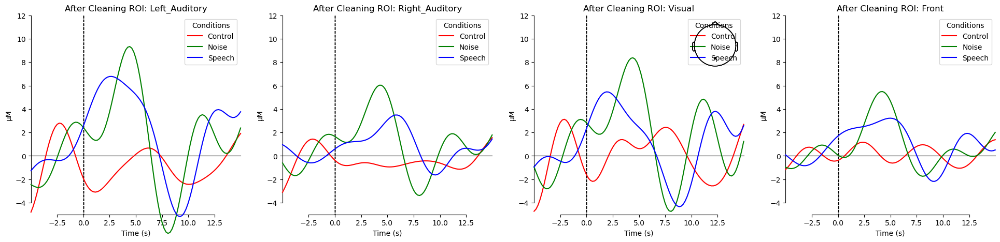

Processing Subject 20, Session 02 with rejection ratio: 0.25
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 7 in Noise - 14 bad channels, total deviation 7.86e-05
🚫 Rejecting Epoch 10 in Noise - 13 bad channels, total deviation 1.05e-04
🚫 Rejecting Epoch 17 in Noise - 12 bad channels, total deviation 1.92e-04
🚫 Rejecting Epoch 2 in Noise - 11 bad channels, total deviation 7.61e-05
🚫 Rejecting Epoch 3 in Speech - 10 bad channels, total deviation 7.90e-05
🚫 Rejecting Epoch 18 in Speech - 8 bad channels, total deviation 4.43e-05
🚫 Rejecting Epoch 4 in Speech - 7 bad channels, total deviation 6.95e-05
🚫 Rejecting Epoch 2 in Speech - 7 bad channels, 

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


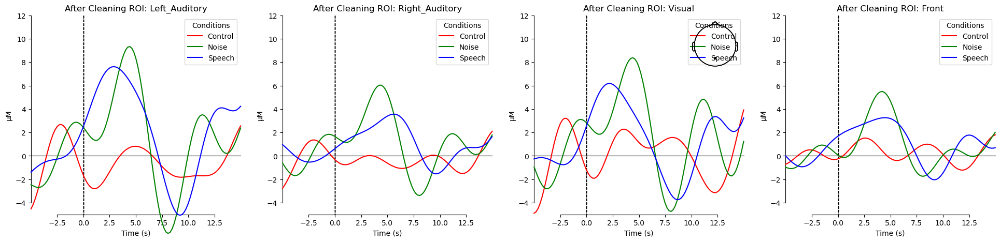

Processing Subject 20, Session 02 with rejection ratio: 0.3
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 7 in Noise - 14 bad channels, total deviation 7.86e-05
🚫 Rejecting Epoch 10 in Noise - 13 bad channels, total deviation 1.05e-04
🚫 Rejecting Epoch 17 in Noise - 12 bad channels, total deviation 1.92e-04
🚫 Rejecting Epoch 2 in Noise - 11 bad channels, total deviation 7.61e-05
🚫 Rejecting Epoch 15 in Noise - 10 bad channels, total deviation 6.08e-05
🚫 Rejecting Epoch 3 in Speech - 10 bad channels, total deviation 7.90e-05
🚫 Rejecting Epoch 18 in Speech - 8 bad channels

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


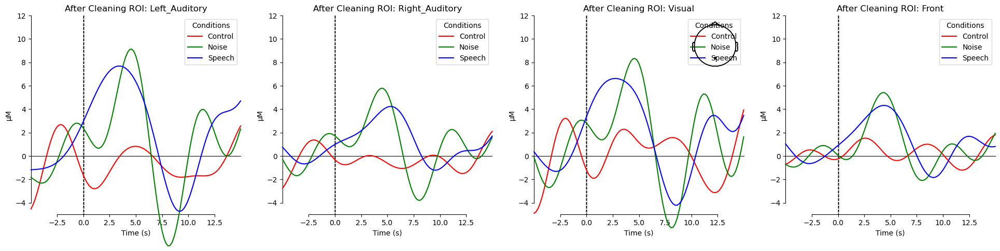

Processing Subject 20, Session 02 with rejection ratio: 0.4
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 2 in Control - 10 bad channels, total deviation 7.03e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 7.02e-05
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 7 in Noise - 14 bad channels, total deviation 7.86e-05
🚫 Rejecting Epoch 10 in Noise - 13 bad channels, total deviation 1.05e-04
🚫 Rejecting Epoch 17 in Noise - 12 bad channels, total deviation 1.92e-04
🚫 Rejecting Epoch 2 in Noise - 11 bad channels, total deviation 7.61e-05
🚫 Rejecting Epoch 15 in Noise - 10 bad chann

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


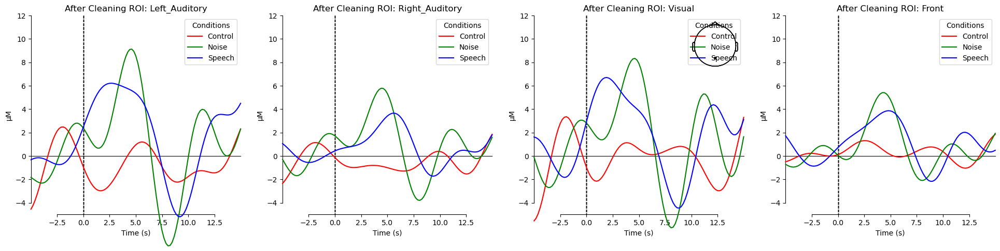

Processing Subject 20, Session 02 with rejection ratio: 0.5
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 2 in Control - 10 bad channels, total deviation 7.03e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 7.02e-05
🚫 Rejecting Epoch 14 in Control - 9 bad channels, total deviation 4.01e-05
🚫 Rejecting Epoch 0 in Control - 8 bad channels, total deviation 5.21e-05
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 7 in Noise - 14 bad channels, total deviation 7.86e-05
🚫 Rejecting Epoch 10 in Noise - 13 bad channels, total deviation 1.05e-04
🚫 Rejecting Epoch 17 in Noise - 12 bad cha

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


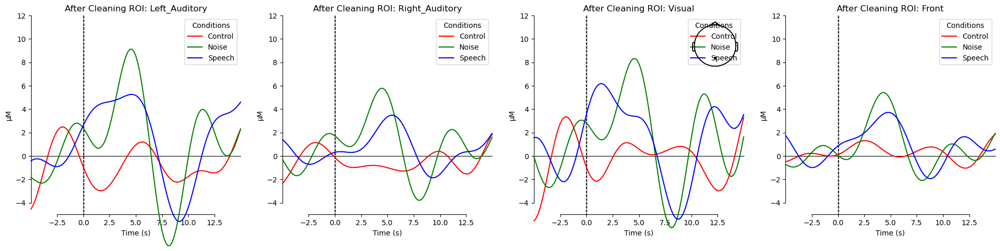

Processing Subject 20, Session 02 with rejection ratio: 0.6
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 2 in Control - 10 bad channels, total deviation 7.03e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 7.02e-05
🚫 Rejecting Epoch 14 in Control - 9 bad channels, total deviation 4.01e-05
🚫 Rejecting Epoch 0 in Control - 8 bad channels, total deviation 5.21e-05
🚫 Rejecting Epoch 3 in Control - 8 bad channels, total deviation 3.11e-05
🚫 Rejecting Epoch 4 in Control - 7 bad channels, total deviation 2.59e-05
🚫 Rejecting Epoch 16 in Noise - 14 bad channels, total deviation 1.46e-04
🚫 Rejecting Epoch 7 in Noise - 14 bad cha

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


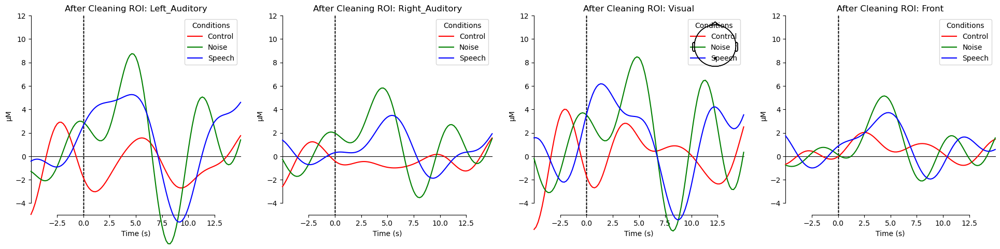

Processing Subject 20, Session 02 with rejection ratio: 0.7
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 2 in Control - 10 bad channels, total deviation 7.03e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 7.02e-05
🚫 Rejecting Epoch 14 in Control - 9 bad channels, total deviation 4.01e-05
🚫 Rejecting Epoch 0 in Control - 8 bad channels, total deviation 5.21e-05
🚫 Rejecting Epoch 3 in Control - 8 bad channels, total deviation 3.11e-05
🚫 Rejecting Epoch 4 in Control - 7 bad channels, total deviation 2.59e-05
🚫 Rejecting Epoch 18 in Control - 6 bad channels, total deviation 4.35e-05
🚫 Rejecting Epoch 7 in Control - 6 bad c

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


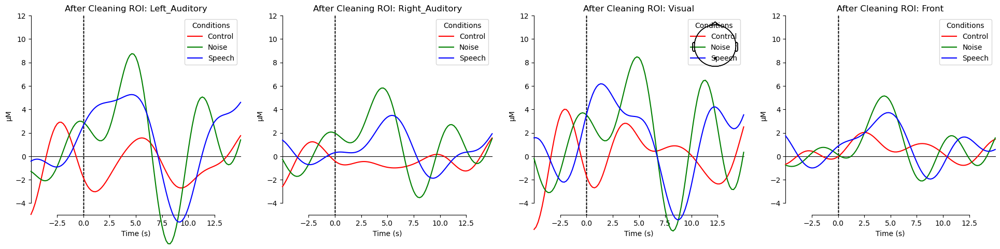

Processing Subject 20, Session 02 with rejection ratio: 0.8
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 2 in Control - 10 bad channels, total deviation 7.03e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 7.02e-05
🚫 Rejecting Epoch 14 in Control - 9 bad channels, total deviation 4.01e-05
🚫 Rejecting Epoch 0 in Control - 8 bad channels, total deviation 5.21e-05
🚫 Rejecting Epoch 3 in Control - 8 bad channels, total deviation 3.11e-05
🚫 Rejecting Epoch 4 in Control - 7 bad channels, total deviation 2.59e-05
🚫 Rejecting Epoch 18 in Control - 6 bad channels, total deviation 4.35e-05
🚫 Rejecting Epoch 7 in Control - 6 bad c

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


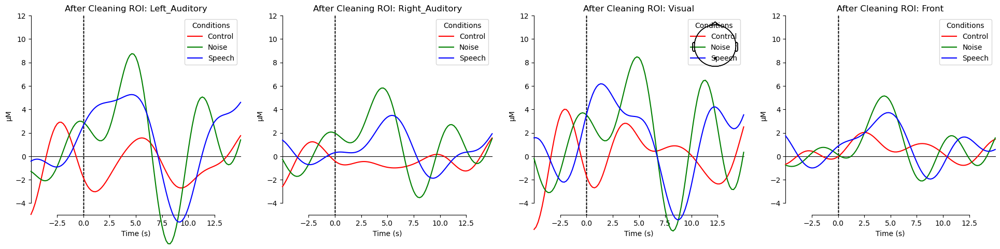

Processing Subject 20, Session 02 with rejection ratio: 0.9
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 2 in Control - 10 bad channels, total deviation 7.03e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 7.02e-05
🚫 Rejecting Epoch 14 in Control - 9 bad channels, total deviation 4.01e-05
🚫 Rejecting Epoch 0 in Control - 8 bad channels, total deviation 5.21e-05
🚫 Rejecting Epoch 3 in Control - 8 bad channels, total deviation 3.11e-05
🚫 Rejecting Epoch 4 in Control - 7 bad channels, total deviation 2.59e-05
🚫 Rejecting Epoch 18 in Control - 6 bad channels, total deviation 4.35e-05
🚫 Rejecting Epoch 7 in Control - 6 bad c

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


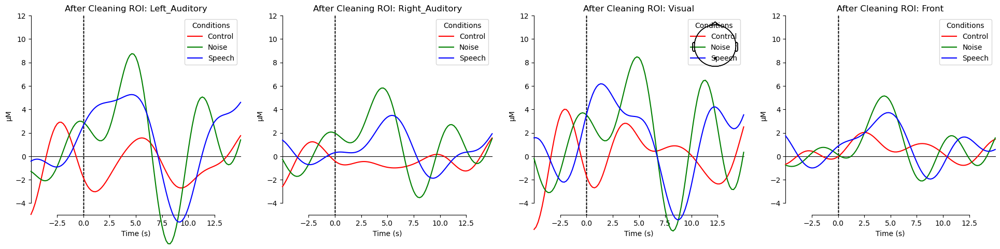

Processing Subject 20, Session 02 with rejection ratio: 0.99
🚫 Rejecting Epoch 12 in Control - 14 bad channels, total deviation 1.94e-04
🚫 Rejecting Epoch 17 in Control - 13 bad channels, total deviation 1.80e-04
🚫 Rejecting Epoch 5 in Control - 12 bad channels, total deviation 7.68e-05
🚫 Rejecting Epoch 9 in Control - 11 bad channels, total deviation 6.15e-05
🚫 Rejecting Epoch 8 in Control - 11 bad channels, total deviation 2.40e-05
🚫 Rejecting Epoch 2 in Control - 10 bad channels, total deviation 7.03e-05
🚫 Rejecting Epoch 13 in Control - 10 bad channels, total deviation 7.02e-05
🚫 Rejecting Epoch 14 in Control - 9 bad channels, total deviation 4.01e-05
🚫 Rejecting Epoch 0 in Control - 8 bad channels, total deviation 5.21e-05
🚫 Rejecting Epoch 3 in Control - 8 bad channels, total deviation 3.11e-05
🚫 Rejecting Epoch 4 in Control - 7 bad channels, total deviation 2.59e-05
🚫 Rejecting Epoch 18 in Control - 6 bad channels, total deviation 4.35e-05
🚫 Rejecting Epoch 7 in Control - 6 bad 

C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(
C:\Users\sarab\AppData\Local\Temp\ipykernel_28972\1268417183.py:38: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  plot_compare_evokeds(


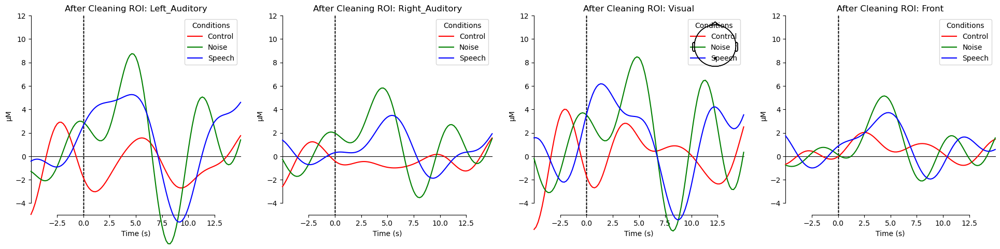


✅ Done!


In [240]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds

# === Define the plot_evoked_rois function ===
def plot_evoked_rois(evoked_dict, roi_definitions, output_path, title_prefix=""):
    # Number of ROIs (columns) to create
    fig, axes = plt.subplots(1, len(roi_definitions), figsize=(6 * len(roi_definitions), 5))
    if len(roi_definitions) == 1:
        axes = [axes]
    
    # Define colors for each condition
    condition_colors = {
        "Control": "r",  # Red for Control
        "Noise": "g",    # Green for Noise
        "Speech": "b"    # Blue for Speech
    }
    
    # Iterate through each ROI
    for ax, (roi_name, optodes) in zip(axes, roi_definitions.items()):
        # Create a dictionary to store evoked data for the legend
        evoked_for_legend = {}

        # For each condition, plot evoked responses with different colors
        for condition_name, evoked in evoked_dict.items():
            picks = [ch for ch in optodes if ch in evoked.ch_names]
            if not picks:
                print(f"⚠️ No channels found in ROI '{roi_name}' for {condition_name}")
                continue
            
            # Plot the evoked response for the current condition with the corresponding color
            plot_compare_evokeds(
                {condition_name: evoked},
                picks=picks,
                axes=ax,
                combine='mean',
                show=False,
                colors=[condition_colors.get(condition_name, 'k')],  # Default to black if not defined
                ylim=dict(hbo=[-5, 12])
            )

            # Store the evoked for the condition in the dictionary for the legend
            evoked_for_legend[condition_name] = evoked
        
        # Set the title for the ROI plot
        ax.set_title(f"{title_prefix} ROI: {roi_name}")
        
        # Create a legend with conditions
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles, labels, title="Conditions")
    
    # Save the plot
    plt.savefig(output_path)
    # Show the plot
    plt.show()

# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)



bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
subject_list = subject_list[19:20]  # Limit to first subject for now
print("Detected subjects:", subject_list)


rejection_ratios_to_try = [0, 0.05, 0.10, 0.20, 0.25, 0.30, 0.40, 0.50, 0.60, 0.70, 0.80, 0.90, 0.99] 

# === Start processing ===
for sub in subject_list:
    for ses in range(2, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # --- Load your data ---
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)
        extra_bad_ch = ["S8_D7 hbo", "S7_D7 hbo", "S8_D8 hbo", "S10_D9 hbo", "S6_D8 hbo"]
        epochs.drop_channels(extra_bad_ch)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Initial setup ===
        for ratio in rejection_ratios_to_try:
            print(f"Processing Subject {sub}, Session {ses:02d} with rejection ratio: {ratio}")
            bad_ch = epochs.info['bads']
            epochs.drop_channels(bad_ch)
            
            epochs_before_cleaning = epochs.copy()

            hbo_data = epochs.copy().pick("hbo")
            data = hbo_data.get_data()
            info = hbo_data.info.copy()
            ev = epochs.events[:, 2]
            index_column = np.arange(0, len(ev)).reshape(-1, 1)
            updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

            time_slice = data[:, :, 26:66]
            max_values = np.max(time_slice, axis=2)
            min_values = np.min(time_slice, axis=2)

            control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
            noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
            speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

            control_max = max_values[control_idx, :]
            noise_max = max_values[noise_idx, :]
            speech_max = max_values[speech_idx, :]

            control_min = min_values[control_idx, :]
            noise_min = min_values[noise_idx, :]
            speech_min = min_values[speech_idx, :]

            n_channels = control_max.shape[1]  # Number of channels
            bad_channel_threshold = int(0.25 * n_channels)  # 25% of channels

            

            thresholds = {
                "Control": {"mean_max": 4.88e-6, "mean_min": -5.42e-6, "std_max": 2.48e-6, "std_min": 3.02e-6},
                "Noise": {"mean_max": 9.28e-6, "mean_min": -4.34e-6, "std_max": 4.46e-6, "std_min": 2.17e-6},
                "Speech": {"mean_max": 1.09e-5, "mean_min": -5.43e-6, "std_max": 4.84e-6, "std_min": 3.25e-6},
            }

            
            threshold_factor = 3  # Adjust this value as needed

            control_max_cleaned, control_min_cleaned, rejected_control = reject_epochs(
                control_max, control_min, "Control", thresholds, threshold_factor, ratio
            )

            noise_max_cleaned, noise_min_cleaned, rejected_noise = reject_epochs(
                noise_max, noise_min, "Noise", thresholds, threshold_factor, ratio
            )

            speech_max_cleaned, speech_min_cleaned, rejected_speech = reject_epochs(
                speech_max, speech_min, "Speech", thresholds, threshold_factor, ratio
            )

            # Create new cleaned Epochs arrays
            epochs_cleaned = epochs_before_cleaning.copy()

            epochs_cleaned = epochs_cleaned.drop([idx for idx in rejected_control + rejected_noise + rejected_speech])
            
            
            indiv_evoked_before = defaultdict(list)
            for condition in event_dict:
                indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

            # === Plot AFTER cleaning ===
            indiv_evoked_after = defaultdict(list)
            for condition in event_dict:
                indiv_evoked_after[condition] = epochs_cleaned[condition].average()

            rois = {
                "Left_Auditory": ["S4_D2 hbo", "S4_D3 hbo", "S5_D2 hbo", "S5_D3 hbo", "S5_D4 hbo", "S5_D5 hbo"],
                "Right_Auditory": ["S10_D9 hbo", "S10_D10 hbo", "S10_D11 hbo", "S10_D12 hbo", "S11_D11 hbo", "S11_D12 hbo"],
                "Visual": ["S6_D6 hbo", "S6_D8 hbo", "S7_D6 hbo", "S7_D7 hbo","S8_D7 hbo", "S8_D8 hbo", "S9_D8 hbo", "S7_D8 hbo"],
                "Front": ["S1_D1 hbo", "S2_D1 hbo", "S3_D1 hbo", "S3_D2 hbo","S12_D1 hbo"],
            }
            
            
            """ # === Plot before cleaning (same as before epoch rejection) ===
            plot_evoked_rois(
                evoked_dict=indiv_evoked_before,
                roi_definitions=rois,
                output_path=os.path.join(output_dir, "evoked_before_cleaning_rois.png"),
                title_prefix="Before Cleaning"
            ) """

            # Call the function to plot evoked responses for each ROI (before cleaning)
            plot_evoked_rois(
                evoked_dict=indiv_evoked_after,
                roi_definitions=rois,
                output_path=os.path.join(output_dir, "evoked_after_cleaning_rois.png"),
                title_prefix="After Cleaning"
            )

        

print("\n✅ Done!")


In [241]:
epochs_before_cleaning.plot()

## Variance approach

### Overal variance calculation accross all participants and sessions

In [204]:
import os
import numpy as np
import pandas as pd
from collections import defaultdict
from mne_bids import BIDSPath

# === Paths ===
bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)

# === List subjects ===
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
print("Detected subjects:", subject_list)

# === Storage ===
all_variances = defaultdict(list)

# === Loop over subjects and sessions ===
for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None or len(epochs) < 10:
            print(f"⚠️ Skipping sub-{sub} ses-{ses:02d} (not enough channels or epochs)")
            continue

        # Drop bad channels
        epochs.drop_channels(epochs.info['bads'])

        # Pick only HbO
        hbo_epochs = epochs.copy().pick("hbo")
        data = hbo_epochs.get_data()  # shape: (n_epochs, n_channels, n_times)
        labels = epochs.events[:, 2]

        for cond, event_code in event_dict.items():
            indices = np.where(labels == event_code)[0]
            if len(indices) == 0:
                continue
            cond_data = data[indices, :, :]  # shape: (n_cond_epochs, n_channels, n_times)
            var = np.var(cond_data[:, :, 26:105], axis=2)  # per epoch per channel
            mean_var = np.mean(var, axis=1)  # average over channels
            all_variances[cond].extend(mean_var)

        print(f"✅ Processed sub-{sub} ses-{ses:02d}")

# === Compute mean and SD of variance per condition ===
summary_variances = []
for cond, values in all_variances.items():
    summary_variances.append({
        "Condition": cond,
        "Mean_Variance": np.mean(values),
        "SD_Variance": np.std(values, ddof=1)
    })

summary_df = pd.DataFrame(summary_variances)
variance_summary_path = os.path.join(output_root, "variance_per_condition.csv")
summary_df.to_csv(variance_summary_path, index=False)
print(f"📄 Variance summary saved to {variance_summary_path}")


Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
✅ Processed sub-01 ses-01
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', '

In [205]:
summary_df

,Condition,Mean_Variance,SD_Variance
0,Control,5.307763e-11,4.286835e-11
1,Noise,5.630062e-11,4.572116e-11
2,Speech,6.015287e-11,4.525697e-11


Detected subjects: ['01', '02', '03', '04', '05']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 59 epochs loaded
Condition Control: 7 epochs rejected
Condition Noise: 10 epochs rejected
Condition Speech: 10 epochs rejected
Total epochs to reject due to peak detection: 27
Participant 01, Session 01 (Before Cleaning)
Participant 01, Session 01 (After Cleaning)
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 

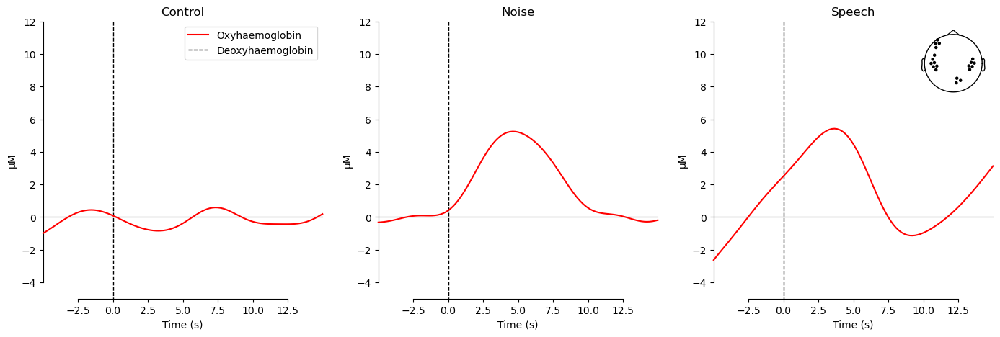

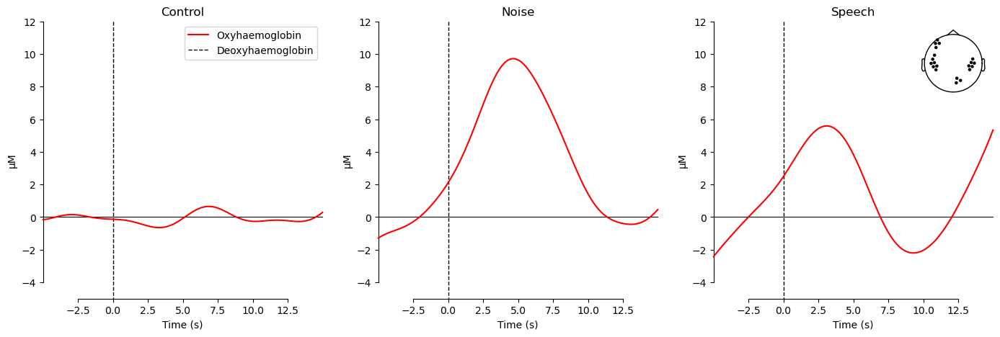

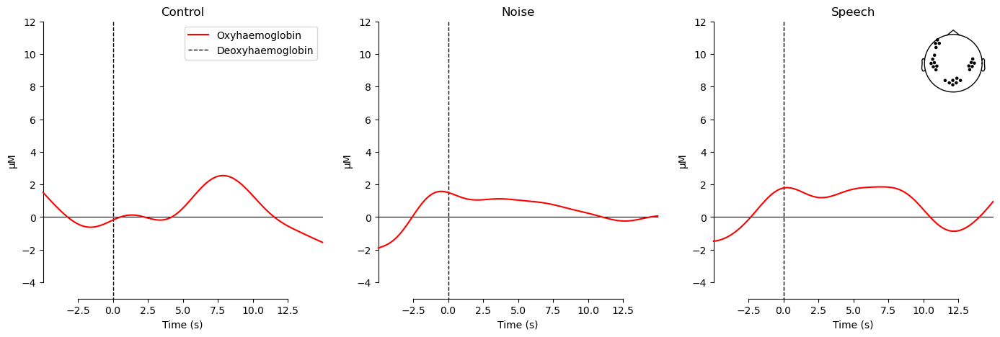

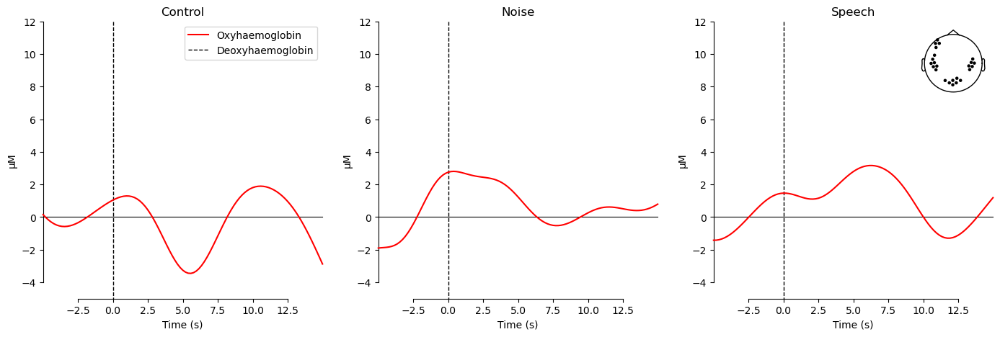

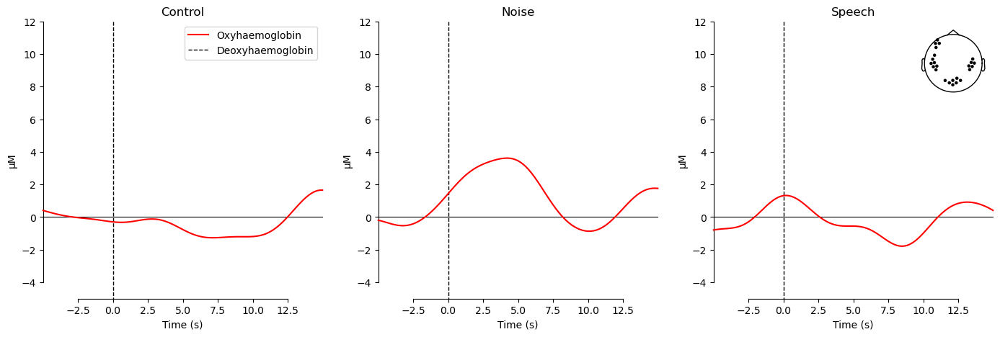

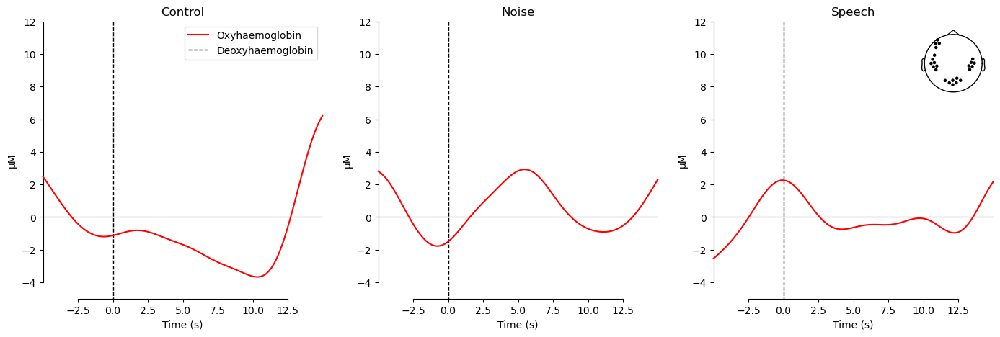

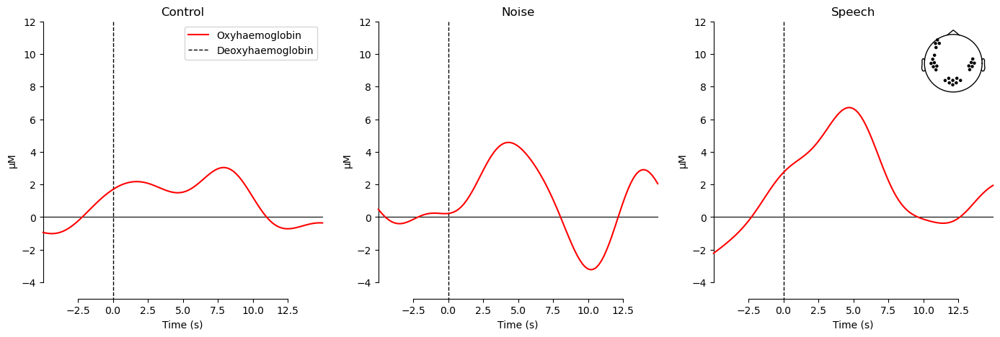

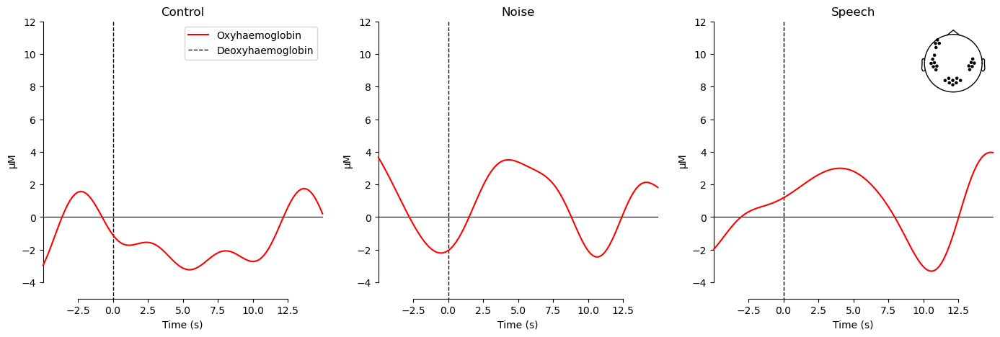

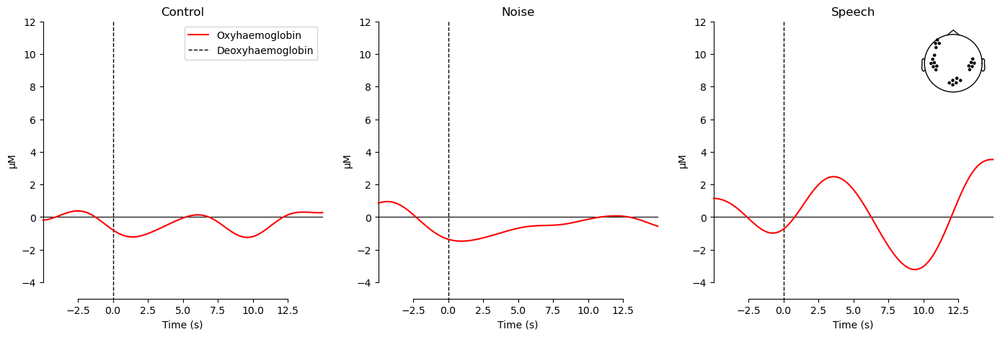

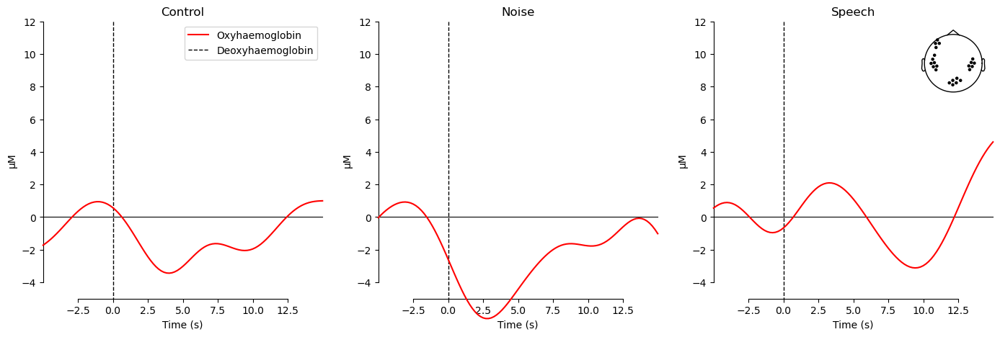

In [210]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds
from scipy.signal import find_peaks

# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)

bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
subject_list = subject_list[:5]  # Limit to first subject for now
print("Detected subjects:", subject_list)

# === Load global variance per condition ===
variance_df = pd.read_csv(os.path.join(output_root, "variance_per_condition.csv"))
variance_dict = {
    row['Condition']: row['Mean_Variance'] for _, row in variance_df.iterrows()
}

# === Define peak-based rejection ===
def detect_noisy_epochs_with_variance_and_peaks(data, indices, condition, variance_dict, multiplier=1.5, max_peaks_allowed=1, max_troughs_allowed=1, time_window=(26, 105)):
    noisy_epochs = []
    variance_threshold = variance_dict.get(condition, 0) * multiplier

    for local_idx, epoch_idx in enumerate(indices):
        epoch = data[epoch_idx, :, :]
        variances = np.var(epoch[:, time_window[0]:time_window[1]], axis=1)

        if np.any(variances > variance_threshold):
            signal_to_check = np.mean(epoch[:, time_window[0]:time_window[1]], axis=0)
            peaks, _ = find_peaks(signal_to_check)
            troughs, _ = find_peaks(-signal_to_check)
            if len(peaks) > max_peaks_allowed or len(troughs) > max_troughs_allowed:
                noisy_epochs.append(epoch_idx)

    return noisy_epochs

# === Start processing ===
for sub in subject_list:
    for ses in range(1, 2):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        labels = epochs.events[:, 2]

        condition_indices = {
            name: np.where(labels == code)[0]
            for name, code in event_dict.items()
        }

        rejected_all = []
        for cond, indices in condition_indices.items():
            rejected = detect_noisy_epochs_with_variance_and_peaks(data, indices, cond, variance_dict)
            print(f"Condition {cond}: {len(rejected)} epochs rejected")
            rejected_all.extend(rejected)

        rejected_all = sorted(set(rejected_all))
        print(f"Total epochs to reject due to peak detection: {len(rejected_all)}")

        epochs_cleaned = epochs.drop(rejected_all, reason='BAD_PEAKS')

        # === Plot evoked responses BEFORE cleaning ===
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        fig, axes = plt.subplots(1, len(indiv_evoked_before), figsize=(17, 5))
        lims = dict(hbo=[-5, 12])

        print(f"Participant {sub}, Session {ses:02d} (Before Cleaning)")

        for pick, color in zip(["hbo"], ["r"]):
            for idx, evoked in enumerate(indiv_evoked_before):
                plot_compare_evokeds(
                    {evoked: indiv_evoked_before[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
                )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        plt.savefig(os.path.join(output_dir, "evoked_before_cleaning.png"))

        # === Plot evoked responses AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        fig, axes = plt.subplots(1, len(indiv_evoked_after), figsize=(17, 5))
        lims = dict(hbo=[-5, 12])

        print(f"Participant {sub}, Session {ses:02d} (After Cleaning)")

        for pick, color in zip(["hbo"], ["r"]):
            for idx, evoked in enumerate(indiv_evoked_after):
                plot_compare_evokeds(
                    {evoked: indiv_evoked_after[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
                )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        plt.savefig(os.path.join(output_dir, "evoked_after_cleaning.png"))

print("\n✅ Done!")


### Variance rejection (as percentage of total variance/condition)

Detected subjects: ['01', '02', '03', '04', '05']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 59 epochs loaded
Condition Control: 10 epochs rejected
Condition Noise: 9 epochs rejected
Condition Speech: 6 epochs rejected
Total epochs to reject due to peak detection: 25
Participant 01, Session 01 (Before Cleaning)
Participant 01, Session 01 (After Cleaning)
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', '

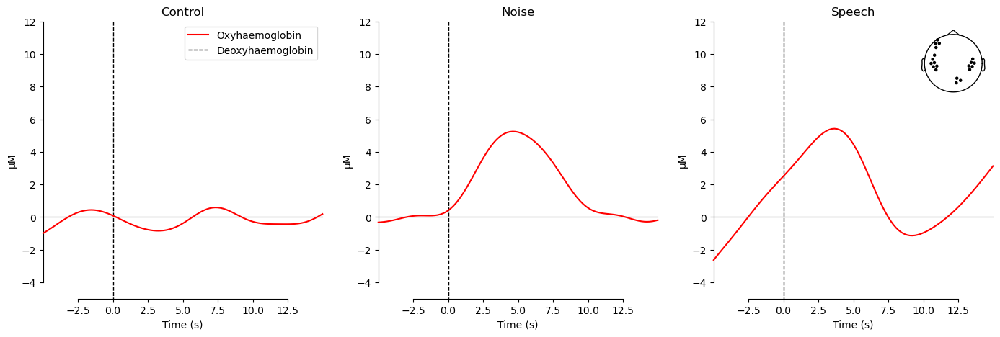

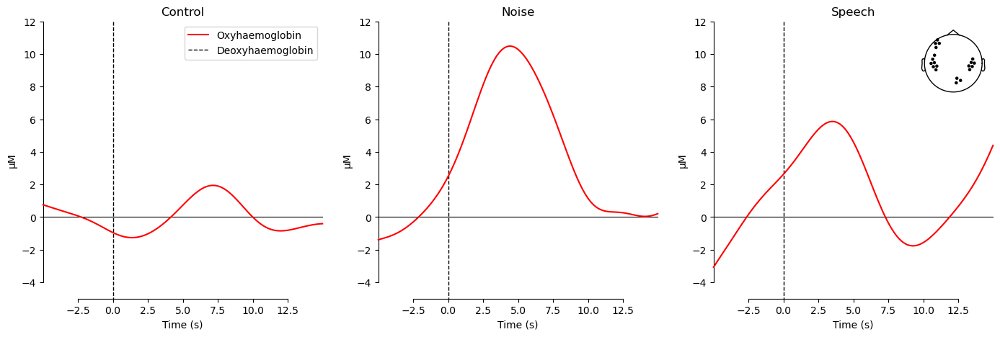

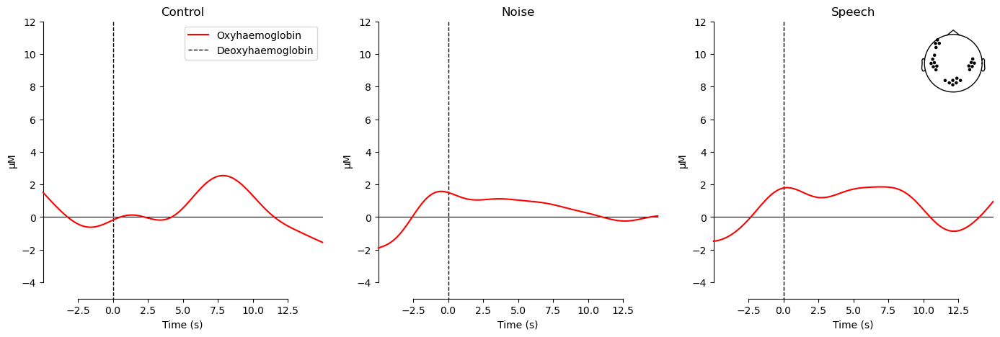

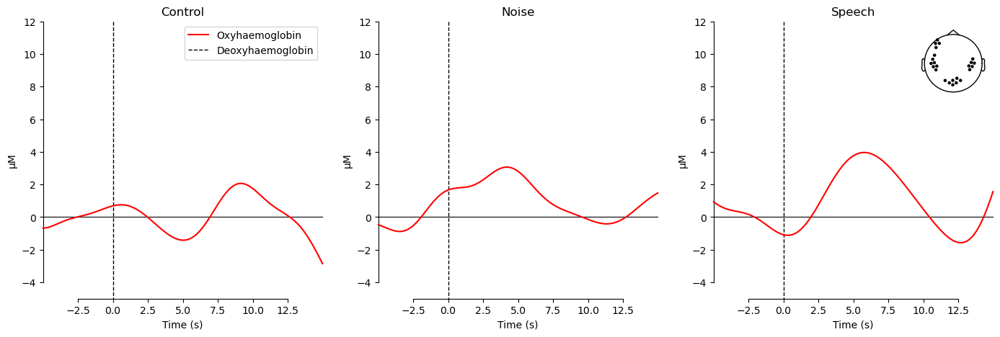

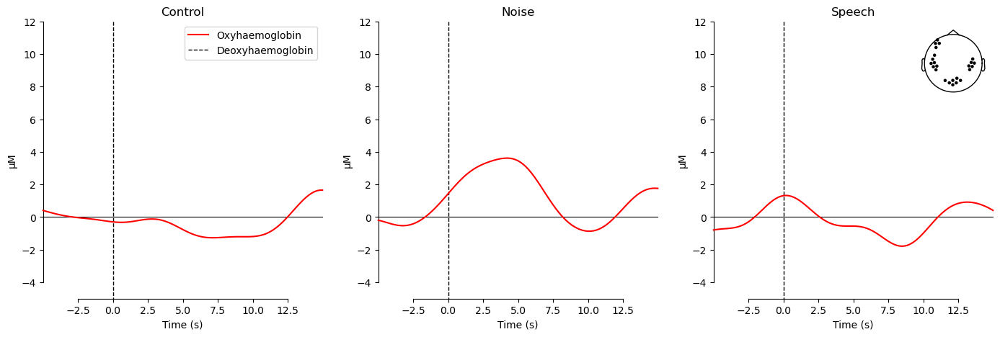

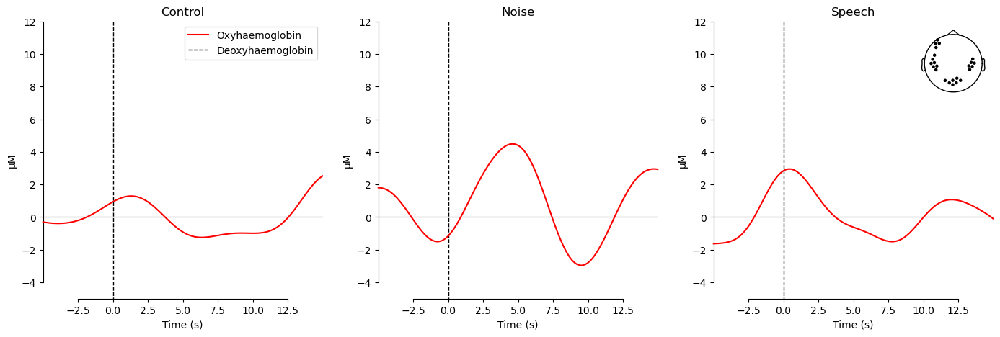

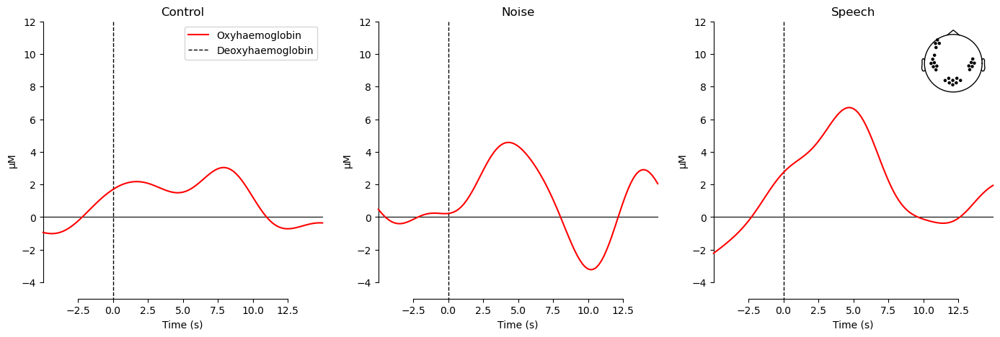

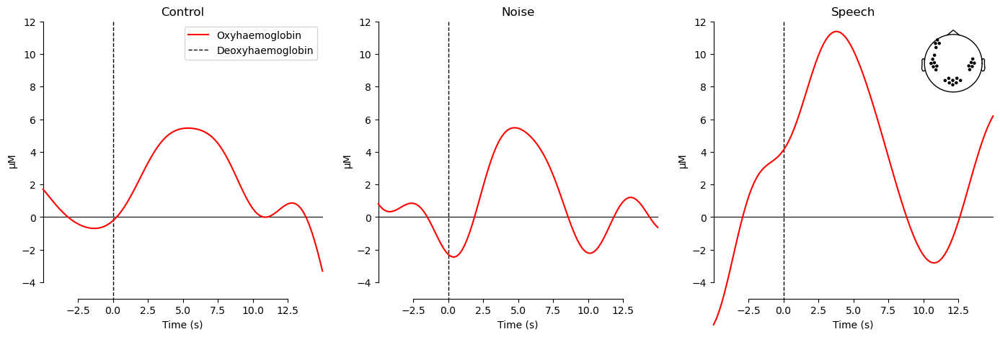

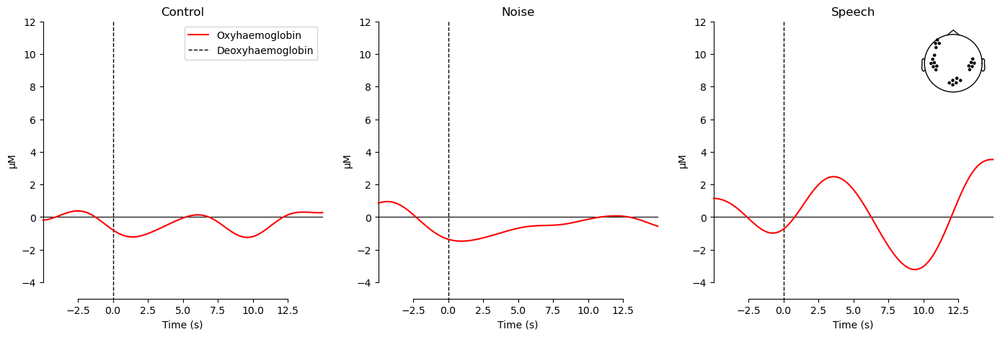

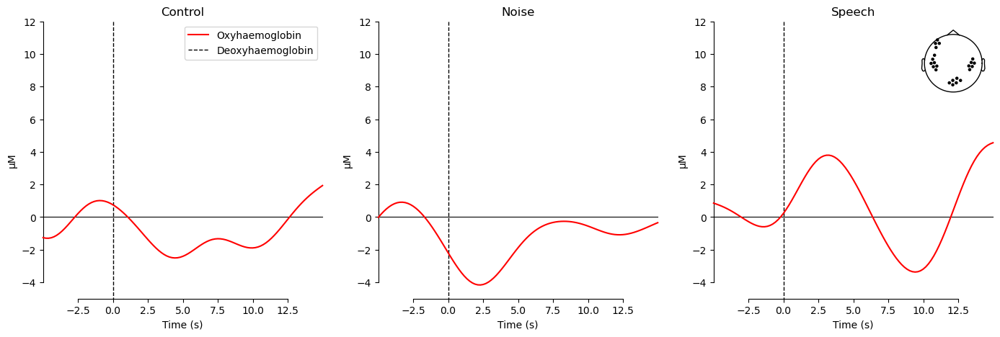

In [203]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds
from scipy.signal import find_peaks

# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)

bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
subject_list = subject_list[:5]  # Limit to first subject for now
print("Detected subjects:", subject_list)

# === Define peak-based rejection ===
def detect_noisy_epochs_with_variance_and_peaks(data, indices, variance_threshold=2e-11, max_peaks_allowed=1, max_troughs_allowed= 1,  time_window=(26, 90)):
    noisy_epochs = []

    for local_idx, epoch_idx in enumerate(indices):
        epoch = data[epoch_idx, :, :]
        variances = np.var(epoch[:, time_window[0]:time_window[1]], axis=1)
        #print(f"Epoch {epoch_idx} - Variances: {variances}")

        if np.any(variances > variance_threshold):
            signal_to_check = np.mean(epoch[:, time_window[0]:time_window[1]], axis=0)
            peaks, _ = find_peaks(signal_to_check)
            troughs, _ = find_peaks(-signal_to_check)
            if len(peaks) > max_peaks_allowed or len(troughs) > max_troughs_allowed:
                noisy_epochs.append(epoch_idx)

    return noisy_epochs

# === Start processing ===
for sub in subject_list:
    for ses in range(1, 2):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        labels = epochs.events[:, 2]

        condition_indices = {
            name: np.where(labels == code)[0]
            for name, code in event_dict.items()
        }

        rejected_all = []
        for cond, indices in condition_indices.items():
            rejected = detect_noisy_epochs_with_variance_and_peaks(data, indices)
            print(f"Condition {cond}: {len(rejected)} epochs rejected")
            rejected_all.extend(rejected)

        rejected_all = sorted(set(rejected_all))
        print(f"Total epochs to reject due to peak detection: {len(rejected_all)}")

        epochs_cleaned = epochs.drop(rejected_all, reason='BAD_PEAKS')

        # === Plot evoked responses BEFORE cleaning ===
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        fig, axes = plt.subplots(1, len(indiv_evoked_before), figsize=(17, 5))
        lims = dict(hbo=[-5, 12])

        print(f"Participant {sub}, Session {ses:02d} (Before Cleaning)")

        for pick, color in zip(["hbo"], ["r"]):
            for idx, evoked in enumerate(indiv_evoked_before):
                plot_compare_evokeds(
                    {evoked: indiv_evoked_before[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
                )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        plt.savefig(os.path.join(output_dir, "evoked_before_cleaning.png"))

        # === Plot evoked responses AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        fig, axes = plt.subplots(1, len(indiv_evoked_after), figsize=(17, 5))
        lims = dict(hbo=[-5, 12])

        print(f"Participant {sub}, Session {ses:02d} (After Cleaning)")

        for pick, color in zip(["hbo"], ["r"]):
            for idx, evoked in enumerate(indiv_evoked_after):
                plot_compare_evokeds(
                    {evoked: indiv_evoked_after[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
                )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        plt.savefig(os.path.join(output_dir, "evoked_after_cleaning.png"))

print("\n✅ Done!")


# LMME ANALYSIS

## ROI

In [5]:
def reject_epochs(max_data, min_data, condition_name, thresholds, threshold_factor = 2, max_reject_ratio=0.25):
            mean_max = thresholds[condition_name]["mean_max"]
            mean_min = thresholds[condition_name]["mean_min"]
            std_max = thresholds[condition_name]["std_max"]
            std_min = thresholds[condition_name]["std_min"]

            upper_bound_max = mean_max + (threshold_factor * std_max)
            lower_bound_min = mean_min - (threshold_factor * std_min)

            rejection_scores = []  # (epoch_idx, num_bad_channels, total_violation)

            for epoch_idx in range(max_data.shape[0]):
                epoch_max = max_data[epoch_idx, :]
                epoch_min = min_data[epoch_idx, :]

                bad_max = epoch_max > upper_bound_max
                bad_min = epoch_min < lower_bound_min
                bad_channels = bad_max | bad_min

                num_bad_channels = np.sum(bad_channels)

                if num_bad_channels > 0:
                    max_violation = np.sum(epoch_max[bad_max] - upper_bound_max)
                    min_violation = np.sum(lower_bound_min - epoch_min[bad_min])
                    total_violation = max_violation + min_violation

                    rejection_scores.append((epoch_idx, num_bad_channels, total_violation))

            # Sort by: 1) num_bad_channels DESC, 2) total_violation DESC
            sorted_scores = sorted(rejection_scores, key=lambda x: (-x[1], -x[2]))

            max_allowed_rejections = int(max_reject_ratio * max_data.shape[0])
            rejected_epochs = [idx for idx, _, _ in sorted_scores[:max_allowed_rejections]]

            # Remove rejected epochs
            cleaned_max = np.delete(max_data, rejected_epochs, axis=0)
            cleaned_min = np.delete(min_data, rejected_epochs, axis=0)

            # Logging
            """ for idx, chs, dev in sorted_scores[:max_allowed_rejections]:
                print(f"🚫 Rejecting Epoch {idx} in {condition_name} - {chs} bad channels, total deviation {dev:.2e}")
            """
            return cleaned_max, cleaned_min, rejected_epochs

In [36]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds
from copy import deepcopy



# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)



bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"


# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

#subject_list = subject_list[:1]  # Limit to first subject for now
print("Detected subjects:", subject_list)
id=0

all_data = pd.DataFrame()

# === Start processing ===
for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # --- Load your data ---
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Initial setup ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = epochs.events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        time_slice = data[:, :, 26:105]
        max_values = np.max(time_slice, axis=2)
        min_values = np.min(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        control_min = min_values[control_idx, :]
        noise_min = min_values[noise_idx, :]
        speech_min = min_values[speech_idx, :] 
        
        # IDEAL
        thresholds = {
                "Control": {"mean_max": 4.16e-6, "mean_min": -4.23e-6, "std_max": 2.51e-6, "std_min": 2.32e-6},
                "Noise": {"mean_max": 6.08e-6, "mean_min": -3.61e-6, "std_max": 2.55e-6, "std_min": 1.54-6},
                "Speech": {"mean_max": 7.16e-6, "mean_min": -3.88e-6, "std_max": 3.16e-6, "std_min": 1.5e-6},
            } 
        


        control_max_cleaned, control_min_cleaned, rejected_control = reject_epochs(
            control_max, control_min, "Control", thresholds
        )

        noise_max_cleaned, noise_min_cleaned, rejected_noise = reject_epochs(
            noise_max, noise_min, "Noise", thresholds
        )

        speech_max_cleaned, speech_min_cleaned, rejected_speech = reject_epochs(
            speech_max, speech_min, "Speech", thresholds
        )

        # Create new cleaned Epochs arrays
        epochs_cleaned = epochs_before_cleaning.copy()

        epochs_cleaned = epochs_cleaned.drop([idx for idx in rejected_control + rejected_noise + rejected_speech])
        
        
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        # === Plot AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        rois = {
            "Left_Auditory": ["S4_D2 hbo", "S4_D3 hbo", "S5_D2 hbo", "S5_D3 hbo", "S5_D4 hbo", "S5_D5 hbo"],
            "Right_Auditory": ["S10_D9 hbo", "S10_D10 hbo", "S10_D11 hbo", "S10_D12 hbo", "S11_D11 hbo", "S11_D12 hbo"],
            "Visual": ["S6_D6 hbo", "S6_D8 hbo", "S7_D6 hbo", "S7_D7 hbo","S8_D7 hbo", "S8_D8 hbo", "S9_D8 hbo", "S7_D8 hbo"],
            "Front": ["S1_D1 hbo", "S2_D1 hbo", "S3_D1 hbo", "S3_D2 hbo","S12_D1 hbo"],
        }
        
        

        df = pd.DataFrame(columns=["ID", "Subject", "Session", "ROI", "Chroma", "Condition", "Value"])

        id=id+1 
        
        for condition_name in ["Control", "Noise", "Speech"]:
            evoked = epochs_cleaned[condition_name].average()

            available_channels = evoked.info["ch_names"]

            for roi_name, optodes in rois.items():
                # Keep only optodes that exist in this subject/session
                valid_optodes = [ch for ch in optodes if ch in available_channels]
                
                if not valid_optodes:
                    print(f"⚠️ No valid optodes for ROI '{roi_name}' in Subject {sub}. Skipping this ROI.")
                    continue  # Skip if no optodes available

                for chroma in ["hbo"]:
                    try:
                        evoked_roi = deepcopy(evoked).pick(picks=valid_optodes).pick(chroma)
                        mean_val = evoked_roi.copy().crop(tmin=4, tmax=6.0).data.mean() * 1.0e6  # µM

                        df = pd.concat(
                            [
                                df,
                                pd.DataFrame(
                                    {
                                        "ID": [id],
                                        "Subject": [sub],
                                        "Session": f"{ses:02d}",
                                        "ROI": [roi_name],
                                        "Chroma": [chroma],
                                        "Condition": [condition_name],
                                        "Value": [mean_val],
                                    }
                                ),
                            ],
                            ignore_index=True,
                        )
                        
                    

                    except Exception as e:
                        print(f"❌ Failed to process ROI '{roi_name}' with error: {e}")
                    
        all_data = pd.concat([all_data, df], ignore_index=True)
                    
all_data.to_csv("all_subjects_cleaned_evoked_values.csv", index=False)

print("\n✅ Done!")

Detected subjects: ['01', '02', '03', '04', '05', '07', '08', '10', '11', '12', '13', '16', '17', '19', '21', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 8
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 01, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 02, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 02, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 03, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 03, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 04, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 04, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 05, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 05, Session 02: 56 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 10, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 10, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 11, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 8
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 11, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 12, Session 01: 59 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 12, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 13, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 13, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 4
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 4
✅ Number of good short channels: 12
Subject 16, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 16, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 17, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 6
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 17, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 19, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 4
✅ Number of good short channels: 12
Subject 19, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 21, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 6
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 21, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Number of all (good and bad) short channels: 16
Number of bad long channels: 12
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 24, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 24, Session 02: 60 epochs loaded

✅ Done!


C:\Users\sarab\AppData\Local\Temp\ipykernel_7560\2645847901.py:157: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


In [47]:
import statsmodels.formula.api as smf

# Example for hbo only — you can extend to hbr or ROI-wise
subset = all_data[all_data["Chroma"] == "hbo"]
#subset = subset.query("ROI == 'Left_Auditory'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())


            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    384       Method:               REML     
No. Groups:          32        Scale:                2.6954   
Min. group size:     12        Log-Likelihood:       -761.5361
Max. group size:     12        Converged:            Yes      
Mean group size:     12.0                                     
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.289    0.221 -1.309 0.191 -0.721  0.144
Condition[T.Noise]   1.635    0.205  7.969 0.000  1.233  2.038
Condition[T.Speech]  1.746    0.205  8.510 0.000  1.344  2.149
Group Var            0.884    0.179                           



### Left Auditory

In [46]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Left_Auditory'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())



            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                3.1988   
Min. group size:     3         Log-Likelihood:       -193.5544
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.626    0.325 -1.930 0.054 -1.263  0.010
Condition[T.Noise]   1.894    0.447  4.235 0.000  1.017  2.770
Condition[T.Speech]  1.584    0.447  3.542 0.000  0.708  2.460
Group Var            0.173    0.215                           



### Right Hemisphere

In [48]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Right_Auditory'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())

            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                3.5082   
Min. group size:     3         Log-Likelihood:       -202.3409
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.292    0.360 -0.811 0.417 -0.998  0.414
Condition[T.Noise]   2.255    0.468  4.816 0.000  1.338  3.173
Condition[T.Speech]  2.432    0.468  5.194 0.000  1.514  3.350
Group Var            0.646    0.302                           



### Visual

In [49]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Visual'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())

            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                3.4155   
Min. group size:     3         Log-Likelihood:       -200.2164
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.084    0.351 -0.240 0.810 -0.773  0.604
Condition[T.Noise]   1.332    0.462  2.883 0.004  0.426  2.238
Condition[T.Speech]  2.027    0.462  4.388 0.000  1.122  2.933
Group Var            0.532    0.281                           



### Front

In [50]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Front'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())

            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                2.0260   
Min. group size:     3         Log-Likelihood:       -176.2874
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.152    0.272 -0.559 0.576 -0.685  0.381
Condition[T.Noise]   1.060    0.356  2.980 0.003  0.363  1.758
Condition[T.Speech]  0.942    0.356  2.647 0.008  0.245  1.640
Group Var            0.338    0.222                           



## Single Optodes

In [18]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds
from copy import deepcopy



# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)



bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"


# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

#subject_list = subject_list[:1]  # Limit to first subject for now
print("Detected subjects:", subject_list)
id=0

all_data = pd.DataFrame()

# === Start processing ===
for sub in subject_list:
    for ses in range(1, 2):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # --- Load your data ---
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Initial setup ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = epochs.events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        time_slice = data[:, :, 26:105]
        max_values = np.max(time_slice, axis=2)
        min_values = np.min(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        control_min = min_values[control_idx, :]
        noise_min = min_values[noise_idx, :]
        speech_min = min_values[speech_idx, :] 
        
        # IDEAL
        thresholds = {
                "Control": {"mean_max": 4.16e-6, "mean_min": -4.23e-6, "std_max": 2.51e-6, "std_min": 2.32e-6},
                "Noise": {"mean_max": 6.08e-6, "mean_min": -3.61e-6, "std_max": 2.55e-6, "std_min": 1.54-6},
                "Speech": {"mean_max": 7.16e-6, "mean_min": -3.88e-6, "std_max": 3.16e-6, "std_min": 1.5e-6},
            } 
        


        control_max_cleaned, control_min_cleaned, rejected_control = reject_epochs(
            control_max, control_min, "Control", thresholds
        )

        noise_max_cleaned, noise_min_cleaned, rejected_noise = reject_epochs(
            noise_max, noise_min, "Noise", thresholds
        )

        speech_max_cleaned, speech_min_cleaned, rejected_speech = reject_epochs(
            speech_max, speech_min, "Speech", thresholds
        )

        # Create new cleaned Epochs arrays
        epochs_cleaned = epochs_before_cleaning.copy()

        epochs_cleaned = epochs_cleaned.drop([idx for idx in rejected_control + rejected_noise + rejected_speech])
        
        
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        # === Plot AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        rois = {
            "S4_D2": ["S4_D2 hbo"],
            "S4_D3": ["S4_D3 hbo"],
            "S5_D2": ["S5_D2 hbo"],
            "S5_D3": ["S5_D3 hbo"],
            "S5_D4": ["S5_D4 hbo"],
            "S5_D5": ["S5_D5 hbo"],
            "S10_D9": ["S10_D9 hbo"],
            "S10_D10": ["S10_D10 hbo"],
            "S10_D11": ["S10_D11 hbo"],
            "S10_D12": ["S10_D12 hbo"],
            "S11_D11": ["S11_D11 hbo"],
            "S11_D12": ["S11_D12 hbo"],
            "S6_D6": ["S6_D6 hbo"],
            "S6_D8": ["S6_D8 hbo"],
            "S7_D6": ["S7_D6 hbo"],
            "S7_D7": ["S7_D7 hbo"],
            "S8_D7": ["S8_D7 hbo"],
            "S8_D8": ["S8_D8 hbo"],
            "S9_D8": ["S9_D8 hbo"],
            "S7_D8": ["S7_D8 hbo"],
            "S1_D1": ["S1_D1 hbo"],
            "S2_D1": ["S2_D1 hbo"],
            "S3_D1": ["S3_D1 hbo"],
            "S3_D2": ["S3_D2 hbo"],
            "S12_D1": ["S12_D1 hbo"],
        }
        
        

        df = pd.DataFrame(columns=["ID", "Subject", "Session", "Optode", "Chroma", "Condition", "Value"])

        id=id+1 
        
        for condition_name in ["Control", "Noise", "Speech"]:
            evoked = epochs_cleaned[condition_name].average()

            available_channels = evoked.info["ch_names"]

            for roi_name, optodes in rois.items():
                # Keep only optodes that exist in this subject/session
                valid_optodes = [ch for ch in optodes if ch in available_channels]
                
                if not valid_optodes:
                    print(f"⚠️ No valid optodes for ROI '{roi_name}' in Subject {sub}. Skipping this ROI.")
                    continue  # Skip if no optodes available

                for chroma in ["hbo"]:
                    try:
                        evoked_roi = deepcopy(evoked).pick(picks=valid_optodes).pick(chroma)
                        mean_val = evoked_roi.copy().crop(tmin=4, tmax=6.0).data.mean() * 1.0e6  # µM

                        df = pd.concat(
                            [
                                df,
                                pd.DataFrame(
                                    {
                                        "ID": [id],
                                        "Subject": [sub],
                                        "Session": f"{ses:02d}",
                                        "Optode": [roi_name],
                                        "Chroma": [chroma],
                                        "Condition": [condition_name],
                                        "Value": [mean_val],
                                    }
                                ),
                            ],
                            ignore_index=True,
                        )
                        
                    

                    except Exception as e:
                        print(f"❌ Failed to process ROI '{roi_name}' with error: {e}")
                    
        all_data = pd.concat([all_data, df], ignore_index=True)
                    
all_data.to_csv("all_subjects_cleaned_evoked_values_Optodes_ses01.csv", index=False)

print("\n✅ Done!")

Detected subjects: ['01', '02', '03', '04', '05', '07', '08', '10', '11', '12', '13', '16', '17', '19', '21', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 60 epochs loaded
⚠️ No valid optodes for ROI 'S6_D6' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S6_D8' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S9_D8' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 01. Skipping

C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S6_D6' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S6_D8' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S9_D8' in Subject 01. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 01. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 02, Session 01: 60 epochs loaded
⚠️ No valid optodes for ROI 'S7_D6' in Subject 02. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 02. Skipping this ROI.


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S7_D6' in Subject 02. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 03, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S7_D6' in Subject 03. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 03. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 03. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 04, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 05, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S6_D6' in Subject 05. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 05. Skipping this ROI.
⚠️ No valid optodes for ROI 'S6_D6' in Subject 05. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 05. Skipping this ROI.
⚠️ No valid optodes for ROI 'S6_D6' in Subject 05. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 05. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 10, Session 01: 60 epochs loaded
⚠️ No valid optodes for ROI 'S6_D6' in Subject 10. Skipping this ROI.


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S6_D6' in Subject 10. Skipping this ROI.
⚠️ No valid optodes for ROI 'S6_D6' in Subject 10. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 11, Session 01: 60 epochs loaded
⚠️ No valid optodes for ROI 'S6_D6' in Subject 11. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D6' in Subject 11. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D7' in Subject 11. Skipping this ROI.
⚠️ No valid optodes for ROI 'S8_D7' in Subject 11. Skipping this ROI.
⚠️ N

C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S7_D6' in Subject 11. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D7' in Subject 11. Skipping this ROI.
⚠️ No valid optodes for ROI 'S8_D7' in Subject 11. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 11. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 12, Session 01: 59 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 13, Session 01: 60 epochs loaded
⚠️ No valid optodes for ROI 'S10_D12' in Subject 13. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 13. Skipping this ROI.


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S10_D12' in Subject 13. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 13. Skipping this ROI.
⚠️ No valid optodes for ROI 'S10_D12' in Subject 13. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 13. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 4
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 4
✅ Number of good short channels: 12
Subject 16, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 17, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S7_D8' in Subject 17. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 17. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 17. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 19, Session 01: 60 epochs loaded
⚠️ No valid optodes for ROI 'S7_D8' in Subject 19. Skipping this ROI.


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S7_D8' in Subject 19. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 19. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 21, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


⚠️ No valid optodes for ROI 'S7_D8' in Subject 21. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 21. Skipping this ROI.
⚠️ No valid optodes for ROI 'S7_D8' in Subject 21. Skipping this ROI.
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Number of all (good and bad) short channels: 16
Number of bad long channels: 12
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 24, Session 01: 60 epochs loaded
⚠️ No valid optodes for ROI 'S5_D3' in Subject 24. Skipping this ROI.
⚠️ No valid optodes for ROI 'S5_D5' in Subject 24. Skipping t

C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\3703112338.py:178: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


In [55]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("Optode == 'S4_D2'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())

            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                3.5500   
Min. group size:     3         Log-Likelihood:       -197.0799
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.514    0.337 -1.527 0.127 -1.174  0.146
Condition[T.Noise]   1.642    0.471  3.486 0.000  0.719  2.565
Condition[T.Speech]  1.119    0.471  2.375 0.018  0.196  2.042
Group Var            0.079    0.209                           



In [56]:
import statsmodels.formula.api as smf

# Ensure Optode column exists (remove ' hbo' from ROI if needed)

# Filter to only 'hbo' chroma
subset_all = all_data[all_data["Chroma"] == "hbo"]

# Get unique optodes
optodes = subset_all["Optode"].unique()

# Store results
lme_results = {}

# Loop through each optode and run LME
for opt in optodes:
    subset = subset_all[subset_all["Optode"] == opt]
    if subset["Condition"].nunique() < 2 or subset["ID"].nunique() < 2:
        print(f"Skipping {opt} due to insufficient data.")
        continue
    try:
        model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
        result = model.fit()
        lme_results[opt] = result
        print(f"\n=== {opt} ===")
        print(result.summary())
    except Exception as e:
        print(f"⚠️ Failed to fit model for {opt}: {e}")



=== S4_D2 ===
            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                3.5500   
Min. group size:     3         Log-Likelihood:       -197.0799
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.514    0.337 -1.527 0.127 -1.174  0.146
Condition[T.Noise]   1.642    0.471  3.486 0.000  0.719  2.565
Condition[T.Speech]  1.119    0.471  2.375 0.018  0.196  2.042
Group Var            0.079    0.209                           


=== S4_D3 ===
            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:

c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



=== S5_D4 ===
            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    93        Method:               REML     
No. Groups:          31        Scale:                5.9536   
Min. group size:     3         Log-Likelihood:       -213.1352
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.395    0.438 -0.901 0.367 -1.254  0.464
Condition[T.Noise]   1.704    0.620  2.749 0.006  0.489  2.918
Condition[T.Speech]  2.776    0.620  4.478 0.000  1.561  3.990
Group Var            0.000    0.259                           


=== S5_D5 ===
            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:

c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)



=== S6_D8 ===
            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    90        Method:               REML     
No. Groups:          30        Scale:                3.1178   
Min. group size:     3         Log-Likelihood:       -178.0139
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.485    0.322 -1.504 0.133 -1.117  0.147
Condition[T.Noise]   1.675    0.456  3.675 0.000  0.782  2.569
Condition[T.Speech]  1.283    0.456  2.814 0.005  0.390  2.177
Group Var            0.000    0.213                           


=== S9_D8 ===
           Mixed Linear Model Regression Results
Model:               MixedLM  Dependent Variable:  

c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [19]:
import pandas as pd
import statsmodels.formula.api as smf

# Ensure Optode column exists (remove ' hbo' from ROI if needed)
subset_all = all_data[all_data["Chroma"] == "hbo"]
optodes = subset_all["Optode"].unique()

# Collect results
results_summary = []

for opt in optodes:
    subset = subset_all[subset_all["Optode"] == opt]
    if subset["Condition"].nunique() < 2 or subset["ID"].nunique() < 2:
        print(f"Skipping {opt} due to insufficient data.")
        continue
    try:
        model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
        result = model.fit()
        print(f"\n=== {opt} ===")
        print(result.summary())

        # Extract key info
        coef = result.params.get("Condition[T.Speech]", float('nan'))
        pval = result.pvalues.get("Condition[T.Speech]", float('nan'))
        
        coef_n = result.params.get("Condition[T.Noise]", float('nan'))
        pval_n = result.pvalues.get("Condition[T.Noise]", float('nan'))
        conv = result.converged

        results_summary.append({
            "Optode": opt,
            "Coef_Condition[T.Noise]": coef_n,
            "PValue_Condition[T.Noise]": pval_n,
            "Coef_Condition[T.Speech]": coef,
            "PValue_Condition[T.Speech]": pval,
            "N_Subjects": subset["ID"].nunique(),
            "N_Trials": len(subset),
            "Convergence":conv
            
        })

    except Exception as e:
        print(f"⚠️ Failed to fit model for {opt}: {e}")

# Save summary to CSV
summary_df = pd.DataFrame(results_summary)
summary_df.to_csv("lme_optode_results_ses01.csv", index=False)
print("\n✅ All results saved to lme_optode_results.csv")



=== S4_D2 ===
           Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Value   
No. Observations:   48        Method:               REML    
No. Groups:         16        Scale:                1.9105  
Min. group size:    3         Log-Likelihood:       -89.0912
Max. group size:    3         Converged:            Yes     
Mean group size:    3.0                                     
------------------------------------------------------------
                    Coef. Std.Err.   z   P>|z| [0.025 0.975]
------------------------------------------------------------
Intercept           0.047    0.418 0.112 0.911 -0.772  0.865
Condition[T.Noise]  1.039    0.489 2.126 0.033  0.081  1.997
Condition[T.Speech] 0.516    0.489 1.056 0.291 -0.442  1.474
Group Var           0.881    0.491                          


=== S4_D3 ===
            Mixed Linear Model Regression Results
Model:                MixedLM   Dependent Variable:   Value   
No. Observatio

c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(



=== S6_D8 ===
            Mixed Linear Model Regression Results
Model:                MixedLM   Dependent Variable:   Value   
No. Observations:     45        Method:               REML    
No. Groups:           15        Scale:                2.3375  
Min. group size:      3         Log-Likelihood:       -81.5317
Max. group size:      3         Converged:            No      
Mean group size:      3.0                                     
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.317    0.395 -0.802 0.423 -1.091  0.458
Condition[T.Noise]   1.076    0.558  1.927 0.054 -0.018  2.170
Condition[T.Speech]  1.531    0.558  2.743 0.006  0.437  2.626
Group Var            0.005    0.364                           


=== S9_D8 ===
           Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:  

c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = 0.510134
  warnings.warn(msg, ConvergenceWarning)
c:\Users\sarab\anaconda3\envs\mne\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


# DATA-DRIVEN ROI

In [80]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
from mne_bids import BIDSPath
from mne import EpochsArray
from mne.viz import plot_compare_evokeds
from copy import deepcopy


def reject_epochs(max_data, min_data, condition_name, thresholds, threshold_factor = 2, max_reject_ratio=0.25):
            mean_max = thresholds[condition_name]["mean_max"]
            mean_min = thresholds[condition_name]["mean_min"]
            std_max = thresholds[condition_name]["std_max"]
            std_min = thresholds[condition_name]["std_min"]

            upper_bound_max = mean_max + (threshold_factor * std_max)
            lower_bound_min = mean_min - (threshold_factor * std_min)

            rejection_scores = []  # (epoch_idx, num_bad_channels, total_violation)

            for epoch_idx in range(max_data.shape[0]):
                epoch_max = max_data[epoch_idx, :]
                epoch_min = min_data[epoch_idx, :]

                bad_max = epoch_max > upper_bound_max
                bad_min = epoch_min < lower_bound_min
                bad_channels = bad_max | bad_min

                num_bad_channels = np.sum(bad_channels)

                if num_bad_channels > 0:
                    max_violation = np.sum(epoch_max[bad_max] - upper_bound_max)
                    min_violation = np.sum(lower_bound_min - epoch_min[bad_min])
                    total_violation = max_violation + min_violation

                    rejection_scores.append((epoch_idx, num_bad_channels, total_violation))

            # Sort by: 1) num_bad_channels DESC, 2) total_violation DESC
            sorted_scores = sorted(rejection_scores, key=lambda x: (-x[1], -x[2]))

            max_allowed_rejections = int(max_reject_ratio * max_data.shape[0])
            rejected_epochs = [idx for idx, _, _ in sorted_scores[:max_allowed_rejections]]

            # Remove rejected epochs
            cleaned_max = np.delete(max_data, rejected_epochs, axis=0)
            cleaned_min = np.delete(min_data, rejected_epochs, axis=0)

            # Logging
            """ for idx, chs, dev in sorted_scores[:max_allowed_rejections]:
                print(f"🚫 Rejecting Epoch {idx} in {condition_name} - {chs} bad channels, total deviation {dev:.2e}")
            """
            return cleaned_max, cleaned_min, rejected_epochs


# === Setup ===
output_root = "individual_analysis_outputs"
os.makedirs(output_root, exist_ok=True)



bids_root = r"C:\\Datasets\\Test-retest study\\bids_dataset"


# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

#subject_list = subject_list[:1]  # Limit to first subject for now
print("Detected subjects:", subject_list)
id=0

all_data = pd.DataFrame()

# === Start processing ===
for sub in subject_list:
    for ses in range(1, 3):
        bids_path = BIDSPath(
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # --- Load your data ---
        raw_haemo, epochs, event_dict, raw_od, events = individual_analysis(bids_path)

        if raw_haemo is None:
            print(f"⚠️ Not enough channels for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs loaded")

        if len(epochs) < 10:
            print(f"⚠️ Not enough epochs for Subject {sub}, Session {ses:02d}. Skipping...")
            continue

        output_dir = os.path.join(output_root, f"sub-{sub}", f"ses-{ses:02d}")
        os.makedirs(output_dir, exist_ok=True)

        # === Initial setup ===
        bad_ch = epochs.info['bads']
        epochs.drop_channels(bad_ch)
        epochs_before_cleaning = epochs.copy()

        hbo_data = epochs.copy().pick("hbo")
        data = hbo_data.get_data()
        info = hbo_data.info.copy()
        ev = epochs.events[:, 2]
        index_column = np.arange(0, len(ev)).reshape(-1, 1)
        updated_matrix = np.hstack((index_column, ev.reshape(-1, 1)))

        time_slice = data[:, :, 26:105]
        max_values = np.max(time_slice, axis=2)
        min_values = np.min(time_slice, axis=2)

        control_idx = updated_matrix[updated_matrix[:, 1] == 1][:, 0]
        noise_idx = updated_matrix[updated_matrix[:, 1] == 2][:, 0]
        speech_idx = updated_matrix[updated_matrix[:, 1] == 3][:, 0]

        control_max = max_values[control_idx, :]
        noise_max = max_values[noise_idx, :]
        speech_max = max_values[speech_idx, :]

        control_min = min_values[control_idx, :]
        noise_min = min_values[noise_idx, :]
        speech_min = min_values[speech_idx, :] 
        
        # IDEAL
        thresholds = {
                "Control": {"mean_max": 4.16e-6, "mean_min": -4.23e-6, "std_max": 2.51e-6, "std_min": 2.32e-6},
                "Noise": {"mean_max": 6.08e-6, "mean_min": -3.61e-6, "std_max": 2.55e-6, "std_min": 1.54-6},
                "Speech": {"mean_max": 7.16e-6, "mean_min": -3.88e-6, "std_max": 3.16e-6, "std_min": 1.5e-6},
            } 
        


        control_max_cleaned, control_min_cleaned, rejected_control = reject_epochs(
            control_max, control_min, "Control", thresholds
        )

        noise_max_cleaned, noise_min_cleaned, rejected_noise = reject_epochs(
            noise_max, noise_min, "Noise", thresholds
        )

        speech_max_cleaned, speech_min_cleaned, rejected_speech = reject_epochs(
            speech_max, speech_min, "Speech", thresholds
        )

        # Create new cleaned Epochs arrays
        epochs_cleaned = epochs_before_cleaning.copy()

        epochs_cleaned = epochs_cleaned.drop([idx for idx in rejected_control + rejected_noise + rejected_speech])
        
        
        indiv_evoked_before = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_before[condition] = epochs_before_cleaning[condition].average()

        # === Plot AFTER cleaning ===
        indiv_evoked_after = defaultdict(list)
        for condition in event_dict:
            indiv_evoked_after[condition] = epochs_cleaned[condition].average()

        rois = {
            "Noise_ROI": [ "S10_D11 hbo","S5_D3 hbo", "S11_D11 hbo","S10_D9 hbo", "S10_D12 hbo", "S10_D10 hbo" ],
            "Speech_ROI": ["S10_D11 hbo", "S10_D10 hbo",  "S10_D12 hbo", "S11_D12 hbo","S1_D1 hbo","S10_D9 hbo","S8_D7 hbo","S7_D7 hbo", "S8_D8 hbo"],
            "Common_ROI": [ "S10_D11 hbo","S10_D9 hbo", "S10_D12 hbo", "S10_D10 hbo" ],
            "Only_Noise_ROI": ["S5_D3 hbo", "S11_D11 hbo"],
            "Only_Speech_ROI": [ "S11_D12 hbo","S1_D1 hbo""S8_D7 hbo","S7_D7 hbo", "S8_D8 hbo"],
            "Left_Auditory": ["S4_D2 hbo", "S4_D3 hbo", "S5_D2 hbo", "S5_D3 hbo", "S5_D4 hbo", "S5_D5 hbo"],
            "Right_Auditory": ["S10_D9 hbo", "S10_D10 hbo", "S10_D11 hbo", "S10_D12 hbo", "S11_D11 hbo", "S11_D12 hbo"],
            "Visual": ["S6_D6 hbo", "S6_D8 hbo", "S7_D6 hbo", "S7_D7 hbo","S8_D7 hbo", "S8_D8 hbo", "S9_D8 hbo", "S7_D8 hbo"],
            "Front": ["S1_D1 hbo", "S2_D1 hbo", "S3_D1 hbo", "S3_D2 hbo","S12_D1 hbo"],
            
        }
        
        
        
        

        df = pd.DataFrame(columns=["ID", "Subject", "Session", "ROI", "Chroma", "Condition", "Value"])

        id=id+1 
        
        for condition_name in ["Control", "Noise", "Speech"]:
            evoked = epochs_cleaned[condition_name].average()

            available_channels = evoked.info["ch_names"]

            for roi_name, optodes in rois.items():
                # Keep only optodes that exist in this subject/session
                valid_optodes = [ch for ch in optodes if ch in available_channels]
                
                if not valid_optodes:
                    print(f"⚠️ No valid optodes for ROI '{roi_name}' in Subject {sub}. Skipping this ROI.")
                    continue  # Skip if no optodes available

                for chroma in ["hbo"]:
                    try:
                        evoked_roi = deepcopy(evoked).pick(picks=valid_optodes).pick(chroma)
                        mean_val = evoked_roi.copy().crop(tmin=4, tmax=6.0).data.mean() * 1.0e6  # µM

                        df = pd.concat(
                            [
                                df,
                                pd.DataFrame(
                                    {
                                        "ID": [id],
                                        "Subject": [sub],
                                        "Session": f"{ses:02d}",
                                        "ROI": [roi_name],
                                        "Chroma": [chroma],
                                        "Condition": [condition_name],
                                        "Value": [mean_val],
                                    }
                                ),
                            ],
                            ignore_index=True,
                        )
                        
                    

                    except Exception as e:
                        print(f"❌ Failed to process ROI '{roi_name}' with error: {e}")
                    
        all_data = pd.concat([all_data, df], ignore_index=True)
                    
all_data.to_csv("all_subjects_old_vs_new_ROIs.csv", index=False)

print("\n✅ Done!")

Detected subjects: ['01', '02', '03', '04', '05', '07', '08', '10', '11', '12', '13', '16', '17', '19', '21', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 01, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Number of all (good and bad) short channels: 16
Number of bad long channels: 8
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 01, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 02, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 02, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 03, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 03, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 04, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 04, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 05, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 05, Session 02: 56 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 07, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 08, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 10, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 10, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 11, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 8
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 11, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 12, Session 01: 59 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 12, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 13, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 13, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 4
Number of all (good and bad) short channels: 16
Number of bad long channels: 0
Number of bad short channels: 4
✅ Number of good short channels: 12
Subject 16, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 4
Number of bad short channels: 8
✅ Number of good short channels: 8
Subject 16, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 17, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 6
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 17, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 6
✅ Number of good short channels: 10
Subject 19, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 4
✅ Number of good short channels: 12
Subject 19, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Number of all (good and bad) short channels: 16
Number of bad long channels: 2
Number of bad short channels: 10
✅ Number of good short channels: 6
Subject 21, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Number of all (good and bad) short channels: 16
Number of bad long channels: 6
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 21, Session 02: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Number of all (good and bad) short channels: 16
Number of bad long channels: 12
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 24, Session 01: 60 epochs loaded


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Number of all (good and bad) short channels: 16
Number of bad long channels: 10
Number of bad short channels: 12
✅ Number of good short channels: 4
Subject 24, Session 02: 60 epochs loaded

✅ Done!


C:\Users\sarab\AppData\Local\Temp\ipykernel_36244\1786119523.py:209: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat(


## Noise ROI

In [28]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Noise_ROI'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())



            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                3.7681   
Min. group size:     3         Log-Likelihood:       -204.7528
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.386    0.369 -1.048 0.295 -1.109  0.336
Condition[T.Noise]   2.341    0.485  4.825 0.000  1.390  3.292
Condition[T.Speech]  2.401    0.485  4.949 0.000  1.450  3.353
Group Var            0.583    0.295                           



In [56]:
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Noise_ROI")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())


                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     3.4395   
Min. group size:         6              Log-Likelihood:            -198.9769
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          0.078    0.524  0.149 0.881 -0.949  1.106
Condition[T.Noise]                 1.749    0.656  2.667 0.008  0.463  3.034
Condition[T.Speech]                2.152    0.656  3.283 0.001  0.867  3.438
Session[T.02]      

## Speech ROI

In [29]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Speech_ROI'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())



            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                3.6233   
Min. group size:     3         Log-Likelihood:       -202.4431
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.186    0.359 -0.518 0.605 -0.890  0.518
Condition[T.Noise]   1.966    0.476  4.132 0.000  1.034  2.899
Condition[T.Speech]  2.585    0.476  5.432 0.000  1.652  3.517
Group Var            0.506    0.280                           



In [60]:
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Speech_ROI")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())



                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     3.4485   
Min. group size:         6              Log-Likelihood:            -197.5762
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          0.396    0.508  0.780 0.435 -0.599  1.392
Condition[T.Noise]                 1.182    0.657  1.801 0.072 -0.105  2.469
Condition[T.Speech]                2.115    0.657  3.222 0.001  0.828  3.402
Session[T.02]      

## Common ROI

In [30]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Common_ROI'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())



            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                4.9654   
Min. group size:     3         Log-Likelihood:       -215.9338
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.416    0.414 -1.005 0.315 -1.228  0.395
Condition[T.Noise]   2.571    0.557  4.615 0.000  1.479  3.663
Condition[T.Speech]  2.903    0.557  5.212 0.000  1.811  3.995
Group Var            0.523    0.304                           



In [52]:
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Common_ROI")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session+ Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())


                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     4.6497   
Min. group size:         6              Log-Likelihood:            -210.7987
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          0.194    0.587  0.331 0.741 -0.957  1.345
Condition[T.Noise]                 1.822    0.762  2.390 0.017  0.328  3.316
Condition[T.Speech]                2.518    0.762  3.302 0.001  1.023  4.012
Session[T.02]      

## Only Noise ROI

In [31]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Only_Noise_ROI'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())



            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                2.9920   
Min. group size:     3         Log-Likelihood:       -201.1921
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.278    0.367 -0.757 0.449 -0.998  0.441
Condition[T.Noise]   1.884    0.432  4.357 0.000  1.037  2.732
Condition[T.Speech]  1.465    0.432  3.387 0.001  0.617  2.312
Group Var            1.320    0.417                           



In [47]:
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Only_Noise_ROI")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())


                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     2.8878   
Min. group size:         6              Log-Likelihood:            -194.4900
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                         -0.072    0.526 -0.136 0.892 -1.102  0.959
Condition[T.Noise]                 1.602    0.601  2.666 0.008  0.424  2.779
Condition[T.Speech]                1.468    0.601  2.443 0.015  0.290  2.646
Session[T.02]      

## Only Speech ROI

In [50]:
subset = all_data[all_data["Chroma"] == "hbo"]
subset = subset.query("ROI == 'Only_Speech_ROI'")


# Fit LME model
model = smf.mixedlm("Value ~ Condition", subset, groups=subset["ID"])
result = model.fit()
print(result.summary())



            Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   Value    
No. Observations:    96        Method:               REML     
No. Groups:          32        Scale:                2.4209   
Min. group size:     3         Log-Likelihood:       -189.5884
Max. group size:     3         Converged:            Yes      
Mean group size:     3.0                                      
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept           -0.010    0.321 -0.030 0.976 -0.638  0.619
Condition[T.Noise]   1.436    0.389  3.692 0.000  0.674  2.198
Condition[T.Speech]  1.951    0.389  5.015 0.000  1.188  2.713
Group Var            0.868    0.335                           



In [51]:

# Filter to subset
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Only_Speech_ROI")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())


                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     2.4979   
Min. group size:         6              Log-Likelihood:            -184.7796
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          0.577    0.449  1.285 0.199 -0.303  1.456
Condition[T.Noise]                 0.543    0.559  0.972 0.331 -0.552  1.639
Condition[T.Speech]                1.602    0.559  2.866 0.004  0.506  2.697
Session[T.02]      

## Left Auditory pre-ROI

In [81]:

# Filter to subset
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Left_Auditory")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())


                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     2.8261   
Min. group size:         6              Log-Likelihood:            -188.5562
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                         -0.115    0.459 -0.251 0.802 -1.015  0.785
Condition[T.Noise]                 1.336    0.594  2.247 0.025  0.171  2.500
Condition[T.Speech]                1.288    0.594  2.168 0.030  0.124  2.453
Session[T.02]      

## Right Auditory pre-ROI

In [82]:

# Filter to subset
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Right_Auditory")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())


                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     3.1961   
Min. group size:         6              Log-Likelihood:            -196.2521
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          0.159    0.512  0.311 0.756 -0.845  1.164
Condition[T.Noise]                 1.610    0.632  2.547 0.011  0.371  2.848
Condition[T.Speech]                2.125    0.632  3.362 0.001  0.886  3.364
Session[T.02]      

## Visual pre-ROI

In [99]:

# Filter to subset
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Visual")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit(method="powell")
print(result.summary())





                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     3.5332   
Min. group size:         6              Log-Likelihood:            -196.8442
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          0.336    0.497  0.677 0.499 -0.638  1.310
Condition[T.Noise]                 0.747    0.665  1.123 0.261 -0.556  2.049
Condition[T.Speech]                2.000    0.665  3.009 0.003  0.697  3.302
Session[T.02]      

## Front pre-ROI

In [97]:

# Filter to subset
subset = all_data[(all_data["Chroma"] == "hbo") & (all_data["ROI"] == "Front")].copy()

# Ensure categorical variables
subset["Condition"] = subset["Condition"].astype("category")
subset["Session"] = subset["Session"].astype("category")

# Fit mixed model: Condition + Session as fixed, ID as random intercept
model = smf.mixedlm("Value ~ Condition + Session + Condition*Session", subset, groups=subset["Subject"])
result = model.fit()
print(result.summary())


                   Mixed Linear Model Regression Results
Model:                   MixedLM        Dependent Variable:        Value    
No. Observations:        96             Method:                    REML     
No. Groups:              16             Scale:                     1.6911   
Min. group size:         6              Log-Likelihood:            -168.2422
Max. group size:         6              Converged:                 Yes      
Mean group size:         6.0                                                
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          0.474    0.379  1.251 0.211 -0.269  1.216
Condition[T.Noise]                 0.268    0.460  0.582 0.561 -0.634  1.169
Condition[T.Speech]                0.340    0.460  0.739 0.460 -0.561  1.241
Session[T.02]      

## Plotting Mean/Session

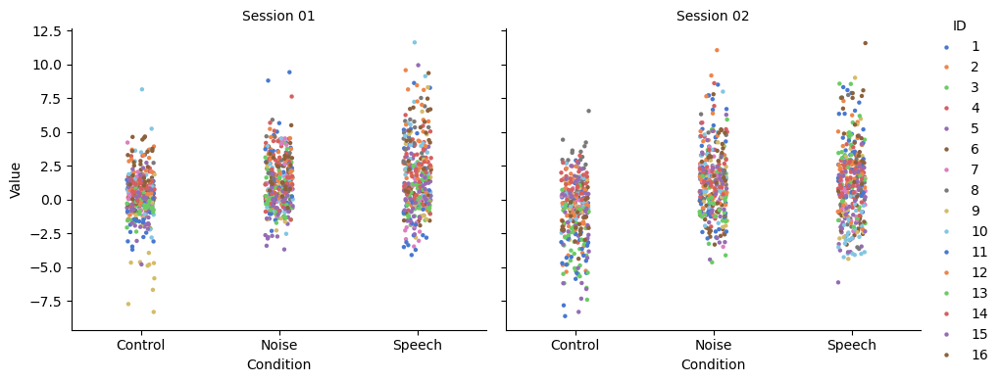

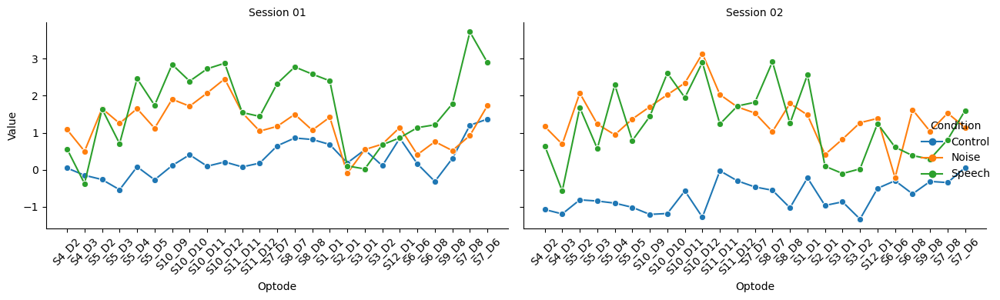

In [96]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Read CSVs
df_ses01 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses01.csv")
df_ses02 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses02.csv")

# Add session labels
df_ses01["Session"] = "01"
df_ses02["Session"] = "02"

# Combine into one DataFrame
df_combined = pd.concat([df_ses01, df_ses02], ignore_index=True)

# Filter for hbo only
df_combined = df_combined.query("Chroma == 'hbo'")

# Plot using catplot with col for session
g = sns.catplot(
    x="Condition",
    y="Value",
    hue="ID",
    data=df_combined,
    errorbar=None,
    palette="muted",
    height=4,
    aspect=1.2,
    s=10,
    col="Session"
)

g.set_titles("Session {col_name}")
plt.show()

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Read and label
df_ses01 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses01.csv")
df_ses02 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses02.csv")
df_ses01["Session"] = "01"
df_ses02["Session"] = "02"

# Combine & filter
df = pd.concat([df_ses01, df_ses02])
df = df.query("Chroma == 'hbo'")

# Create lineplot
g = sns.relplot(
    data=df,
    kind="line",
    x="Optode",  # Or use "ROI" if that's better
    y="Value",
    hue="Condition",
    col="Session",
    #ci="sd",
    marker="o",
    height=4,
    aspect=1.5,
    errorbar=None,
)

g.set_titles("Session {col_name}")
g.set_xticklabels(rotation=45)
plt.tight_layout()
plt.show()


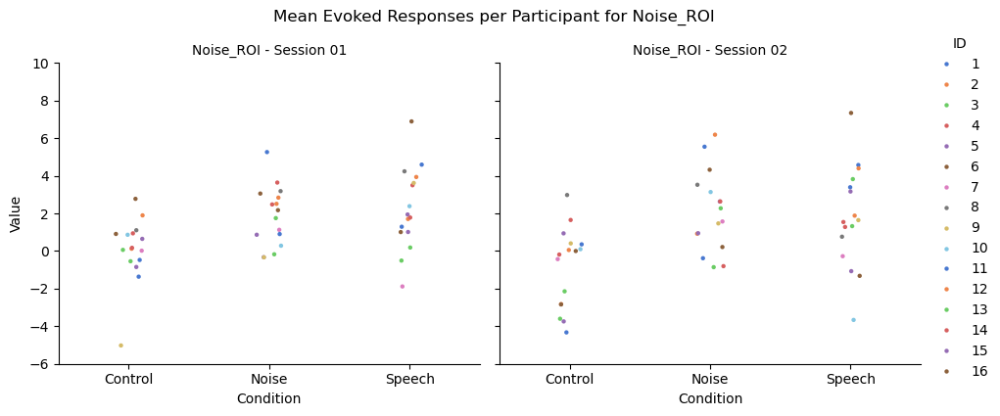

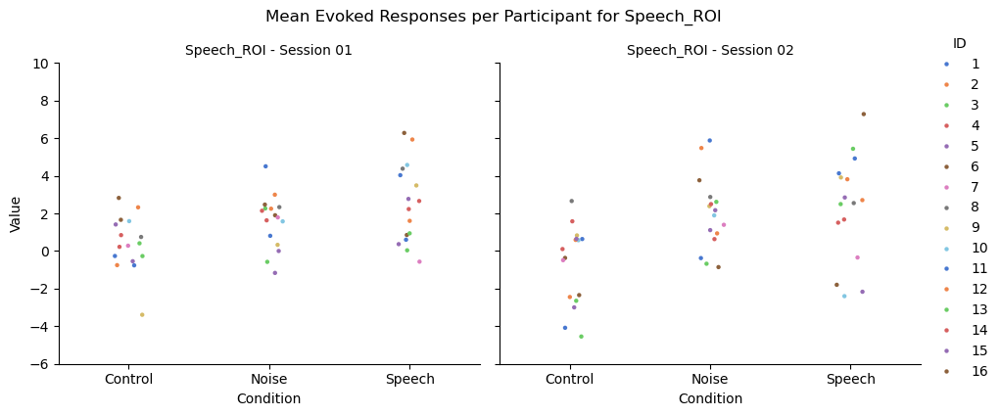

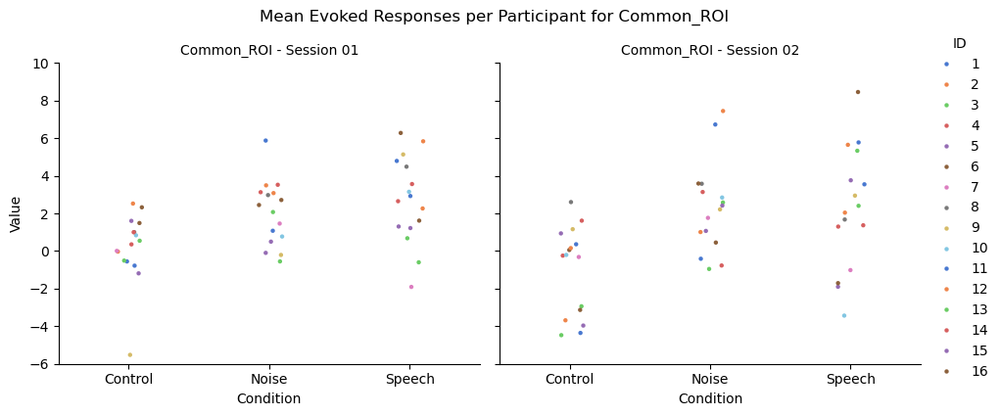

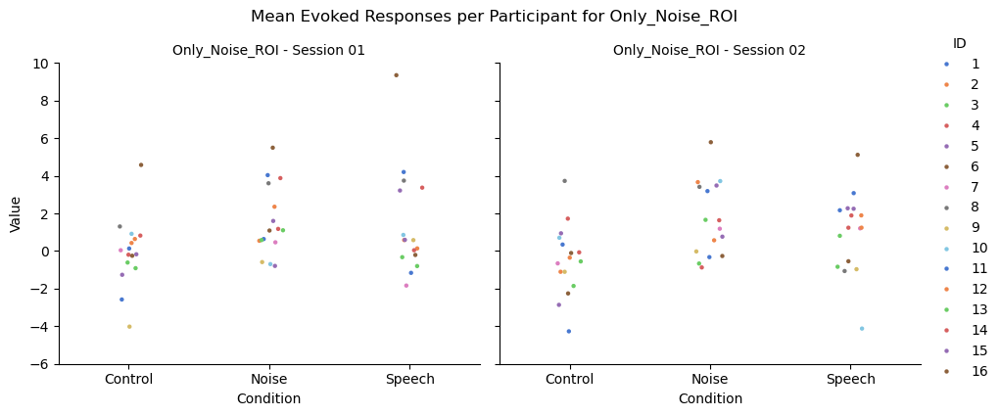

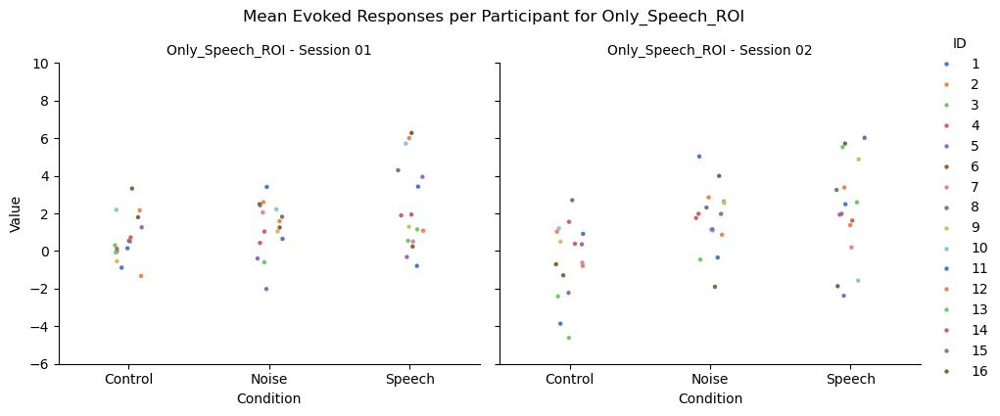

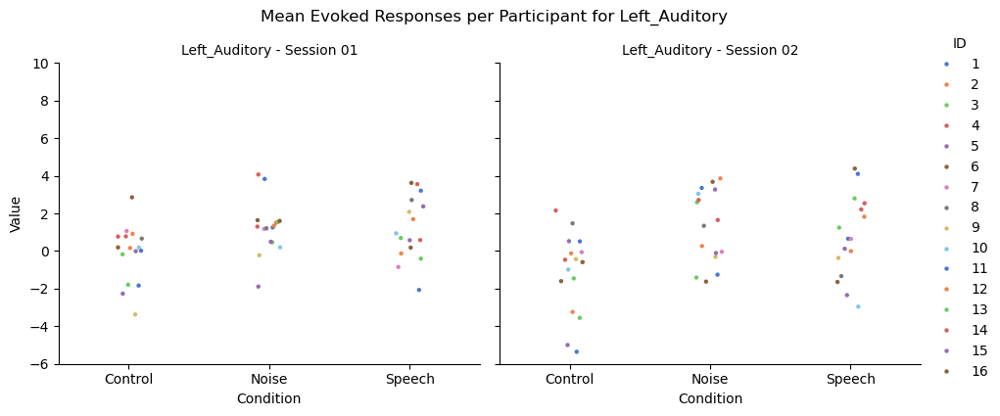

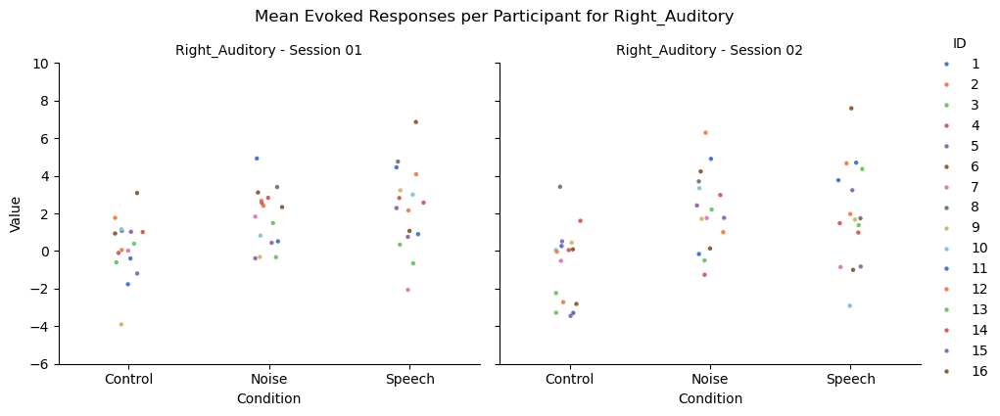

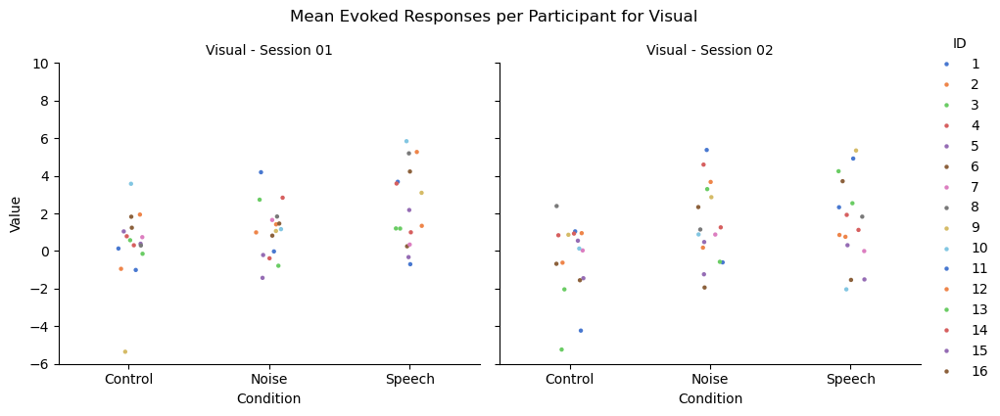

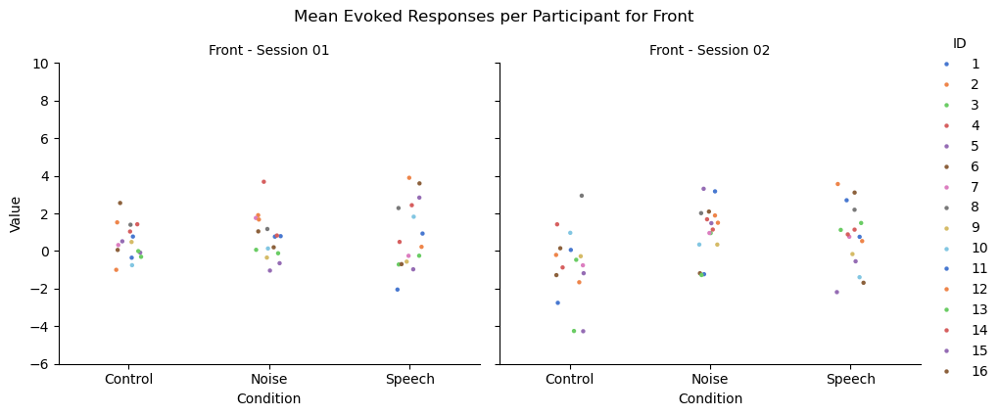

In [91]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# --- Define ROIs (without ' hbo') ---
rois = {
    "Noise_ROI": ["S10_D11", "S5_D3", "S11_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Speech_ROI": ["S10_D11", "S10_D10", "S10_D12", "S11_D12", "S1_D1", "S10_D9", "S8_D7", "S7_D7", "S8_D8"],
    "Common_ROI": ["S10_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Only_Noise_ROI": ["S5_D3", "S11_D11"],
    "Only_Speech_ROI": ["S11_D12", "S1_D1", "S8_D7", "S7_D7", "S8_D8"],
    "Left_Auditory": ["S4_D2", "S4_D3", "S5_D2", "S5_D3", "S5_D4", "S5_D5"],
    "Right_Auditory": ["S10_D9", "S10_D10", "S10_D11", "S10_D12", "S11_D11", "S11_D12"],
    "Visual": ["S6_D6", "S6_D8", "S7_D6", "S7_D7", "S8_D7", "S8_D8", "S9_D8", "S7_D8"],
    "Front": ["S1_D1", "S2_D1", "S3_D1", "S3_D2", "S12_D1"],
}


# --- Load and combine datasets ---
df_ses01 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses01.csv")
df_ses02 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses02.csv")

df_ses01["Session"] = "01"
df_ses02["Session"] = "02"

df_combined = pd.concat([df_ses01, df_ses02], ignore_index=True)

# Filter for hbo only
df_combined = df_combined[df_combined["Chroma"] == "hbo"].copy()

# Clean optode names
df_combined["Optode_clean"] = df_combined["Optode"].str.replace(" hbo", "", regex=False)

# --- Plot per ROI ---
for roi_name, optodes in rois.items():
    subset = df_combined[df_combined["Optode_clean"].isin(optodes)]

    # Compute mean per subject, session, condition
    mean_df = (
        subset.groupby(["ID", "Session", "Condition"])["Value"]
        .mean()
        .reset_index()
    )

    # Plot
    g = sns.catplot(
        x="Condition",
        y="Value",
        hue="ID",
        data=mean_df,
        errorbar=None,
        palette="muted",
        height=4,
        aspect=1.2,
        s=10,
        col="Session"
    )
    
    
    g.set_titles(f"{roi_name} - Session {{col_name}}")
    g.set(ylim=(-6, 10))
    g.fig.suptitle(f"Mean Evoked Responses per Participant for {roi_name}", y=1.05)
    plt.show()


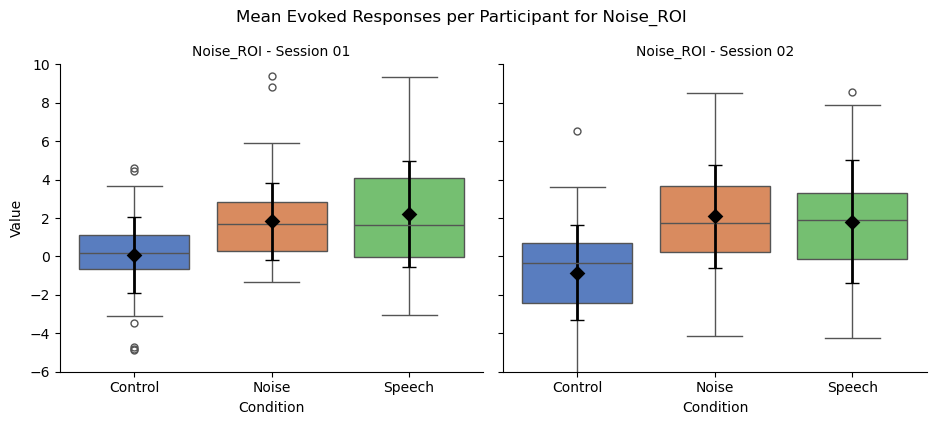

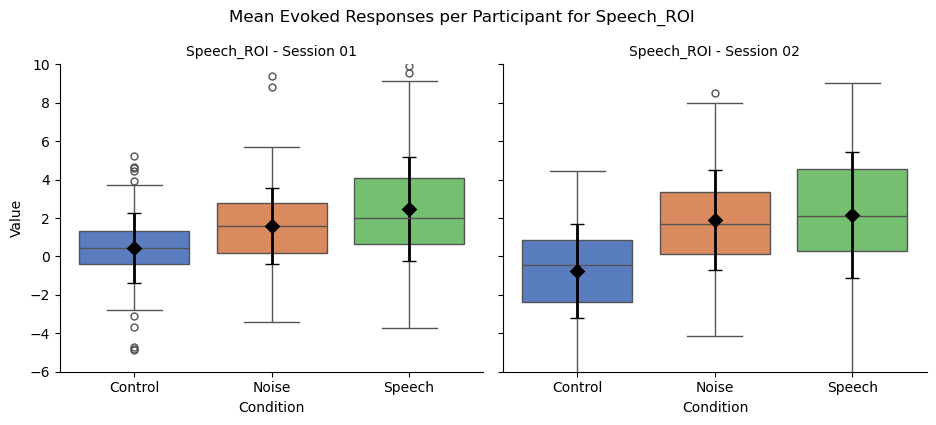

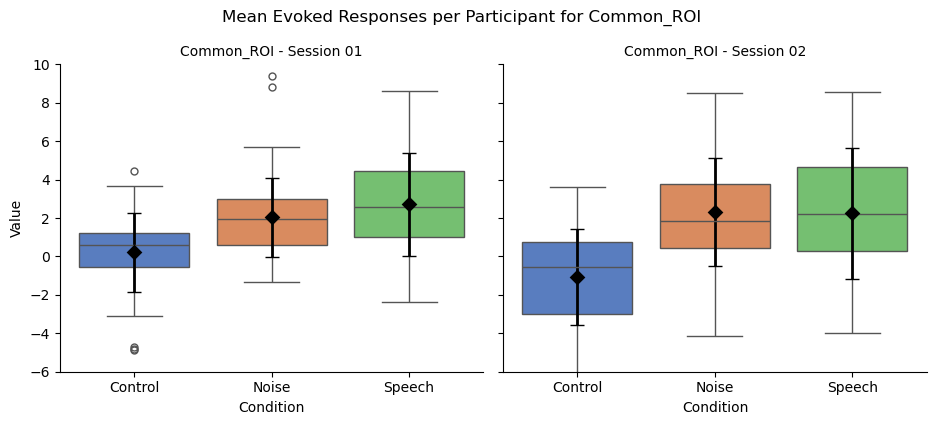

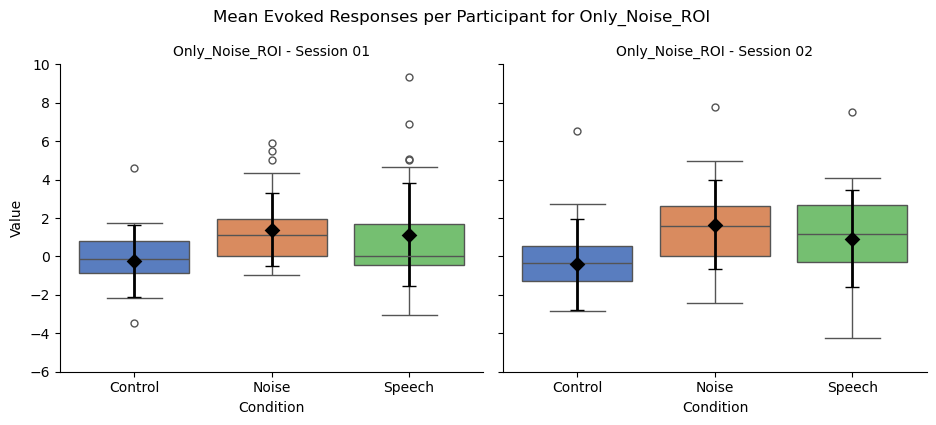

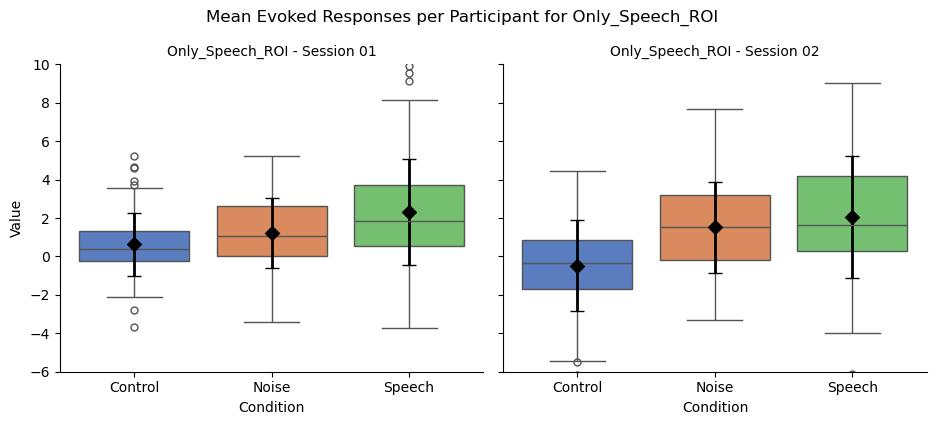

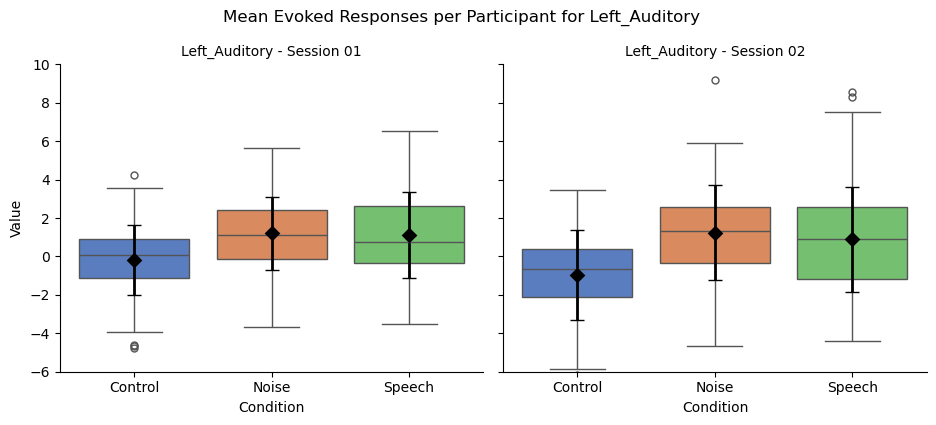

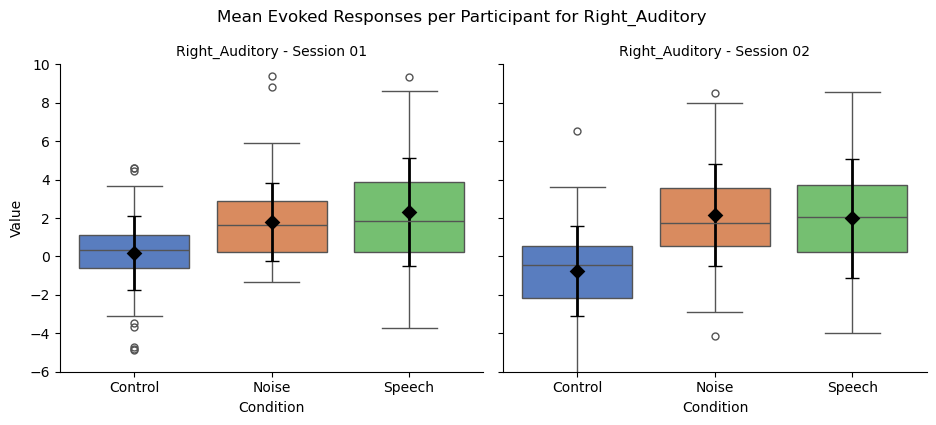

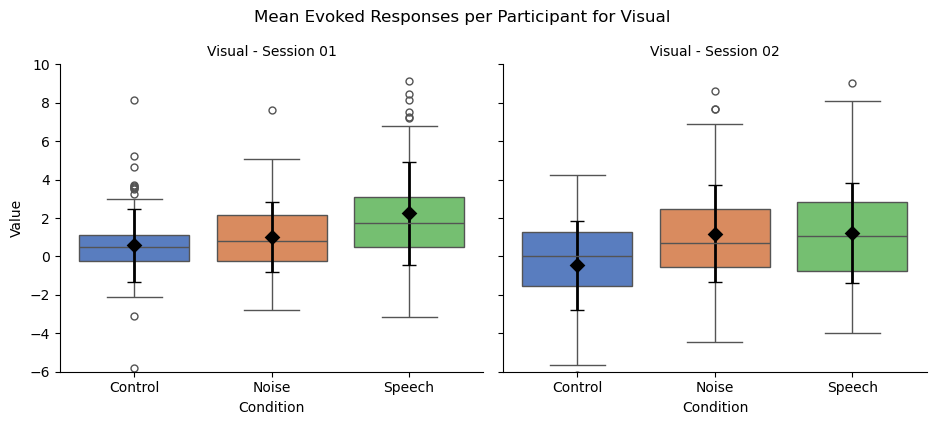

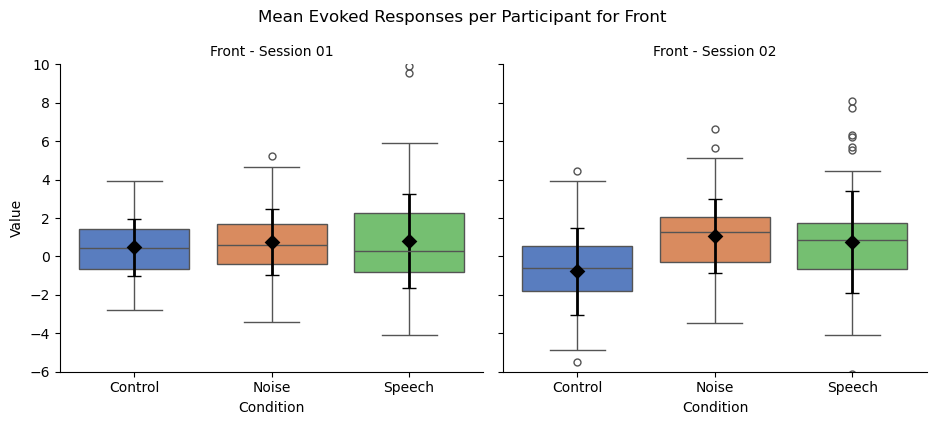

In [95]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# --- Define ROIs (without ' hbo') ---
rois = {
    "Noise_ROI": ["S10_D11", "S5_D3", "S11_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Speech_ROI": ["S10_D11", "S10_D10", "S10_D12", "S11_D12", "S1_D1", "S10_D9", "S8_D7", "S7_D7", "S8_D8"],
    "Common_ROI": ["S10_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Only_Noise_ROI": ["S5_D3", "S11_D11"],
    "Only_Speech_ROI": ["S11_D12", "S1_D1", "S8_D7", "S7_D7", "S8_D8"],
    "Left_Auditory": ["S4_D2", "S4_D3", "S5_D2", "S5_D3", "S5_D4", "S5_D5"],
    "Right_Auditory": ["S10_D9", "S10_D10", "S10_D11", "S10_D12", "S11_D11", "S11_D12"],
    "Visual": ["S6_D6", "S6_D8", "S7_D6", "S7_D7", "S8_D7", "S8_D8", "S9_D8", "S7_D8"],
    "Front": ["S1_D1", "S2_D1", "S3_D1", "S3_D2", "S12_D1"],
}

# --- Load and combine datasets ---
df_ses01 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses01.csv")
df_ses02 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses02.csv")

df_ses01["Session"] = "01"
df_ses02["Session"] = "02"

df_combined = pd.concat([df_ses01, df_ses02], ignore_index=True)

# Filter for hbo only
df_combined = df_combined[df_combined["Chroma"] == "hbo"].copy()

# Clean optode names
df_combined["Optode_clean"] = df_combined["Optode"].str.replace(" hbo", "", regex=False)

# --- Plot per ROI ---
for roi_name, optodes in rois.items():
    subset = df_combined[df_combined["Optode_clean"].isin(optodes)]

    # Compute mean and std deviation per condition/session for all participants
    stats_df = (
        subset.groupby(["Session", "Condition"])["Value"]
        .agg(["mean", "std"])
        .reset_index()
    )

    # Plot boxplot for the distribution
    g = sns.catplot(
        x="Condition",
        y="Value",
        data=subset,
        kind="box",
        height=4,
        aspect=1.2,
        palette="muted",
        hue="Condition",
        col="Session"
    )
    
    # Overlay the mean and standard deviation for each condition
    for ax, session in zip(g.axes.flat, sorted(subset["Session"].unique())):
        session_data = stats_df[stats_df["Session"] == session]
        # Add the mean values as points (using stripplot)
        sns.stripplot(
            x="Condition",
            y="mean",
            data=session_data,
            color="black",
            size=8,
            marker="D",  # Diamond marker for mean values
            ax=ax,
            legend=False
        )
        # Add error bars for standard deviation (as vertical lines)
        for idx, row in session_data.iterrows():
            ax.errorbar(
                x=row["Condition"], 
                y=row["mean"], 
                yerr=row["std"], 
                fmt="none", 
                color="black", 
                capsize=5, 
                elinewidth=2
            )

    g.set_titles(f"{roi_name} - Session {{col_name}}")
    g.set(ylim=(-6, 10))
    g.fig.suptitle(f"Mean Evoked Responses per Participant for {roi_name}", y=1.05)
    plt.show()


# ICC analysis/ROI

In [119]:
import pandas as pd
from pingouin import intraclass_corr

# --- Define ROIs (without ' hbo') ---
rois = {
    "Noise_ROI": ["S10_D11", "S5_D3", "S11_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Speech_ROI": ["S10_D11", "S10_D10", "S10_D12", "S11_D12", "S1_D1", "S10_D9", "S8_D7", "S7_D7", "S8_D8"],
    "Common_ROI": ["S10_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Only_Noise_ROI": ["S5_D3", "S11_D11"],
    "Only_Speech_ROI": ["S11_D12", "S1_D1", "S8_D7", "S7_D7", "S8_D8"],
    "Left_Auditory": ["S4_D2", "S4_D3", "S5_D2", "S5_D3", "S5_D4", "S5_D5"],
    "Right_Auditory": ["S10_D9", "S10_D10", "S10_D11", "S10_D12", "S11_D11", "S11_D12"],
    "Visual": ["S6_D6", "S6_D8", "S7_D6", "S7_D7", "S8_D7", "S8_D8", "S9_D8", "S7_D8"],
    "Front": ["S1_D1", "S2_D1", "S3_D1", "S3_D2", "S12_D1"],
}

# Load and combine session data
df_ses01 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses01.csv")
df_ses02 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses02.csv")
df_ses01["Session"] = "01"
df_ses02["Session"] = "02"
df_combined = pd.concat([df_ses01, df_ses02], ignore_index=True)

# Filter for HbO only
df_combined = df_combined[df_combined["Chroma"] == "hbo"].copy()

# --- ICC computation ---
results_list = []

for roi_name, optodes in rois.items():
    #print(f"Processing ROI: {roi_name}")
    
    for condition in df_combined["Condition"].unique():
        #print(f"  Condition: {condition}")
        
        subset = df_combined[
            (df_combined["Optode"].isin(optodes)) & 
            (df_combined["Condition"] == condition)
        ]
        
        # Mean across optodes per subject and session
        mean_values = subset.groupby(["Subject", "Session"])["Value"].mean().reset_index()
        
        # Prepare input for ICC
        icc_input = mean_values.rename(columns={"Subject": "targets", "Session": "raters", "Value": "scores"})
        
        # Calculate ICC(3,k): two-way mixed effects, average measures, consistency
        icc = intraclass_corr(data=icc_input, targets='targets', raters='raters', ratings='scores')
        icc_3k = icc[icc['Type'] == 'ICC3'].iloc[0]
        
        # Append results to list
        results_list.append({
            "ROI": roi_name,
            "Condition": condition,
            "ICC": icc_3k["ICC"],
            "CI95_low": icc_3k["CI95%"][0],
            "CI95_high": icc_3k["CI95%"][1],
            "F": icc_3k["F"],
            "pval": icc_3k["pval"]
        })

# Convert to DataFrame and save to CSV
results_df = pd.DataFrame(results_list)
results_df.to_csv("icc31_results_by_roi_condition.csv", index=False)


In [125]:
import pandas as pd
from pingouin import intraclass_corr

# --- Define ROIs (without ' hbo') ---
rois = {
    "Noise_ROI": ["S10_D11", "S5_D3", "S11_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Speech_ROI": ["S10_D11", "S10_D10", "S10_D12", "S11_D12", "S1_D1", "S10_D9", "S8_D7", "S7_D7", "S8_D8"],
    "Common_ROI": ["S10_D11", "S10_D9", "S10_D12", "S10_D10"],
    "Only_Noise_ROI": ["S5_D3", "S11_D11"],
    "Only_Speech_ROI": ["S11_D12", "S1_D1", "S8_D7", "S7_D7", "S8_D8"],
    "Left_Auditory": ["S4_D2", "S4_D3", "S5_D2", "S5_D3", "S5_D4", "S5_D5"],
    "Right_Auditory": ["S10_D9", "S10_D10", "S10_D11", "S10_D12", "S11_D11", "S11_D12"],
    "Visual": ["S6_D6", "S6_D8", "S7_D6", "S7_D7", "S8_D7", "S8_D8", "S9_D8", "S7_D8"],
    "Front": ["S1_D1", "S2_D1", "S3_D1", "S3_D2", "S12_D1"],
}

# Load and combine session data
df_ses01 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses01.csv")
df_ses02 = pd.read_csv("all_subjects_cleaned_evoked_values_Optodes_ses02.csv")
df_ses01["Session"] = "01"
df_ses02["Session"] = "02"
df_combined = pd.concat([df_ses01, df_ses02], ignore_index=True)

# Filter for HbO only
df_combined = df_combined[df_combined["Chroma"] == "hbo"].copy()

# --- ICC computation ---
results_list = []

for roi_name, optodes in rois.items():
    print(f"Processing ROI: {roi_name}")
    
    # Filter for relevant optodes only
    subset = df_combined[df_combined["Optode"].isin(optodes)]

    # Mean over optodes per subject/session/condition (but do NOT average across conditions)
    mean_values = subset.groupby(["Subject", "Session", "Condition"])["Value"].mean().reset_index()

    # Replicates for each Subject-Session (Condition = replicate)
    # ICC expects: targets (subjects), raters (sessions), ratings (values)
    icc_input = mean_values.rename(columns={
        "Subject": "targets",
        "Session": "raters",
        "Value": "scores"
    })
    
    #print(icc_input.head())

    # ICC(3,1): Two-way mixed, single measurement, consistency
    icc = intraclass_corr(data=icc_input, targets="targets", raters="raters", ratings="scores")

    icc_3_1 = icc[icc["Type"] == "ICC3"].iloc[0]  # ICC(3,1)

    results_list.append({
        "ROI": roi_name,
        "ICC": icc_3_1["ICC"],
        "CI95_low": icc_3_1["CI95%"][0],
        "CI95_high": icc_3_1["CI95%"][1],
        "F": icc_3_1["F"],
        "pval": icc_3_1["pval"]
    })

# Save to CSV
results_df = pd.DataFrame(results_list)
results_df.to_csv("icc_results_combined_conditions.csv", index=False)
print("✅ ICC results saved to 'icc_results_combined_conditions.csv'")


Processing ROI: Noise_ROI
Processing ROI: Speech_ROI
Processing ROI: Common_ROI
Processing ROI: Only_Noise_ROI
Processing ROI: Only_Speech_ROI
Processing ROI: Left_Auditory
Processing ROI: Right_Auditory
Processing ROI: Visual
Processing ROI: Front
✅ ICC results saved to 'icc_results_combined_conditions.csv'


In [123]:
subset

,ID,Subject,Session,Optode,Chroma,Condition,Value
15,1,1,01,S1_D1,hbo,Control,-0.246974
16,1,1,01,S2_D1,hbo,Control,0.443748
17,1,1,01,S3_D1,hbo,Control,1.247309
18,1,1,01,S3_D2,hbo,Control,1.251241
19,1,1,01,S12_D1,hbo,Control,1.153070
...,...,...,...,...,...,...,...
2209,16,24,02,S1_D1,hbo,Speech,8.071890
2210,16,24,02,S2_D1,hbo,Speech,0.221966
2211,16,24,02,S3_D1,hbo,Speech,1.150844
2212,16,24,02,S3_D2,hbo,Speech,3.231130


In [122]:
icc

,Type,Description,ICC,F,df1,df2,pval,CI95%
0,ICC1,Single raters absolute,0.705718,5.796191,15,16,0.000578,"[0.35, 0.89]"
1,ICC2,Single random raters,0.710553,6.538478,15,15,0.000391,"[0.36, 0.89]"
2,ICC3,Single fixed raters,0.734694,6.538478,15,15,0.000391,"[0.39, 0.9]"
3,ICC1k,Average raters absolute,0.827473,5.796191,15,16,0.000578,"[0.52, 0.94]"
4,ICC2k,Average random raters,0.830787,6.538478,15,15,0.000391,"[0.52, 0.94]"
5,ICC3k,Average fixed raters,0.847059,6.538478,15,15,0.000391,"[0.56, 0.95]"
